<a href="https://colab.research.google.com/github/arpanbiswas52/varTBO/blob/main/dKLBO_spectral_(Notebookversion).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **dKLBO Spectral**
Jan, 2023

This is the physics-driven, human-augmented, dynamic, dkl-BO recommder system framework for automated experiement with microscope. (Colab Version)


## *   Rama Vasudevan proposed the idea
## *   Maxim Ziatdinov developed deep learning kernel function in AtomAI (Python) library
## *   Arpan Biswas developed the architecture of dKLBO spectral recommder system 
## *   Arpan Biswas, Rama Vasudevan, Yongtao Liu adapted to make it compatible with microscopy measurement



#Problem Description
Build a BO framework-

Here we have a image data, where X is the input location of the image

Each location in the image, we have a spectral data, from where user select if the data is good/bad (discrete choice). We take the means of all good spectral only to generate the target spectral.

At the mid of execution, the user also have option to either eliminate (or update the preferance) all the previously stored (if user suddenly find a desired spectral) spectral, and put more weights on new found spectral.

The goal is to build a optimization (BO) model where we adaptively sample towards region (in image) of good spectral, and find optimal location point closest to the current chosen target spectral (as per user voting).

#Workflow: Run BO to find the optimal location for user-desired spectral as per voting
Here we vote the quality of spectral

User interaction part:

During the play (for each function evaluation)-

- View spectral image. User have three rating options as 0, 1, 2: 0-Bad, 1-Good, 2-Very good. **To answer 0-Bad spectral, user can just jit ENTER to save time**

- If user rated as Good or Very Good, and user already have a current target spectral (user already selected at least one good/very good spectral in earlier iterations), another message pops up if the user want to update preference of new spectral Vs the current target spectral(Y or N). **To answer No, user can just jit ENTER to save time**

  - If user choose "Y", user have option (any number between 0-10) to provide weights of new spectral. For example: If user provide 10 as input, the updated target spectral will be only the new chosen spectral and all the other earlier selected good spectral will be eliminated from target.

  - If user choose "N", as default the updated target spectral is the mean of all the earlier selected spectral and the new spectral.

- User will get prompt at each BO iteration if they are satisfied with current target spectral or need further updating(Y or N). **To answer No, user can just jit ENTER to save time**

  - If user select Y, target spectral will be updated as per voting of new spectral and **human-guided dynamic objective evaluation** will be conducted

  - If user select N, target spectral will be fixed and an **automated objective evaluation** will be conducted for future BO iteration (like normal BO and no further prompt of target updating)


After END OF PLAY, the code automatically save below data (serially) in optim.results.npy

- Best locations, from evaluated samples and GP estimated

- User rating of spectral at each evaluated locations in image

- the matrices of evaluated location and the respective obj values

In [1]:
!pip install --upgrade --no-cache-dir gdown

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Attempting uninstall: gdown
    Found existing installation: gdown 4.4.0
    Uninstalling gdown-4.4.0:
      Successfully uninstalled gdown-4.4.0


In [2]:
!pip install --upgrade torch==1.8.1 torchvision==0.9.1
!pip install smt
!pip install atomai
!pip install torchmetrics

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 804.1/804.1 MB 2.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.4/17.4 MB 55.1 MB/s eta 0:00:00
  Attempting uninstall: torch
    Found existing installation: torch 1.13.0+cu116
    Uninstalling torch-1.13.0+cu116:
      Successfully uninstalled torch-1.13.0+cu116
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.14.0+cu116
    Uninstalling torchvision-0.14.0+cu116:
      Successfully uninstalled torchvision-0.14.0+cu116
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.14.0 requires torch==1.13.0, but you have torch 1.8.1 which is incompatible.
torchaudio 0.13.0+cu116 requires torch==1.13.0, but you have torch 1.8.1 which is incompatible.
Looking in indexe

In [3]:
import sys
import gdown
import torch
from torchvision import datasets, transforms
from torchmetrics.functional import structural_similarity_index_measure as ssim2
import matplotlib as mpl
import numpy as np
import matplotlib.pyplot as plt
import pickle
import numpy as np
import random
#import kornia as K
#import kornia.metrics as metrics
from PIL import Image
from typing import Tuple
import ipywidgets as widgets
from IPython.display import display
import pylab as pl
from IPython.display import clear_output
import pdb
from skimage.transform import resize
from mpl_toolkits.axes_grid1 import make_axes_locatable
#import gpim
from sklearn.decomposition import PCA
import matplotlib.gridspec as gridspec
from copy import deepcopy

from typing import Union
import pickle

from mpl_toolkits.axes_grid1 import make_axes_locatable
from smt.sampling_methods import LHS
from torch.optim import SGD
from torch.optim import Adam
from scipy.stats import norm
from scipy.interpolate import interp1d
from skimage.metrics import structural_similarity as ssim
from skimage import filters
from skimage.restoration import denoise_bilateral
import atomai as aoi
from atomai import utils

import time

In [4]:
class play_varTBO():

    def __init__(self):
      pass

    @classmethod
    def func_automated_obj(self, idx_x, idx_y, new_spec_x, new_spec_y, target_func):
        idx1 = int(idx_x)
        idx2 = int(idx_y)
        rf = 10

        #Calculate ssim between target and ith loop shape
        pred = new_spec_y
        target = target_func
        ssim_spec = ssim(target, pred, data_range=pred.max() - pred.min())

        #This is the basic setting of obj func-- we can incorporate more info as per domain knowledge to improve
        #Into maximization problem
        obj = rf * ssim_spec  #Maximize reward and negative mse
        #print(obj)
        return obj

    @classmethod
    def func_human_interacted_obj(self, idx_x, idx_y, new_spec_x, new_spec_y, wcount_good, target_func, vote):
        idx1 = int(idx_x)
        idx2 = int(idx_y)
        rf = 1
        #print(wcount_good)
        if (wcount_good == 0): #We dont find a good loop yet from all initial sampling and thus target is unknown
            ssim_spec = np.random.rand(1)*(1) # Unif[0, 1] A sufficiently large value as we want to avoid selecting bad loops,
            # When we have a target, we will recalculate again to get more accuract estimate
            R = vote*rf

        else:
            #Calculate dissimilarity (mse) between target and ith loop shape

            pred = new_spec_y
            target = target_func
            ssim_spec = ssim(target, pred, data_range=pred.max() - pred.min())
            #plt.plot(new_spec_x, new_spec_y)
            #plt.show()
            #dev2_spectral = (target_func-new_spec_y)**2
            #mse_spectral = torch.mean(dev2_spectral)
            #Calculate reward as per voting, this will minimize the risk of similar function values of good and bad loop shape with similar mse
            R = vote*rf

        #This is the basic setting of obj func-- we can incorporate more info as per domain knowledge to improve
        #Into maximization problem
        obj = R + ssim_spec #Maximize reward and ssim
        #print(mse_spectral)
        return obj

    @classmethod
    def optimize_dKLgp(self, train_X, train_Y):
        data_dim = train_X.shape[-1]

        dklgp_surro = aoi.models.dklGPR(data_dim, embedim=2, precision="single")
        
        dklgp_surro.fit(train_X, train_Y, training_cycles=200)
        return dklgp_surro


    @classmethod
    def cal_posterior(self, gp_surro, test_X):
        y_pred_means = np.zeros((len(test_X), 1))
        y_pred_vars = np.zeros((len(test_X), 1))
        mean, var = gp_surro.predict(test_X, batch_size=len(test_X))
        #mean = torch.from_numpy(mean)
        #var = torch.from_numpy(var)
        y_pred_means[:, 0] = mean
        y_pred_vars[:, 0] = var
       
        return y_pred_means, y_pred_vars
    
    @classmethod
    def acqmanEI(self, y_means, y_vars, train_Y, ieval):
        #y_means = y_means.detach().numpy()
        #y_vars = y_vars.detach().numpy()
        y_std = np.sqrt(y_vars)
        fmax = train_Y.max()
        #fmax = fmax.detach().numpy()
        best_value = fmax
        EI_val = np.zeros(len(y_vars))
        Z = np.zeros(len(y_vars))
        eta = 0.01

        for i in range(0, len(y_std)):
            if (y_std[i] <=0):
                EI_val[i] = 0
            else:
                Z[i] =  (y_means[i]-best_value-eta)/y_std[i]
                EI_val[i] = (y_means[i]-best_value-eta)*norm.cdf(Z[i]) + y_std[i]*norm.pdf(Z[i])

        # Eliminate evaluated samples from consideration to avoid repeatation in future sampling
        EI_val[ieval] = -1
        acq_val = np.max(EI_val)
        acq_cand = [k for k, j in enumerate(EI_val) if j == acq_val]
        #print(acq_val)
        return acq_cand, acq_val, EI_val

    @classmethod
    def augment_newdata_KL(self, acq_X, acq_X_norm, acq_indices, train_X, train_X_norm, train_indices, train_Y, 
                           new_spec_x, new_spec_y, eval_spec, img_space, var_params, u, m):
        wcount_good, pref, target_func = var_params[0], var_params[1], var_params[2]

        nextX = acq_X
        nextX_norm = acq_X_norm
        nextind = acq_indices
        train_X_norm = np.vstack((train_X_norm, nextX_norm))
        train_X = np.vstack((train_X, nextX))
        train_indices = np.vstack((train_indices, nextind))

        p = np.zeros((1, 1))
        #x = torch.empty((1,2))
        idx_x = int(train_indices[-1, 0])
        idx_y = int(train_indices[-1, 1])

        
        if (u == 0):
            print("Are you satisfied with current target? (y- yes or press ENTER- No)")
            update_target = str(input("Answer: "))
            if (update_target == "Y" or update_target == 'y'):
                print("Spectral target now fixed. Continue automated BO...")
                #First time switching to automated BO, need to recalculate the objectives again
                plt.plot(new_spec_x, new_spec_y)
                plt.title('loc:' +str(idx_y) +"," + str(idx_x), fontsize = 20)
                plt.show()
                train_Y = np.zeros((train_X.shape[0], 1))
                u = 1 # This is a switching parameter to not call for update target every iteration once the user is satisfied
                for i in range(0, train_X.shape[0]):
                    idx_x = int(train_indices[i, 0])
                    idx_y = int(train_indices[i, 1])
                    spec_y = eval_spec_y[idx_x, idx_y, :]
                    #print(idx_x, idx_y, spec_y)
                    train_Y[i, 0] = self.func_automated_obj(idx_x, idx_y, new_spec_x, spec_y, target_func)
  
            else:
                print("User still searching for best target. Continue BO with human interaction...")

                #Vote for new spectral sample and update(or not) target spectral function
                p[0, 0], wcount_good, target_func = self.generate_targetobj(idx_x, idx_y, new_spec_x, new_spec_y, img_space, wcount_good, target_func)
                pref = np.vstack((pref, p)) #Augment pref matrix

                if (p[0, 0] == 0):
                  # If target loop is not updated, we eval for the new samples only as the
                  # func value for others remain the same

                    next_feval = np.zeros((1, 1))
                    next_feval[0, 0] = self.func_human_interacted_obj(idx_x, idx_y, new_spec_x, new_spec_y, wcount_good, target_func, pref[-1, 0])
                    train_Y = np.vstack((train_Y, next_feval))
                else:
                    # If target loop is updated, we reevaluate the obj of old spectral samples and 
                    # eval for the new samples
                    train_Y = np.zeros((train_X.shape[0], 1))
                    for i in range(0, train_X.shape[0]):
                        #x[0, 0] = train_X[i, 0]
                        #x[0, 1] = train_X[i, 1]
                        idx_x = int(train_indices[i, 0])
                        idx_y = int(train_indices[i, 1])
                        spec_y = eval_spec_y[idx_x, idx_y, :]
                        #print(idx_x, idx_y, spec_y)
                        train_Y[i, 0] = self.func_human_interacted_obj(idx_x, idx_y, new_spec_x, spec_y, wcount_good, target_func, pref[i, 0])
        else:
            fig,ax=plt.subplots(ncols=2,figsize=(12,5))
            ax[0].plot(new_spec_x, new_spec_y)
            ax[0].set_title('loc:' +str(idx_y) +"," + str(idx_x), fontsize = 20)
            ax[1].plot(new_spec_x,target_func)
            ax[1].set_title('Fixed target function', fontsize = 20)
            plt.show()
            next_feval = np.zeros((1, 1))
            next_feval[0, 0] = self.func_automated_obj(idx_x, idx_y, new_spec_x, new_spec_y, target_func)
            train_Y = np.vstack((train_Y, next_feval)) 

        var_params = [wcount_good, pref, target_func]
        m = m + 1
        return train_X, train_X_norm, train_indices, train_Y, var_params, u, m

    @classmethod
    def generate_targetobj(self, idx_x, idx_y, new_spec_x, new_spec_y, img_space, wcount_good, target_func):
      #count_good= 0
      idx1 = int(idx_x)
      idx2 = int(idx_y)
      if (wcount_good == 0):
        # Figure for user choice
        fig,ax=plt.subplots(ncols=2,figsize=(12,5))
        ax[0].imshow(img_space, origin="lower")
        ax[0].scatter(idx2, idx1, marker = 'x', color="red")
        ax[0].axes.xaxis.set_visible(False)
        ax[0].axes.yaxis.set_visible(False)
        ax[1].plot(new_spec_x, new_spec_y)
        ax[1].set_title('loc:' +str(idx2) +"," + str(idx1), fontsize = 20)
        plt.show()

      else:
        # Figure for user choice
        fig,ax=plt.subplots(ncols=3,figsize=(18,5))
        ax[0].imshow(img_space, origin="lower")
        ax[0].scatter(idx2, idx1, marker = 'x', color="red")
        ax[0].axes.xaxis.set_visible(False)
        ax[0].axes.yaxis.set_visible(False)
        ax[1].plot(new_spec_x, new_spec_y)
        ax[1].set_title('loc:' +str(idx2) +"," + str(idx1), fontsize = 20)
        ax[2].plot(new_spec_x,target_func)
        ax[2].set_title('Current target function', fontsize = 20)
        plt.show()

      print("Rating: 0-Bad or press ENTER, 1-Good, 2-Very good")
      time.sleep(0.5)
      vote = (input("enter rating: "))
      # For bad spectral, we can also input null values to accelerate the voting- This is similar to skipping voting for bad spectral
      #For good ones, user need to vote as either 1 or 2
      if (vote == ""):
        vote = 0
        print(vote)
      else:
        vote = float(vote)
        print(vote)

      if(vote>0):
        newspec_wt = 1
        if ((wcount_good) > 0): #Only if we already have selected good spectral in early iterations
          print("Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No")
          newspec_pref = str(input("Answer: "))
          # For no pref update, we can also press enter (skip) to accelerate the process
          if (newspec_pref == 'Y' or newspec_pref == 'y'):
            print("Provide weights between 0 and 10: \n10 being all the weights to new spectral as new target.")
            newspec_wt = float(input("enter weightage: "))/10
            print(newspec_wt)
          else:
            newspec_wt = 0.5
        wcount_good =wcount_good + vote
        target_func = (((1-newspec_wt)*target_func*(wcount_good-vote))+(newspec_wt*vote*new_spec_y))/(((
            wcount_good-vote)*(1-newspec_wt)) + (vote*newspec_wt))
        #Normalize
        target_func = (target_func - target_func.min())/(target_func.max() - target_func.min())
      return vote, wcount_good, target_func    

    @classmethod
    def estimate (self, train_indices, train_Y, indices, y_pred_means):
        #Best solution among the evaluated data
        loss = np.max(train_Y)
        ind_opt = np.argmax(train_Y)
        X_opt = np.zeros((1,2))
        X_opt[0, 0] = train_indices[ind_opt, 0]
        X_opt[0, 1] = train_indices[ind_opt, 1]
        #print(loss, ind)

        # Best estimated solution from GP model considering the non-evaluated solution
        loss = np.max(y_pred_means)
        ind_opt_GP = np.argmax(y_pred_means)
        X_opt_GP = np.zeros((1,2))
        X_opt_GP[0, 0] = indices[ind_opt_GP, 0]
        X_opt_GP[0, 1] = indices[ind_opt_GP, 1]
        #print(loss, ind)

        return X_opt, X_opt_GP, ind_opt, ind_opt_GP


# Help function

In [5]:
def plot_results(train_indices, train_Y, indices, y_pred_means, y_pred_vars, X_opt, X_opt_GP, img_space, i):
  pen = 10**0
  #Objective map
  fig,ax=plt.subplots(ncols=3,figsize=(18,5))
  a= ax[0].imshow(img_space, origin = "lower")
  ax[0].scatter(train_indices[:,1], train_indices[:,0], marker='s', c=train_Y, cmap='jet', linewidth=0.2)
  ax[0].scatter(X_opt[0, 1], X_opt[0, 0], marker='x', c='r')
  ax[0].scatter(X_opt_GP[0, 1], X_opt_GP[0, 0], marker='o', c='r')
  ax[0].axes.xaxis.set_visible(False)
  ax[0].axes.yaxis.set_visible(False)

  a = ax[1].scatter(indices[:,1], indices[:,0], c=y_pred_means/pen, cmap='viridis', linewidth=0.2)
  ax[1].scatter(train_indices[:,1], train_indices[:,0], marker='s', c=train_Y, cmap='jet', linewidth=0.2)
  #ax[1].scatter(X_opt[0, 1], X_opt[0, 0], marker='x', c='r')
  #ax[1].scatter(X_opt_GP[0, 1], X_opt_GP[0, 0], marker='o', c='r')
  divider = make_axes_locatable(ax[1])
  cax = divider.append_axes('right', size='5%', pad=0.05)
  fig.colorbar(a, cax=cax, orientation='vertical')
  ax[1].set_title('Objective (GP mean) map', fontsize=10)
  ax[1].axes.xaxis.set_visible(False)
  ax[1].axes.yaxis.set_visible(False)
  #ax[1].colorbar(a)

  b = ax[2].scatter(indices[:,1], indices[:,0], c=y_pred_vars/(pen**2), cmap='viridis', linewidth=0.2)
  divider = make_axes_locatable(ax[2])
  cax = divider.append_axes('right', size='5%', pad=0.05)
  fig.colorbar(b, cax=cax, orientation='vertical')
  ax[2].set_title('Objective (GP var) map', fontsize=10)
  ax[2].axes.xaxis.set_visible(False)
  ax[2].axes.yaxis.set_visible(False)
  #ax[2].colorbar(b)

  plt.savefig('acquisition_results_step=' + str(i) +'.png', dpi = 300, bbox_inches = 'tight', pad_inches = 1.0)
  plt.show()


#Load Dataset

In [6]:
!gdown https://drive.google.com/uc?id=1iR791jgsJibeoSiw60I_Df61HXk5Flok
pickle_file_loc = r'beps_ground_truth_d1.p'
original_data = pickle.load(open(pickle_file_loc, "rb"))
beps_all = original_data['results_beps']

Downloading...
From: https://drive.google.com/uc?id=1iR791jgsJibeoSiw60I_Df61HXk5Flok
To: /content/beps_ground_truth_d1.p
100% 827M/827M [00:03<00:00, 216MB/s]


In [7]:
!gdown https://drive.google.com/uc?id=1R3FkuimCtqoQQgOU8nct6bglBo-G9rU3
results = np.load("iterative_results_d1.npy", allow_pickle=True)

Downloading...
From: https://drive.google.com/uc?id=1R3FkuimCtqoQQgOU8nct6bglBo-G9rU3
To: /content/iterative_results_d1.npy
100% 69.4M/69.4M [00:00<00:00, 267MB/s]


In [8]:
img_big = results[0][-2]
dim = 50
img = resize(img_big, (50, 50),
                       anti_aliasing=True)

In [9]:
spec_length = 64  #spectral data length
dim = 50
amp_slices = []
for ind in range(len(beps_all)):
    amp_slices.append(beps_all[ind][1][2])
amp_slices = np.array(amp_slices)
#img = amp_slices[:,10].reshape(50,50)

vdc_full = np.array(beps_all[0][1][0])
vdc_vec = vdc_full[-64:]

amp_mat = amp_slices[:,128:][:,1::2]
amp_masked = np.zeros_like(amp_mat)


spec_length = amp_mat.shape[-1]  #spectral data length
specim = np.reshape(amp_mat, (dim, dim, spec_length))

print(img.shape, vdc_vec.shape, amp_slices.shape, specim.shape)

(50, 50) (64,) (2500, 256) (50, 50, 64)


# Ground truth image

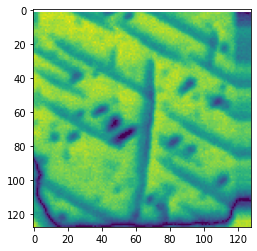

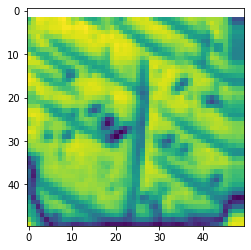

In [10]:
plt.imshow(img_big)
plt.show()
plt.imshow(img)
plt.show()

Creating image patch

In [11]:
window_size = 4

coordinates = aoi.utils.get_coord_grid(img, step=1, return_dict=False)
features, targets, indices = aoi.utils.extract_patches_and_spectra(
    specim, img, coordinates=coordinates, window_size=window_size, avg_pool=1)

features.shape, targets.shape

/usr/local/lib/python3.8/dist-packages/atomai/utils/img.py:450: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:230.)
  spectra = torch.tensor(spectra).unsqueeze(1)


((2115, 4, 4), (2115, 64))

In [12]:
norm_ = lambda x: (x - x.min()) / x.ptp()
features, targets = norm_(features), norm_(targets)

In [13]:
n, d1, d2 = features.shape
num_start = int(10)
N = int(200)
m = 0
spec_length = 64  #spectral data length



spec_length = amp_mat.shape[-1]  #spectral data length

coordinates = utils.get_coord_grid(img, 1)
X_feas = features.reshape(n, d1*d2)

X_feas_norm = features.reshape(n, d1*d2)

amp_masked = np.zeros_like(targets)
np.random.seed(10)

idx = np.random.randint(0, len(X_feas), num_start)
for ind in range(num_start):
    amp_masked[int(idx[ind]),:] = targets[int(idx[ind]),:]

train_X = X_feas[idx]
train_X_norm = X_feas_norm[idx]
#indices = torch.from_numpy(indices)
train_indices = indices[idx]

print(X_feas.shape, X_feas_norm.shape,train_X.shape, train_X_norm.shape, train_indices.shape, amp_masked.shape)

(2115, 16) (2115, 16) (10, 16) (10, 16) (10, 2) (2115, 64)


Initial sampling

i is 0, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #1


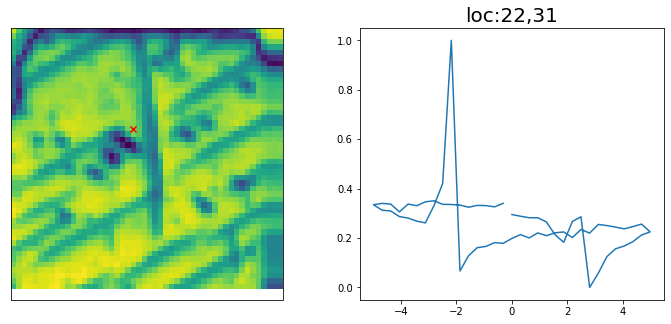

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 
0
i is 1, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #2


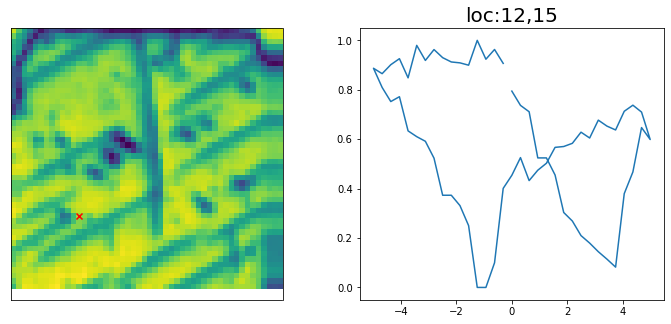

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 1
1.0
i is 2, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #3


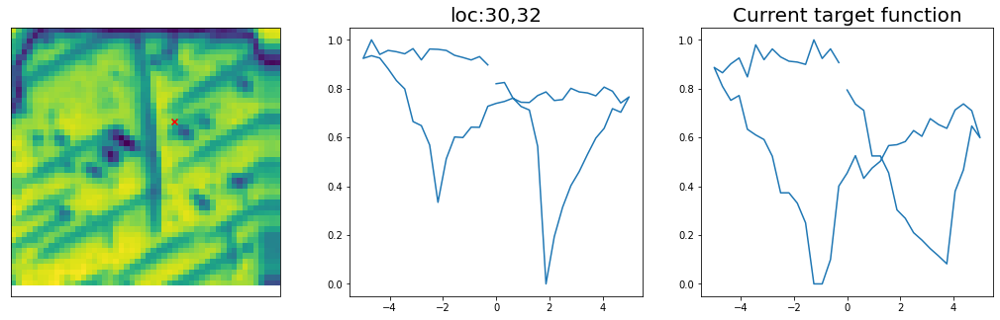

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 2
2.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 3, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #4


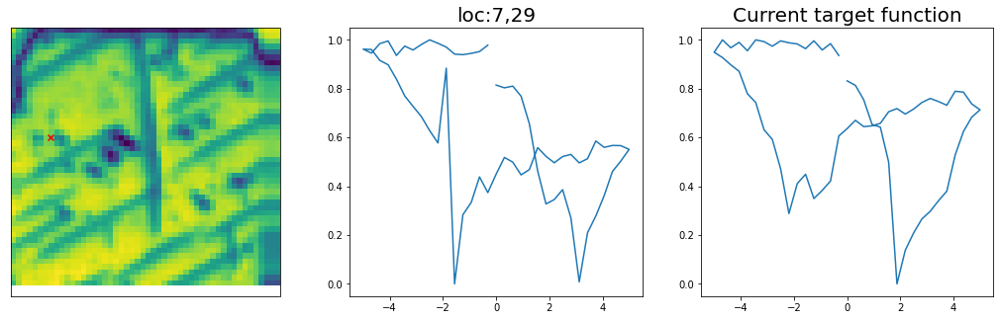

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 
0
i is 4, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #5


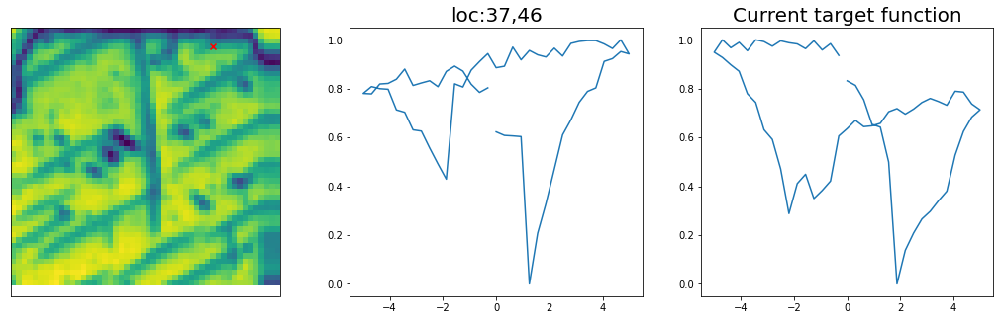

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 1
1.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 5, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #6


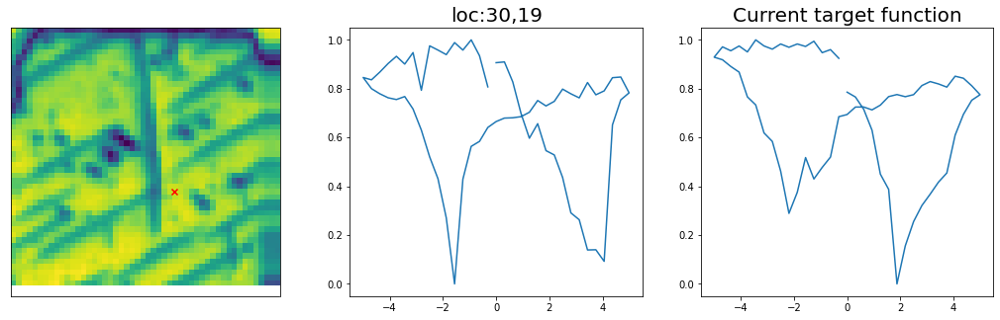

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 2
2.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 6, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #7


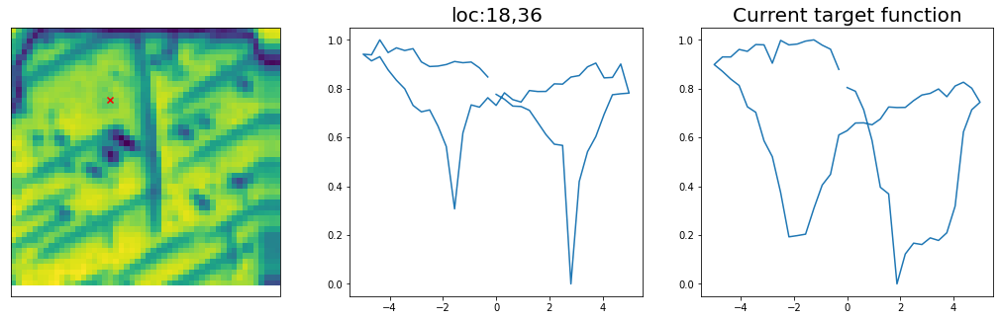

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 1
1.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 7, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #8


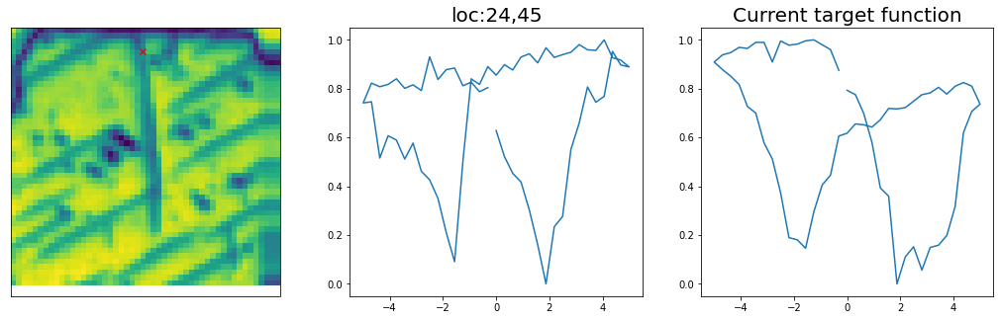

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 2
2.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 8, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #9


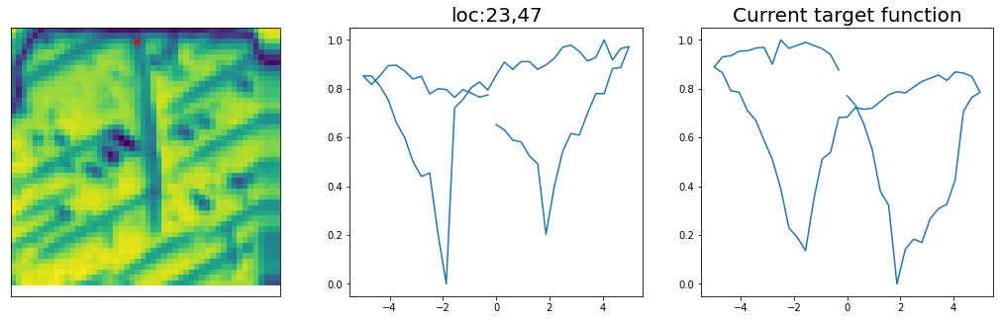

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 2
2.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 9, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #10


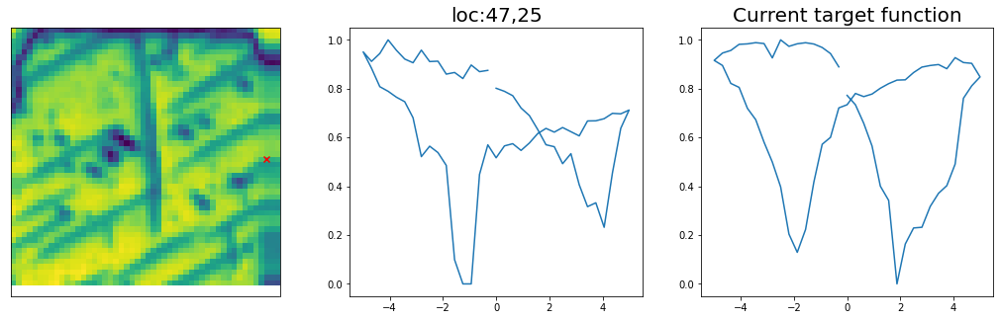

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 
0


In [14]:
def return_new_measurement(full_dataset, points_measured):
    ampdat_masked = np.zeros_like(full_dataset)
    ampdat_masked[points_measured,:] = full_dataset[points_measured,:]
    return ampdat_masked, points_measured

# set parameters
IV = np.copy(amp_masked)
points_measured = np.array(idx)
last_points_measured = np.array(points_measured)
vdc = vdc_vec

train_Y = np.zeros((num_start, 1))
pref = np.zeros((num_start, 1))
init_spec = np.zeros((num_start, spec_length))
# Define a sparse grid to store evaluated spectral locations
eval_spec_y = np.zeros((img.shape[0],img.shape[0],spec_length))
#Evaluate initial training data
x = np.zeros((1,2))

# First generate target loop, based on initial training data
wcount_good= 0
target_func = np.zeros(spec_length)

mask = np.isin(points_measured, last_points_measured, invert = True)
new_points_measured = points_measured[mask]
last_points_measured = np.append(last_points_measured, new_points_measured)

for i in range(0, num_start):
    
    ##******************experiment start*******************##
    time.sleep(0.1)

    idx_x = int(train_indices[i, 0])
    idx_y = int(train_indices[i, 1])

    next_loc = np.asarray([idx_x, idx_y])
    
    print("i is {}, measurement done".format(i))
    
    mask = np.isin(points_measured, last_points_measured, invert = True)
    new_points_measured = points_measured[mask]
    last_points_measured = np.append(last_points_measured, new_points_measured)
    print('points measured {}'.format(points_measured))
    print('new_points_measured {}'.format(new_points_measured))

    new_iv = IV[last_points_measured,:]

    #new_spec_x = torch.from_numpy(vdc_vec)
    #new_spec_y = torch.from_numpy(new_iv)[i,:]

    new_spec_x = vdc_vec
    new_spec_y = new_iv[i,:]
    

    new_spec_y = (new_spec_y - new_spec_y.min())/(new_spec_y.max() - new_spec_y.min())

    init_spec[i,] = new_spec_y
    eval_spec_y[idx_x, idx_y, :] = new_spec_y
    print("\n\nSample #" + str(m + 1))
    pref[i, 0], wcount_good, target_func = play_varTBO.generate_targetobj(idx_x, idx_y, new_spec_x,new_spec_y, 
                                                              img, wcount_good, target_func)
    m = m + 1


# Once target loop is defined (unless are loops are selected bad by user), we compute the obj
for i in range(0, num_start):
  idx_x = int(train_indices[i, 0])
  idx_y = int(train_indices[i, 1])
  spec_y = eval_spec_y[idx_x, idx_y, :]
  #print(idx_x, idx_y, spec_y)
  train_Y[i, 0] = play_varTBO.func_human_interacted_obj(idx_x, idx_y, new_spec_x, spec_y, wcount_good, target_func, pref[i, 0])

var_params = [wcount_good, pref, target_func]
test_X, test_X_norm, train_X, train_X_norm, train_Y, var_params, idx, m \
= X_feas, X_feas_norm, train_X, train_X_norm, train_Y, var_params, idx, m


Active learning through dklBO (using deep learning kernel with input image patches)

Epoch 1/200 ... Training loss: 1.8131
Epoch 10/200 ... Training loss: 1.6532
Epoch 20/200 ... Training loss: 1.5182
Epoch 30/200 ... Training loss: 1.4032
Epoch 40/200 ... Training loss: 1.2839
Epoch 50/200 ... Training loss: 1.1944
Epoch 60/200 ... Training loss: 1.1326
Epoch 70/200 ... Training loss: 1.0753
Epoch 80/200 ... Training loss: 1.0244
Epoch 90/200 ... Training loss: 0.9745
Epoch 100/200 ... Training loss: 0.929
Epoch 110/200 ... Training loss: 0.8886
Epoch 120/200 ... Training loss: 0.8712
Epoch 130/200 ... Training loss: 0.8049
Epoch 140/200 ... Training loss: 0.7614
Epoch 150/200 ... Training loss: 0.7168
Epoch 160/200 ... Training loss: 0.679
Epoch 170/200 ... Training loss: 0.6333
Epoch 180/200 ... Training loss: 0.5901
Epoch 190/200 ... Training loss: 0.5476
Epoch 200/200 ... Training loss: 0.5055
step:  1
Sample #11




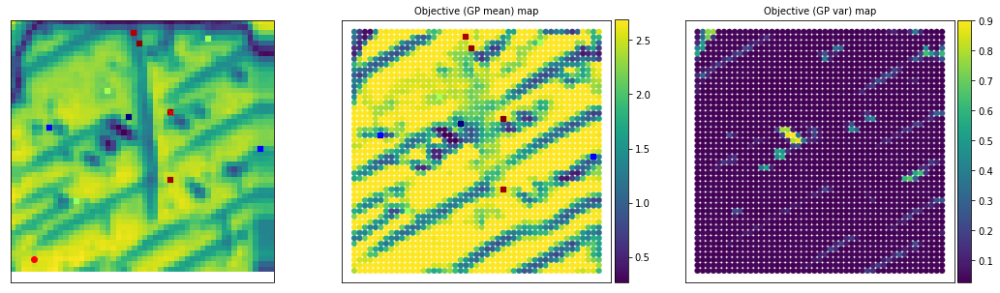

Are you satisfied with current target? (y- yes or press ENTER- No)
Answer: y
Spectral target now fixed. Continue automated BO...


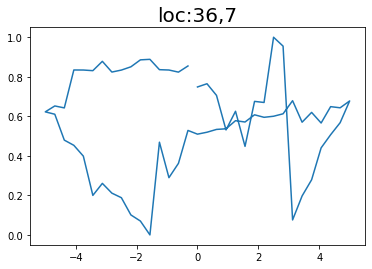

Epoch 1/200 ... Training loss: 5.3501
Epoch 10/200 ... Training loss: 4.1782
Epoch 20/200 ... Training loss: 3.6106
Epoch 30/200 ... Training loss: 3.2808
Epoch 40/200 ... Training loss: 3.0302
Epoch 50/200 ... Training loss: 2.8307
Epoch 60/200 ... Training loss: 2.6605
Epoch 70/200 ... Training loss: 2.5157
Epoch 80/200 ... Training loss: 2.3869
Epoch 90/200 ... Training loss: 2.271
Epoch 100/200 ... Training loss: 2.1761
Epoch 110/200 ... Training loss: 2.0929
Epoch 120/200 ... Training loss: 2.0184
Epoch 130/200 ... Training loss: 1.9505
Epoch 140/200 ... Training loss: 1.8878
Epoch 150/200 ... Training loss: 1.8297
Epoch 160/200 ... Training loss: 1.773
Epoch 170/200 ... Training loss: 1.7207
Epoch 180/200 ... Training loss: 1.6645
Epoch 190/200 ... Training loss: 1.613
Epoch 200/200 ... Training loss: 1.5612
step:  2
Sample #12




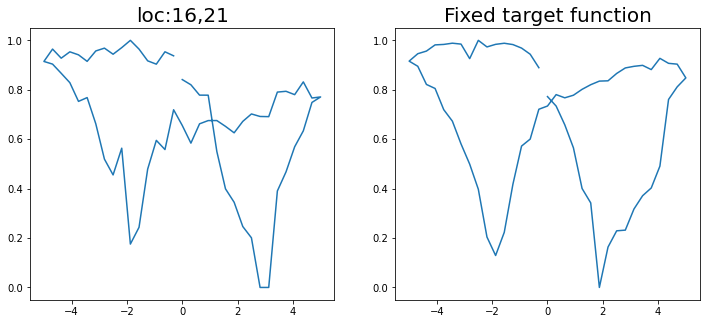

Epoch 1/200 ... Training loss: 5.0927
Epoch 10/200 ... Training loss: 4.0187
Epoch 20/200 ... Training loss: 3.4227
Epoch 30/200 ... Training loss: 3.1272
Epoch 40/200 ... Training loss: 2.8905
Epoch 50/200 ... Training loss: 2.6929
Epoch 60/200 ... Training loss: 2.5269
Epoch 70/200 ... Training loss: 2.3812
Epoch 80/200 ... Training loss: 2.2583
Epoch 90/200 ... Training loss: 2.1553
Epoch 100/200 ... Training loss: 2.0642
Epoch 110/200 ... Training loss: 1.9804
Epoch 120/200 ... Training loss: 1.9026
Epoch 130/200 ... Training loss: 1.833
Epoch 140/200 ... Training loss: 1.7774
Epoch 150/200 ... Training loss: 1.7055
Epoch 160/200 ... Training loss: 1.6337
Epoch 170/200 ... Training loss: 1.5734
Epoch 180/200 ... Training loss: 1.5187
Epoch 190/200 ... Training loss: 1.4444
Epoch 200/200 ... Training loss: 1.4361
step:  3
Sample #13




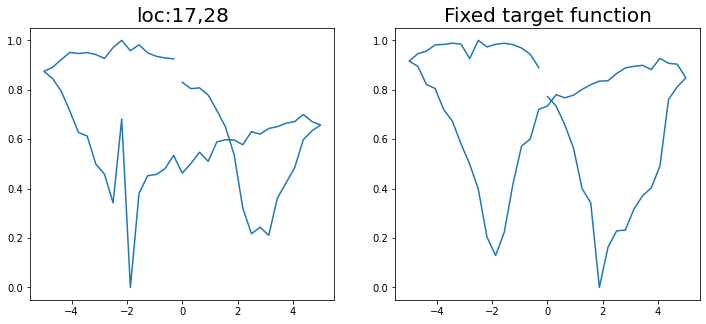

Epoch 1/200 ... Training loss: 5.0742
Epoch 10/200 ... Training loss: 4.3731
Epoch 20/200 ... Training loss: 3.5316
Epoch 30/200 ... Training loss: 3.0435
Epoch 40/200 ... Training loss: 2.8184
Epoch 50/200 ... Training loss: 2.6351
Epoch 60/200 ... Training loss: 2.4776
Epoch 70/200 ... Training loss: 2.3374
Epoch 80/200 ... Training loss: 2.2187
Epoch 90/200 ... Training loss: 2.1085
Epoch 100/200 ... Training loss: 2.013
Epoch 110/200 ... Training loss: 1.9312
Epoch 120/200 ... Training loss: 1.8607
Epoch 130/200 ... Training loss: 1.7963
Epoch 140/200 ... Training loss: 1.7361
Epoch 150/200 ... Training loss: 1.6909
Epoch 160/200 ... Training loss: 1.6172
Epoch 170/200 ... Training loss: 1.5638
Epoch 180/200 ... Training loss: 1.5076
Epoch 190/200 ... Training loss: 1.454
Epoch 200/200 ... Training loss: 1.3965
step:  4
Sample #14




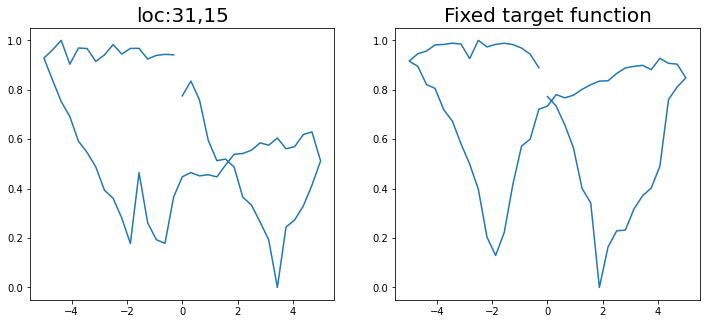

Epoch 1/200 ... Training loss: 4.795
Epoch 10/200 ... Training loss: 4.1954
Epoch 20/200 ... Training loss: 3.6948
Epoch 30/200 ... Training loss: 3.0041
Epoch 40/200 ... Training loss: 2.7031
Epoch 50/200 ... Training loss: 2.5332
Epoch 60/200 ... Training loss: 2.3861
Epoch 70/200 ... Training loss: 2.2521
Epoch 80/200 ... Training loss: 2.1376
Epoch 90/200 ... Training loss: 2.0356
Epoch 100/200 ... Training loss: 1.951
Epoch 110/200 ... Training loss: 1.8798
Epoch 120/200 ... Training loss: 1.8161
Epoch 130/200 ... Training loss: 1.7576
Epoch 140/200 ... Training loss: 1.7029
Epoch 150/200 ... Training loss: 1.6546
Epoch 160/200 ... Training loss: 1.6128
Epoch 170/200 ... Training loss: 1.5645
Epoch 180/200 ... Training loss: 1.5224
Epoch 190/200 ... Training loss: 1.4812
Epoch 200/200 ... Training loss: 1.4475
step:  5
Sample #15




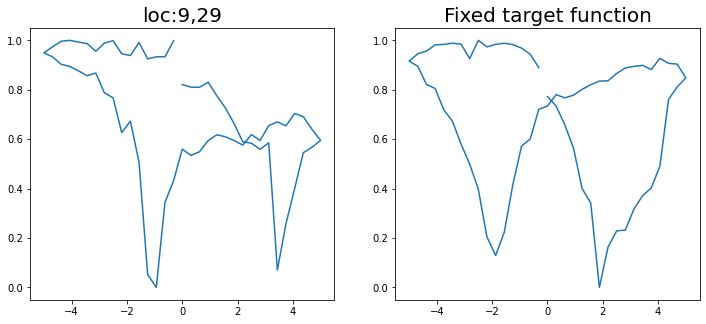

Epoch 1/200 ... Training loss: 4.5413
Epoch 10/200 ... Training loss: 3.6807
Epoch 20/200 ... Training loss: 3.0184
Epoch 30/200 ... Training loss: 2.7842
Epoch 40/200 ... Training loss: 2.5994
Epoch 50/200 ... Training loss: 2.4385
Epoch 60/200 ... Training loss: 2.29
Epoch 70/200 ... Training loss: 2.1522
Epoch 80/200 ... Training loss: 2.0373
Epoch 90/200 ... Training loss: 1.9461
Epoch 100/200 ... Training loss: 1.8639
Epoch 110/200 ... Training loss: 1.7884
Epoch 120/200 ... Training loss: 1.719
Epoch 130/200 ... Training loss: 1.6533
Epoch 140/200 ... Training loss: 1.5939
Epoch 150/200 ... Training loss: 1.5372
Epoch 160/200 ... Training loss: 1.4919
Epoch 170/200 ... Training loss: 1.4278
Epoch 180/200 ... Training loss: 1.3705
Epoch 190/200 ... Training loss: 1.336
Epoch 200/200 ... Training loss: 1.2723
step:  6
Sample #16




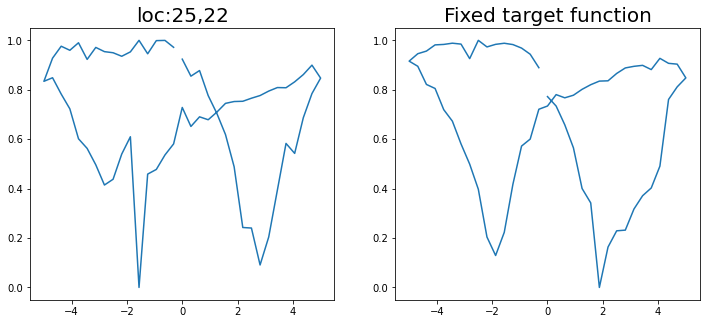

Epoch 1/200 ... Training loss: 4.3679
Epoch 10/200 ... Training loss: 3.8235
Epoch 20/200 ... Training loss: 3.3261
Epoch 30/200 ... Training loss: 2.7437
Epoch 40/200 ... Training loss: 2.5368
Epoch 50/200 ... Training loss: 2.3824
Epoch 60/200 ... Training loss: 2.2398
Epoch 70/200 ... Training loss: 2.0825
Epoch 80/200 ... Training loss: 1.9868
Epoch 90/200 ... Training loss: 1.9081
Epoch 100/200 ... Training loss: 1.8179
Epoch 110/200 ... Training loss: 1.7506
Epoch 120/200 ... Training loss: 1.687
Epoch 130/200 ... Training loss: 1.6284
Epoch 140/200 ... Training loss: 1.5737
Epoch 150/200 ... Training loss: 1.5222
Epoch 160/200 ... Training loss: 1.4734
Epoch 170/200 ... Training loss: 1.4405
Epoch 180/200 ... Training loss: 1.4028
Epoch 190/200 ... Training loss: 1.3495
Epoch 200/200 ... Training loss: 1.3025
step:  7
Sample #17




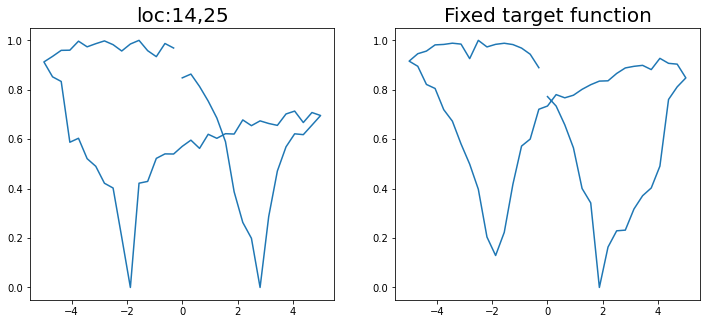

Epoch 1/200 ... Training loss: 4.2376
Epoch 10/200 ... Training loss: 3.291
Epoch 20/200 ... Training loss: 3.0298
Epoch 30/200 ... Training loss: 2.609
Epoch 40/200 ... Training loss: 2.45
Epoch 50/200 ... Training loss: 2.3185
Epoch 60/200 ... Training loss: 2.2036
Epoch 70/200 ... Training loss: 2.0873
Epoch 80/200 ... Training loss: 1.9418
Epoch 90/200 ... Training loss: 1.8448
Epoch 100/200 ... Training loss: 1.7586
Epoch 110/200 ... Training loss: 1.6795
Epoch 120/200 ... Training loss: 1.6093
Epoch 130/200 ... Training loss: 1.5437
Epoch 140/200 ... Training loss: 1.4819
Epoch 150/200 ... Training loss: 1.4231
Epoch 160/200 ... Training loss: 1.3723
Epoch 170/200 ... Training loss: 1.3253
Epoch 180/200 ... Training loss: 1.2823
Epoch 190/200 ... Training loss: 1.2219
Epoch 200/200 ... Training loss: 1.1628
step:  8
Sample #18




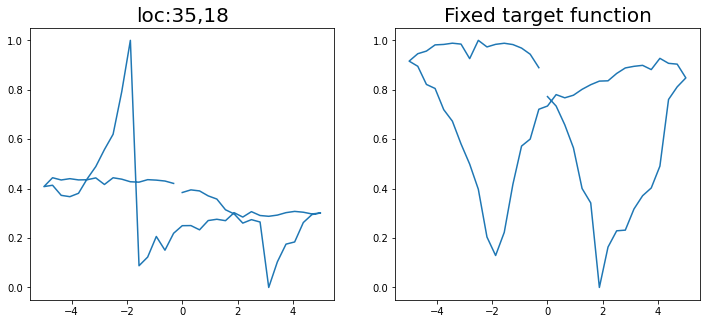

Epoch 1/200 ... Training loss: 4.4368
Epoch 10/200 ... Training loss: 3.8774
Epoch 20/200 ... Training loss: 3.2576
Epoch 30/200 ... Training loss: 2.7605
Epoch 40/200 ... Training loss: 2.3948
Epoch 50/200 ... Training loss: 2.1945
Epoch 60/200 ... Training loss: 2.0487
Epoch 70/200 ... Training loss: 1.9349
Epoch 80/200 ... Training loss: 1.8449
Epoch 90/200 ... Training loss: 1.768
Epoch 100/200 ... Training loss: 1.7025
Epoch 110/200 ... Training loss: 1.6435
Epoch 120/200 ... Training loss: 1.5981
Epoch 130/200 ... Training loss: 1.5447
Epoch 140/200 ... Training loss: 1.5039
Epoch 150/200 ... Training loss: 1.4595
Epoch 160/200 ... Training loss: 1.4186
Epoch 170/200 ... Training loss: 1.3804
Epoch 180/200 ... Training loss: 1.3448
Epoch 190/200 ... Training loss: 1.3102
Epoch 200/200 ... Training loss: 1.277
step:  9
Sample #19




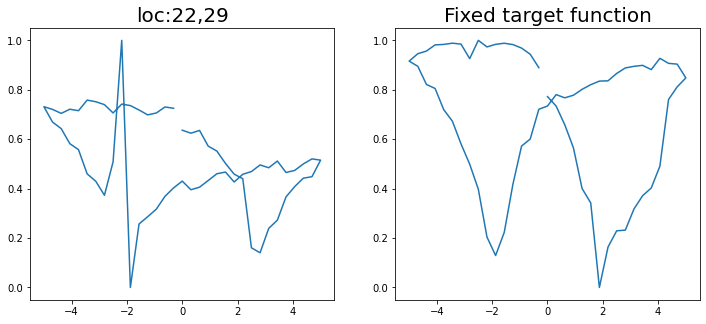

Epoch 1/200 ... Training loss: 4.2805
Epoch 10/200 ... Training loss: 3.5814
Epoch 20/200 ... Training loss: 2.7392
Epoch 30/200 ... Training loss: 2.4626
Epoch 40/200 ... Training loss: 2.2662
Epoch 50/200 ... Training loss: 2.111
Epoch 60/200 ... Training loss: 1.9829
Epoch 70/200 ... Training loss: 1.876
Epoch 80/200 ... Training loss: 1.7777
Epoch 90/200 ... Training loss: 1.7
Epoch 100/200 ... Training loss: 1.632
Epoch 110/200 ... Training loss: 1.5706
Epoch 120/200 ... Training loss: 1.51
Epoch 130/200 ... Training loss: 1.6027
Epoch 140/200 ... Training loss: 1.4444
Epoch 150/200 ... Training loss: 1.3678
Epoch 160/200 ... Training loss: 1.3247
Epoch 170/200 ... Training loss: 1.2796
Epoch 180/200 ... Training loss: 1.2383
Epoch 190/200 ... Training loss: 1.1983
Epoch 200/200 ... Training loss: 1.2838
step:  10
Sample #20




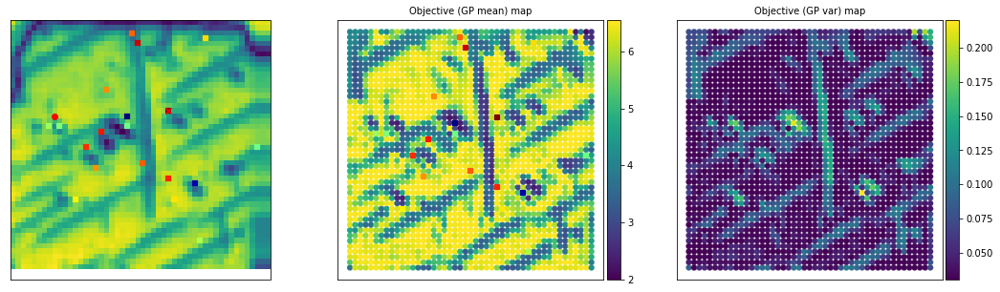

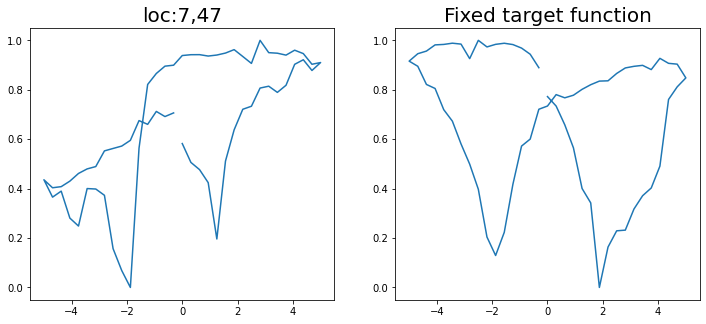

Epoch 1/200 ... Training loss: 4.1855
Epoch 10/200 ... Training loss: 3.5908
Epoch 20/200 ... Training loss: 2.9936
Epoch 30/200 ... Training loss: 2.5611
Epoch 40/200 ... Training loss: 2.2949
Epoch 50/200 ... Training loss: 2.0911
Epoch 60/200 ... Training loss: 1.9721
Epoch 70/200 ... Training loss: 1.866
Epoch 80/200 ... Training loss: 1.7763
Epoch 90/200 ... Training loss: 1.6984
Epoch 100/200 ... Training loss: 1.6359
Epoch 110/200 ... Training loss: 1.5724
Epoch 120/200 ... Training loss: 1.5204
Epoch 130/200 ... Training loss: 1.4701
Epoch 140/200 ... Training loss: 1.4443
Epoch 150/200 ... Training loss: 1.3828
Epoch 160/200 ... Training loss: 1.3402
Epoch 170/200 ... Training loss: 1.2996
Epoch 180/200 ... Training loss: 1.269
Epoch 190/200 ... Training loss: 1.2471
Epoch 200/200 ... Training loss: 1.193
step:  11
Sample #21




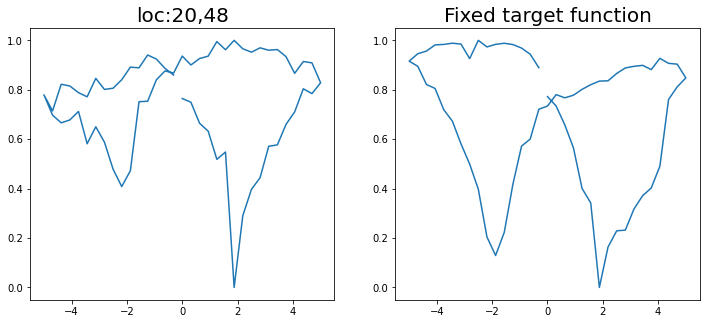

Epoch 1/200 ... Training loss: 4.0978
Epoch 10/200 ... Training loss: 3.3657
Epoch 20/200 ... Training loss: 2.8206
Epoch 30/200 ... Training loss: 2.3968
Epoch 40/200 ... Training loss: 2.1454
Epoch 50/200 ... Training loss: 1.9963
Epoch 60/200 ... Training loss: 1.8796
Epoch 70/200 ... Training loss: 1.7809
Epoch 80/200 ... Training loss: 1.7151
Epoch 90/200 ... Training loss: 1.6328
Epoch 100/200 ... Training loss: 1.5691
Epoch 110/200 ... Training loss: 1.5047
Epoch 120/200 ... Training loss: 1.4704
Epoch 130/200 ... Training loss: 1.4018
Epoch 140/200 ... Training loss: 1.3597
Epoch 150/200 ... Training loss: 1.3278
Epoch 160/200 ... Training loss: 1.2781
Epoch 170/200 ... Training loss: 1.2671
Epoch 180/200 ... Training loss: 1.1966
Epoch 190/200 ... Training loss: 1.1835
Epoch 200/200 ... Training loss: 1.1287
step:  12
Sample #22




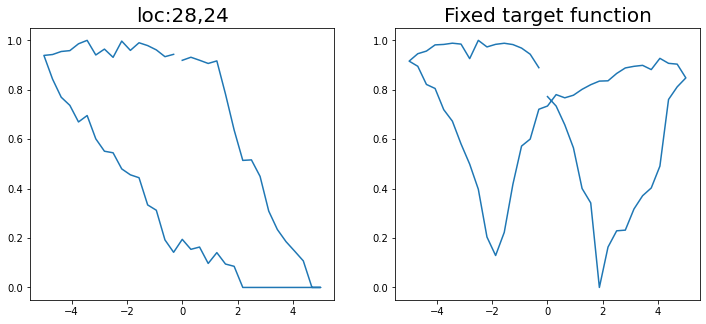

Epoch 1/200 ... Training loss: 4.3791
Epoch 10/200 ... Training loss: 3.9153
Epoch 20/200 ... Training loss: 3.124
Epoch 30/200 ... Training loss: 2.776
Epoch 40/200 ... Training loss: 2.5449
Epoch 50/200 ... Training loss: 2.3083
Epoch 60/200 ... Training loss: 2.11
Epoch 70/200 ... Training loss: 1.8812
Epoch 80/200 ... Training loss: 1.7689
Epoch 90/200 ... Training loss: 1.6891
Epoch 100/200 ... Training loss: 1.6187
Epoch 110/200 ... Training loss: 1.5728
Epoch 120/200 ... Training loss: 1.5262
Epoch 130/200 ... Training loss: 1.486
Epoch 140/200 ... Training loss: 1.4434
Epoch 150/200 ... Training loss: 1.409
Epoch 160/200 ... Training loss: 1.3748
Epoch 170/200 ... Training loss: 1.3421
Epoch 180/200 ... Training loss: 1.3305
Epoch 190/200 ... Training loss: 1.2862
Epoch 200/200 ... Training loss: 1.2527
step:  13
Sample #23




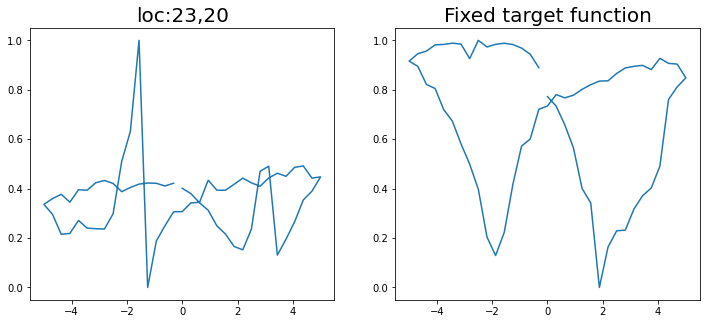

Epoch 1/200 ... Training loss: 4.3945
Epoch 10/200 ... Training loss: 3.9087
Epoch 20/200 ... Training loss: 3.4078
Epoch 30/200 ... Training loss: 2.8767
Epoch 40/200 ... Training loss: 2.639
Epoch 50/200 ... Training loss: 2.2791
Epoch 60/200 ... Training loss: 2.1124
Epoch 70/200 ... Training loss: 1.9675
Epoch 80/200 ... Training loss: 1.8364
Epoch 90/200 ... Training loss: 1.7287
Epoch 100/200 ... Training loss: 1.6872
Epoch 110/200 ... Training loss: 1.6593
Epoch 120/200 ... Training loss: 1.5987
Epoch 130/200 ... Training loss: 1.5334
Epoch 140/200 ... Training loss: 1.4898
Epoch 150/200 ... Training loss: 1.4478
Epoch 160/200 ... Training loss: 1.4176
Epoch 170/200 ... Training loss: 1.3837
Epoch 180/200 ... Training loss: 1.3506
Epoch 190/200 ... Training loss: 1.3279
Epoch 200/200 ... Training loss: 1.3155
step:  14
Sample #24




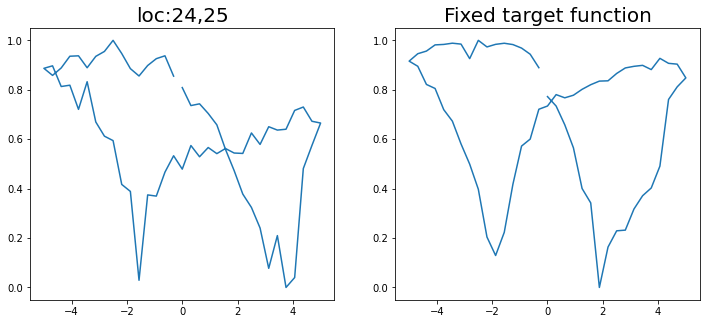

Epoch 1/200 ... Training loss: 4.2537
Epoch 10/200 ... Training loss: 3.2813
Epoch 20/200 ... Training loss: 3.0322
Epoch 30/200 ... Training loss: 2.6236
Epoch 40/200 ... Training loss: 2.2808
Epoch 50/200 ... Training loss: 2.1154
Epoch 60/200 ... Training loss: 1.9732
Epoch 70/200 ... Training loss: 1.835
Epoch 80/200 ... Training loss: 1.7397
Epoch 90/200 ... Training loss: 1.6691
Epoch 100/200 ... Training loss: 1.5929
Epoch 110/200 ... Training loss: 1.531
Epoch 120/200 ... Training loss: 1.6867
Epoch 130/200 ... Training loss: 1.4968
Epoch 140/200 ... Training loss: 1.4238
Epoch 150/200 ... Training loss: 1.3843
Epoch 160/200 ... Training loss: 1.3226
Epoch 170/200 ... Training loss: 1.2809
Epoch 180/200 ... Training loss: 1.2513
Epoch 190/200 ... Training loss: 1.2033
Epoch 200/200 ... Training loss: 1.2043
step:  15
Sample #25




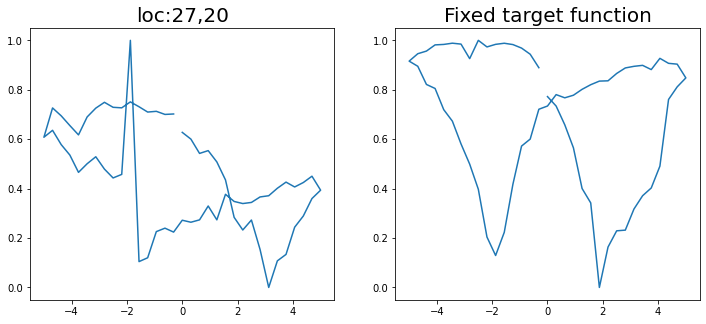

Epoch 1/200 ... Training loss: 4.1355
Epoch 10/200 ... Training loss: 3.6282
Epoch 20/200 ... Training loss: 3.0491
Epoch 30/200 ... Training loss: 2.6674
Epoch 40/200 ... Training loss: 2.5247
Epoch 50/200 ... Training loss: 2.4025
Epoch 60/200 ... Training loss: 2.2203
Epoch 70/200 ... Training loss: 1.9443
Epoch 80/200 ... Training loss: 1.7514
Epoch 90/200 ... Training loss: 1.6358
Epoch 100/200 ... Training loss: 1.5647
Epoch 110/200 ... Training loss: 1.5106
Epoch 120/200 ... Training loss: 1.4661
Epoch 130/200 ... Training loss: 1.4306
Epoch 140/200 ... Training loss: 1.4139
Epoch 150/200 ... Training loss: 1.3739
Epoch 160/200 ... Training loss: 1.328
Epoch 170/200 ... Training loss: 1.2927
Epoch 180/200 ... Training loss: 1.2676
Epoch 190/200 ... Training loss: 1.2332
Epoch 200/200 ... Training loss: 1.2212
step:  16
Sample #26




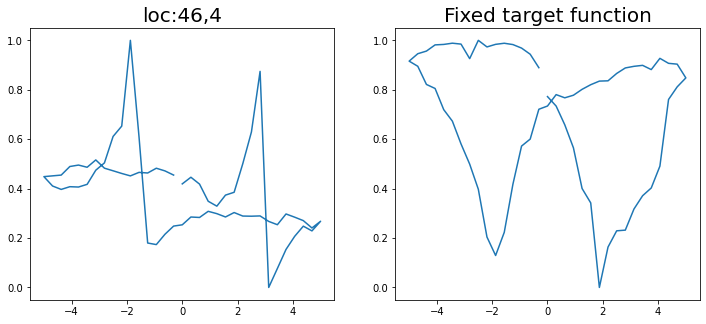

Epoch 1/200 ... Training loss: 4.4199
Epoch 10/200 ... Training loss: 3.5906
Epoch 20/200 ... Training loss: 3.1205
Epoch 30/200 ... Training loss: 2.8597
Epoch 40/200 ... Training loss: 2.6256
Epoch 50/200 ... Training loss: 2.2771
Epoch 60/200 ... Training loss: 2.1061
Epoch 70/200 ... Training loss: 1.8758
Epoch 80/200 ... Training loss: 1.6941
Epoch 90/200 ... Training loss: 1.6178
Epoch 100/200 ... Training loss: 1.608
Epoch 110/200 ... Training loss: 1.5973
Epoch 120/200 ... Training loss: 1.5279
Epoch 130/200 ... Training loss: 1.4684
Epoch 140/200 ... Training loss: 1.4018
Epoch 150/200 ... Training loss: 1.3579
Epoch 160/200 ... Training loss: 1.3242
Epoch 170/200 ... Training loss: 1.296
Epoch 180/200 ... Training loss: 1.268
Epoch 190/200 ... Training loss: 1.2404
Epoch 200/200 ... Training loss: 1.2132
step:  17
Sample #27




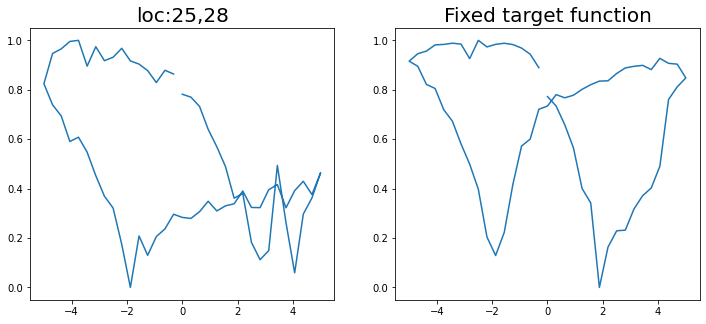

Epoch 1/200 ... Training loss: 4.2928
Epoch 10/200 ... Training loss: 3.9442
Epoch 20/200 ... Training loss: 3.5518
Epoch 30/200 ... Training loss: 3.054
Epoch 40/200 ... Training loss: 2.7846
Epoch 50/200 ... Training loss: 2.5665
Epoch 60/200 ... Training loss: 2.3583
Epoch 70/200 ... Training loss: 2.083
Epoch 80/200 ... Training loss: 1.9655
Epoch 90/200 ... Training loss: 2.0284
Epoch 100/200 ... Training loss: 1.794
Epoch 110/200 ... Training loss: 1.6944
Epoch 120/200 ... Training loss: 1.5874
Epoch 130/200 ... Training loss: 1.5257
Epoch 140/200 ... Training loss: 1.4814
Epoch 150/200 ... Training loss: 1.4797
Epoch 160/200 ... Training loss: 1.4165
Epoch 170/200 ... Training loss: 1.3884
Epoch 180/200 ... Training loss: 1.3672
Epoch 190/200 ... Training loss: 1.345
Epoch 200/200 ... Training loss: 1.3093
step:  18
Sample #28




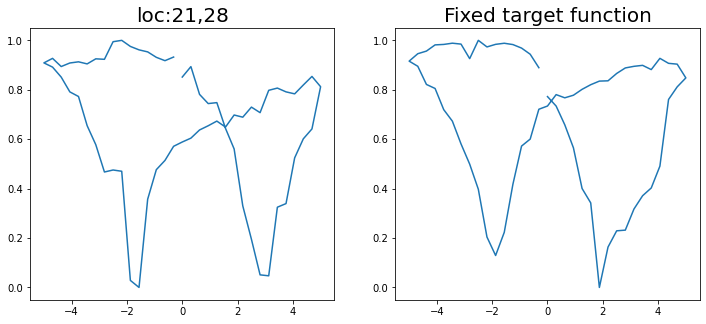

Epoch 1/200 ... Training loss: 4.3458
Epoch 10/200 ... Training loss: 3.4425
Epoch 20/200 ... Training loss: 3.2695
Epoch 30/200 ... Training loss: 2.9112
Epoch 40/200 ... Training loss: 2.6535
Epoch 50/200 ... Training loss: 2.4518
Epoch 60/200 ... Training loss: 2.1517
Epoch 70/200 ... Training loss: 2.0525
Epoch 80/200 ... Training loss: 1.8711
Epoch 90/200 ... Training loss: 1.8339
Epoch 100/200 ... Training loss: 1.6771
Epoch 110/200 ... Training loss: 1.5671
Epoch 120/200 ... Training loss: 1.4955
Epoch 130/200 ... Training loss: 1.4541
Epoch 140/200 ... Training loss: 1.4189
Epoch 150/200 ... Training loss: 1.3906
Epoch 160/200 ... Training loss: 1.357
Epoch 170/200 ... Training loss: 1.3257
Epoch 180/200 ... Training loss: 1.2884
Epoch 190/200 ... Training loss: 1.2611
Epoch 200/200 ... Training loss: 1.2386
step:  19
Sample #29




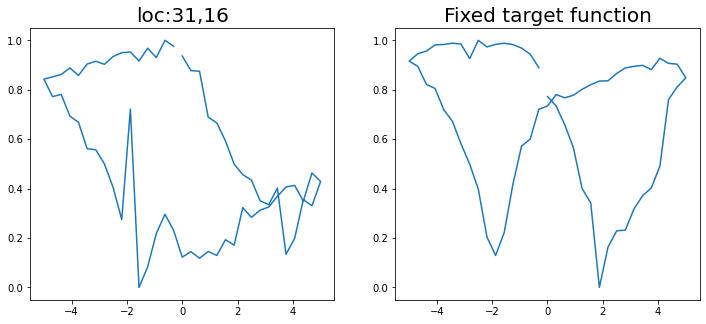

Epoch 1/200 ... Training loss: 4.2564
Epoch 10/200 ... Training loss: 4.0993
Epoch 20/200 ... Training loss: 3.5781
Epoch 30/200 ... Training loss: 3.1252
Epoch 40/200 ... Training loss: 2.9023
Epoch 50/200 ... Training loss: 2.7495
Epoch 60/200 ... Training loss: 2.5665
Epoch 70/200 ... Training loss: 2.2771
Epoch 80/200 ... Training loss: 2.2605
Epoch 90/200 ... Training loss: 1.9877
Epoch 100/200 ... Training loss: 1.8053
Epoch 110/200 ... Training loss: 1.813
Epoch 120/200 ... Training loss: 1.6949
Epoch 130/200 ... Training loss: 1.6144
Epoch 140/200 ... Training loss: 1.8582
Epoch 150/200 ... Training loss: 1.6667
Epoch 160/200 ... Training loss: 1.6495
Epoch 170/200 ... Training loss: 1.5952
Epoch 180/200 ... Training loss: 1.7192
Epoch 190/200 ... Training loss: 1.5006
Epoch 200/200 ... Training loss: 1.445
step:  20
Sample #30




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


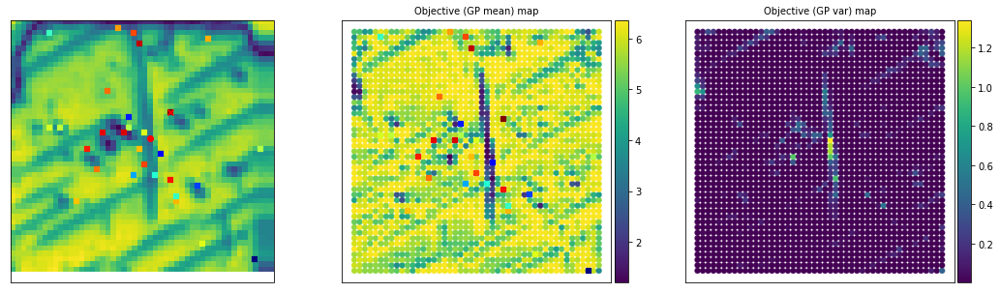

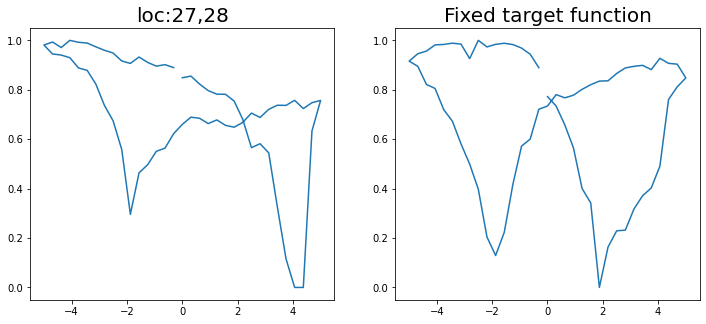

Epoch 1/200 ... Training loss: 4.144
Epoch 10/200 ... Training loss: 4.0443
Epoch 20/200 ... Training loss: 3.6396
Epoch 30/200 ... Training loss: 3.1553
Epoch 40/200 ... Training loss: 2.9428
Epoch 50/200 ... Training loss: 2.7894
Epoch 60/200 ... Training loss: 2.6885
Epoch 70/200 ... Training loss: 2.5882
Epoch 80/200 ... Training loss: 2.4412
Epoch 90/200 ... Training loss: 2.1821
Epoch 100/200 ... Training loss: 1.9198
Epoch 110/200 ... Training loss: 1.7077
Epoch 120/200 ... Training loss: 1.6082
Epoch 130/200 ... Training loss: 1.5236
Epoch 140/200 ... Training loss: 1.4787
Epoch 150/200 ... Training loss: 1.445
Epoch 160/200 ... Training loss: 1.431
Epoch 170/200 ... Training loss: 1.3908
Epoch 180/200 ... Training loss: 1.3632
Epoch 190/200 ... Training loss: 1.3569
Epoch 200/200 ... Training loss: 1.3203
step:  21
Sample #31




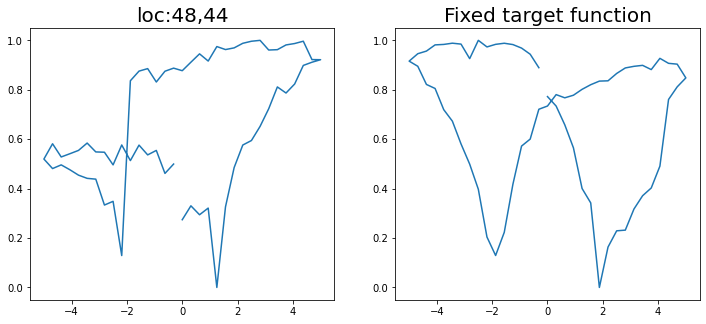

Epoch 1/200 ... Training loss: 4.0043
Epoch 10/200 ... Training loss: 3.8994
Epoch 20/200 ... Training loss: 3.5063
Epoch 30/200 ... Training loss: 3.0738
Epoch 40/200 ... Training loss: 2.8831
Epoch 50/200 ... Training loss: 2.7451
Epoch 60/200 ... Training loss: 2.604
Epoch 70/200 ... Training loss: 2.2632
Epoch 80/200 ... Training loss: 2.4275
Epoch 90/200 ... Training loss: 2.0101
Epoch 100/200 ... Training loss: 1.8892
Epoch 110/200 ... Training loss: 1.7291
Epoch 120/200 ... Training loss: 1.612
Epoch 130/200 ... Training loss: 1.5088
Epoch 140/200 ... Training loss: 1.5416
Epoch 150/200 ... Training loss: 1.4636
Epoch 160/200 ... Training loss: 1.4063
Epoch 170/200 ... Training loss: 1.3656
Epoch 180/200 ... Training loss: 1.4161
Epoch 190/200 ... Training loss: 1.3471
Epoch 200/200 ... Training loss: 1.3009
step:  22
Sample #32




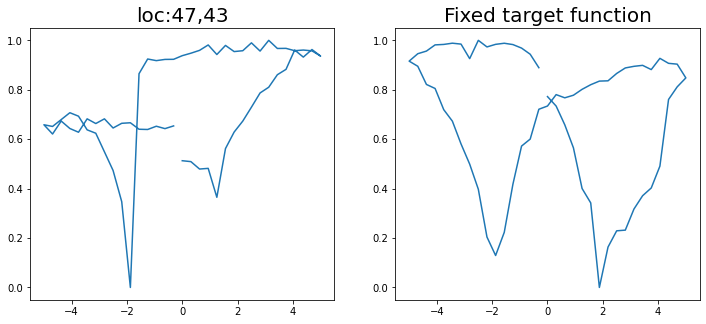

Epoch 1/200 ... Training loss: 3.9535
Epoch 10/200 ... Training loss: 3.7108
Epoch 20/200 ... Training loss: 3.4549
Epoch 30/200 ... Training loss: 3.1015
Epoch 40/200 ... Training loss: 2.822
Epoch 50/200 ... Training loss: 2.6553
Epoch 60/200 ... Training loss: 2.5125
Epoch 70/200 ... Training loss: 2.2788
Epoch 80/200 ... Training loss: 2.2025
Epoch 90/200 ... Training loss: 2.0289
Epoch 100/200 ... Training loss: 1.8786
Epoch 110/200 ... Training loss: 1.7097
Epoch 120/200 ... Training loss: 1.6296
Epoch 130/200 ... Training loss: 1.5067
Epoch 140/200 ... Training loss: 1.4383
Epoch 150/200 ... Training loss: 1.4087
Epoch 160/200 ... Training loss: 1.4697
Epoch 170/200 ... Training loss: 1.4037
Epoch 180/200 ... Training loss: 1.3407
Epoch 190/200 ... Training loss: 1.3067
Epoch 200/200 ... Training loss: 1.3354
step:  23
Sample #33




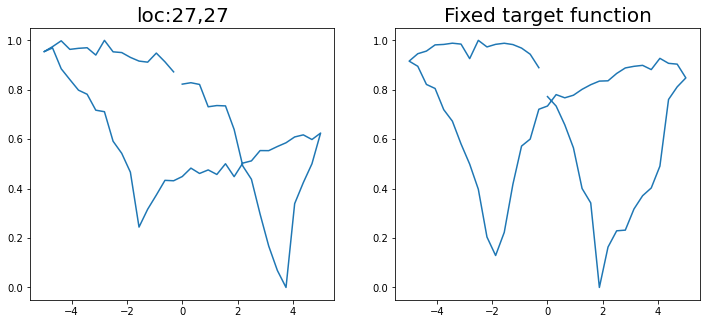

Epoch 1/200 ... Training loss: 3.8583
Epoch 10/200 ... Training loss: 3.6175
Epoch 20/200 ... Training loss: 3.3037
Epoch 30/200 ... Training loss: 2.9329
Epoch 40/200 ... Training loss: 2.7331
Epoch 50/200 ... Training loss: 2.5183
Epoch 60/200 ... Training loss: 2.2748
Epoch 70/200 ... Training loss: 1.9951
Epoch 80/200 ... Training loss: 1.8813
Epoch 90/200 ... Training loss: 1.624
Epoch 100/200 ... Training loss: 1.504
Epoch 110/200 ... Training loss: 1.4542
Epoch 120/200 ... Training loss: 1.4492
Epoch 130/200 ... Training loss: 1.3938
Epoch 140/200 ... Training loss: 1.3649
Epoch 150/200 ... Training loss: 1.3303
Epoch 160/200 ... Training loss: 1.3057
Epoch 170/200 ... Training loss: 1.2818
Epoch 180/200 ... Training loss: 1.2623
Epoch 190/200 ... Training loss: 1.242
Epoch 200/200 ... Training loss: 1.2303
step:  24
Sample #34




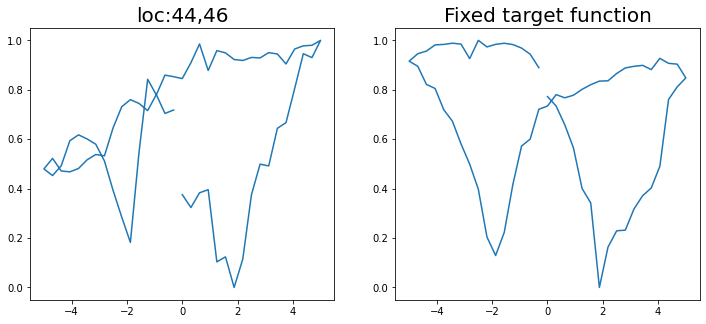

Epoch 1/200 ... Training loss: 3.768
Epoch 10/200 ... Training loss: 3.2962
Epoch 20/200 ... Training loss: 3.0084
Epoch 30/200 ... Training loss: 2.749
Epoch 40/200 ... Training loss: 2.4938
Epoch 50/200 ... Training loss: 2.2131
Epoch 60/200 ... Training loss: 2.1087
Epoch 70/200 ... Training loss: 1.8058
Epoch 80/200 ... Training loss: 1.6058
Epoch 90/200 ... Training loss: 1.6154
Epoch 100/200 ... Training loss: 1.4735
Epoch 110/200 ... Training loss: 1.4477
Epoch 120/200 ... Training loss: 1.3786
Epoch 130/200 ... Training loss: 1.3322
Epoch 140/200 ... Training loss: 1.3034
Epoch 150/200 ... Training loss: 1.2889
Epoch 160/200 ... Training loss: 1.2603
Epoch 170/200 ... Training loss: 1.2957
Epoch 180/200 ... Training loss: 1.2273
Epoch 190/200 ... Training loss: 1.1884
Epoch 200/200 ... Training loss: 1.1512
step:  25
Sample #35




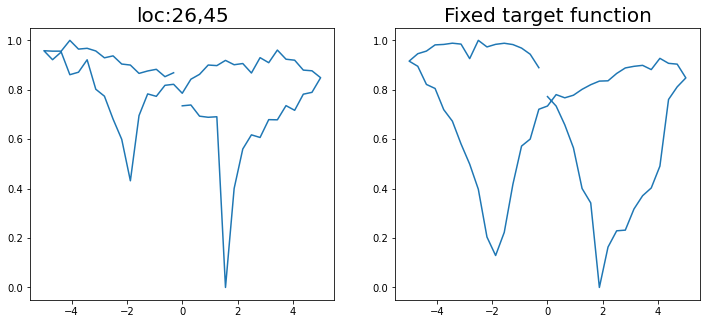

Epoch 1/200 ... Training loss: 3.7048
Epoch 10/200 ... Training loss: 3.4898
Epoch 20/200 ... Training loss: 2.929
Epoch 30/200 ... Training loss: 2.8576
Epoch 40/200 ... Training loss: 2.5926
Epoch 50/200 ... Training loss: 2.3727
Epoch 60/200 ... Training loss: 2.0848
Epoch 70/200 ... Training loss: 2.171
Epoch 80/200 ... Training loss: 1.7719
Epoch 90/200 ... Training loss: 1.6531
Epoch 100/200 ... Training loss: 1.4931
Epoch 110/200 ... Training loss: 1.4453
Epoch 120/200 ... Training loss: 1.3977
Epoch 130/200 ... Training loss: 1.365
Epoch 140/200 ... Training loss: 1.323
Epoch 150/200 ... Training loss: 1.2972
Epoch 160/200 ... Training loss: 1.2787
Epoch 170/200 ... Training loss: 1.2489
Epoch 180/200 ... Training loss: 1.2623
Epoch 190/200 ... Training loss: 1.2215
Epoch 200/200 ... Training loss: 1.1893
step:  26
Sample #36




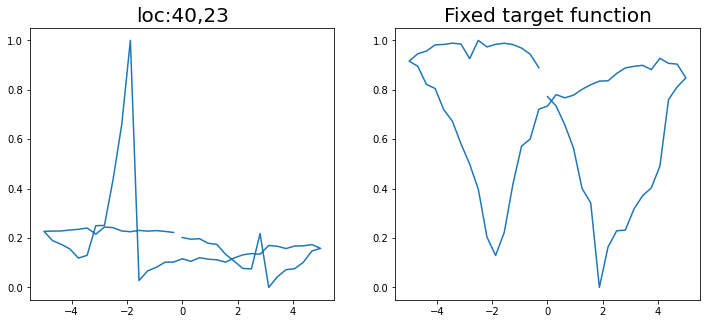

Epoch 1/200 ... Training loss: 3.9519
Epoch 10/200 ... Training loss: 3.7637
Epoch 20/200 ... Training loss: 3.3053
Epoch 30/200 ... Training loss: 2.899
Epoch 40/200 ... Training loss: 2.6017
Epoch 50/200 ... Training loss: 2.1301
Epoch 60/200 ... Training loss: 1.8134
Epoch 70/200 ... Training loss: 1.7224
Epoch 80/200 ... Training loss: 1.6099
Epoch 90/200 ... Training loss: 1.506
Epoch 100/200 ... Training loss: 1.5681
Epoch 110/200 ... Training loss: 1.4307
Epoch 120/200 ... Training loss: 1.3894
Epoch 130/200 ... Training loss: 1.3405
Epoch 140/200 ... Training loss: 1.3251
Epoch 150/200 ... Training loss: 1.3139
Epoch 160/200 ... Training loss: 1.2588
Epoch 170/200 ... Training loss: 1.2693
Epoch 180/200 ... Training loss: 1.2364
Epoch 190/200 ... Training loss: 1.4155
Epoch 200/200 ... Training loss: 1.1985
step:  27
Sample #37




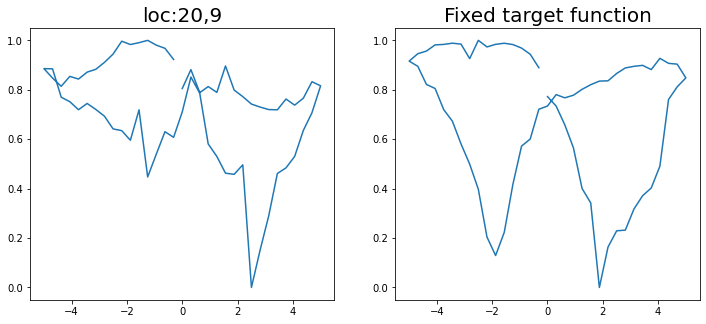

Epoch 1/200 ... Training loss: 3.871
Epoch 10/200 ... Training loss: 3.6857
Epoch 20/200 ... Training loss: 3.3783
Epoch 30/200 ... Training loss: 3.0289
Epoch 40/200 ... Training loss: 2.9096
Epoch 50/200 ... Training loss: 2.6735
Epoch 60/200 ... Training loss: 2.4195
Epoch 70/200 ... Training loss: 1.9715
Epoch 80/200 ... Training loss: 1.7312
Epoch 90/200 ... Training loss: 1.6353
Epoch 100/200 ... Training loss: 1.5137
Epoch 110/200 ... Training loss: 1.5394
Epoch 120/200 ... Training loss: 1.4313
Epoch 130/200 ... Training loss: 1.3833
Epoch 140/200 ... Training loss: 1.3798
Epoch 150/200 ... Training loss: 1.3417
Epoch 160/200 ... Training loss: 1.2772
Epoch 170/200 ... Training loss: 1.2563
Epoch 180/200 ... Training loss: 1.2332
Epoch 190/200 ... Training loss: 1.2502
Epoch 200/200 ... Training loss: 1.2105
step:  28
Sample #38




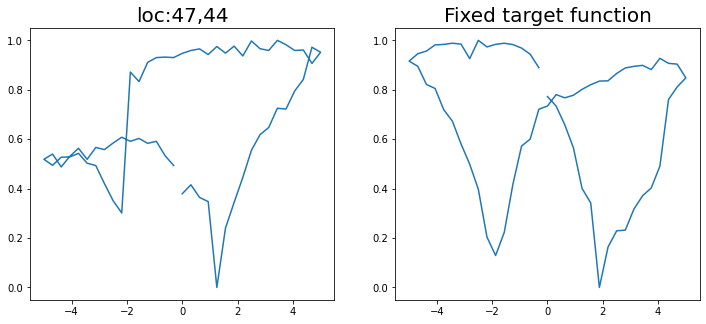

Epoch 1/200 ... Training loss: 3.7938
Epoch 10/200 ... Training loss: 3.5013
Epoch 20/200 ... Training loss: 3.2814
Epoch 30/200 ... Training loss: 3.0418
Epoch 40/200 ... Training loss: 2.7261
Epoch 50/200 ... Training loss: 2.4047
Epoch 60/200 ... Training loss: 2.5395
Epoch 70/200 ... Training loss: 2.1723
Epoch 80/200 ... Training loss: 1.955
Epoch 90/200 ... Training loss: 1.7859
Epoch 100/200 ... Training loss: 1.774
Epoch 110/200 ... Training loss: 1.6215
Epoch 120/200 ... Training loss: 1.5376
Epoch 130/200 ... Training loss: 1.4892
Epoch 140/200 ... Training loss: 1.4429
Epoch 150/200 ... Training loss: 1.5865
Epoch 160/200 ... Training loss: 1.7061
Epoch 170/200 ... Training loss: 1.5057
Epoch 180/200 ... Training loss: 1.4275
Epoch 190/200 ... Training loss: 1.389
Epoch 200/200 ... Training loss: 1.3713
step:  29
Sample #39




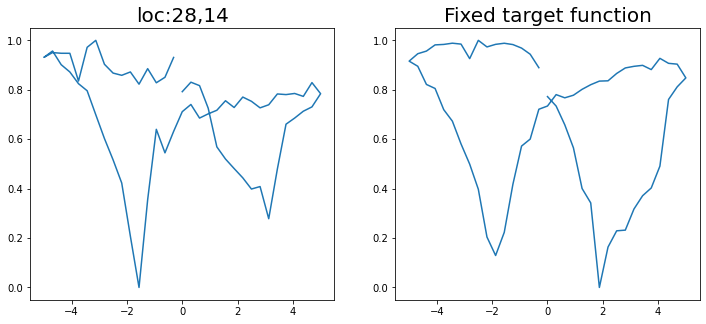

Epoch 1/200 ... Training loss: 3.748
Epoch 10/200 ... Training loss: 3.4751
Epoch 20/200 ... Training loss: 3.2581
Epoch 30/200 ... Training loss: 2.9477
Epoch 40/200 ... Training loss: 2.7587
Epoch 50/200 ... Training loss: 2.5385
Epoch 60/200 ... Training loss: 2.3049
Epoch 70/200 ... Training loss: 2.0462
Epoch 80/200 ... Training loss: 1.7686
Epoch 90/200 ... Training loss: 1.5848
Epoch 100/200 ... Training loss: 1.5914
Epoch 110/200 ... Training loss: 1.4856
Epoch 120/200 ... Training loss: 1.4152
Epoch 130/200 ... Training loss: 1.3789
Epoch 140/200 ... Training loss: 1.3668
Epoch 150/200 ... Training loss: 1.313
Epoch 160/200 ... Training loss: 1.3131
Epoch 170/200 ... Training loss: 1.2707
Epoch 180/200 ... Training loss: 1.24
Epoch 190/200 ... Training loss: 1.2765
Epoch 200/200 ... Training loss: 1.2121
step:  30
Sample #40




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


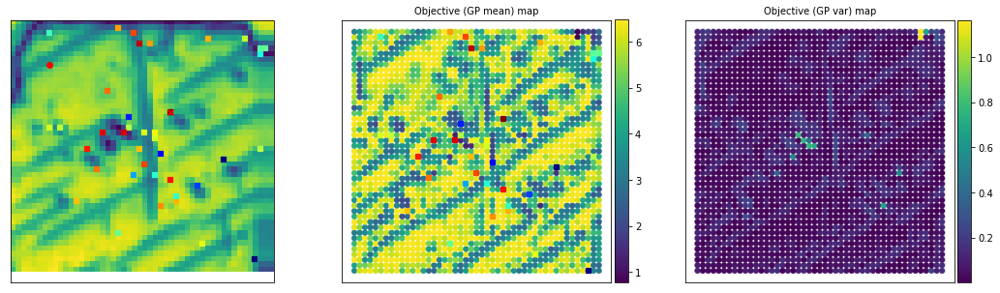

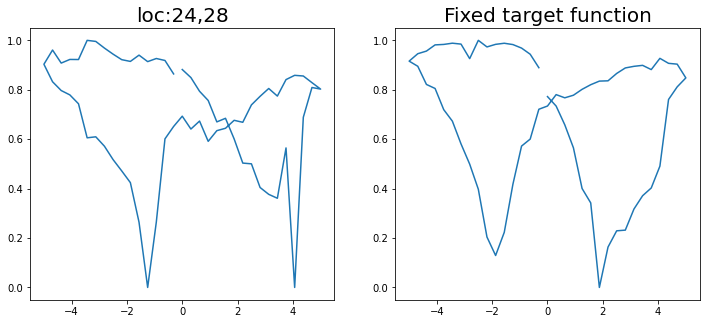

Epoch 1/200 ... Training loss: 3.6814
Epoch 10/200 ... Training loss: 3.4831
Epoch 20/200 ... Training loss: 3.1692
Epoch 30/200 ... Training loss: 2.7833
Epoch 40/200 ... Training loss: 2.5268
Epoch 50/200 ... Training loss: 1.9631
Epoch 60/200 ... Training loss: 1.7391
Epoch 70/200 ... Training loss: 1.6139
Epoch 80/200 ... Training loss: 1.5368
Epoch 90/200 ... Training loss: 1.499
Epoch 100/200 ... Training loss: 1.4049
Epoch 110/200 ... Training loss: 1.3556
Epoch 120/200 ... Training loss: 1.4927
Epoch 130/200 ... Training loss: 1.3582
Epoch 140/200 ... Training loss: 1.2876
Epoch 150/200 ... Training loss: 1.251
Epoch 160/200 ... Training loss: 1.2201
Epoch 170/200 ... Training loss: 1.2075
Epoch 180/200 ... Training loss: 1.2367
Epoch 190/200 ... Training loss: 1.2167
Epoch 200/200 ... Training loss: 1.1539
step:  31
Sample #41




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


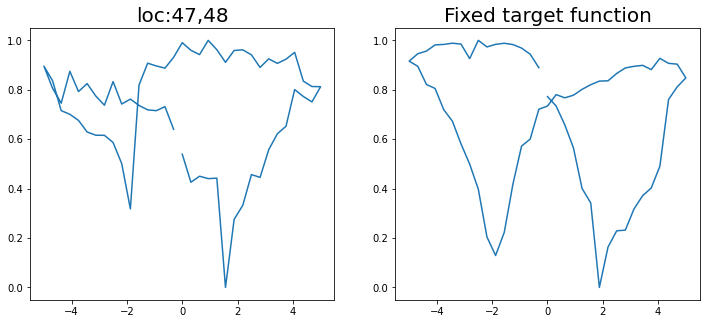

Epoch 1/200 ... Training loss: 3.611
Epoch 10/200 ... Training loss: 3.4195
Epoch 20/200 ... Training loss: 3.0718
Epoch 30/200 ... Training loss: 2.8497
Epoch 40/200 ... Training loss: 2.6126
Epoch 50/200 ... Training loss: 2.4104
Epoch 60/200 ... Training loss: 2.1424
Epoch 70/200 ... Training loss: 1.8456
Epoch 80/200 ... Training loss: 1.6989
Epoch 90/200 ... Training loss: 1.5613
Epoch 100/200 ... Training loss: 1.5447
Epoch 110/200 ... Training loss: 1.4151
Epoch 120/200 ... Training loss: 1.3624
Epoch 130/200 ... Training loss: 1.3661
Epoch 140/200 ... Training loss: 1.3058
Epoch 150/200 ... Training loss: 1.2714
Epoch 160/200 ... Training loss: 1.2704
Epoch 170/200 ... Training loss: 1.2429
Epoch 180/200 ... Training loss: 1.2051
Epoch 190/200 ... Training loss: 1.1966
Epoch 200/200 ... Training loss: 1.2192
step:  32
Sample #42




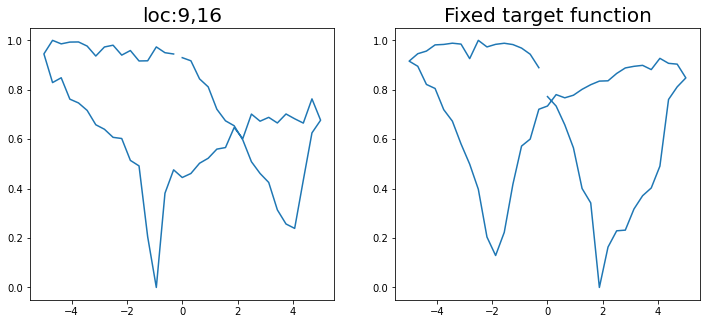

Epoch 1/200 ... Training loss: 3.5432
Epoch 10/200 ... Training loss: 3.353
Epoch 20/200 ... Training loss: 3.0511
Epoch 30/200 ... Training loss: 2.7573
Epoch 40/200 ... Training loss: 2.5497
Epoch 50/200 ... Training loss: 2.3401
Epoch 60/200 ... Training loss: 2.0498
Epoch 70/200 ... Training loss: 1.7995
Epoch 80/200 ... Training loss: 1.6675
Epoch 90/200 ... Training loss: 1.5362
Epoch 100/200 ... Training loss: 1.4983
Epoch 110/200 ... Training loss: 1.4402
Epoch 120/200 ... Training loss: 1.3704
Epoch 130/200 ... Training loss: 1.3538
Epoch 140/200 ... Training loss: 1.395
Epoch 150/200 ... Training loss: 1.3173
Epoch 160/200 ... Training loss: 1.2532
Epoch 170/200 ... Training loss: 1.2837
Epoch 180/200 ... Training loss: 1.2775
Epoch 190/200 ... Training loss: 1.2134
Epoch 200/200 ... Training loss: 1.1752
step:  33
Sample #43




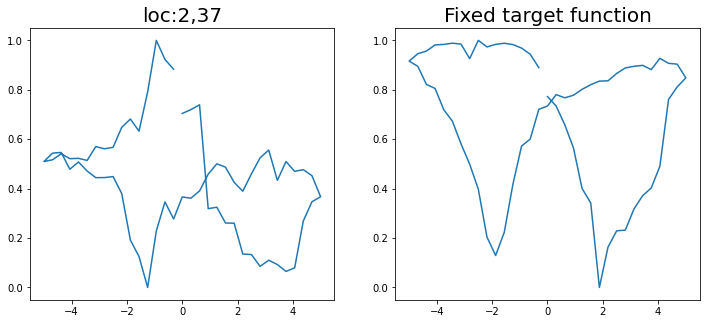

Epoch 1/200 ... Training loss: 3.5031
Epoch 10/200 ... Training loss: 3.2419
Epoch 20/200 ... Training loss: 3.0383
Epoch 30/200 ... Training loss: 2.7776
Epoch 40/200 ... Training loss: 2.4995
Epoch 50/200 ... Training loss: 2.2206
Epoch 60/200 ... Training loss: 2.0455
Epoch 70/200 ... Training loss: 1.8322
Epoch 80/200 ... Training loss: 1.6173
Epoch 90/200 ... Training loss: 1.6054
Epoch 100/200 ... Training loss: 1.4456
Epoch 110/200 ... Training loss: 1.3936
Epoch 120/200 ... Training loss: 1.3851
Epoch 130/200 ... Training loss: 1.3323
Epoch 140/200 ... Training loss: 1.2988
Epoch 150/200 ... Training loss: 1.3502
Epoch 160/200 ... Training loss: 1.3149
Epoch 170/200 ... Training loss: 1.2434
Epoch 180/200 ... Training loss: 1.6547
Epoch 190/200 ... Training loss: 1.3296
Epoch 200/200 ... Training loss: 1.2466
step:  34
Sample #44




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


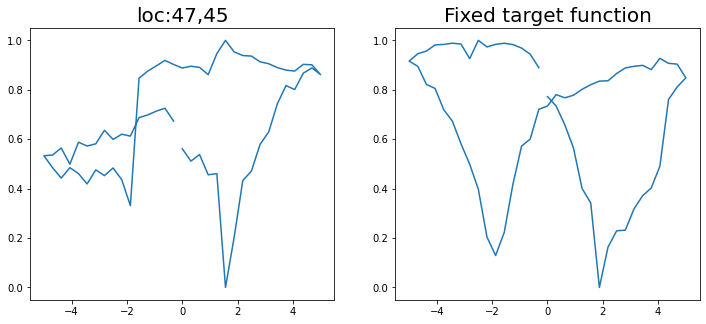

Epoch 1/200 ... Training loss: 3.4583
Epoch 10/200 ... Training loss: 3.1475
Epoch 20/200 ... Training loss: 2.8261
Epoch 30/200 ... Training loss: 2.5839
Epoch 40/200 ... Training loss: 2.3577
Epoch 50/200 ... Training loss: 1.9019
Epoch 60/200 ... Training loss: 1.8998
Epoch 70/200 ... Training loss: 1.7827
Epoch 80/200 ... Training loss: 1.5809
Epoch 90/200 ... Training loss: 1.7799
Epoch 100/200 ... Training loss: 1.5523
Epoch 110/200 ... Training loss: 1.4219
Epoch 120/200 ... Training loss: 1.3743
Epoch 130/200 ... Training loss: 1.3302
Epoch 140/200 ... Training loss: 1.3529
Epoch 150/200 ... Training loss: 1.2653
Epoch 160/200 ... Training loss: 1.2179
Epoch 170/200 ... Training loss: 1.1784
Epoch 180/200 ... Training loss: 1.4674
Epoch 190/200 ... Training loss: 1.271
Epoch 200/200 ... Training loss: 1.1882
step:  35
Sample #45




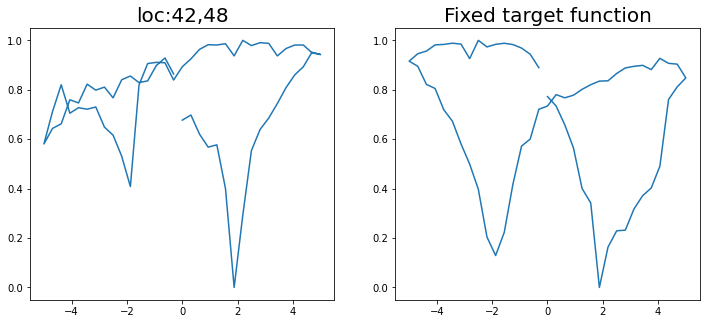

Epoch 1/200 ... Training loss: 3.4008
Epoch 10/200 ... Training loss: 2.8735
Epoch 20/200 ... Training loss: 2.6336
Epoch 30/200 ... Training loss: 2.2157
Epoch 40/200 ... Training loss: 1.958
Epoch 50/200 ... Training loss: 1.8138
Epoch 60/200 ... Training loss: 1.9395
Epoch 70/200 ... Training loss: 1.7211
Epoch 80/200 ... Training loss: 1.5694
Epoch 90/200 ... Training loss: 1.5558
Epoch 100/200 ... Training loss: 1.4759
Epoch 110/200 ... Training loss: 1.4855
Epoch 120/200 ... Training loss: 1.3727
Epoch 130/200 ... Training loss: 1.2929
Epoch 140/200 ... Training loss: 1.2747
Epoch 150/200 ... Training loss: 1.2032
Epoch 160/200 ... Training loss: 1.3166
Epoch 170/200 ... Training loss: 1.2688
Epoch 180/200 ... Training loss: 1.1817
Epoch 190/200 ... Training loss: 1.1303
Epoch 200/200 ... Training loss: 1.1309
step:  36
Sample #46




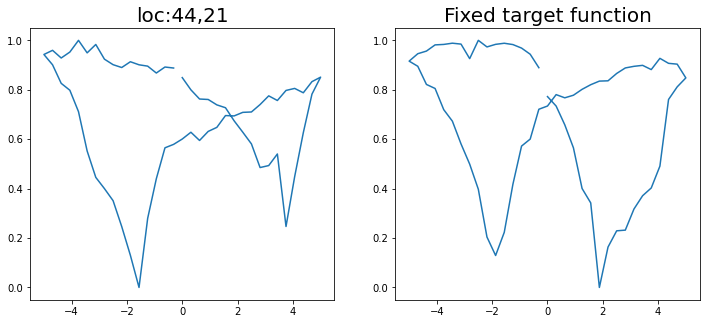

Epoch 1/200 ... Training loss: 3.4018
Epoch 10/200 ... Training loss: 3.1149
Epoch 20/200 ... Training loss: 2.8476
Epoch 30/200 ... Training loss: 2.606
Epoch 40/200 ... Training loss: 2.361
Epoch 50/200 ... Training loss: 2.206
Epoch 60/200 ... Training loss: 1.9661
Epoch 70/200 ... Training loss: 1.7389
Epoch 80/200 ... Training loss: 1.6489
Epoch 90/200 ... Training loss: 1.5629
Epoch 100/200 ... Training loss: 1.4667
Epoch 110/200 ... Training loss: 1.4198
Epoch 120/200 ... Training loss: 1.3629
Epoch 130/200 ... Training loss: 1.2991
Epoch 140/200 ... Training loss: 1.3378
Epoch 150/200 ... Training loss: 1.2694
Epoch 160/200 ... Training loss: 1.2258
Epoch 170/200 ... Training loss: 1.3245
Epoch 180/200 ... Training loss: 1.2368
Epoch 190/200 ... Training loss: 1.1643
Epoch 200/200 ... Training loss: 1.1119
step:  37
Sample #47




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


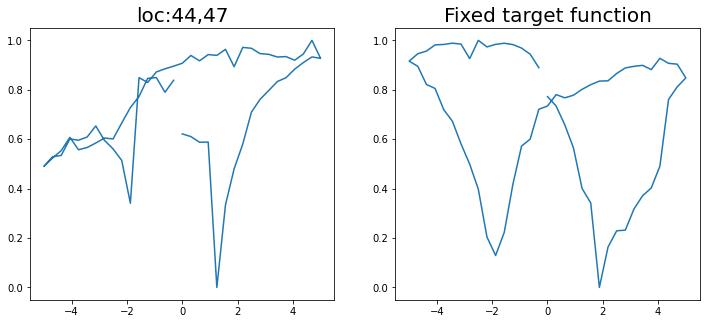

Epoch 1/200 ... Training loss: 3.3831
Epoch 10/200 ... Training loss: 2.8693
Epoch 20/200 ... Training loss: 2.4829
Epoch 30/200 ... Training loss: 2.2151
Epoch 40/200 ... Training loss: 1.928
Epoch 50/200 ... Training loss: 1.707
Epoch 60/200 ... Training loss: 1.7396
Epoch 70/200 ... Training loss: 1.5176
Epoch 80/200 ... Training loss: 1.4236
Epoch 90/200 ... Training loss: 1.5135
Epoch 100/200 ... Training loss: 1.3556
Epoch 110/200 ... Training loss: 1.2862
Epoch 120/200 ... Training loss: 1.3439
Epoch 130/200 ... Training loss: 1.3073
Epoch 140/200 ... Training loss: 1.2254
Epoch 150/200 ... Training loss: 1.1774
Epoch 160/200 ... Training loss: 1.1273
Epoch 170/200 ... Training loss: 1.0801
Epoch 180/200 ... Training loss: 1.0679
Epoch 190/200 ... Training loss: 1.2089
Epoch 200/200 ... Training loss: 1.0789
step:  38
Sample #48




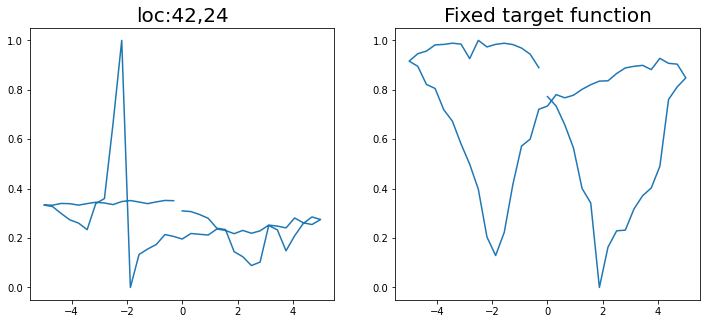

Epoch 1/200 ... Training loss: 3.4064
Epoch 10/200 ... Training loss: 2.8785
Epoch 20/200 ... Training loss: 2.5164
Epoch 30/200 ... Training loss: 2.157
Epoch 40/200 ... Training loss: 2.0454
Epoch 50/200 ... Training loss: 1.8809
Epoch 60/200 ... Training loss: 1.7312
Epoch 70/200 ... Training loss: 1.5881
Epoch 80/200 ... Training loss: 1.532
Epoch 90/200 ... Training loss: 1.5736
Epoch 100/200 ... Training loss: 1.3839
Epoch 110/200 ... Training loss: 1.3065
Epoch 120/200 ... Training loss: 1.2386
Epoch 130/200 ... Training loss: 1.3131
Epoch 140/200 ... Training loss: 1.2379
Epoch 150/200 ... Training loss: 1.1736
Epoch 160/200 ... Training loss: 1.1081
Epoch 170/200 ... Training loss: 1.0554
Epoch 180/200 ... Training loss: 1.0148
Epoch 190/200 ... Training loss: 1.0441
Epoch 200/200 ... Training loss: 0.9841
step:  39
Sample #49




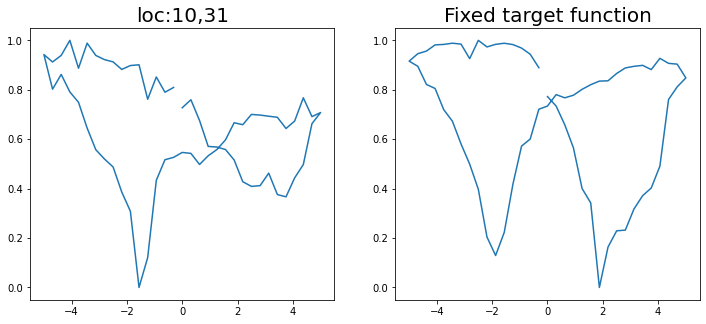

Epoch 1/200 ... Training loss: 3.3691
Epoch 10/200 ... Training loss: 3.093
Epoch 20/200 ... Training loss: 2.8537
Epoch 30/200 ... Training loss: 2.6176
Epoch 40/200 ... Training loss: 2.3546
Epoch 50/200 ... Training loss: 2.129
Epoch 60/200 ... Training loss: 1.8078
Epoch 70/200 ... Training loss: 1.7028
Epoch 80/200 ... Training loss: 1.5871
Epoch 90/200 ... Training loss: 1.4564
Epoch 100/200 ... Training loss: 1.3924
Epoch 110/200 ... Training loss: 1.3375
Epoch 120/200 ... Training loss: 1.3206
Epoch 130/200 ... Training loss: 1.2497
Epoch 140/200 ... Training loss: 1.207
Epoch 150/200 ... Training loss: 1.2711
Epoch 160/200 ... Training loss: 1.202
Epoch 170/200 ... Training loss: 1.1802
Epoch 180/200 ... Training loss: 1.0947
Epoch 190/200 ... Training loss: 1.0983
Epoch 200/200 ... Training loss: 1.0371
step:  40
Sample #50




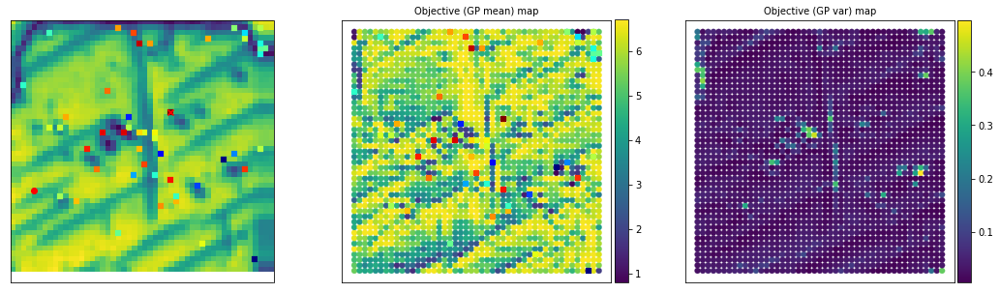

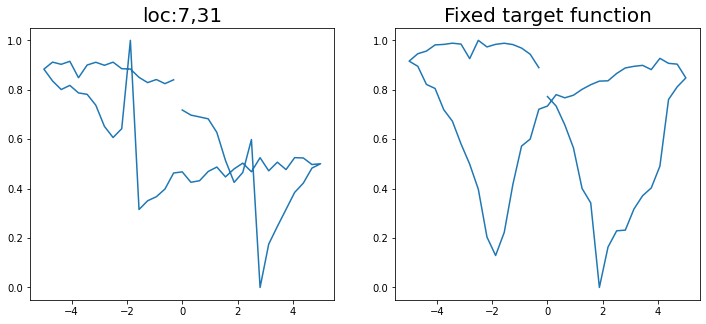

Epoch 1/200 ... Training loss: 3.3204
Epoch 10/200 ... Training loss: 2.9411
Epoch 20/200 ... Training loss: 2.6917
Epoch 30/200 ... Training loss: 2.4214
Epoch 40/200 ... Training loss: 2.1466
Epoch 50/200 ... Training loss: 1.7603
Epoch 60/200 ... Training loss: 1.7403
Epoch 70/200 ... Training loss: 1.788
Epoch 80/200 ... Training loss: 1.4958
Epoch 90/200 ... Training loss: 1.411
Epoch 100/200 ... Training loss: 1.3383
Epoch 110/200 ... Training loss: 1.6288
Epoch 120/200 ... Training loss: 1.3991
Epoch 130/200 ... Training loss: 1.2756
Epoch 140/200 ... Training loss: 1.2388
Epoch 150/200 ... Training loss: 1.1978
Epoch 160/200 ... Training loss: 1.1265
Epoch 170/200 ... Training loss: 1.1838
Epoch 180/200 ... Training loss: 1.1292
Epoch 190/200 ... Training loss: 1.0401
Epoch 200/200 ... Training loss: 1.0208
step:  41
Sample #51




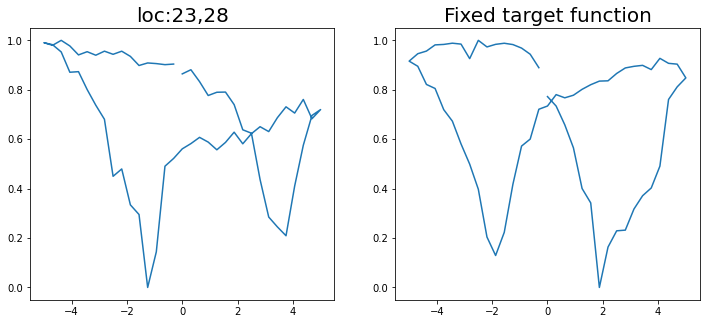

Epoch 1/200 ... Training loss: 3.2739
Epoch 10/200 ... Training loss: 3.0049
Epoch 20/200 ... Training loss: 2.7702
Epoch 30/200 ... Training loss: 2.5405
Epoch 40/200 ... Training loss: 2.3
Epoch 50/200 ... Training loss: 2.0543
Epoch 60/200 ... Training loss: 1.7744
Epoch 70/200 ... Training loss: 1.6353
Epoch 80/200 ... Training loss: 1.5447
Epoch 90/200 ... Training loss: 1.4827
Epoch 100/200 ... Training loss: 1.3768
Epoch 110/200 ... Training loss: 1.3084
Epoch 120/200 ... Training loss: 1.2876
Epoch 130/200 ... Training loss: 1.279
Epoch 140/200 ... Training loss: 1.2507
Epoch 150/200 ... Training loss: 1.1646
Epoch 160/200 ... Training loss: 1.1356
Epoch 170/200 ... Training loss: 1.1655
Epoch 180/200 ... Training loss: 1.1084
Epoch 190/200 ... Training loss: 1.0736
Epoch 200/200 ... Training loss: 1.0865
step:  42
Sample #52




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


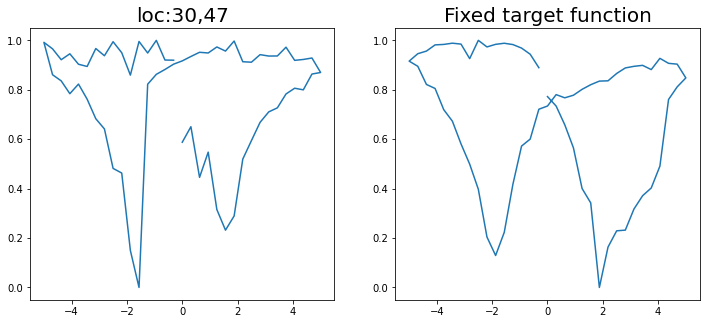

Epoch 1/200 ... Training loss: 3.2312
Epoch 10/200 ... Training loss: 2.9533
Epoch 20/200 ... Training loss: 2.6773
Epoch 30/200 ... Training loss: 2.4836
Epoch 40/200 ... Training loss: 2.2292
Epoch 50/200 ... Training loss: 1.8387
Epoch 60/200 ... Training loss: 1.7502
Epoch 70/200 ... Training loss: 1.5374
Epoch 80/200 ... Training loss: 1.6038
Epoch 90/200 ... Training loss: 1.4664
Epoch 100/200 ... Training loss: 1.3354
Epoch 110/200 ... Training loss: 1.5602
Epoch 120/200 ... Training loss: 1.3525
Epoch 130/200 ... Training loss: 1.3181
Epoch 140/200 ... Training loss: 1.1943
Epoch 150/200 ... Training loss: 1.1552
Epoch 160/200 ... Training loss: 1.1987
Epoch 170/200 ... Training loss: 1.1543
Epoch 180/200 ... Training loss: 1.0814
Epoch 190/200 ... Training loss: 1.0643
Epoch 200/200 ... Training loss: 1.2444
step:  43
Sample #53




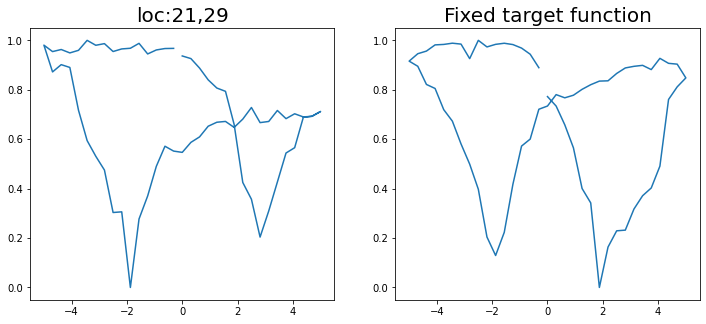

Epoch 1/200 ... Training loss: 3.2354
Epoch 10/200 ... Training loss: 2.8823
Epoch 20/200 ... Training loss: 2.5714
Epoch 30/200 ... Training loss: 2.2079
Epoch 40/200 ... Training loss: 2.0525
Epoch 50/200 ... Training loss: 1.9187
Epoch 60/200 ... Training loss: 1.9366
Epoch 70/200 ... Training loss: 1.6584
Epoch 80/200 ... Training loss: 1.4399
Epoch 90/200 ... Training loss: 1.3864
Epoch 100/200 ... Training loss: 1.3247
Epoch 110/200 ... Training loss: 1.2942
Epoch 120/200 ... Training loss: 1.4017
Epoch 130/200 ... Training loss: 1.2712
Epoch 140/200 ... Training loss: 1.1888
Epoch 150/200 ... Training loss: 1.1501
Epoch 160/200 ... Training loss: 1.3124
Epoch 170/200 ... Training loss: 1.2067
Epoch 180/200 ... Training loss: 1.1601
Epoch 190/200 ... Training loss: 1.031
Epoch 200/200 ... Training loss: 0.996
step:  44
Sample #54




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


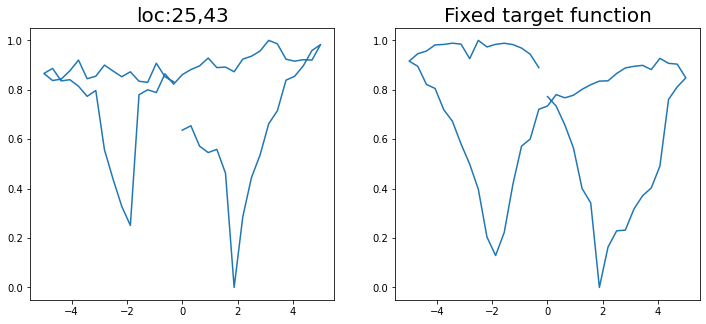

Epoch 1/200 ... Training loss: 3.1933
Epoch 10/200 ... Training loss: 2.7175
Epoch 20/200 ... Training loss: 2.4537
Epoch 30/200 ... Training loss: 2.1957
Epoch 40/200 ... Training loss: 2.1042
Epoch 50/200 ... Training loss: 1.9498
Epoch 60/200 ... Training loss: 1.7012
Epoch 70/200 ... Training loss: 1.4891
Epoch 80/200 ... Training loss: 1.3952
Epoch 90/200 ... Training loss: 1.3417
Epoch 100/200 ... Training loss: 1.2914
Epoch 110/200 ... Training loss: 1.3251
Epoch 120/200 ... Training loss: 1.3327
Epoch 130/200 ... Training loss: 1.2245
Epoch 140/200 ... Training loss: 1.1734
Epoch 150/200 ... Training loss: 1.261
Epoch 160/200 ... Training loss: 1.1193
Epoch 170/200 ... Training loss: 1.0384
Epoch 180/200 ... Training loss: 0.9948
Epoch 190/200 ... Training loss: 1.014
Epoch 200/200 ... Training loss: 1.0244
step:  45
Sample #55




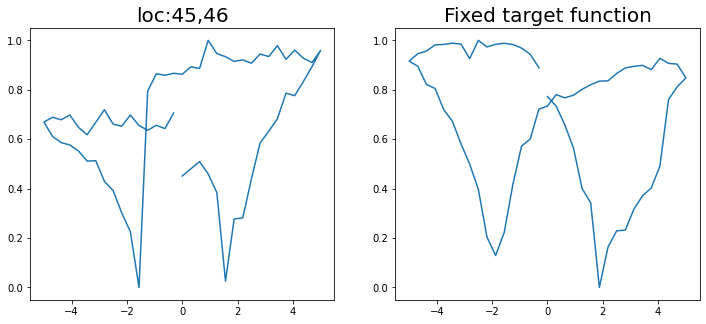

Epoch 1/200 ... Training loss: 3.1513
Epoch 10/200 ... Training loss: 2.7627
Epoch 20/200 ... Training loss: 2.5182
Epoch 30/200 ... Training loss: 2.1613
Epoch 40/200 ... Training loss: 2.0039
Epoch 50/200 ... Training loss: 1.7292
Epoch 60/200 ... Training loss: 1.7341
Epoch 70/200 ... Training loss: 1.5485
Epoch 80/200 ... Training loss: 1.4011
Epoch 90/200 ... Training loss: 1.5841
Epoch 100/200 ... Training loss: 1.3918
Epoch 110/200 ... Training loss: 1.2966
Epoch 120/200 ... Training loss: 1.2135
Epoch 130/200 ... Training loss: 1.1809
Epoch 140/200 ... Training loss: 1.1279
Epoch 150/200 ... Training loss: 1.143
Epoch 160/200 ... Training loss: 1.0725
Epoch 170/200 ... Training loss: 1.0206
Epoch 180/200 ... Training loss: 1.0999
Epoch 190/200 ... Training loss: 0.9807
Epoch 200/200 ... Training loss: 0.9351
step:  46
Sample #56




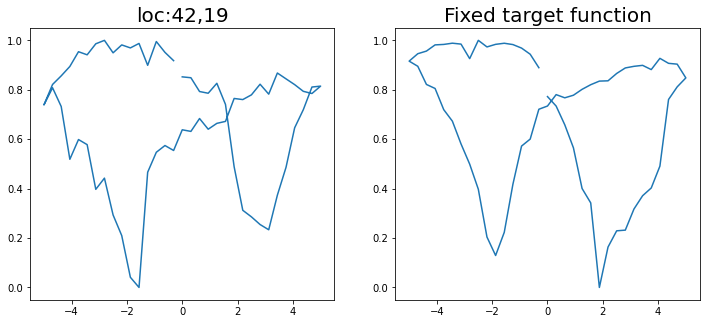

Epoch 1/200 ... Training loss: 3.1623
Epoch 10/200 ... Training loss: 2.7243
Epoch 20/200 ... Training loss: 2.584
Epoch 30/200 ... Training loss: 2.3847
Epoch 40/200 ... Training loss: 2.0683
Epoch 50/200 ... Training loss: 1.992
Epoch 60/200 ... Training loss: 1.6617
Epoch 70/200 ... Training loss: 1.5872
Epoch 80/200 ... Training loss: 1.4824
Epoch 90/200 ... Training loss: 1.3525
Epoch 100/200 ... Training loss: 1.2882
Epoch 110/200 ... Training loss: 1.5433
Epoch 120/200 ... Training loss: 1.3412
Epoch 130/200 ... Training loss: 1.2343
Epoch 140/200 ... Training loss: 1.1795
Epoch 150/200 ... Training loss: 1.1471
Epoch 160/200 ... Training loss: 1.175
Epoch 170/200 ... Training loss: 1.0988
Epoch 180/200 ... Training loss: 1.0672
Epoch 190/200 ... Training loss: 1.0501
Epoch 200/200 ... Training loss: 0.9869
step:  47
Sample #57




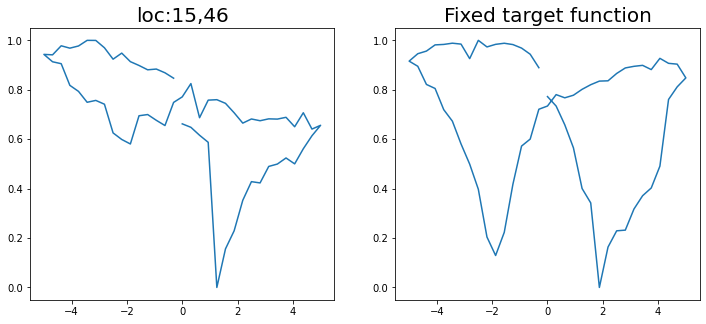

Epoch 1/200 ... Training loss: 3.1205
Epoch 10/200 ... Training loss: 2.6454
Epoch 20/200 ... Training loss: 2.4307
Epoch 30/200 ... Training loss: 2.1828
Epoch 40/200 ... Training loss: 1.8557
Epoch 50/200 ... Training loss: 1.6729
Epoch 60/200 ... Training loss: 1.5263
Epoch 70/200 ... Training loss: 1.4221
Epoch 80/200 ... Training loss: 1.3285
Epoch 90/200 ... Training loss: 1.4083
Epoch 100/200 ... Training loss: 1.2893
Epoch 110/200 ... Training loss: 1.1874
Epoch 120/200 ... Training loss: 1.4998
Epoch 130/200 ... Training loss: 1.2599
Epoch 140/200 ... Training loss: 1.1302
Epoch 150/200 ... Training loss: 1.0585
Epoch 160/200 ... Training loss: 1.2284
Epoch 170/200 ... Training loss: 1.0907
Epoch 180/200 ... Training loss: 1.0192
Epoch 190/200 ... Training loss: 1.0098
Epoch 200/200 ... Training loss: 0.9131
step:  48
Sample #58




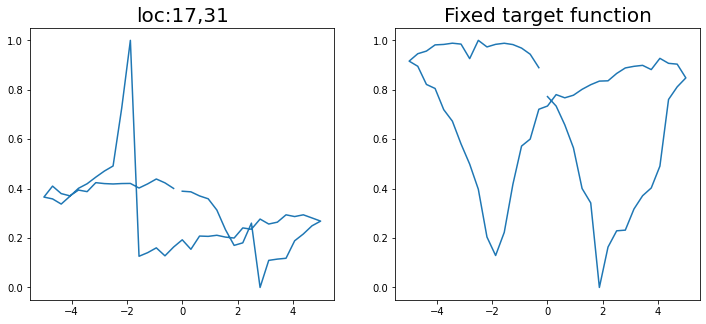

Epoch 1/200 ... Training loss: 3.1875
Epoch 10/200 ... Training loss: 2.9232
Epoch 20/200 ... Training loss: 2.742
Epoch 30/200 ... Training loss: 2.5589
Epoch 40/200 ... Training loss: 2.3935
Epoch 50/200 ... Training loss: 2.2426
Epoch 60/200 ... Training loss: 1.9467
Epoch 70/200 ... Training loss: 1.9115
Epoch 80/200 ... Training loss: 1.8187
Epoch 90/200 ... Training loss: 1.7094
Epoch 100/200 ... Training loss: 1.6188
Epoch 110/200 ... Training loss: 1.4876
Epoch 120/200 ... Training loss: 1.3962
Epoch 130/200 ... Training loss: 1.3794
Epoch 140/200 ... Training loss: 1.3109
Epoch 150/200 ... Training loss: 1.2779
Epoch 160/200 ... Training loss: 1.2505
Epoch 170/200 ... Training loss: 1.2524
Epoch 180/200 ... Training loss: 1.26
Epoch 190/200 ... Training loss: 1.1834
Epoch 200/200 ... Training loss: 1.0956
step:  49
Sample #59




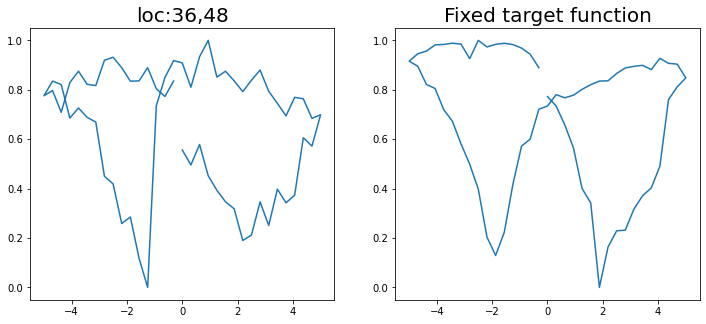

Epoch 1/200 ... Training loss: 3.1469
Epoch 10/200 ... Training loss: 2.8685
Epoch 20/200 ... Training loss: 2.6677
Epoch 30/200 ... Training loss: 2.4785
Epoch 40/200 ... Training loss: 2.3052
Epoch 50/200 ... Training loss: 2.0481
Epoch 60/200 ... Training loss: 1.809
Epoch 70/200 ... Training loss: 1.6821
Epoch 80/200 ... Training loss: 1.641
Epoch 90/200 ... Training loss: 1.5399
Epoch 100/200 ... Training loss: 1.6047
Epoch 110/200 ... Training loss: 1.5293
Epoch 120/200 ... Training loss: 1.4041
Epoch 130/200 ... Training loss: 1.3389
Epoch 140/200 ... Training loss: 1.4349
Epoch 150/200 ... Training loss: 1.2758
Epoch 160/200 ... Training loss: 1.211
Epoch 170/200 ... Training loss: 1.219
Epoch 180/200 ... Training loss: 1.1862
Epoch 190/200 ... Training loss: 1.1051
Epoch 200/200 ... Training loss: 1.0581
step:  50
Sample #60




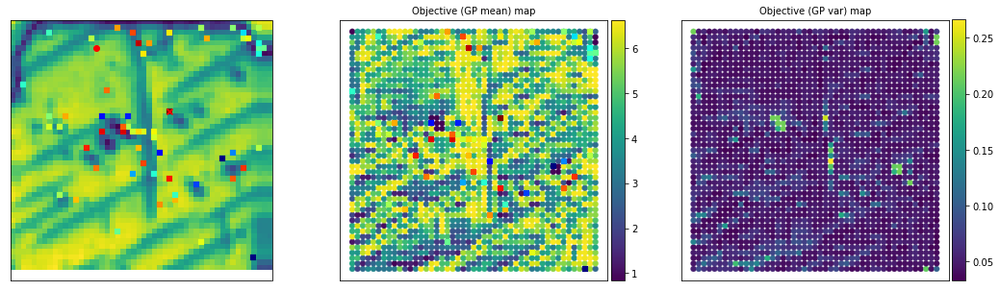

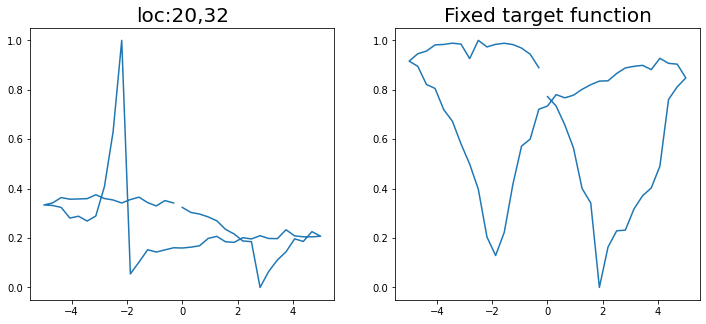

Epoch 1/200 ... Training loss: 3.2024
Epoch 10/200 ... Training loss: 2.7266
Epoch 20/200 ... Training loss: 2.6256
Epoch 30/200 ... Training loss: 2.3195
Epoch 40/200 ... Training loss: 2.1988
Epoch 50/200 ... Training loss: 1.9497
Epoch 60/200 ... Training loss: 1.8082
Epoch 70/200 ... Training loss: 1.8675
Epoch 80/200 ... Training loss: 1.7374
Epoch 90/200 ... Training loss: 1.5609
Epoch 100/200 ... Training loss: 1.4347
Epoch 110/200 ... Training loss: 1.4043
Epoch 120/200 ... Training loss: 1.3268
Epoch 130/200 ... Training loss: 1.2446
Epoch 140/200 ... Training loss: 1.2067
Epoch 150/200 ... Training loss: 1.1743
Epoch 160/200 ... Training loss: 1.1609
Epoch 170/200 ... Training loss: 1.0979
Epoch 180/200 ... Training loss: 1.0913
Epoch 190/200 ... Training loss: 1.0327
Epoch 200/200 ... Training loss: 1.1249
step:  51
Sample #61




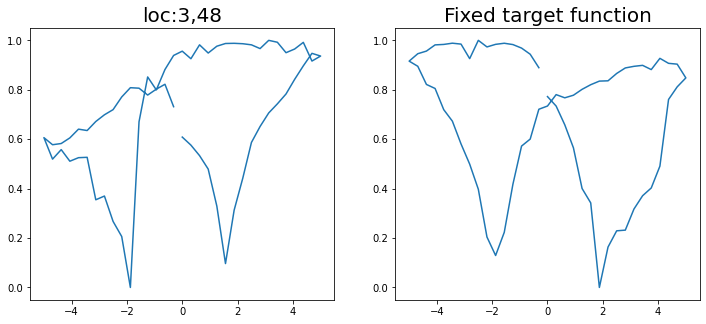

Epoch 1/200 ... Training loss: 3.1913
Epoch 10/200 ... Training loss: 2.8324
Epoch 20/200 ... Training loss: 2.615
Epoch 30/200 ... Training loss: 2.3839
Epoch 40/200 ... Training loss: 2.1877
Epoch 50/200 ... Training loss: 1.9111
Epoch 60/200 ... Training loss: 1.6145
Epoch 70/200 ... Training loss: 1.5223
Epoch 80/200 ... Training loss: 1.4421
Epoch 90/200 ... Training loss: 1.4264
Epoch 100/200 ... Training loss: 1.365
Epoch 110/200 ... Training loss: 1.2716
Epoch 120/200 ... Training loss: 1.1937
Epoch 130/200 ... Training loss: 1.2006
Epoch 140/200 ... Training loss: 1.1041
Epoch 150/200 ... Training loss: 1.0778
Epoch 160/200 ... Training loss: 1.091
Epoch 170/200 ... Training loss: 1.1425
Epoch 180/200 ... Training loss: 1.0904
Epoch 190/200 ... Training loss: 1.0156
Epoch 200/200 ... Training loss: 0.9574
step:  52
Sample #62




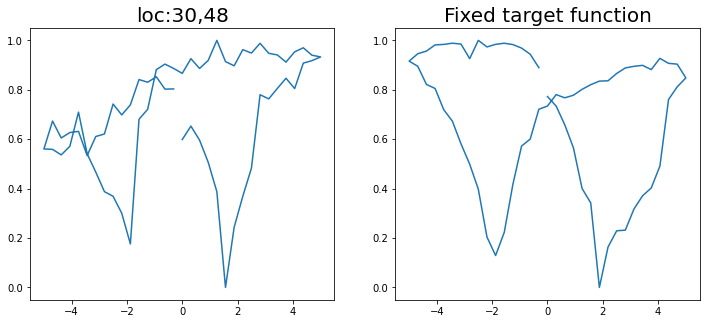

Epoch 1/200 ... Training loss: 3.152
Epoch 10/200 ... Training loss: 2.6976
Epoch 20/200 ... Training loss: 2.426
Epoch 30/200 ... Training loss: 2.1541
Epoch 40/200 ... Training loss: 1.8526
Epoch 50/200 ... Training loss: 1.6467
Epoch 60/200 ... Training loss: 2.2596
Epoch 70/200 ... Training loss: 1.8495
Epoch 80/200 ... Training loss: 1.5463
Epoch 90/200 ... Training loss: 1.563
Epoch 100/200 ... Training loss: 1.3872
Epoch 110/200 ... Training loss: 1.3072
Epoch 120/200 ... Training loss: 1.2739
Epoch 130/200 ... Training loss: 1.2166
Epoch 140/200 ... Training loss: 1.1448
Epoch 150/200 ... Training loss: 1.1634
Epoch 160/200 ... Training loss: 1.2047
Epoch 170/200 ... Training loss: 1.0738
Epoch 180/200 ... Training loss: 1.0309
Epoch 190/200 ... Training loss: 1.0229
Epoch 200/200 ... Training loss: 0.9668
step:  53
Sample #63




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


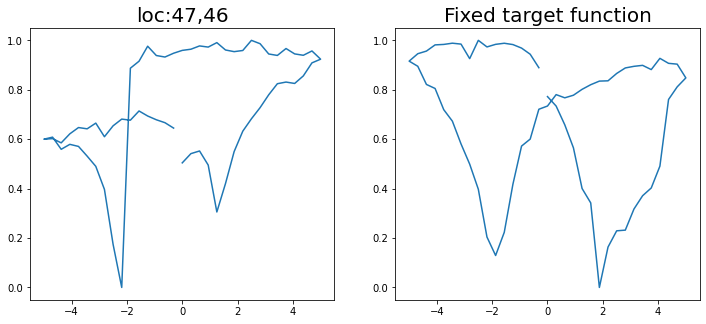

Epoch 1/200 ... Training loss: 3.1145
Epoch 10/200 ... Training loss: 2.7582
Epoch 20/200 ... Training loss: 2.4676
Epoch 30/200 ... Training loss: 2.2741
Epoch 40/200 ... Training loss: 1.9504
Epoch 50/200 ... Training loss: 1.7795
Epoch 60/200 ... Training loss: 1.5725
Epoch 70/200 ... Training loss: 1.4671
Epoch 80/200 ... Training loss: 1.5174
Epoch 90/200 ... Training loss: 1.4175
Epoch 100/200 ... Training loss: 1.4162
Epoch 110/200 ... Training loss: 1.3197
Epoch 120/200 ... Training loss: 1.2342
Epoch 130/200 ... Training loss: 1.2171
Epoch 140/200 ... Training loss: 1.1421
Epoch 150/200 ... Training loss: 1.1555
Epoch 160/200 ... Training loss: 1.1038
Epoch 170/200 ... Training loss: 1.1709
Epoch 180/200 ... Training loss: 1.0322
Epoch 190/200 ... Training loss: 0.9647
Epoch 200/200 ... Training loss: 0.9231
step:  54
Sample #64




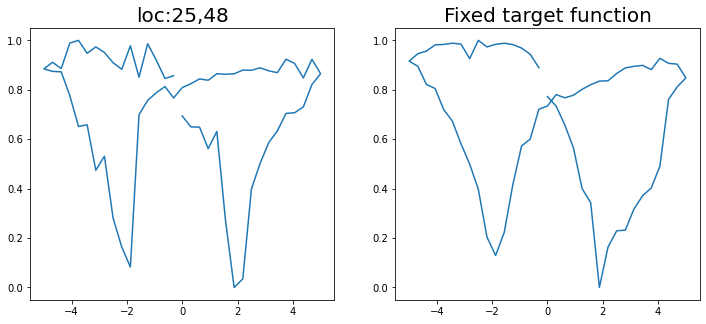

Epoch 1/200 ... Training loss: 3.1148
Epoch 10/200 ... Training loss: 2.5759
Epoch 20/200 ... Training loss: 2.3357
Epoch 30/200 ... Training loss: 2.2419
Epoch 40/200 ... Training loss: 1.9542
Epoch 50/200 ... Training loss: 1.6508
Epoch 60/200 ... Training loss: 1.5919
Epoch 70/200 ... Training loss: 1.4667
Epoch 80/200 ... Training loss: 1.37
Epoch 90/200 ... Training loss: 1.2898
Epoch 100/200 ... Training loss: 1.3791
Epoch 110/200 ... Training loss: 1.3352
Epoch 120/200 ... Training loss: 1.2154
Epoch 130/200 ... Training loss: 1.1496
Epoch 140/200 ... Training loss: 1.1738
Epoch 150/200 ... Training loss: 1.0607
Epoch 160/200 ... Training loss: 1.05
Epoch 170/200 ... Training loss: 1.1983
Epoch 180/200 ... Training loss: 1.0485
Epoch 190/200 ... Training loss: 0.9489
Epoch 200/200 ... Training loss: 1.0968
step:  55
Sample #65




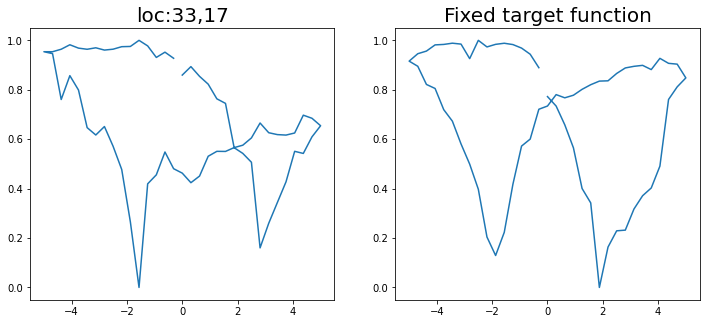

Epoch 1/200 ... Training loss: 3.1022
Epoch 10/200 ... Training loss: 2.8893
Epoch 20/200 ... Training loss: 2.3703
Epoch 30/200 ... Training loss: 2.0131
Epoch 40/200 ... Training loss: 1.9091
Epoch 50/200 ... Training loss: 1.6947
Epoch 60/200 ... Training loss: 1.5768
Epoch 70/200 ... Training loss: 1.4102
Epoch 80/200 ... Training loss: 1.5976
Epoch 90/200 ... Training loss: 1.3559
Epoch 100/200 ... Training loss: 1.3266
Epoch 110/200 ... Training loss: 1.213
Epoch 120/200 ... Training loss: 1.3938
Epoch 130/200 ... Training loss: 1.2104
Epoch 140/200 ... Training loss: 1.1105
Epoch 150/200 ... Training loss: 1.1158
Epoch 160/200 ... Training loss: 1.0428
Epoch 170/200 ... Training loss: 1.0351
Epoch 180/200 ... Training loss: 0.976
Epoch 190/200 ... Training loss: 0.9451
Epoch 200/200 ... Training loss: 0.9541
step:  56
Sample #66




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


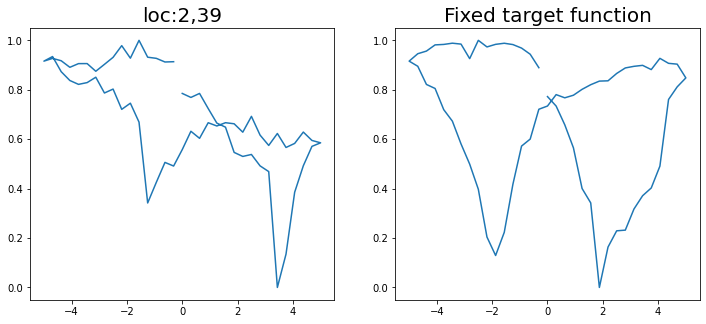

Epoch 1/200 ... Training loss: 3.0732
Epoch 10/200 ... Training loss: 2.7989
Epoch 20/200 ... Training loss: 2.5582
Epoch 30/200 ... Training loss: 2.3384
Epoch 40/200 ... Training loss: 2.1077
Epoch 50/200 ... Training loss: 1.8857
Epoch 60/200 ... Training loss: 1.6945
Epoch 70/200 ... Training loss: 1.779
Epoch 80/200 ... Training loss: 1.4803
Epoch 90/200 ... Training loss: 1.4259
Epoch 100/200 ... Training loss: 1.4814
Epoch 110/200 ... Training loss: 1.3156
Epoch 120/200 ... Training loss: 1.4009
Epoch 130/200 ... Training loss: 1.2332
Epoch 140/200 ... Training loss: 1.2496
Epoch 150/200 ... Training loss: 1.1344
Epoch 160/200 ... Training loss: 1.2335
Epoch 170/200 ... Training loss: 1.0998
Epoch 180/200 ... Training loss: 1.0393
Epoch 190/200 ... Training loss: 1.0069
Epoch 200/200 ... Training loss: 0.9708
step:  57
Sample #67




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


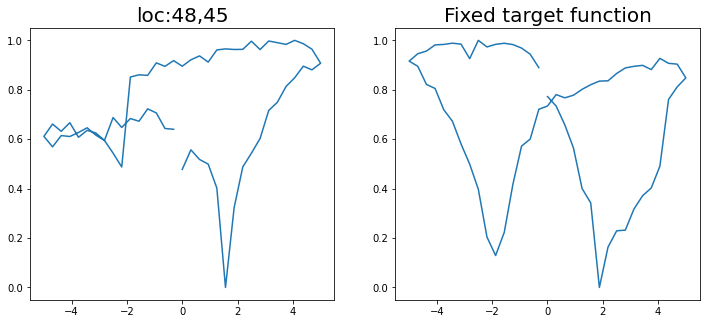

Epoch 1/200 ... Training loss: 3.0403
Epoch 10/200 ... Training loss: 2.7424
Epoch 20/200 ... Training loss: 2.4368
Epoch 30/200 ... Training loss: 2.2542
Epoch 40/200 ... Training loss: 2.0003
Epoch 50/200 ... Training loss: 1.8171
Epoch 60/200 ... Training loss: 1.6069
Epoch 70/200 ... Training loss: 1.4528
Epoch 80/200 ... Training loss: 1.742
Epoch 90/200 ... Training loss: 1.5144
Epoch 100/200 ... Training loss: 1.3876
Epoch 110/200 ... Training loss: 1.2649
Epoch 120/200 ... Training loss: 1.3683
Epoch 130/200 ... Training loss: 1.2239
Epoch 140/200 ... Training loss: 1.1709
Epoch 150/200 ... Training loss: 1.0989
Epoch 160/200 ... Training loss: 1.2297
Epoch 170/200 ... Training loss: 1.3335
Epoch 180/200 ... Training loss: 1.1354
Epoch 190/200 ... Training loss: 1.0471
Epoch 200/200 ... Training loss: 1.0312
step:  58
Sample #68




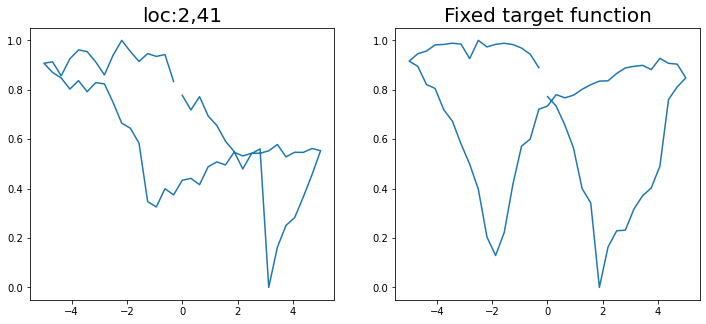

Epoch 1/200 ... Training loss: 3.007
Epoch 10/200 ... Training loss: 2.7287
Epoch 20/200 ... Training loss: 2.4802
Epoch 30/200 ... Training loss: 2.2885
Epoch 40/200 ... Training loss: 2.0802
Epoch 50/200 ... Training loss: 1.8115
Epoch 60/200 ... Training loss: 1.6358
Epoch 70/200 ... Training loss: 1.5098
Epoch 80/200 ... Training loss: 1.4832
Epoch 90/200 ... Training loss: 1.3652
Epoch 100/200 ... Training loss: 1.4129
Epoch 110/200 ... Training loss: 1.3339
Epoch 120/200 ... Training loss: 1.3279
Epoch 130/200 ... Training loss: 1.2451
Epoch 140/200 ... Training loss: 1.1856
Epoch 150/200 ... Training loss: 1.1495
Epoch 160/200 ... Training loss: 1.0926
Epoch 170/200 ... Training loss: 1.0661
Epoch 180/200 ... Training loss: 1.0075
Epoch 190/200 ... Training loss: 1.0033
Epoch 200/200 ... Training loss: 0.9746
step:  59
Sample #69




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


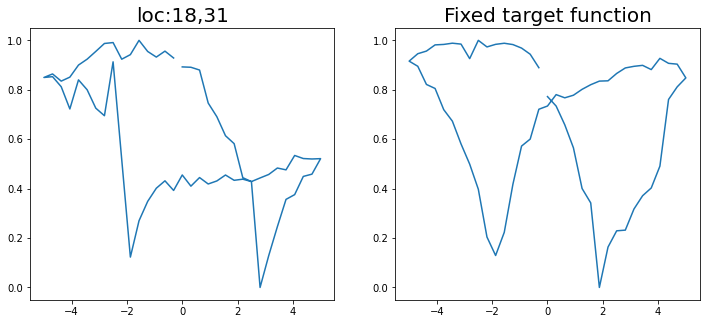

Epoch 1/200 ... Training loss: 2.9744
Epoch 10/200 ... Training loss: 2.6009
Epoch 20/200 ... Training loss: 2.3852
Epoch 30/200 ... Training loss: 2.1871
Epoch 40/200 ... Training loss: 1.9112
Epoch 50/200 ... Training loss: 1.8005
Epoch 60/200 ... Training loss: 1.6028
Epoch 70/200 ... Training loss: 1.5874
Epoch 80/200 ... Training loss: 1.3683
Epoch 90/200 ... Training loss: 1.5618
Epoch 100/200 ... Training loss: 1.4716
Epoch 110/200 ... Training loss: 1.2734
Epoch 120/200 ... Training loss: 1.2546
Epoch 130/200 ... Training loss: 1.2261
Epoch 140/200 ... Training loss: 1.1415
Epoch 150/200 ... Training loss: 1.0852
Epoch 160/200 ... Training loss: 1.0424
Epoch 170/200 ... Training loss: 0.9961
Epoch 180/200 ... Training loss: 0.9941
Epoch 190/200 ... Training loss: 0.9487
Epoch 200/200 ... Training loss: 1.0636
step:  60
Sample #70




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


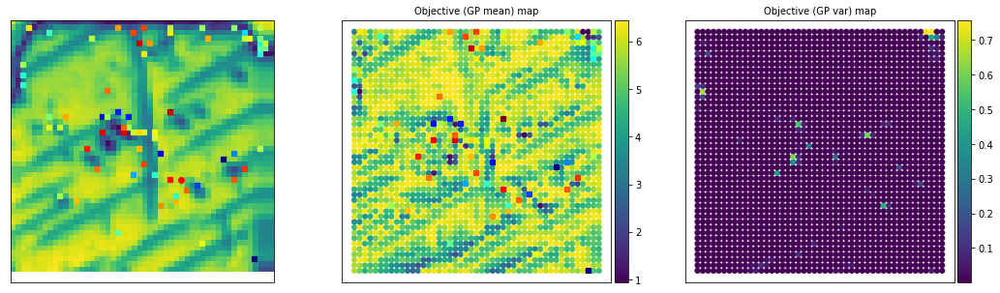

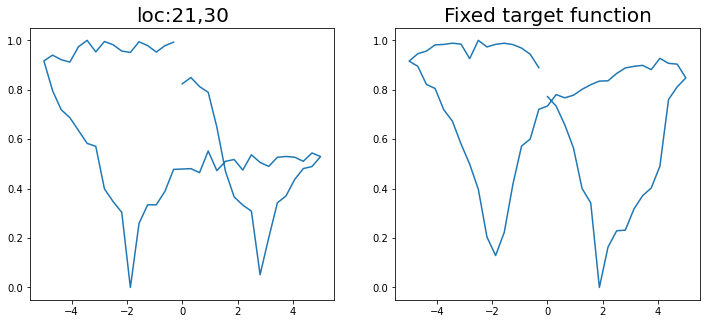

Epoch 1/200 ... Training loss: 2.9661
Epoch 10/200 ... Training loss: 2.6745
Epoch 20/200 ... Training loss: 2.4035
Epoch 30/200 ... Training loss: 2.2419
Epoch 40/200 ... Training loss: 2.0205
Epoch 50/200 ... Training loss: 1.8433
Epoch 60/200 ... Training loss: 1.6251
Epoch 70/200 ... Training loss: 1.5764
Epoch 80/200 ... Training loss: 1.415
Epoch 90/200 ... Training loss: 1.408
Epoch 100/200 ... Training loss: 1.3681
Epoch 110/200 ... Training loss: 1.2965
Epoch 120/200 ... Training loss: 1.2208
Epoch 130/200 ... Training loss: 1.2485
Epoch 140/200 ... Training loss: 1.2668
Epoch 150/200 ... Training loss: 1.321
Epoch 160/200 ... Training loss: 1.127
Epoch 170/200 ... Training loss: 1.0644
Epoch 180/200 ... Training loss: 1.0444
Epoch 190/200 ... Training loss: 0.9884
Epoch 200/200 ... Training loss: 0.9428
step:  61
Sample #71




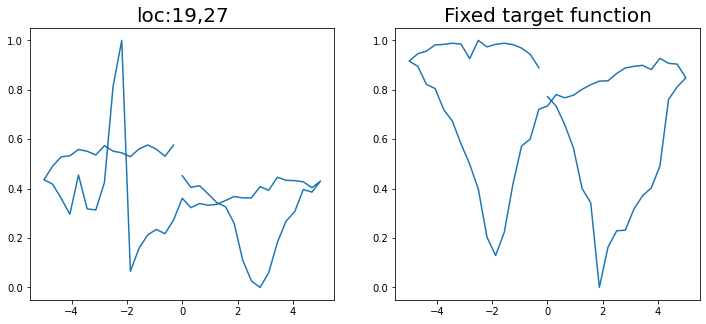

Epoch 1/200 ... Training loss: 2.9459
Epoch 10/200 ... Training loss: 2.6833
Epoch 20/200 ... Training loss: 2.4476
Epoch 30/200 ... Training loss: 2.2749
Epoch 40/200 ... Training loss: 2.0404
Epoch 50/200 ... Training loss: 1.8321
Epoch 60/200 ... Training loss: 1.677
Epoch 70/200 ... Training loss: 1.4826
Epoch 80/200 ... Training loss: 1.484
Epoch 90/200 ... Training loss: 1.3909
Epoch 100/200 ... Training loss: 1.2628
Epoch 110/200 ... Training loss: 1.2402
Epoch 120/200 ... Training loss: 1.2497
Epoch 130/200 ... Training loss: 1.1624
Epoch 140/200 ... Training loss: 1.1936
Epoch 150/200 ... Training loss: 1.113
Epoch 160/200 ... Training loss: 1.075
Epoch 170/200 ... Training loss: 1.4095
Epoch 180/200 ... Training loss: 1.0636
Epoch 190/200 ... Training loss: 1.0431
Epoch 200/200 ... Training loss: 0.9733
step:  62
Sample #72




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


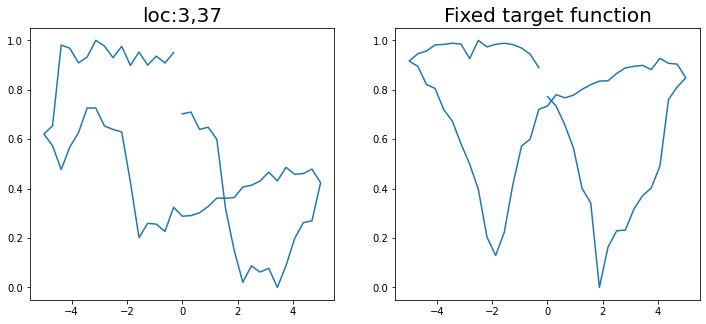

Epoch 1/200 ... Training loss: 2.9351
Epoch 10/200 ... Training loss: 2.527
Epoch 20/200 ... Training loss: 2.2828
Epoch 30/200 ... Training loss: 2.0757
Epoch 40/200 ... Training loss: 1.7855
Epoch 50/200 ... Training loss: 1.8758
Epoch 60/200 ... Training loss: 1.5656
Epoch 70/200 ... Training loss: 1.4208
Epoch 80/200 ... Training loss: 1.3453
Epoch 90/200 ... Training loss: 1.3214
Epoch 100/200 ... Training loss: 1.2307
Epoch 110/200 ... Training loss: 1.2206
Epoch 120/200 ... Training loss: 1.259
Epoch 130/200 ... Training loss: 1.1281
Epoch 140/200 ... Training loss: 1.1819
Epoch 150/200 ... Training loss: 1.0408
Epoch 160/200 ... Training loss: 1.0345
Epoch 170/200 ... Training loss: 0.9716
Epoch 180/200 ... Training loss: 0.926
Epoch 190/200 ... Training loss: 0.8893
Epoch 200/200 ... Training loss: 0.8229
step:  63
Sample #73




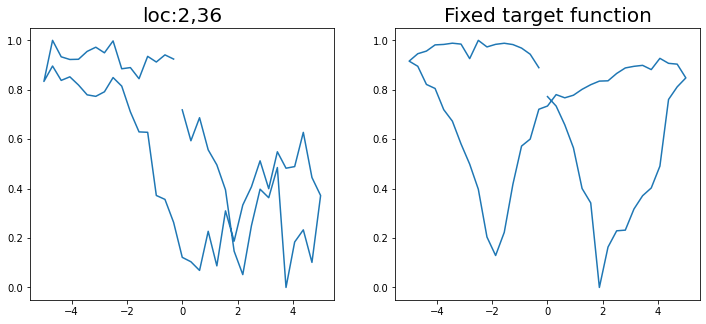

Epoch 1/200 ... Training loss: 2.9635
Epoch 10/200 ... Training loss: 2.8169
Epoch 20/200 ... Training loss: 2.3494
Epoch 30/200 ... Training loss: 2.1477
Epoch 40/200 ... Training loss: 1.8669
Epoch 50/200 ... Training loss: 1.7448
Epoch 60/200 ... Training loss: 1.5178
Epoch 70/200 ... Training loss: 1.5869
Epoch 80/200 ... Training loss: 1.3984
Epoch 90/200 ... Training loss: 1.346
Epoch 100/200 ... Training loss: 1.2487
Epoch 110/200 ... Training loss: 1.3071
Epoch 120/200 ... Training loss: 1.1482
Epoch 130/200 ... Training loss: 1.1549
Epoch 140/200 ... Training loss: 1.0812
Epoch 150/200 ... Training loss: 1.0126
Epoch 160/200 ... Training loss: 1.0392
Epoch 170/200 ... Training loss: 0.97
Epoch 180/200 ... Training loss: 1.0011
Epoch 190/200 ... Training loss: 0.8822
Epoch 200/200 ... Training loss: 0.8783
step:  64
Sample #74




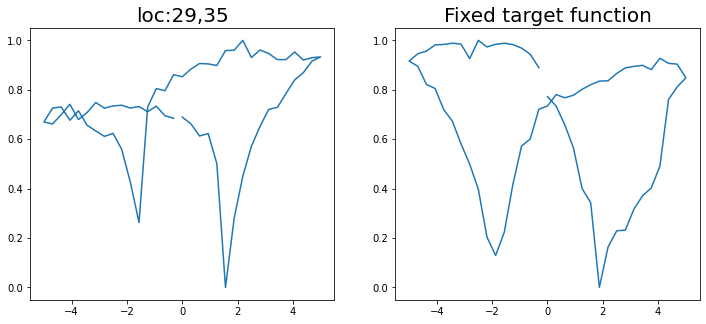

Epoch 1/200 ... Training loss: 2.9405
Epoch 10/200 ... Training loss: 2.6043
Epoch 20/200 ... Training loss: 2.2975
Epoch 30/200 ... Training loss: 2.0691
Epoch 40/200 ... Training loss: 1.7826
Epoch 50/200 ... Training loss: 1.6066
Epoch 60/200 ... Training loss: 1.4275
Epoch 70/200 ... Training loss: 1.5131
Epoch 80/200 ... Training loss: 1.3179
Epoch 90/200 ... Training loss: 1.2966
Epoch 100/200 ... Training loss: 1.5143
Epoch 110/200 ... Training loss: 1.3465
Epoch 120/200 ... Training loss: 1.1818
Epoch 130/200 ... Training loss: 1.2589
Epoch 140/200 ... Training loss: 1.1208
Epoch 150/200 ... Training loss: 1.0626
Epoch 160/200 ... Training loss: 1.0094
Epoch 170/200 ... Training loss: 1.1352
Epoch 180/200 ... Training loss: 0.9586
Epoch 190/200 ... Training loss: 0.9181
Epoch 200/200 ... Training loss: 0.9003
step:  65
Sample #75




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


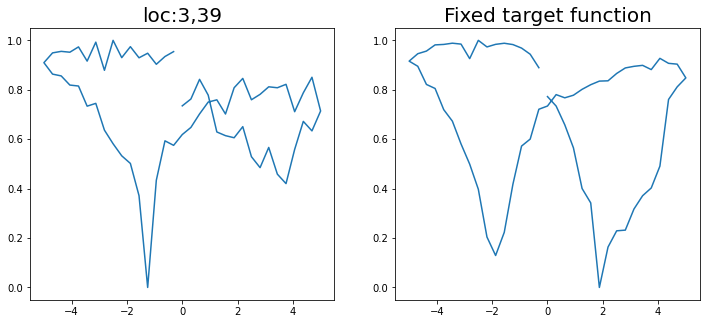

Epoch 1/200 ... Training loss: 2.9144
Epoch 10/200 ... Training loss: 2.6394
Epoch 20/200 ... Training loss: 2.2763
Epoch 30/200 ... Training loss: 2.0436
Epoch 40/200 ... Training loss: 1.7491
Epoch 50/200 ... Training loss: 1.6169
Epoch 60/200 ... Training loss: 1.5362
Epoch 70/200 ... Training loss: 1.5907
Epoch 80/200 ... Training loss: 1.3637
Epoch 90/200 ... Training loss: 1.3193
Epoch 100/200 ... Training loss: 1.334
Epoch 110/200 ... Training loss: 1.223
Epoch 120/200 ... Training loss: 1.1483
Epoch 130/200 ... Training loss: 1.3526
Epoch 140/200 ... Training loss: 1.0638
Epoch 150/200 ... Training loss: 1.1117
Epoch 160/200 ... Training loss: 0.982
Epoch 170/200 ... Training loss: 0.9219
Epoch 180/200 ... Training loss: 0.9865
Epoch 190/200 ... Training loss: 0.9123
Epoch 200/200 ... Training loss: 1.1308
step:  66
Sample #76




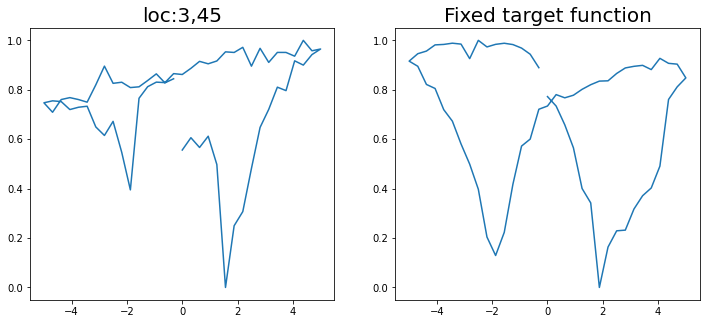

Epoch 1/200 ... Training loss: 2.8873
Epoch 10/200 ... Training loss: 2.6048
Epoch 20/200 ... Training loss: 2.3688
Epoch 30/200 ... Training loss: 2.1448
Epoch 40/200 ... Training loss: 1.91
Epoch 50/200 ... Training loss: 1.7038
Epoch 60/200 ... Training loss: 1.5148
Epoch 70/200 ... Training loss: 1.6243
Epoch 80/200 ... Training loss: 1.4508
Epoch 90/200 ... Training loss: 1.4016
Epoch 100/200 ... Training loss: 1.2791
Epoch 110/200 ... Training loss: 1.2279
Epoch 120/200 ... Training loss: 1.233
Epoch 130/200 ... Training loss: 1.1944
Epoch 140/200 ... Training loss: 1.1832
Epoch 150/200 ... Training loss: 1.1176
Epoch 160/200 ... Training loss: 1.0473
Epoch 170/200 ... Training loss: 1.0557
Epoch 180/200 ... Training loss: 1.0056
Epoch 190/200 ... Training loss: 0.9358
Epoch 200/200 ... Training loss: 0.983
step:  67
Sample #77




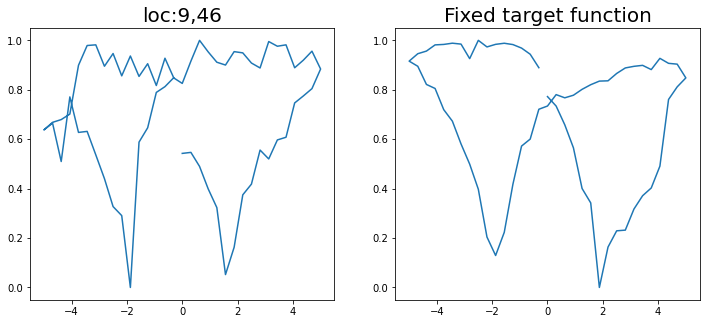

Epoch 1/200 ... Training loss: 2.8601
Epoch 10/200 ... Training loss: 2.5867
Epoch 20/200 ... Training loss: 2.3729
Epoch 30/200 ... Training loss: 2.1538
Epoch 40/200 ... Training loss: 1.9298
Epoch 50/200 ... Training loss: 1.7299
Epoch 60/200 ... Training loss: 1.6883
Epoch 70/200 ... Training loss: 1.5343
Epoch 80/200 ... Training loss: 1.436
Epoch 90/200 ... Training loss: 1.3182
Epoch 100/200 ... Training loss: 1.3002
Epoch 110/200 ... Training loss: 1.2312
Epoch 120/200 ... Training loss: 1.2811
Epoch 130/200 ... Training loss: 1.3468
Epoch 140/200 ... Training loss: 1.1408
Epoch 150/200 ... Training loss: 1.1539
Epoch 160/200 ... Training loss: 1.0712
Epoch 170/200 ... Training loss: 0.973
Epoch 180/200 ... Training loss: 0.9787
Epoch 190/200 ... Training loss: 0.9041
Epoch 200/200 ... Training loss: 0.8681
step:  68
Sample #78




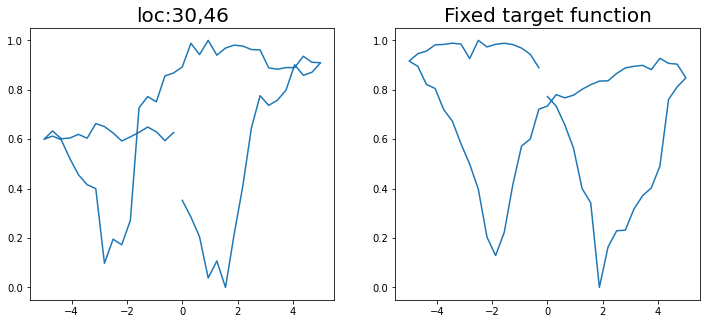

Epoch 1/200 ... Training loss: 2.8396
Epoch 10/200 ... Training loss: 2.4868
Epoch 20/200 ... Training loss: 2.2372
Epoch 30/200 ... Training loss: 2.1143
Epoch 40/200 ... Training loss: 2.1579
Epoch 50/200 ... Training loss: 1.8605
Epoch 60/200 ... Training loss: 1.5932
Epoch 70/200 ... Training loss: 1.6035
Epoch 80/200 ... Training loss: 1.4722
Epoch 90/200 ... Training loss: 1.3604
Epoch 100/200 ... Training loss: 1.3995
Epoch 110/200 ... Training loss: 1.2877
Epoch 120/200 ... Training loss: 1.2021
Epoch 130/200 ... Training loss: 1.202
Epoch 140/200 ... Training loss: 1.1099
Epoch 150/200 ... Training loss: 1.0685
Epoch 160/200 ... Training loss: 1.0707
Epoch 170/200 ... Training loss: 1.0828
Epoch 180/200 ... Training loss: 1.0001
Epoch 190/200 ... Training loss: 0.9521
Epoch 200/200 ... Training loss: 1.0783
step:  69
Sample #79




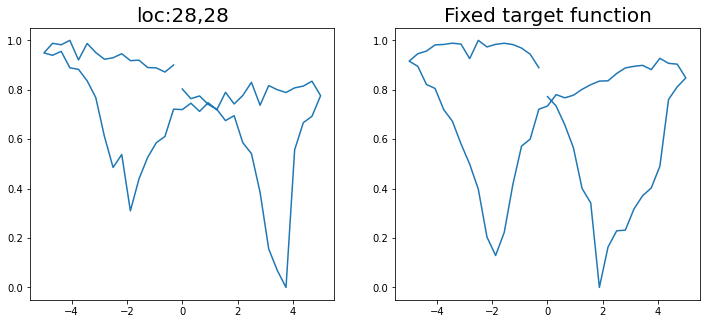

Epoch 1/200 ... Training loss: 2.8259
Epoch 10/200 ... Training loss: 2.4267
Epoch 20/200 ... Training loss: 2.3078
Epoch 30/200 ... Training loss: 1.9699
Epoch 40/200 ... Training loss: 1.6816
Epoch 50/200 ... Training loss: 1.6827
Epoch 60/200 ... Training loss: 1.6617
Epoch 70/200 ... Training loss: 1.4326
Epoch 80/200 ... Training loss: 1.4291
Epoch 90/200 ... Training loss: 1.4749
Epoch 100/200 ... Training loss: 1.3026
Epoch 110/200 ... Training loss: 1.2026
Epoch 120/200 ... Training loss: 1.2295
Epoch 130/200 ... Training loss: 1.1265
Epoch 140/200 ... Training loss: 1.2392
Epoch 150/200 ... Training loss: 1.2125
Epoch 160/200 ... Training loss: 1.2857
Epoch 170/200 ... Training loss: 1.2228
Epoch 180/200 ... Training loss: 1.0201
Epoch 190/200 ... Training loss: 0.961
Epoch 200/200 ... Training loss: 0.9749
step:  70
Sample #80




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


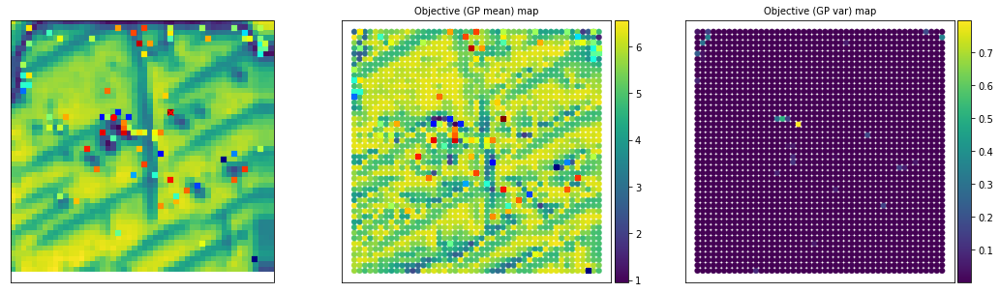

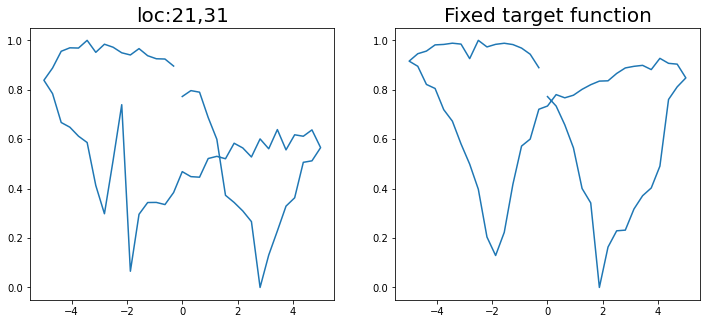

Epoch 1/200 ... Training loss: 2.8171
Epoch 10/200 ... Training loss: 2.6143
Epoch 20/200 ... Training loss: 2.3503
Epoch 30/200 ... Training loss: 2.2399
Epoch 40/200 ... Training loss: 2.0763
Epoch 50/200 ... Training loss: 1.8252
Epoch 60/200 ... Training loss: 1.6805
Epoch 70/200 ... Training loss: 1.6282
Epoch 80/200 ... Training loss: 1.461
Epoch 90/200 ... Training loss: 1.3724
Epoch 100/200 ... Training loss: 1.3238
Epoch 110/200 ... Training loss: 1.2783
Epoch 120/200 ... Training loss: 1.1883
Epoch 130/200 ... Training loss: 1.1392
Epoch 140/200 ... Training loss: 1.1006
Epoch 150/200 ... Training loss: 1.0836
Epoch 160/200 ... Training loss: 1.1633
Epoch 170/200 ... Training loss: 1.0625
Epoch 180/200 ... Training loss: 0.9988
Epoch 190/200 ... Training loss: 1.1487
Epoch 200/200 ... Training loss: 1.0523
step:  71
Sample #81




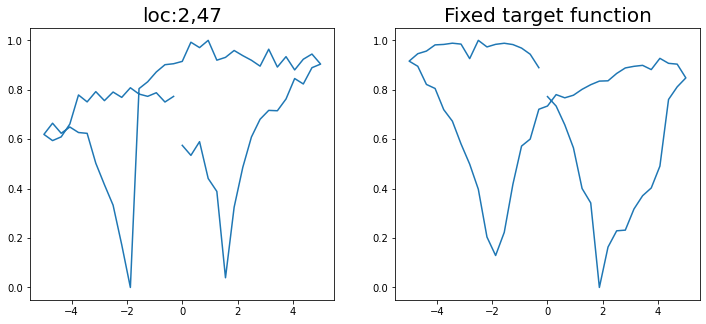

Epoch 1/200 ... Training loss: 2.7929
Epoch 10/200 ... Training loss: 2.4187
Epoch 20/200 ... Training loss: 2.401
Epoch 30/200 ... Training loss: 2.2228
Epoch 40/200 ... Training loss: 2.0519
Epoch 50/200 ... Training loss: 1.7972
Epoch 60/200 ... Training loss: 1.6565
Epoch 70/200 ... Training loss: 1.4973
Epoch 80/200 ... Training loss: 1.4813
Epoch 90/200 ... Training loss: 1.4418
Epoch 100/200 ... Training loss: 1.2796
Epoch 110/200 ... Training loss: 1.3062
Epoch 120/200 ... Training loss: 1.2352
Epoch 130/200 ... Training loss: 1.2145
Epoch 140/200 ... Training loss: 1.1736
Epoch 150/200 ... Training loss: 1.0653
Epoch 160/200 ... Training loss: 1.1042
Epoch 170/200 ... Training loss: 1.0295
Epoch 180/200 ... Training loss: 1.1709
Epoch 190/200 ... Training loss: 1.0684
Epoch 200/200 ... Training loss: 1.0734
step:  72
Sample #82




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


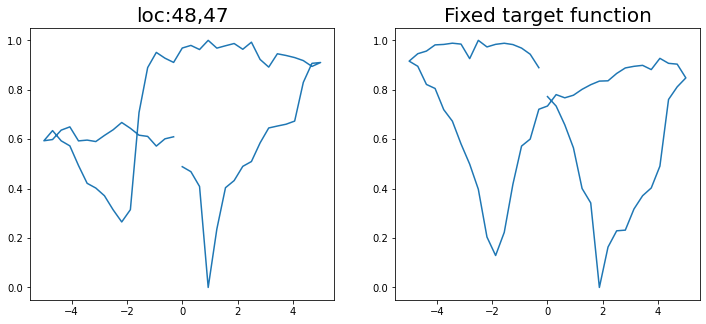

Epoch 1/200 ... Training loss: 2.7708
Epoch 10/200 ... Training loss: 2.5509
Epoch 20/200 ... Training loss: 2.3147
Epoch 30/200 ... Training loss: 2.205
Epoch 40/200 ... Training loss: 2.055
Epoch 50/200 ... Training loss: 1.7967
Epoch 60/200 ... Training loss: 1.6121
Epoch 70/200 ... Training loss: 1.4929
Epoch 80/200 ... Training loss: 1.5032
Epoch 90/200 ... Training loss: 1.3571
Epoch 100/200 ... Training loss: 1.2464
Epoch 110/200 ... Training loss: 1.2612
Epoch 120/200 ... Training loss: 1.1923
Epoch 130/200 ... Training loss: 1.1119
Epoch 140/200 ... Training loss: 1.1434
Epoch 150/200 ... Training loss: 1.1684
Epoch 160/200 ... Training loss: 1.0332
Epoch 170/200 ... Training loss: 0.9876
Epoch 180/200 ... Training loss: 1.1367
Epoch 190/200 ... Training loss: 0.9826
Epoch 200/200 ... Training loss: 0.9905
step:  73
Sample #83




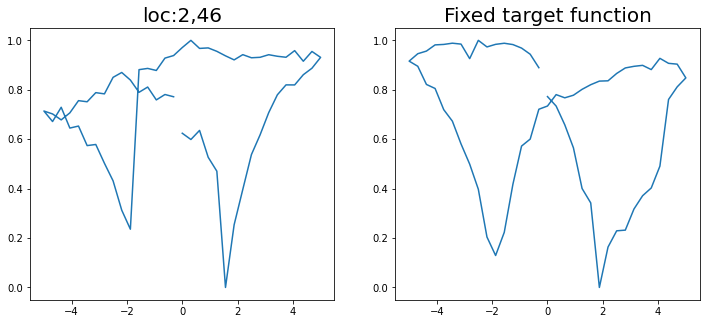

Epoch 1/200 ... Training loss: 2.7523
Epoch 10/200 ... Training loss: 2.5562
Epoch 20/200 ... Training loss: 2.2639
Epoch 30/200 ... Training loss: 2.1304
Epoch 40/200 ... Training loss: 1.8654
Epoch 50/200 ... Training loss: 1.6596
Epoch 60/200 ... Training loss: 1.5802
Epoch 70/200 ... Training loss: 1.5993
Epoch 80/200 ... Training loss: 1.4709
Epoch 90/200 ... Training loss: 1.426
Epoch 100/200 ... Training loss: 1.3778
Epoch 110/200 ... Training loss: 1.2056
Epoch 120/200 ... Training loss: 1.2728
Epoch 130/200 ... Training loss: 1.1752
Epoch 140/200 ... Training loss: 1.0572
Epoch 150/200 ... Training loss: 1.0151
Epoch 160/200 ... Training loss: 0.9677
Epoch 170/200 ... Training loss: 0.9548
Epoch 180/200 ... Training loss: 0.8776
Epoch 190/200 ... Training loss: 1.0176
Epoch 200/200 ... Training loss: 0.9417
step:  74
Sample #84




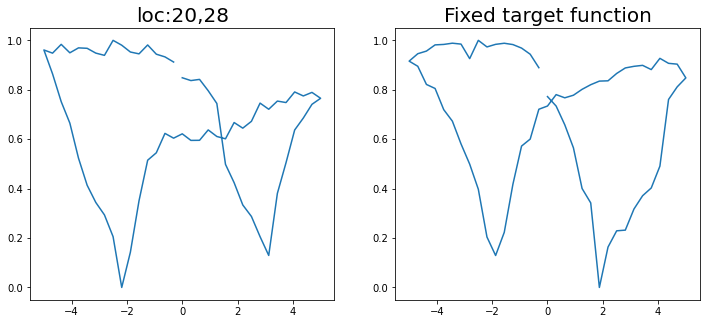

Epoch 1/200 ... Training loss: 2.7781
Epoch 10/200 ... Training loss: 2.5849
Epoch 20/200 ... Training loss: 2.3568
Epoch 30/200 ... Training loss: 2.2247
Epoch 40/200 ... Training loss: 2.0626
Epoch 50/200 ... Training loss: 1.7788
Epoch 60/200 ... Training loss: 1.6511
Epoch 70/200 ... Training loss: 1.5652
Epoch 80/200 ... Training loss: 1.6611
Epoch 90/200 ... Training loss: 1.4427
Epoch 100/200 ... Training loss: 1.579
Epoch 110/200 ... Training loss: 1.3879
Epoch 120/200 ... Training loss: 1.3358
Epoch 130/200 ... Training loss: 1.1922
Epoch 140/200 ... Training loss: 1.1738
Epoch 150/200 ... Training loss: 1.1213
Epoch 160/200 ... Training loss: 1.095
Epoch 170/200 ... Training loss: 1.0479
Epoch 180/200 ... Training loss: 1.0076
Epoch 190/200 ... Training loss: 1.0161
Epoch 200/200 ... Training loss: 0.967
step:  75
Sample #85




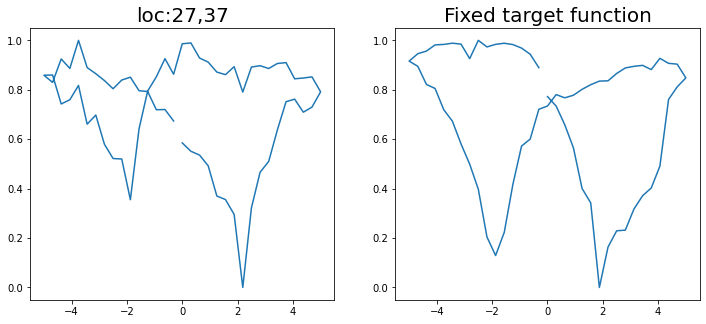

Epoch 1/200 ... Training loss: 2.7547
Epoch 10/200 ... Training loss: 2.5279
Epoch 20/200 ... Training loss: 2.3214
Epoch 30/200 ... Training loss: 2.1823
Epoch 40/200 ... Training loss: 2.0325
Epoch 50/200 ... Training loss: 1.7523
Epoch 60/200 ... Training loss: 1.5897
Epoch 70/200 ... Training loss: 1.5275
Epoch 80/200 ... Training loss: 1.6095
Epoch 90/200 ... Training loss: 1.4088
Epoch 100/200 ... Training loss: 1.3186
Epoch 110/200 ... Training loss: 1.2758
Epoch 120/200 ... Training loss: 1.2934
Epoch 130/200 ... Training loss: 1.1764
Epoch 140/200 ... Training loss: 1.1465
Epoch 150/200 ... Training loss: 1.0617
Epoch 160/200 ... Training loss: 1.0482
Epoch 170/200 ... Training loss: 0.999
Epoch 180/200 ... Training loss: 0.9573
Epoch 190/200 ... Training loss: 0.9058
Epoch 200/200 ... Training loss: 0.8894
step:  76
Sample #86




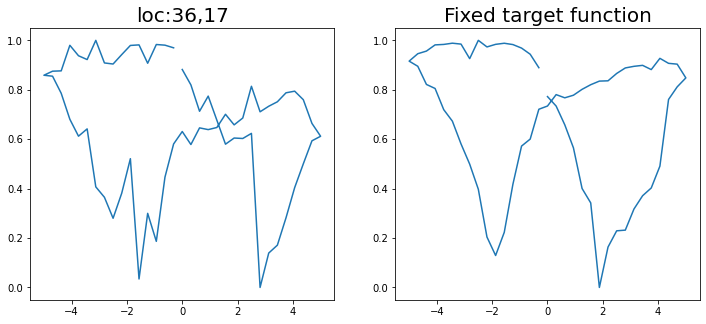

Epoch 1/200 ... Training loss: 2.7404
Epoch 10/200 ... Training loss: 2.4275
Epoch 20/200 ... Training loss: 2.2591
Epoch 30/200 ... Training loss: 2.1477
Epoch 40/200 ... Training loss: 1.9326
Epoch 50/200 ... Training loss: 1.6708
Epoch 60/200 ... Training loss: 1.5436
Epoch 70/200 ... Training loss: 1.6108
Epoch 80/200 ... Training loss: 1.4975
Epoch 90/200 ... Training loss: 1.419
Epoch 100/200 ... Training loss: 1.3682
Epoch 110/200 ... Training loss: 1.4072
Epoch 120/200 ... Training loss: 1.243
Epoch 130/200 ... Training loss: 1.1413
Epoch 140/200 ... Training loss: 1.0808
Epoch 150/200 ... Training loss: 1.0472
Epoch 160/200 ... Training loss: 1.0039
Epoch 170/200 ... Training loss: 1.1165
Epoch 180/200 ... Training loss: 1.0252
Epoch 190/200 ... Training loss: 0.9046
Epoch 200/200 ... Training loss: 0.8618
step:  77
Sample #87




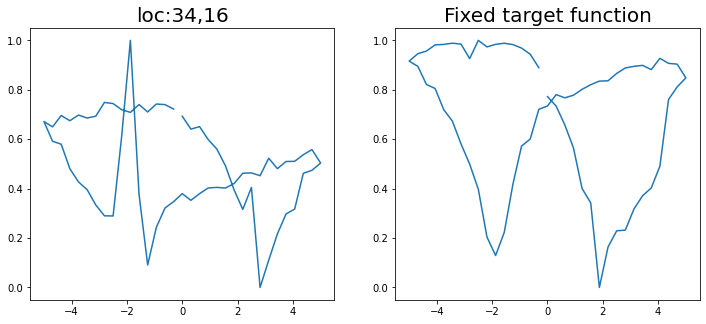

Epoch 1/200 ... Training loss: 2.7229
Epoch 10/200 ... Training loss: 2.4956
Epoch 20/200 ... Training loss: 2.2703
Epoch 30/200 ... Training loss: 2.1369
Epoch 40/200 ... Training loss: 1.9793
Epoch 50/200 ... Training loss: 1.7317
Epoch 60/200 ... Training loss: 1.5887
Epoch 70/200 ... Training loss: 1.5557
Epoch 80/200 ... Training loss: 1.4153
Epoch 90/200 ... Training loss: 1.5652
Epoch 100/200 ... Training loss: 1.404
Epoch 110/200 ... Training loss: 1.2372
Epoch 120/200 ... Training loss: 1.1809
Epoch 130/200 ... Training loss: 1.1941
Epoch 140/200 ... Training loss: 1.1522
Epoch 150/200 ... Training loss: 1.0979
Epoch 160/200 ... Training loss: 1.0245
Epoch 170/200 ... Training loss: 1.007
Epoch 180/200 ... Training loss: 0.9798
Epoch 190/200 ... Training loss: 1.0403
Epoch 200/200 ... Training loss: 0.9291
step:  78
Sample #88




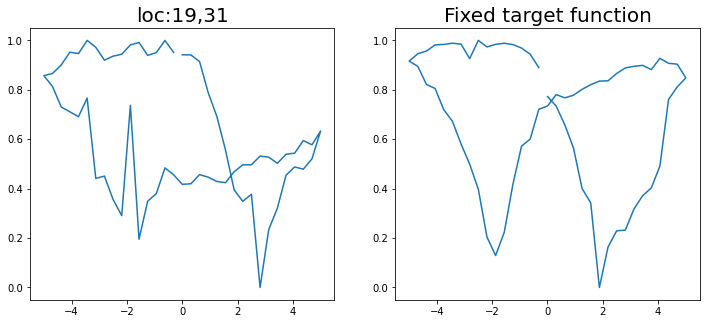

Epoch 1/200 ... Training loss: 2.7038
Epoch 10/200 ... Training loss: 2.5192
Epoch 20/200 ... Training loss: 2.3571
Epoch 30/200 ... Training loss: 2.1884
Epoch 40/200 ... Training loss: 2.0497
Epoch 50/200 ... Training loss: 1.7732
Epoch 60/200 ... Training loss: 1.6436
Epoch 70/200 ... Training loss: 1.5792
Epoch 80/200 ... Training loss: 1.6026
Epoch 90/200 ... Training loss: 1.3984
Epoch 100/200 ... Training loss: 1.4262
Epoch 110/200 ... Training loss: 1.3204
Epoch 120/200 ... Training loss: 1.2065
Epoch 130/200 ... Training loss: 1.4756
Epoch 140/200 ... Training loss: 1.2531
Epoch 150/200 ... Training loss: 1.1662
Epoch 160/200 ... Training loss: 1.1336
Epoch 170/200 ... Training loss: 1.0748
Epoch 180/200 ... Training loss: 1.1154
Epoch 190/200 ... Training loss: 1.0145
Epoch 200/200 ... Training loss: 1.1701
step:  79
Sample #89




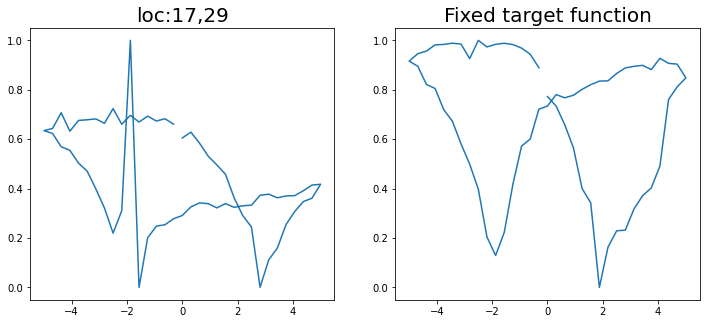

Epoch 1/200 ... Training loss: 2.6819
Epoch 10/200 ... Training loss: 2.5009
Epoch 20/200 ... Training loss: 2.3355
Epoch 30/200 ... Training loss: 2.1731
Epoch 40/200 ... Training loss: 2.032
Epoch 50/200 ... Training loss: 1.7738
Epoch 60/200 ... Training loss: 1.6928
Epoch 70/200 ... Training loss: 1.5325
Epoch 80/200 ... Training loss: 1.843
Epoch 90/200 ... Training loss: 1.6247
Epoch 100/200 ... Training loss: 1.4764
Epoch 110/200 ... Training loss: 1.4132
Epoch 120/200 ... Training loss: 1.3504
Epoch 130/200 ... Training loss: 1.3327
Epoch 140/200 ... Training loss: 1.2377
Epoch 150/200 ... Training loss: 1.2223
Epoch 160/200 ... Training loss: 1.19
Epoch 170/200 ... Training loss: 1.1709
Epoch 180/200 ... Training loss: 1.0992
Epoch 190/200 ... Training loss: 1.0601
Epoch 200/200 ... Training loss: 1.7572
step:  80
Sample #90




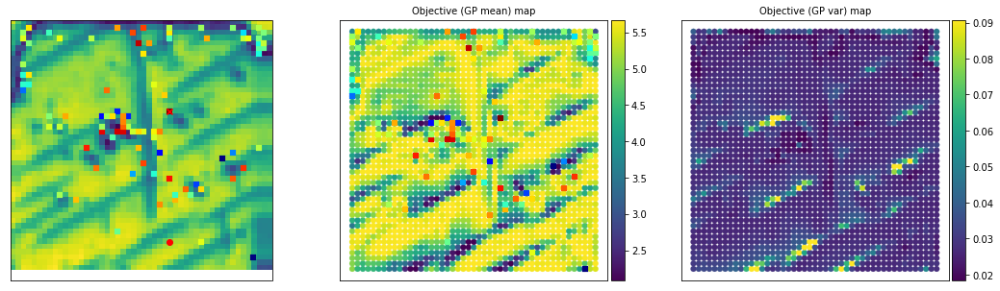

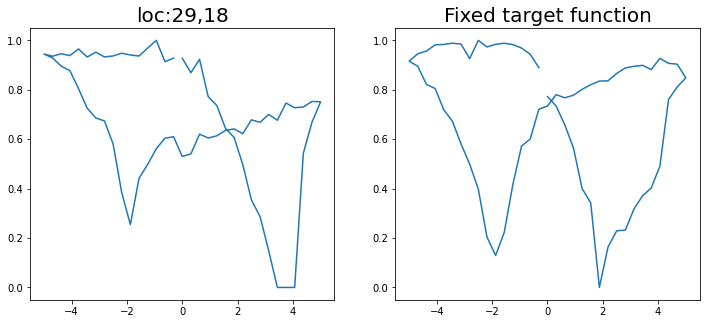

Epoch 1/200 ... Training loss: 2.6718
Epoch 10/200 ... Training loss: 2.4563
Epoch 20/200 ... Training loss: 2.2364
Epoch 30/200 ... Training loss: 2.1117
Epoch 40/200 ... Training loss: 1.9478
Epoch 50/200 ... Training loss: 1.6979
Epoch 60/200 ... Training loss: 1.5351
Epoch 70/200 ... Training loss: 1.4592
Epoch 80/200 ... Training loss: 1.4234
Epoch 90/200 ... Training loss: 1.3557
Epoch 100/200 ... Training loss: 1.3254
Epoch 110/200 ... Training loss: 1.2126
Epoch 120/200 ... Training loss: 1.1426
Epoch 130/200 ... Training loss: 1.3035
Epoch 140/200 ... Training loss: 1.1498
Epoch 150/200 ... Training loss: 1.1171
Epoch 160/200 ... Training loss: 1.0718
Epoch 170/200 ... Training loss: 0.9919
Epoch 180/200 ... Training loss: 1.1157
Epoch 190/200 ... Training loss: 0.9629
Epoch 200/200 ... Training loss: 0.886
step:  81
Sample #91




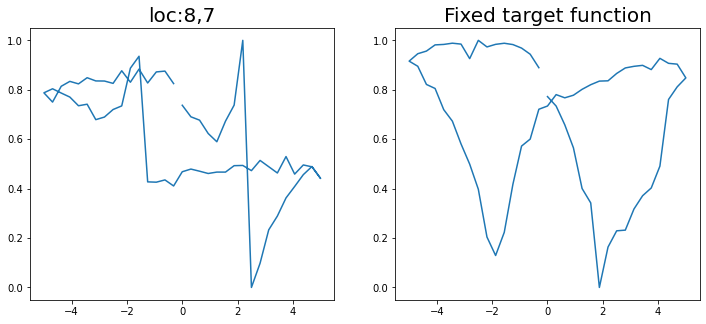

Epoch 1/200 ... Training loss: 2.6943
Epoch 10/200 ... Training loss: 2.4779
Epoch 20/200 ... Training loss: 2.249
Epoch 30/200 ... Training loss: 2.1555
Epoch 40/200 ... Training loss: 1.9964
Epoch 50/200 ... Training loss: 1.7628
Epoch 60/200 ... Training loss: 1.6601
Epoch 70/200 ... Training loss: 1.623
Epoch 80/200 ... Training loss: 1.5246
Epoch 90/200 ... Training loss: 1.5319
Epoch 100/200 ... Training loss: 1.3685
Epoch 110/200 ... Training loss: 1.3428
Epoch 120/200 ... Training loss: 1.2994
Epoch 130/200 ... Training loss: 1.3135
Epoch 140/200 ... Training loss: 1.2312
Epoch 150/200 ... Training loss: 1.1197
Epoch 160/200 ... Training loss: 1.1041
Epoch 170/200 ... Training loss: 1.1244
Epoch 180/200 ... Training loss: 1.1065
Epoch 190/200 ... Training loss: 0.9973
Epoch 200/200 ... Training loss: 0.9669
step:  82
Sample #92




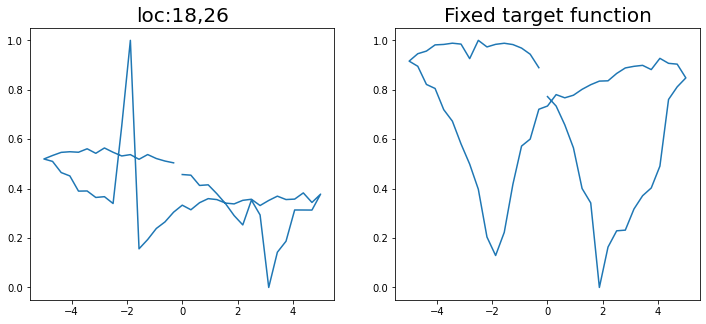

Epoch 1/200 ... Training loss: 2.6937
Epoch 10/200 ... Training loss: 2.5354
Epoch 20/200 ... Training loss: 2.3966
Epoch 30/200 ... Training loss: 2.2543
Epoch 40/200 ... Training loss: 2.1416
Epoch 50/200 ... Training loss: 2.0307
Epoch 60/200 ... Training loss: 1.8793
Epoch 70/200 ... Training loss: 1.7031
Epoch 80/200 ... Training loss: 1.6449
Epoch 90/200 ... Training loss: 1.4954
Epoch 100/200 ... Training loss: 1.4506
Epoch 110/200 ... Training loss: 1.4638
Epoch 120/200 ... Training loss: 1.3189
Epoch 130/200 ... Training loss: 1.3051
Epoch 140/200 ... Training loss: 1.2356
Epoch 150/200 ... Training loss: 1.2069
Epoch 160/200 ... Training loss: 1.21
Epoch 170/200 ... Training loss: 1.1202
Epoch 180/200 ... Training loss: 1.1655
Epoch 190/200 ... Training loss: 1.248
Epoch 200/200 ... Training loss: 1.0877
step:  83
Sample #93




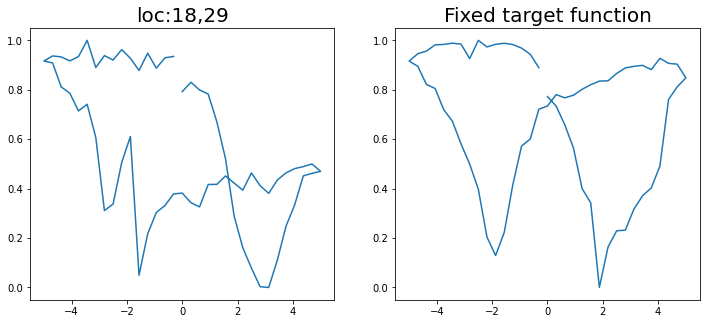

Epoch 1/200 ... Training loss: 2.6729
Epoch 10/200 ... Training loss: 2.5224
Epoch 20/200 ... Training loss: 2.3899
Epoch 30/200 ... Training loss: 2.2247
Epoch 40/200 ... Training loss: 2.1268
Epoch 50/200 ... Training loss: 2.0363
Epoch 60/200 ... Training loss: 1.9414
Epoch 70/200 ... Training loss: 1.7117
Epoch 80/200 ... Training loss: 1.7292
Epoch 90/200 ... Training loss: 1.5568
Epoch 100/200 ... Training loss: 1.5083
Epoch 110/200 ... Training loss: 1.4943
Epoch 120/200 ... Training loss: 1.3407
Epoch 130/200 ... Training loss: 1.3051
Epoch 140/200 ... Training loss: 1.2488
Epoch 150/200 ... Training loss: 1.1966
Epoch 160/200 ... Training loss: 1.1983
Epoch 170/200 ... Training loss: 1.1151
Epoch 180/200 ... Training loss: 1.2042
Epoch 190/200 ... Training loss: 1.1334
Epoch 200/200 ... Training loss: 1.0637
step:  84
Sample #94




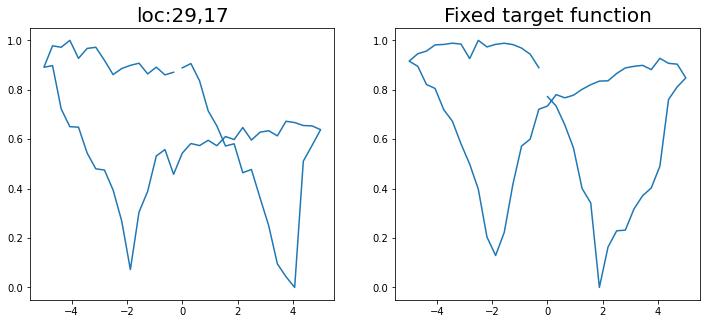

Epoch 1/200 ... Training loss: 2.6611
Epoch 10/200 ... Training loss: 2.4898
Epoch 20/200 ... Training loss: 2.3701
Epoch 30/200 ... Training loss: 2.2352
Epoch 40/200 ... Training loss: 2.1329
Epoch 50/200 ... Training loss: 2.0292
Epoch 60/200 ... Training loss: 1.908
Epoch 70/200 ... Training loss: 1.731
Epoch 80/200 ... Training loss: 1.5998
Epoch 90/200 ... Training loss: 1.5987
Epoch 100/200 ... Training loss: 1.5307
Epoch 110/200 ... Training loss: 1.3817
Epoch 120/200 ... Training loss: 1.3486
Epoch 130/200 ... Training loss: 1.2756
Epoch 140/200 ... Training loss: 1.214
Epoch 150/200 ... Training loss: 1.1698
Epoch 160/200 ... Training loss: 1.1188
Epoch 170/200 ... Training loss: 1.0746
Epoch 180/200 ... Training loss: 1.3123
Epoch 190/200 ... Training loss: 1.149
Epoch 200/200 ... Training loss: 1.0623
step:  85
Sample #95




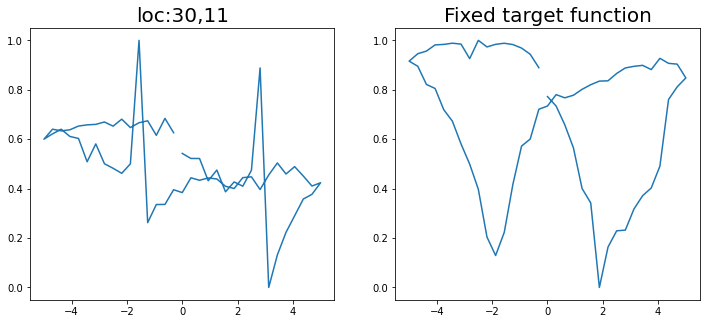

Epoch 1/200 ... Training loss: 2.6655
Epoch 10/200 ... Training loss: 2.5055
Epoch 20/200 ... Training loss: 2.3615
Epoch 30/200 ... Training loss: 2.2322
Epoch 40/200 ... Training loss: 2.1281
Epoch 50/200 ... Training loss: 2.0313
Epoch 60/200 ... Training loss: 1.9113
Epoch 70/200 ... Training loss: 1.6982
Epoch 80/200 ... Training loss: 1.5702
Epoch 90/200 ... Training loss: 1.5454
Epoch 100/200 ... Training loss: 1.4856
Epoch 110/200 ... Training loss: 1.4504
Epoch 120/200 ... Training loss: 1.3421
Epoch 130/200 ... Training loss: 1.369
Epoch 140/200 ... Training loss: 1.2863
Epoch 150/200 ... Training loss: 1.2783
Epoch 160/200 ... Training loss: 1.2034
Epoch 170/200 ... Training loss: 1.2921
Epoch 180/200 ... Training loss: 1.2604
Epoch 190/200 ... Training loss: 1.165
Epoch 200/200 ... Training loss: 1.0823
step:  86
Sample #96




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


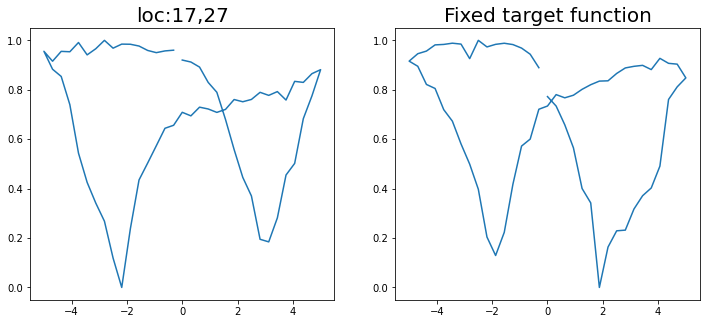

Epoch 1/200 ... Training loss: 2.6751
Epoch 10/200 ... Training loss: 2.492
Epoch 20/200 ... Training loss: 2.2884
Epoch 30/200 ... Training loss: 2.1572
Epoch 40/200 ... Training loss: 2.0096
Epoch 50/200 ... Training loss: 1.7544
Epoch 60/200 ... Training loss: 1.6562
Epoch 70/200 ... Training loss: 1.7972
Epoch 80/200 ... Training loss: 1.6446
Epoch 90/200 ... Training loss: 1.452
Epoch 100/200 ... Training loss: 1.7477
Epoch 110/200 ... Training loss: 1.5709
Epoch 120/200 ... Training loss: 1.3749
Epoch 130/200 ... Training loss: 1.4019
Epoch 140/200 ... Training loss: 1.3197
Epoch 150/200 ... Training loss: 1.274
Epoch 160/200 ... Training loss: 1.2317
Epoch 170/200 ... Training loss: 1.2472
Epoch 180/200 ... Training loss: 1.1536
Epoch 190/200 ... Training loss: 1.097
Epoch 200/200 ... Training loss: 1.0646
step:  87
Sample #97




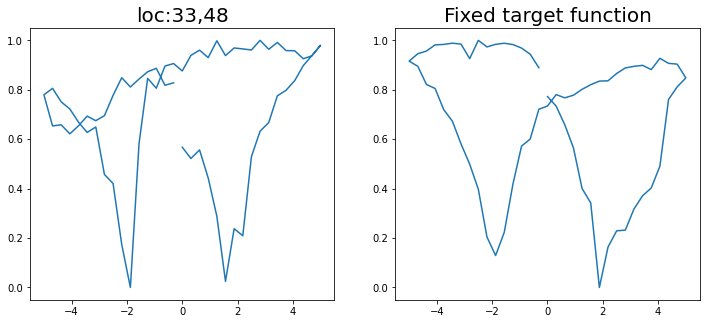

Epoch 1/200 ... Training loss: 2.6557
Epoch 10/200 ... Training loss: 2.4746
Epoch 20/200 ... Training loss: 2.285
Epoch 30/200 ... Training loss: 2.1467
Epoch 40/200 ... Training loss: 1.9978
Epoch 50/200 ... Training loss: 1.8229
Epoch 60/200 ... Training loss: 1.6491
Epoch 70/200 ... Training loss: 1.6375
Epoch 80/200 ... Training loss: 1.5441
Epoch 90/200 ... Training loss: 1.4288
Epoch 100/200 ... Training loss: 1.3292
Epoch 110/200 ... Training loss: 1.5549
Epoch 120/200 ... Training loss: 1.4279
Epoch 130/200 ... Training loss: 1.2855
Epoch 140/200 ... Training loss: 1.2493
Epoch 150/200 ... Training loss: 1.2363
Epoch 160/200 ... Training loss: 1.1254
Epoch 170/200 ... Training loss: 1.1518
Epoch 180/200 ... Training loss: 1.1544
Epoch 190/200 ... Training loss: 1.0504
Epoch 200/200 ... Training loss: 0.9694
step:  88
Sample #98




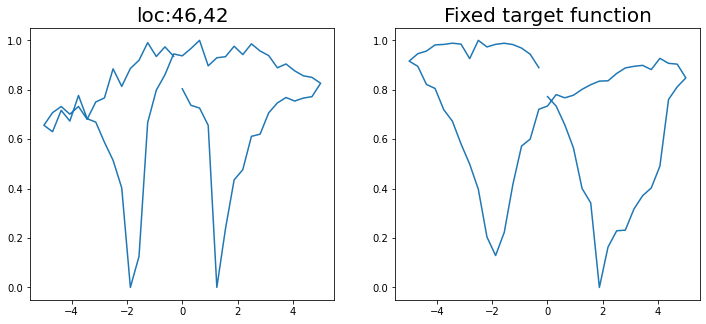

Epoch 1/200 ... Training loss: 2.6375
Epoch 10/200 ... Training loss: 2.5529
Epoch 20/200 ... Training loss: 2.3463
Epoch 30/200 ... Training loss: 2.2146
Epoch 40/200 ... Training loss: 2.1079
Epoch 50/200 ... Training loss: 2.0164
Epoch 60/200 ... Training loss: 1.9014
Epoch 70/200 ... Training loss: 1.7095
Epoch 80/200 ... Training loss: 1.697
Epoch 90/200 ... Training loss: 1.5471
Epoch 100/200 ... Training loss: 1.6812
Epoch 110/200 ... Training loss: 1.4958
Epoch 120/200 ... Training loss: 1.3509
Epoch 130/200 ... Training loss: 1.3494
Epoch 140/200 ... Training loss: 1.2728
Epoch 150/200 ... Training loss: 1.2523
Epoch 160/200 ... Training loss: 1.2133
Epoch 170/200 ... Training loss: 1.1085
Epoch 180/200 ... Training loss: 1.1106
Epoch 190/200 ... Training loss: 1.0606
Epoch 200/200 ... Training loss: 1.173
step:  89
Sample #99




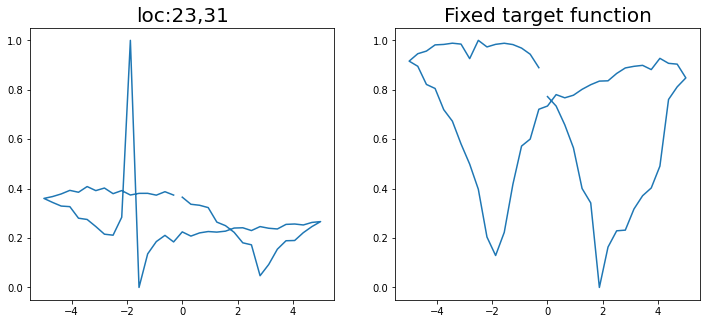

Epoch 1/200 ... Training loss: 2.6645
Epoch 10/200 ... Training loss: 2.5114
Epoch 20/200 ... Training loss: 2.3844
Epoch 30/200 ... Training loss: 2.1831
Epoch 40/200 ... Training loss: 2.0584
Epoch 50/200 ... Training loss: 1.9438
Epoch 60/200 ... Training loss: 1.7217
Epoch 70/200 ... Training loss: 1.5889
Epoch 80/200 ... Training loss: 1.5357
Epoch 90/200 ... Training loss: 1.4002
Epoch 100/200 ... Training loss: 1.3149
Epoch 110/200 ... Training loss: 1.3896
Epoch 120/200 ... Training loss: 1.2605
Epoch 130/200 ... Training loss: 1.2868
Epoch 140/200 ... Training loss: 1.1657
Epoch 150/200 ... Training loss: 1.2208
Epoch 160/200 ... Training loss: 1.139
Epoch 170/200 ... Training loss: 1.0657
Epoch 180/200 ... Training loss: 1.086
Epoch 190/200 ... Training loss: 1.1092
Epoch 200/200 ... Training loss: 0.9688
step:  90
Sample #100




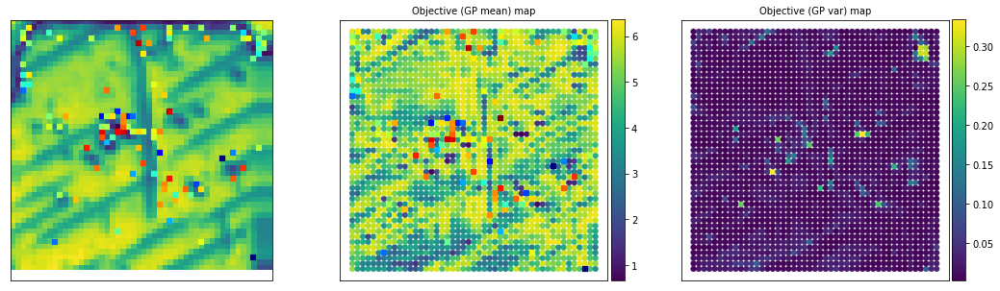

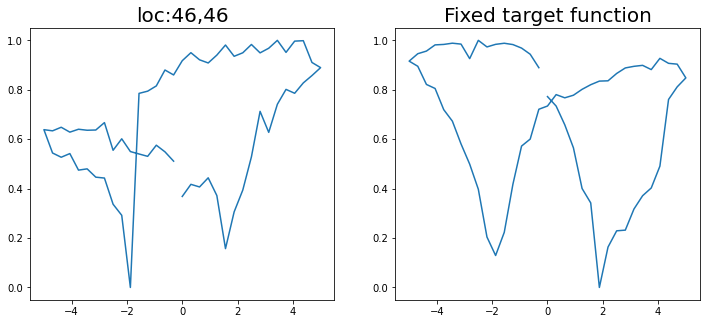

Epoch 1/200 ... Training loss: 2.6486
Epoch 10/200 ... Training loss: 2.5024
Epoch 20/200 ... Training loss: 2.3252
Epoch 30/200 ... Training loss: 2.1453
Epoch 40/200 ... Training loss: 2.0421
Epoch 50/200 ... Training loss: 1.9494
Epoch 60/200 ... Training loss: 1.8027
Epoch 70/200 ... Training loss: 1.7028
Epoch 80/200 ... Training loss: 1.5515
Epoch 90/200 ... Training loss: 1.5275
Epoch 100/200 ... Training loss: 1.4135
Epoch 110/200 ... Training loss: 1.3883
Epoch 120/200 ... Training loss: 1.3604
Epoch 130/200 ... Training loss: 1.2773
Epoch 140/200 ... Training loss: 1.2173
Epoch 150/200 ... Training loss: 1.1745
Epoch 160/200 ... Training loss: 1.1388
Epoch 170/200 ... Training loss: 1.1983
Epoch 180/200 ... Training loss: 1.0608
Epoch 190/200 ... Training loss: 1.0709
Epoch 200/200 ... Training loss: 1.0395
step:  91
Sample #101




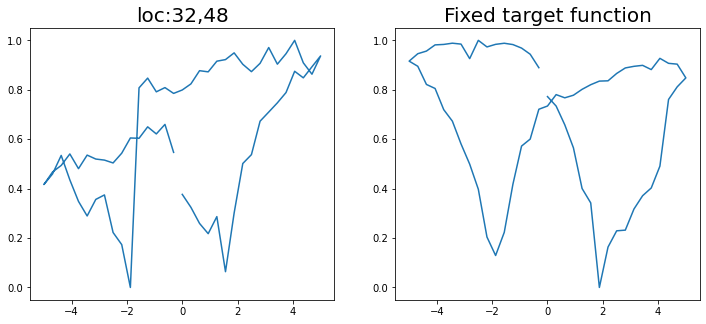

Epoch 1/200 ... Training loss: 2.6331
Epoch 10/200 ... Training loss: 2.4996
Epoch 20/200 ... Training loss: 2.3157
Epoch 30/200 ... Training loss: 2.1795
Epoch 40/200 ... Training loss: 2.058
Epoch 50/200 ... Training loss: 1.9612
Epoch 60/200 ... Training loss: 1.8553
Epoch 70/200 ... Training loss: 1.657
Epoch 80/200 ... Training loss: 1.6456
Epoch 90/200 ... Training loss: 1.494
Epoch 100/200 ... Training loss: 1.3813
Epoch 110/200 ... Training loss: 1.416
Epoch 120/200 ... Training loss: 1.3128
Epoch 130/200 ... Training loss: 1.2816
Epoch 140/200 ... Training loss: 1.2787
Epoch 150/200 ... Training loss: 1.2478
Epoch 160/200 ... Training loss: 1.211
Epoch 170/200 ... Training loss: 1.1564
Epoch 180/200 ... Training loss: 1.1532
Epoch 190/200 ... Training loss: 1.137
Epoch 200/200 ... Training loss: 1.1197
step:  92
Sample #102




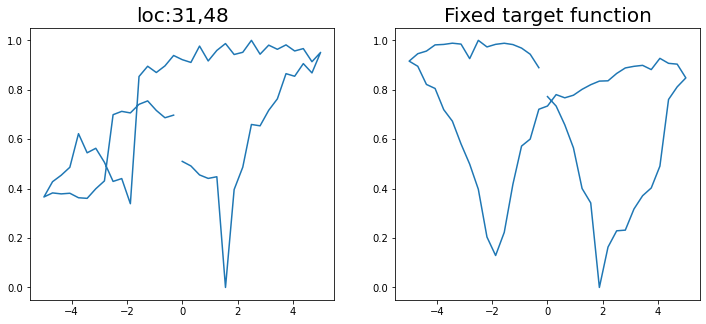

Epoch 1/200 ... Training loss: 2.6389
Epoch 10/200 ... Training loss: 2.4354
Epoch 20/200 ... Training loss: 2.2311
Epoch 30/200 ... Training loss: 2.0842
Epoch 40/200 ... Training loss: 1.9606
Epoch 50/200 ... Training loss: 1.744
Epoch 60/200 ... Training loss: 1.632
Epoch 70/200 ... Training loss: 1.5775
Epoch 80/200 ... Training loss: 1.4604
Epoch 90/200 ... Training loss: 1.4236
Epoch 100/200 ... Training loss: 1.3363
Epoch 110/200 ... Training loss: 1.3173
Epoch 120/200 ... Training loss: 1.2874
Epoch 130/200 ... Training loss: 1.147
Epoch 140/200 ... Training loss: 1.557
Epoch 150/200 ... Training loss: 1.2718
Epoch 160/200 ... Training loss: 1.1516
Epoch 170/200 ... Training loss: 1.0836
Epoch 180/200 ... Training loss: 1.1717
Epoch 190/200 ... Training loss: 1.0355
Epoch 200/200 ... Training loss: 1.1893
step:  93
Sample #103




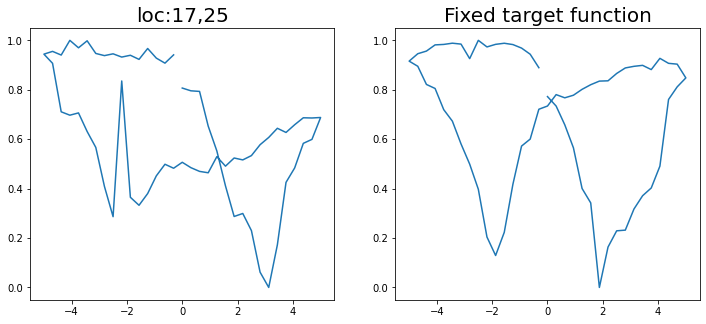

Epoch 1/200 ... Training loss: 2.6326
Epoch 10/200 ... Training loss: 2.4157
Epoch 20/200 ... Training loss: 2.22
Epoch 30/200 ... Training loss: 2.0817
Epoch 40/200 ... Training loss: 1.9603
Epoch 50/200 ... Training loss: 1.7816
Epoch 60/200 ... Training loss: 1.6623
Epoch 70/200 ... Training loss: 1.5246
Epoch 80/200 ... Training loss: 1.4969
Epoch 90/200 ... Training loss: 1.7618
Epoch 100/200 ... Training loss: 1.5692
Epoch 110/200 ... Training loss: 1.3647
Epoch 120/200 ... Training loss: 1.3331
Epoch 130/200 ... Training loss: 1.4484
Epoch 140/200 ... Training loss: 1.3829
Epoch 150/200 ... Training loss: 1.1967
Epoch 160/200 ... Training loss: 1.168
Epoch 170/200 ... Training loss: 1.162
Epoch 180/200 ... Training loss: 1.0983
Epoch 190/200 ... Training loss: 1.0597
Epoch 200/200 ... Training loss: 1.0057
step:  94
Sample #104




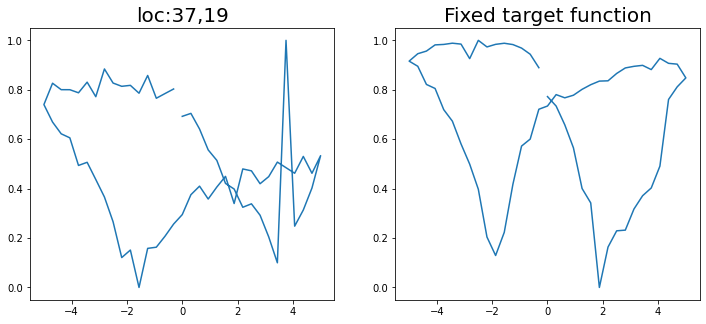

Epoch 1/200 ... Training loss: 2.6158
Epoch 10/200 ... Training loss: 2.2977
Epoch 20/200 ... Training loss: 2.1383
Epoch 30/200 ... Training loss: 1.9854
Epoch 40/200 ... Training loss: 1.7357
Epoch 50/200 ... Training loss: 1.6587
Epoch 60/200 ... Training loss: 1.5619
Epoch 70/200 ... Training loss: 1.4863
Epoch 80/200 ... Training loss: 1.8252
Epoch 90/200 ... Training loss: 1.6112
Epoch 100/200 ... Training loss: 1.4268
Epoch 110/200 ... Training loss: 1.2875
Epoch 120/200 ... Training loss: 1.232
Epoch 130/200 ... Training loss: 1.2451
Epoch 140/200 ... Training loss: 1.5642
Epoch 150/200 ... Training loss: 1.2631
Epoch 160/200 ... Training loss: 1.1265
Epoch 170/200 ... Training loss: 1.065
Epoch 180/200 ... Training loss: 1.0513
Epoch 190/200 ... Training loss: 0.9916
Epoch 200/200 ... Training loss: 0.9228
step:  95
Sample #105




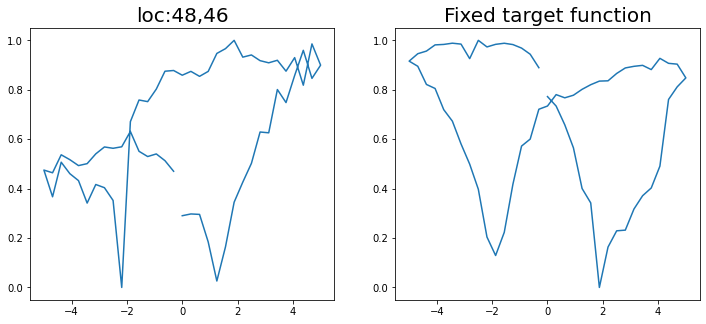

Epoch 1/200 ... Training loss: 2.6102
Epoch 10/200 ... Training loss: 2.3098
Epoch 20/200 ... Training loss: 2.1014
Epoch 30/200 ... Training loss: 1.8897
Epoch 40/200 ... Training loss: 1.8715
Epoch 50/200 ... Training loss: 1.7367
Epoch 60/200 ... Training loss: 1.5574
Epoch 70/200 ... Training loss: 1.507
Epoch 80/200 ... Training loss: 1.7711
Epoch 90/200 ... Training loss: 1.5984
Epoch 100/200 ... Training loss: 1.3853
Epoch 110/200 ... Training loss: 1.3032
Epoch 120/200 ... Training loss: 1.3642
Epoch 130/200 ... Training loss: 1.2322
Epoch 140/200 ... Training loss: 1.2522
Epoch 150/200 ... Training loss: 1.1589
Epoch 160/200 ... Training loss: 1.1337
Epoch 170/200 ... Training loss: 1.0833
Epoch 180/200 ... Training loss: 1.1105
Epoch 190/200 ... Training loss: 1.0446
Epoch 200/200 ... Training loss: 0.953
step:  96
Sample #106




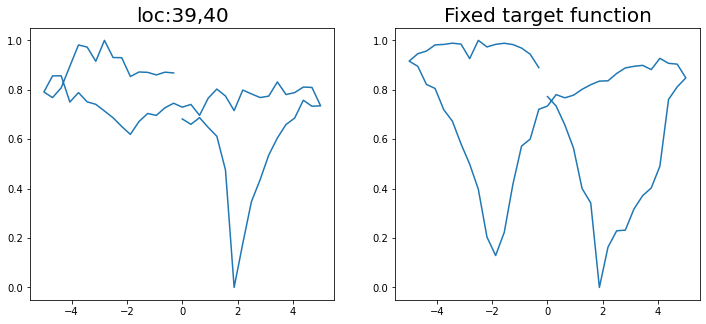

Epoch 1/200 ... Training loss: 2.5926
Epoch 10/200 ... Training loss: 2.2935
Epoch 20/200 ... Training loss: 2.0891
Epoch 30/200 ... Training loss: 1.8756
Epoch 40/200 ... Training loss: 1.778
Epoch 50/200 ... Training loss: 1.6195
Epoch 60/200 ... Training loss: 1.5592
Epoch 70/200 ... Training loss: 1.4843
Epoch 80/200 ... Training loss: 1.7639
Epoch 90/200 ... Training loss: 1.4922
Epoch 100/200 ... Training loss: 1.295
Epoch 110/200 ... Training loss: 1.24
Epoch 120/200 ... Training loss: 1.193
Epoch 130/200 ... Training loss: 1.1539
Epoch 140/200 ... Training loss: 1.0812
Epoch 150/200 ... Training loss: 1.0768
Epoch 160/200 ... Training loss: 1.0091
Epoch 170/200 ... Training loss: 1.0021
Epoch 180/200 ... Training loss: 0.9888
Epoch 190/200 ... Training loss: 0.976
Epoch 200/200 ... Training loss: 1.0787
step:  97
Sample #107




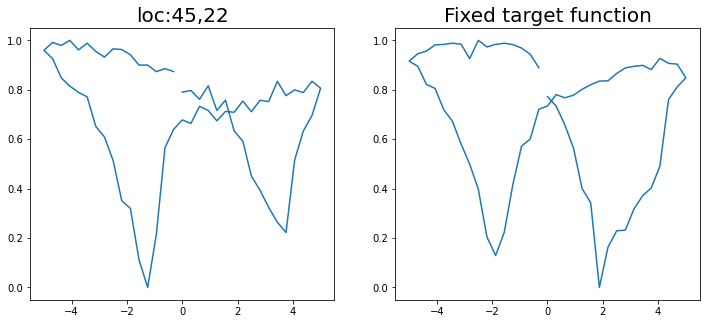

Epoch 1/200 ... Training loss: 2.5934
Epoch 10/200 ... Training loss: 2.2792
Epoch 20/200 ... Training loss: 2.0947
Epoch 30/200 ... Training loss: 1.9417
Epoch 40/200 ... Training loss: 1.8697
Epoch 50/200 ... Training loss: 1.6737
Epoch 60/200 ... Training loss: 1.7648
Epoch 70/200 ... Training loss: 1.7293
Epoch 80/200 ... Training loss: 1.5004
Epoch 90/200 ... Training loss: 1.535
Epoch 100/200 ... Training loss: 1.3853
Epoch 110/200 ... Training loss: 1.3499
Epoch 120/200 ... Training loss: 1.3306
Epoch 130/200 ... Training loss: 1.1835
Epoch 140/200 ... Training loss: 1.1329
Epoch 150/200 ... Training loss: 1.0988
Epoch 160/200 ... Training loss: 1.0456
Epoch 170/200 ... Training loss: 1.0632
Epoch 180/200 ... Training loss: 0.9941
Epoch 190/200 ... Training loss: 0.9687
Epoch 200/200 ... Training loss: 0.9532
step:  98
Sample #108




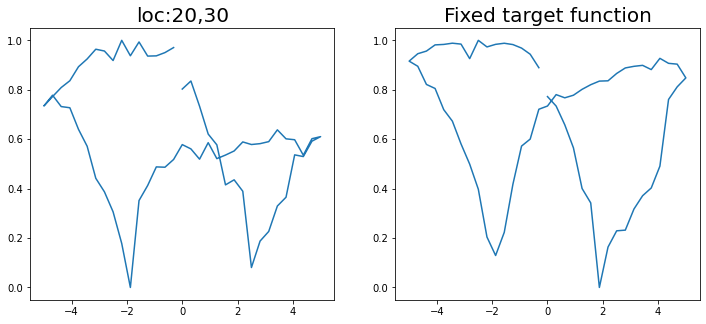

Epoch 1/200 ... Training loss: 2.5867
Epoch 10/200 ... Training loss: 2.2681
Epoch 20/200 ... Training loss: 2.0506
Epoch 30/200 ... Training loss: 2.0241
Epoch 40/200 ... Training loss: 1.7096
Epoch 50/200 ... Training loss: 1.6201
Epoch 60/200 ... Training loss: 1.6614
Epoch 70/200 ... Training loss: 1.5001
Epoch 80/200 ... Training loss: 1.6117
Epoch 90/200 ... Training loss: 1.3607
Epoch 100/200 ... Training loss: 1.4039
Epoch 110/200 ... Training loss: 1.2106
Epoch 120/200 ... Training loss: 1.1845
Epoch 130/200 ... Training loss: 1.0902
Epoch 140/200 ... Training loss: 1.0684
Epoch 150/200 ... Training loss: 1.078
Epoch 160/200 ... Training loss: 0.9791
Epoch 170/200 ... Training loss: 0.9831
Epoch 180/200 ... Training loss: 0.8865
Epoch 190/200 ... Training loss: 0.8901
Epoch 200/200 ... Training loss: 0.8147
step:  99
Sample #109




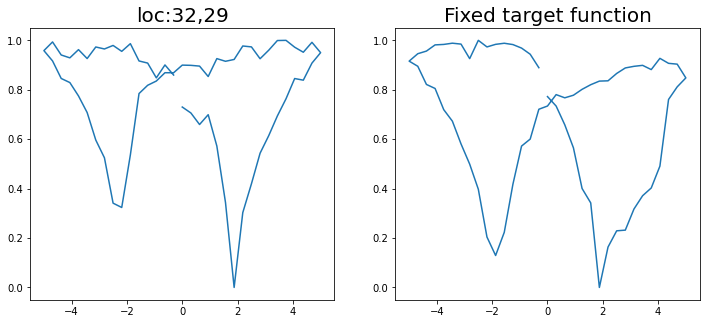

Epoch 1/200 ... Training loss: 2.5917
Epoch 10/200 ... Training loss: 2.2449
Epoch 20/200 ... Training loss: 2.0433
Epoch 30/200 ... Training loss: 2.2194
Epoch 40/200 ... Training loss: 1.7113
Epoch 50/200 ... Training loss: 1.6318
Epoch 60/200 ... Training loss: 1.6269
Epoch 70/200 ... Training loss: 1.538
Epoch 80/200 ... Training loss: 1.3892
Epoch 90/200 ... Training loss: 1.3237
Epoch 100/200 ... Training loss: 1.2167
Epoch 110/200 ... Training loss: 1.2362
Epoch 120/200 ... Training loss: 1.1488
Epoch 130/200 ... Training loss: 1.1152
Epoch 140/200 ... Training loss: 1.0832
Epoch 150/200 ... Training loss: 1.2667
Epoch 160/200 ... Training loss: 1.1122
Epoch 170/200 ... Training loss: 1.0102
Epoch 180/200 ... Training loss: 0.9386
Epoch 190/200 ... Training loss: 0.9405
Epoch 200/200 ... Training loss: 0.8565
step:  100
Sample #110




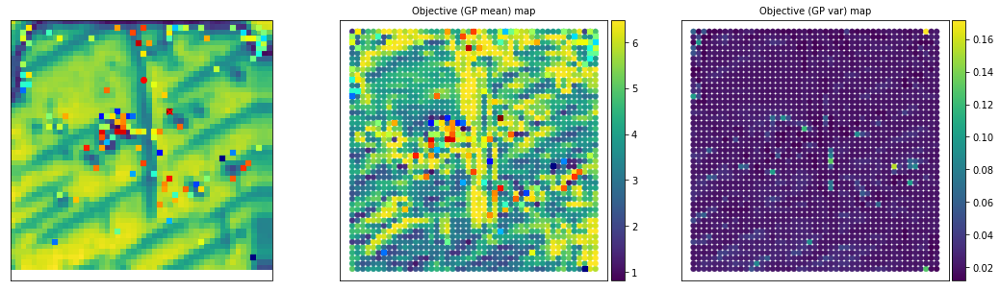

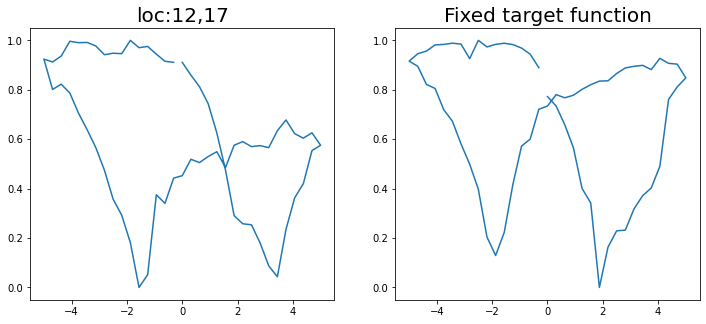

Epoch 1/200 ... Training loss: 2.6055
Epoch 10/200 ... Training loss: 2.2573
Epoch 20/200 ... Training loss: 2.0338
Epoch 30/200 ... Training loss: 1.8045
Epoch 40/200 ... Training loss: 1.7016
Epoch 50/200 ... Training loss: 1.636
Epoch 60/200 ... Training loss: 1.4457
Epoch 70/200 ... Training loss: 1.6719
Epoch 80/200 ... Training loss: 1.505
Epoch 90/200 ... Training loss: 1.2938
Epoch 100/200 ... Training loss: 1.2659
Epoch 110/200 ... Training loss: 1.2108
Epoch 120/200 ... Training loss: 1.1752
Epoch 130/200 ... Training loss: 1.1069
Epoch 140/200 ... Training loss: 1.0737
Epoch 150/200 ... Training loss: 1.0368
Epoch 160/200 ... Training loss: 1.0232
Epoch 170/200 ... Training loss: 0.9248
Epoch 180/200 ... Training loss: 0.8976
Epoch 190/200 ... Training loss: 0.8667
Epoch 200/200 ... Training loss: 0.9205
step:  101
Sample #111




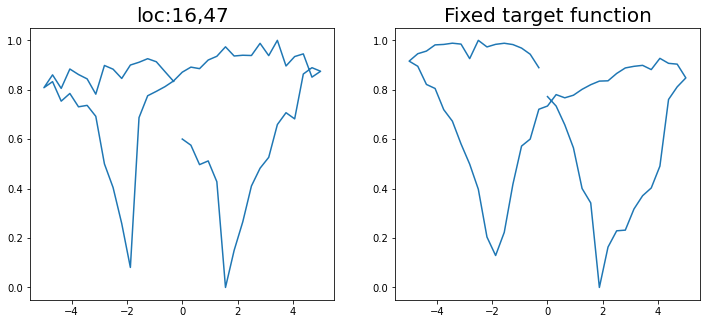

Epoch 1/200 ... Training loss: 2.6014
Epoch 10/200 ... Training loss: 2.3723
Epoch 20/200 ... Training loss: 2.1635
Epoch 30/200 ... Training loss: 2.0106
Epoch 40/200 ... Training loss: 1.7575
Epoch 50/200 ... Training loss: 1.658
Epoch 60/200 ... Training loss: 1.5816
Epoch 70/200 ... Training loss: 1.5509
Epoch 80/200 ... Training loss: 1.3462
Epoch 90/200 ... Training loss: 1.2838
Epoch 100/200 ... Training loss: 1.2617
Epoch 110/200 ... Training loss: 1.1983
Epoch 120/200 ... Training loss: 1.1198
Epoch 130/200 ... Training loss: 1.0867
Epoch 140/200 ... Training loss: 1.1842
Epoch 150/200 ... Training loss: 1.0901
Epoch 160/200 ... Training loss: 1.0944
Epoch 170/200 ... Training loss: 1.0017
Epoch 180/200 ... Training loss: 0.9942
Epoch 190/200 ... Training loss: 0.9638
Epoch 200/200 ... Training loss: 0.867
step:  102
Sample #112




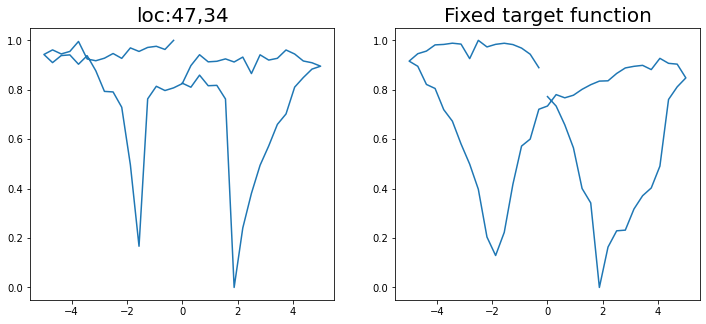

Epoch 1/200 ... Training loss: 2.5944
Epoch 10/200 ... Training loss: 2.3311
Epoch 20/200 ... Training loss: 2.1079
Epoch 30/200 ... Training loss: 1.9359
Epoch 40/200 ... Training loss: 2.0194
Epoch 50/200 ... Training loss: 1.7734
Epoch 60/200 ... Training loss: 1.5559
Epoch 70/200 ... Training loss: 1.4363
Epoch 80/200 ... Training loss: 1.3754
Epoch 90/200 ... Training loss: 1.3326
Epoch 100/200 ... Training loss: 1.4046
Epoch 110/200 ... Training loss: 1.2523
Epoch 120/200 ... Training loss: 1.2216
Epoch 130/200 ... Training loss: 1.2418
Epoch 140/200 ... Training loss: 1.1345
Epoch 150/200 ... Training loss: 1.2018
Epoch 160/200 ... Training loss: 1.1217
Epoch 170/200 ... Training loss: 1.0391
Epoch 180/200 ... Training loss: 1.1036
Epoch 190/200 ... Training loss: 0.9549
Epoch 200/200 ... Training loss: 0.9018
step:  103
Sample #113




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


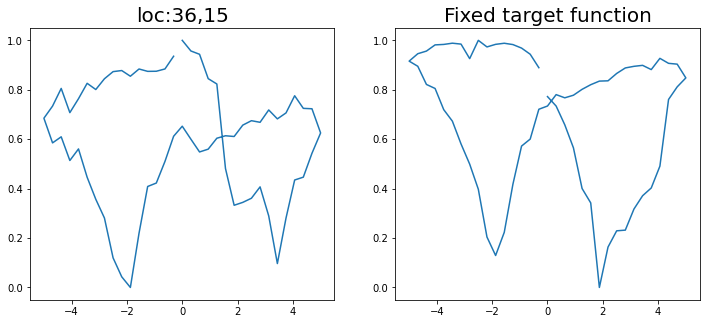

Epoch 1/200 ... Training loss: 2.5944
Epoch 10/200 ... Training loss: 2.3376
Epoch 20/200 ... Training loss: 2.1036
Epoch 30/200 ... Training loss: 1.9341
Epoch 40/200 ... Training loss: 1.73
Epoch 50/200 ... Training loss: 1.5889
Epoch 60/200 ... Training loss: 1.5514
Epoch 70/200 ... Training loss: 1.8293
Epoch 80/200 ... Training loss: 1.6433
Epoch 90/200 ... Training loss: 1.4085
Epoch 100/200 ... Training loss: 1.3111
Epoch 110/200 ... Training loss: 1.2563
Epoch 120/200 ... Training loss: 1.2135
Epoch 130/200 ... Training loss: 1.1792
Epoch 140/200 ... Training loss: 1.1188
Epoch 150/200 ... Training loss: 1.0926
Epoch 160/200 ... Training loss: 1.132
Epoch 170/200 ... Training loss: 1.0424
Epoch 180/200 ... Training loss: 1.1145
Epoch 190/200 ... Training loss: 0.9642
Epoch 200/200 ... Training loss: 0.9243
step:  104
Sample #114




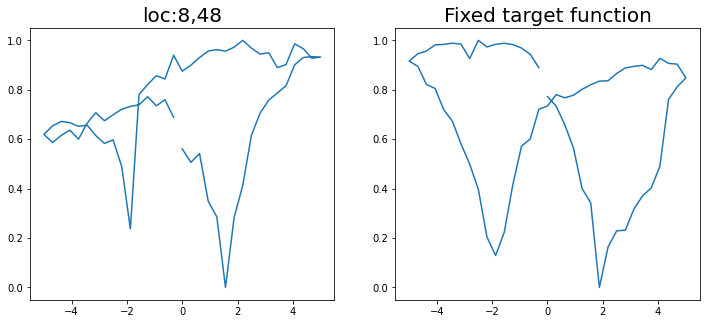

Epoch 1/200 ... Training loss: 2.5823
Epoch 10/200 ... Training loss: 2.3194
Epoch 20/200 ... Training loss: 2.092
Epoch 30/200 ... Training loss: 1.9357
Epoch 40/200 ... Training loss: 2.0026
Epoch 50/200 ... Training loss: 1.7036
Epoch 60/200 ... Training loss: 1.6805
Epoch 70/200 ... Training loss: 1.5601
Epoch 80/200 ... Training loss: 1.4275
Epoch 90/200 ... Training loss: 1.5977
Epoch 100/200 ... Training loss: 1.4862
Epoch 110/200 ... Training loss: 1.283
Epoch 120/200 ... Training loss: 1.2937
Epoch 130/200 ... Training loss: 1.1702
Epoch 140/200 ... Training loss: 1.1706
Epoch 150/200 ... Training loss: 1.0993
Epoch 160/200 ... Training loss: 1.1161
Epoch 170/200 ... Training loss: 1.0397
Epoch 180/200 ... Training loss: 0.9719
Epoch 190/200 ... Training loss: 0.9024
Epoch 200/200 ... Training loss: 0.9247
step:  105
Sample #115




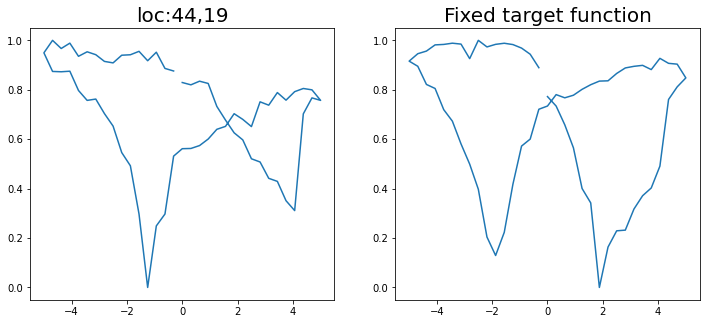

Epoch 1/200 ... Training loss: 2.5726
Epoch 10/200 ... Training loss: 2.329
Epoch 20/200 ... Training loss: 2.1103
Epoch 30/200 ... Training loss: 1.9731
Epoch 40/200 ... Training loss: 1.7283
Epoch 50/200 ... Training loss: 1.8104
Epoch 60/200 ... Training loss: 1.5751
Epoch 70/200 ... Training loss: 1.6849
Epoch 80/200 ... Training loss: 1.462
Epoch 90/200 ... Training loss: 1.3448
Epoch 100/200 ... Training loss: 1.4155
Epoch 110/200 ... Training loss: 1.2729
Epoch 120/200 ... Training loss: 1.2295
Epoch 130/200 ... Training loss: 1.2052
Epoch 140/200 ... Training loss: 1.1185
Epoch 150/200 ... Training loss: 1.0983
Epoch 160/200 ... Training loss: 1.0645
Epoch 170/200 ... Training loss: 1.0959
Epoch 180/200 ... Training loss: 0.9648
Epoch 190/200 ... Training loss: 0.9193
Epoch 200/200 ... Training loss: 0.9155
step:  106
Sample #116




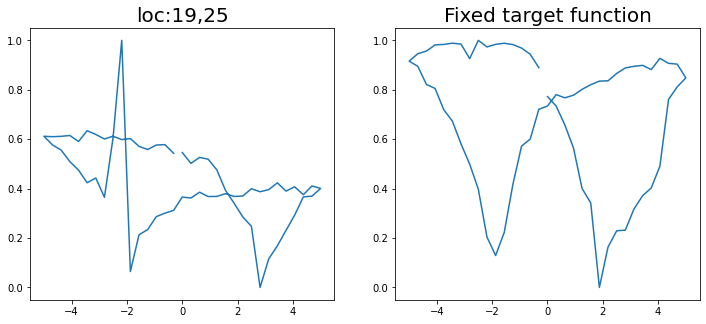

Epoch 1/200 ... Training loss: 2.5588
Epoch 10/200 ... Training loss: 2.3187
Epoch 20/200 ... Training loss: 2.1124
Epoch 30/200 ... Training loss: 1.9729
Epoch 40/200 ... Training loss: 1.7458
Epoch 50/200 ... Training loss: 1.6458
Epoch 60/200 ... Training loss: 1.5726
Epoch 70/200 ... Training loss: 1.5025
Epoch 80/200 ... Training loss: 1.6173
Epoch 90/200 ... Training loss: 1.3958
Epoch 100/200 ... Training loss: 1.3447
Epoch 110/200 ... Training loss: 1.3036
Epoch 120/200 ... Training loss: 1.2848
Epoch 130/200 ... Training loss: 1.194
Epoch 140/200 ... Training loss: 1.1403
Epoch 150/200 ... Training loss: 1.1196
Epoch 160/200 ... Training loss: 1.0871
Epoch 170/200 ... Training loss: 0.9925
Epoch 180/200 ... Training loss: 0.9474
Epoch 190/200 ... Training loss: 0.9555
Epoch 200/200 ... Training loss: 0.9272
step:  107
Sample #117




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


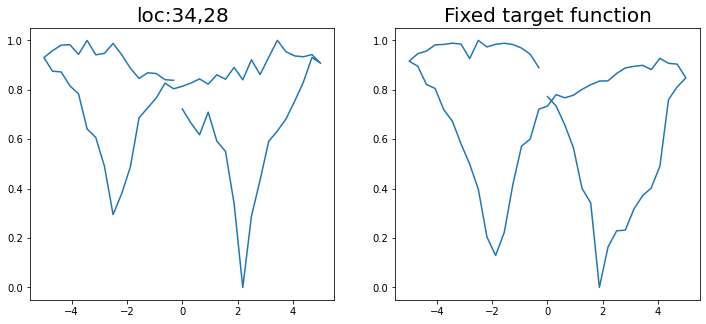

Epoch 1/200 ... Training loss: 2.5594
Epoch 10/200 ... Training loss: 2.3525
Epoch 20/200 ... Training loss: 2.185
Epoch 30/200 ... Training loss: 2.0381
Epoch 40/200 ... Training loss: 1.9234
Epoch 50/200 ... Training loss: 1.7965
Epoch 60/200 ... Training loss: 1.6315
Epoch 70/200 ... Training loss: 1.6139
Epoch 80/200 ... Training loss: 1.4525
Epoch 90/200 ... Training loss: 1.4813
Epoch 100/200 ... Training loss: 1.3864
Epoch 110/200 ... Training loss: 1.5365
Epoch 120/200 ... Training loss: 1.2968
Epoch 130/200 ... Training loss: 1.355
Epoch 140/200 ... Training loss: 1.2303
Epoch 150/200 ... Training loss: 1.2008
Epoch 160/200 ... Training loss: 1.1402
Epoch 170/200 ... Training loss: 1.2624
Epoch 180/200 ... Training loss: 1.117
Epoch 190/200 ... Training loss: 1.0343
Epoch 200/200 ... Training loss: 1.0441
step:  108
Sample #118




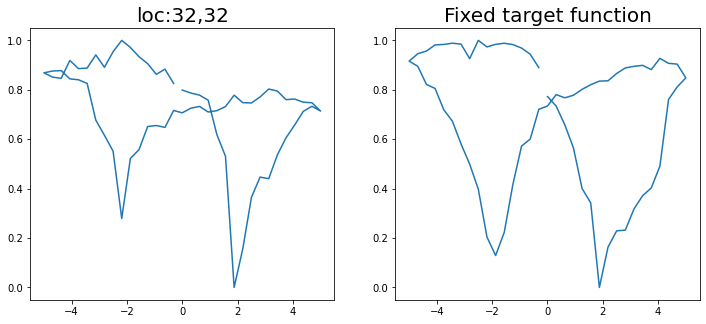

Epoch 1/200 ... Training loss: 2.5714
Epoch 10/200 ... Training loss: 2.2545
Epoch 20/200 ... Training loss: 2.0213
Epoch 30/200 ... Training loss: 1.9489
Epoch 40/200 ... Training loss: 1.8582
Epoch 50/200 ... Training loss: 1.6577
Epoch 60/200 ... Training loss: 1.5431
Epoch 70/200 ... Training loss: 1.5139
Epoch 80/200 ... Training loss: 1.3851
Epoch 90/200 ... Training loss: 1.3376
Epoch 100/200 ... Training loss: 1.4708
Epoch 110/200 ... Training loss: 1.3116
Epoch 120/200 ... Training loss: 1.2864
Epoch 130/200 ... Training loss: 1.1607
Epoch 140/200 ... Training loss: 1.1186
Epoch 150/200 ... Training loss: 1.0656
Epoch 160/200 ... Training loss: 1.1108
Epoch 170/200 ... Training loss: 1.5309
Epoch 180/200 ... Training loss: 1.1245
Epoch 190/200 ... Training loss: 1.0112
Epoch 200/200 ... Training loss: 1.1414
step:  109
Sample #119




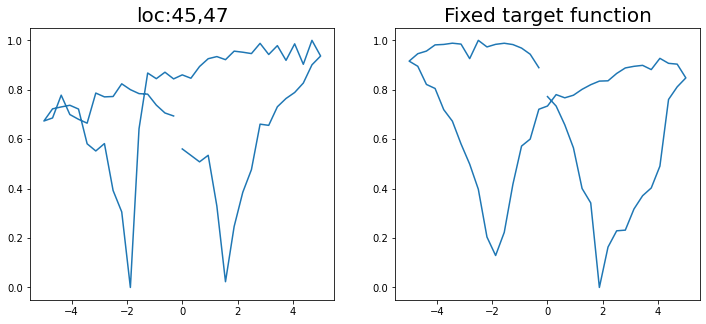

Epoch 1/200 ... Training loss: 2.5574
Epoch 10/200 ... Training loss: 2.2344
Epoch 20/200 ... Training loss: 2.0052
Epoch 30/200 ... Training loss: 1.7819
Epoch 40/200 ... Training loss: 1.6124
Epoch 50/200 ... Training loss: 1.5191
Epoch 60/200 ... Training loss: 1.6416
Epoch 70/200 ... Training loss: 1.4788
Epoch 80/200 ... Training loss: 1.4923
Epoch 90/200 ... Training loss: 1.3118
Epoch 100/200 ... Training loss: 1.2715
Epoch 110/200 ... Training loss: 1.2698
Epoch 120/200 ... Training loss: 1.4407
Epoch 130/200 ... Training loss: 1.1696
Epoch 140/200 ... Training loss: 1.1672
Epoch 150/200 ... Training loss: 1.1446
Epoch 160/200 ... Training loss: 1.0446
Epoch 170/200 ... Training loss: 1.0461
Epoch 180/200 ... Training loss: 0.9275
Epoch 190/200 ... Training loss: 1.0143
Epoch 200/200 ... Training loss: 0.901
step:  110
Sample #120




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


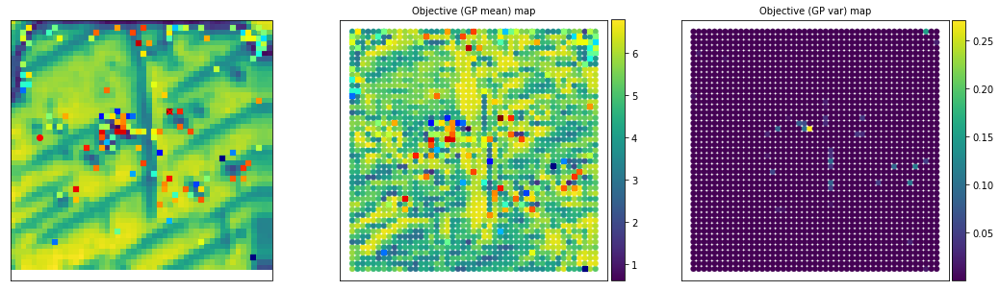

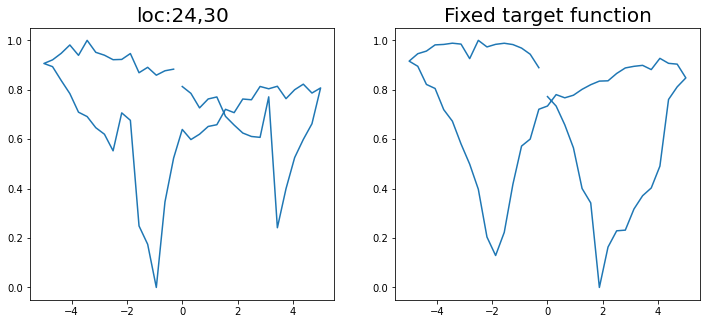

Epoch 1/200 ... Training loss: 2.5433
Epoch 10/200 ... Training loss: 2.2322
Epoch 20/200 ... Training loss: 2.0108
Epoch 30/200 ... Training loss: 1.771
Epoch 40/200 ... Training loss: 1.7434
Epoch 50/200 ... Training loss: 1.5839
Epoch 60/200 ... Training loss: 1.914
Epoch 70/200 ... Training loss: 1.7723
Epoch 80/200 ... Training loss: 1.5309
Epoch 90/200 ... Training loss: 1.4886
Epoch 100/200 ... Training loss: 1.3946
Epoch 110/200 ... Training loss: 1.2686
Epoch 120/200 ... Training loss: 1.2521
Epoch 130/200 ... Training loss: 1.2093
Epoch 140/200 ... Training loss: 1.1569
Epoch 150/200 ... Training loss: 1.1016
Epoch 160/200 ... Training loss: 1.0781
Epoch 170/200 ... Training loss: 1.0073
Epoch 180/200 ... Training loss: 0.954
Epoch 190/200 ... Training loss: 0.9643
Epoch 200/200 ... Training loss: 0.9606
step:  111
Sample #121




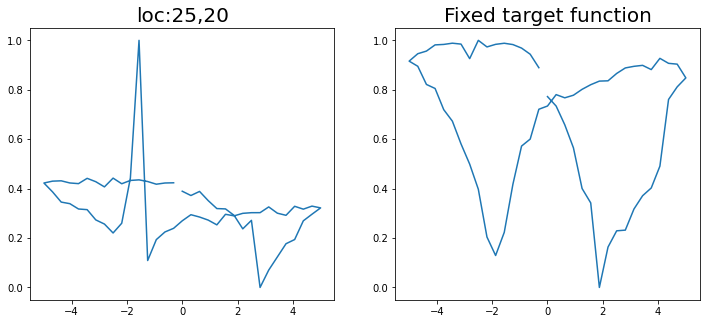

Epoch 1/200 ... Training loss: 2.5426
Epoch 10/200 ... Training loss: 2.2413
Epoch 20/200 ... Training loss: 2.0258
Epoch 30/200 ... Training loss: 1.7665
Epoch 40/200 ... Training loss: 1.6536
Epoch 50/200 ... Training loss: 1.9161
Epoch 60/200 ... Training loss: 1.8185
Epoch 70/200 ... Training loss: 1.6046
Epoch 80/200 ... Training loss: 1.4363
Epoch 90/200 ... Training loss: 1.4468
Epoch 100/200 ... Training loss: 1.3584
Epoch 110/200 ... Training loss: 1.4219
Epoch 120/200 ... Training loss: 1.3421
Epoch 130/200 ... Training loss: 1.202
Epoch 140/200 ... Training loss: 1.1525
Epoch 150/200 ... Training loss: 1.1716
Epoch 160/200 ... Training loss: 1.1239
Epoch 170/200 ... Training loss: 1.0081
Epoch 180/200 ... Training loss: 1.0629
Epoch 190/200 ... Training loss: 0.9503
Epoch 200/200 ... Training loss: 0.9669
step:  112
Sample #122




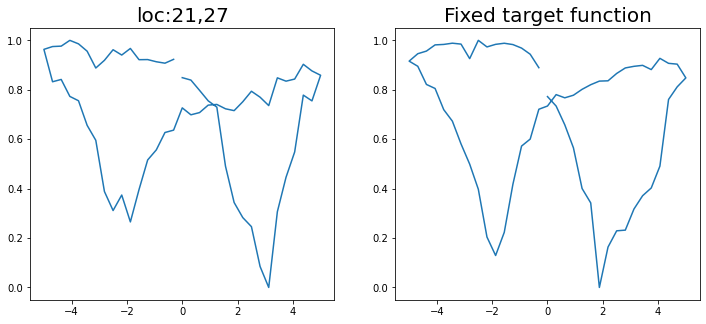

Epoch 1/200 ... Training loss: 2.5556
Epoch 10/200 ... Training loss: 2.2822
Epoch 20/200 ... Training loss: 2.062
Epoch 30/200 ... Training loss: 1.9266
Epoch 40/200 ... Training loss: 1.8602
Epoch 50/200 ... Training loss: 1.6814
Epoch 60/200 ... Training loss: 1.5599
Epoch 70/200 ... Training loss: 1.4074
Epoch 80/200 ... Training loss: 1.3907
Epoch 90/200 ... Training loss: 1.3292
Epoch 100/200 ... Training loss: 1.316
Epoch 110/200 ... Training loss: 1.2316
Epoch 120/200 ... Training loss: 1.2659
Epoch 130/200 ... Training loss: 1.1286
Epoch 140/200 ... Training loss: 1.0888
Epoch 150/200 ... Training loss: 1.034
Epoch 160/200 ... Training loss: 1.2153
Epoch 170/200 ... Training loss: 1.0292
Epoch 180/200 ... Training loss: 1.0284
Epoch 190/200 ... Training loss: 1.2327
Epoch 200/200 ... Training loss: 1.105
step:  113
Sample #123




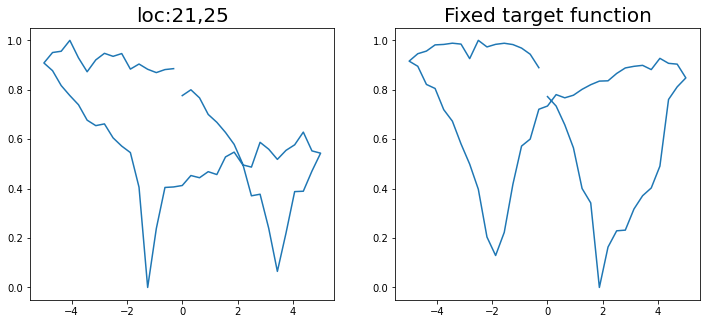

Epoch 1/200 ... Training loss: 2.5427
Epoch 10/200 ... Training loss: 2.2273
Epoch 20/200 ... Training loss: 2.0162
Epoch 30/200 ... Training loss: 1.8031
Epoch 40/200 ... Training loss: 1.836
Epoch 50/200 ... Training loss: 1.6212
Epoch 60/200 ... Training loss: 1.5328
Epoch 70/200 ... Training loss: 1.5096
Epoch 80/200 ... Training loss: 1.4774
Epoch 90/200 ... Training loss: 1.4065
Epoch 100/200 ... Training loss: 1.3925
Epoch 110/200 ... Training loss: 1.2811
Epoch 120/200 ... Training loss: 1.236
Epoch 130/200 ... Training loss: 1.1661
Epoch 140/200 ... Training loss: 1.5469
Epoch 150/200 ... Training loss: 1.3267
Epoch 160/200 ... Training loss: 1.2988
Epoch 170/200 ... Training loss: 1.2155
Epoch 180/200 ... Training loss: 1.0944
Epoch 190/200 ... Training loss: 1.1481
Epoch 200/200 ... Training loss: 1.1119
step:  114
Sample #124




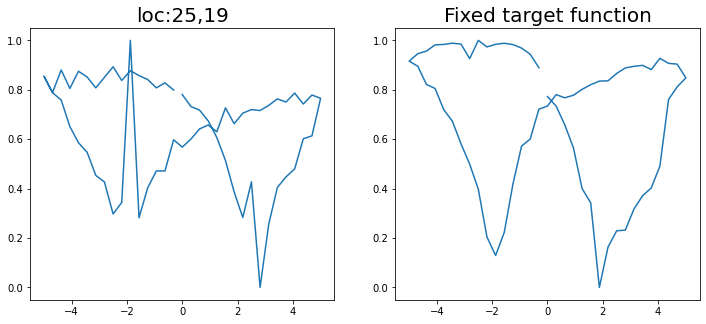

Epoch 1/200 ... Training loss: 2.5392
Epoch 10/200 ... Training loss: 2.2393
Epoch 20/200 ... Training loss: 2.0062
Epoch 30/200 ... Training loss: 1.8227
Epoch 40/200 ... Training loss: 1.7784
Epoch 50/200 ... Training loss: 1.6191
Epoch 60/200 ... Training loss: 1.4986
Epoch 70/200 ... Training loss: 1.4645
Epoch 80/200 ... Training loss: 1.355
Epoch 90/200 ... Training loss: 1.4191
Epoch 100/200 ... Training loss: 1.3048
Epoch 110/200 ... Training loss: 1.3943
Epoch 120/200 ... Training loss: 1.1816
Epoch 130/200 ... Training loss: 1.1305
Epoch 140/200 ... Training loss: 1.189
Epoch 150/200 ... Training loss: 1.1247
Epoch 160/200 ... Training loss: 1.2119
Epoch 170/200 ... Training loss: 1.0614
Epoch 180/200 ... Training loss: 0.9884
Epoch 190/200 ... Training loss: 1.0369
Epoch 200/200 ... Training loss: 1.0248
step:  115
Sample #125




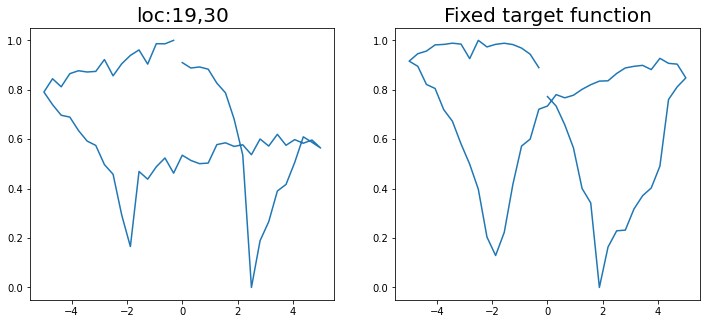

Epoch 1/200 ... Training loss: 2.5308
Epoch 10/200 ... Training loss: 2.1767
Epoch 20/200 ... Training loss: 1.9828
Epoch 30/200 ... Training loss: 1.8446
Epoch 40/200 ... Training loss: 1.7053
Epoch 50/200 ... Training loss: 1.5632
Epoch 60/200 ... Training loss: 1.6113
Epoch 70/200 ... Training loss: 1.4282
Epoch 80/200 ... Training loss: 1.5511
Epoch 90/200 ... Training loss: 1.4079
Epoch 100/200 ... Training loss: 1.3564
Epoch 110/200 ... Training loss: 1.3073
Epoch 120/200 ... Training loss: 1.1926
Epoch 130/200 ... Training loss: 1.2532
Epoch 140/200 ... Training loss: 1.2279
Epoch 150/200 ... Training loss: 1.061
Epoch 160/200 ... Training loss: 0.9793
Epoch 170/200 ... Training loss: 1.4524
Epoch 180/200 ... Training loss: 1.3491
Epoch 190/200 ... Training loss: 1.0565
Epoch 200/200 ... Training loss: 0.9681
step:  116
Sample #126




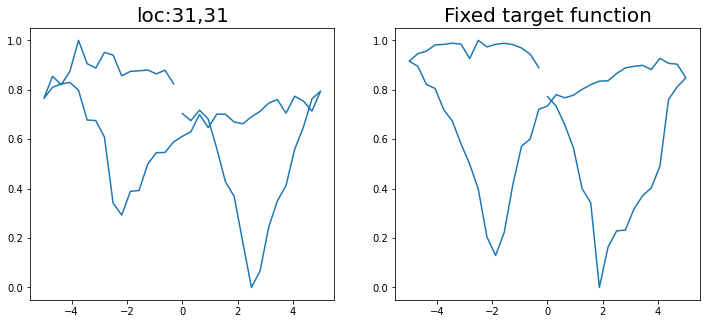

Epoch 1/200 ... Training loss: 2.5311
Epoch 10/200 ... Training loss: 2.2065
Epoch 20/200 ... Training loss: 1.9855
Epoch 30/200 ... Training loss: 1.7803
Epoch 40/200 ... Training loss: 1.7252
Epoch 50/200 ... Training loss: 1.6593
Epoch 60/200 ... Training loss: 1.4688
Epoch 70/200 ... Training loss: 1.5411
Epoch 80/200 ... Training loss: 1.4104
Epoch 90/200 ... Training loss: 1.5359
Epoch 100/200 ... Training loss: 1.3268
Epoch 110/200 ... Training loss: 1.304
Epoch 120/200 ... Training loss: 1.2279
Epoch 130/200 ... Training loss: 1.1719
Epoch 140/200 ... Training loss: 1.2976
Epoch 150/200 ... Training loss: 1.247
Epoch 160/200 ... Training loss: 1.103
Epoch 170/200 ... Training loss: 1.0726
Epoch 180/200 ... Training loss: 1.0653
Epoch 190/200 ... Training loss: 1.1
Epoch 200/200 ... Training loss: 1.0812
step:  117
Sample #127




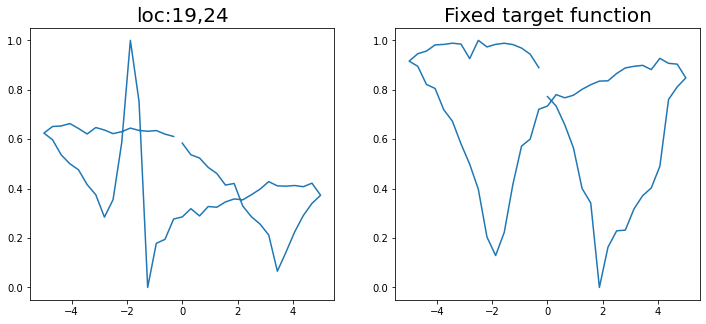

Epoch 1/200 ... Training loss: 2.5211
Epoch 10/200 ... Training loss: 2.2318
Epoch 20/200 ... Training loss: 2.0314
Epoch 30/200 ... Training loss: 1.8728
Epoch 40/200 ... Training loss: 1.7355
Epoch 50/200 ... Training loss: 1.5999
Epoch 60/200 ... Training loss: 1.6047
Epoch 70/200 ... Training loss: 1.527
Epoch 80/200 ... Training loss: 1.3788
Epoch 90/200 ... Training loss: 1.3856
Epoch 100/200 ... Training loss: 1.468
Epoch 110/200 ... Training loss: 1.3008
Epoch 120/200 ... Training loss: 1.2279
Epoch 130/200 ... Training loss: 1.1985
Epoch 140/200 ... Training loss: 1.1353
Epoch 150/200 ... Training loss: 1.119
Epoch 160/200 ... Training loss: 1.0627
Epoch 170/200 ... Training loss: 1.0386
Epoch 180/200 ... Training loss: 1.2031
Epoch 190/200 ... Training loss: 1.1203
Epoch 200/200 ... Training loss: 0.9935
step:  118
Sample #128




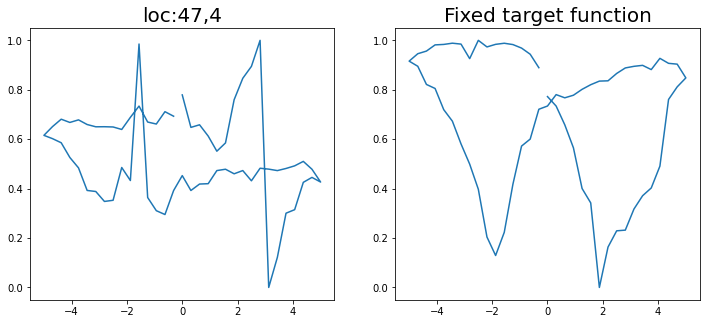

Epoch 1/200 ... Training loss: 2.5143
Epoch 10/200 ... Training loss: 2.2365
Epoch 20/200 ... Training loss: 2.031
Epoch 30/200 ... Training loss: 1.8586
Epoch 40/200 ... Training loss: 1.6661
Epoch 50/200 ... Training loss: 1.5896
Epoch 60/200 ... Training loss: 1.5656
Epoch 70/200 ... Training loss: 1.4314
Epoch 80/200 ... Training loss: 1.3107
Epoch 90/200 ... Training loss: 1.698
Epoch 100/200 ... Training loss: 1.3781
Epoch 110/200 ... Training loss: 1.2513
Epoch 120/200 ... Training loss: 1.2357
Epoch 130/200 ... Training loss: 1.2213
Epoch 140/200 ... Training loss: 1.1085
Epoch 150/200 ... Training loss: 1.136
Epoch 160/200 ... Training loss: 1.0226
Epoch 170/200 ... Training loss: 0.9844
Epoch 180/200 ... Training loss: 0.9502
Epoch 190/200 ... Training loss: 0.9815
Epoch 200/200 ... Training loss: 0.9349
step:  119
Sample #129




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


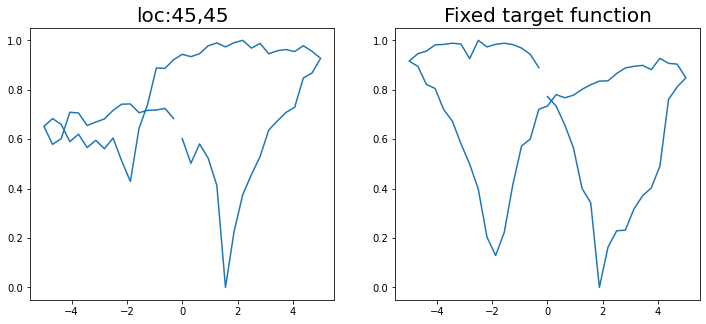

Epoch 1/200 ... Training loss: 2.5039
Epoch 10/200 ... Training loss: 2.3143
Epoch 20/200 ... Training loss: 2.1682
Epoch 30/200 ... Training loss: 2.0149
Epoch 40/200 ... Training loss: 1.9082
Epoch 50/200 ... Training loss: 1.7448
Epoch 60/200 ... Training loss: 1.6353
Epoch 70/200 ... Training loss: 1.5678
Epoch 80/200 ... Training loss: 1.5065
Epoch 90/200 ... Training loss: 1.4725
Epoch 100/200 ... Training loss: 1.4837
Epoch 110/200 ... Training loss: 1.473
Epoch 120/200 ... Training loss: 1.2842
Epoch 130/200 ... Training loss: 1.28
Epoch 140/200 ... Training loss: 1.2855
Epoch 150/200 ... Training loss: 1.3638
Epoch 160/200 ... Training loss: 1.2693
Epoch 170/200 ... Training loss: 1.1433
Epoch 180/200 ... Training loss: 1.1558
Epoch 190/200 ... Training loss: 1.0318
Epoch 200/200 ... Training loss: 1.2584
step:  120
Sample #130




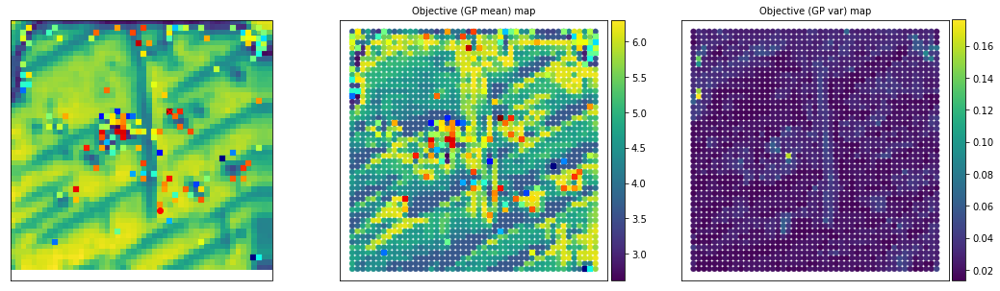

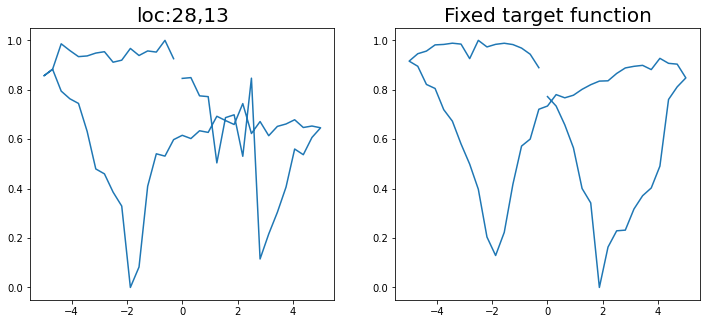

Epoch 1/200 ... Training loss: 2.4928
Epoch 10/200 ... Training loss: 2.1655
Epoch 20/200 ... Training loss: 1.9871
Epoch 30/200 ... Training loss: 1.7743
Epoch 40/200 ... Training loss: 1.6423
Epoch 50/200 ... Training loss: 1.5107
Epoch 60/200 ... Training loss: 1.4489
Epoch 70/200 ... Training loss: 1.756
Epoch 80/200 ... Training loss: 1.4877
Epoch 90/200 ... Training loss: 1.328
Epoch 100/200 ... Training loss: 1.6891
Epoch 110/200 ... Training loss: 1.4162
Epoch 120/200 ... Training loss: 1.2435
Epoch 130/200 ... Training loss: 1.1997
Epoch 140/200 ... Training loss: 1.244
Epoch 150/200 ... Training loss: 1.2144
Epoch 160/200 ... Training loss: 1.2039
Epoch 170/200 ... Training loss: 1.0594
Epoch 180/200 ... Training loss: 1.0059
Epoch 190/200 ... Training loss: 0.9911
Epoch 200/200 ... Training loss: 0.8949
step:  121
Sample #131




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


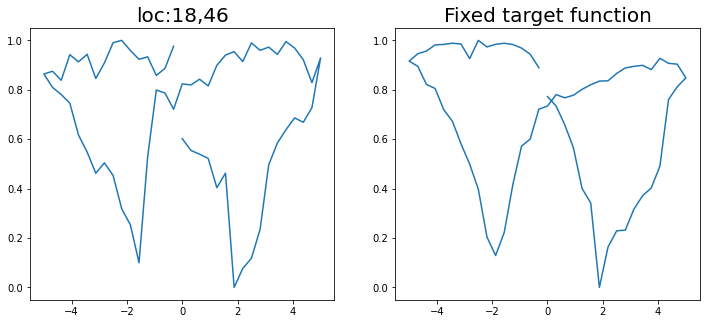

Epoch 1/200 ... Training loss: 2.5028
Epoch 10/200 ... Training loss: 2.2597
Epoch 20/200 ... Training loss: 2.0733
Epoch 30/200 ... Training loss: 1.9358
Epoch 40/200 ... Training loss: 1.8775
Epoch 50/200 ... Training loss: 1.657
Epoch 60/200 ... Training loss: 1.5548
Epoch 70/200 ... Training loss: 1.6432
Epoch 80/200 ... Training loss: 1.4035
Epoch 90/200 ... Training loss: 1.4725
Epoch 100/200 ... Training loss: 1.3159
Epoch 110/200 ... Training loss: 1.4946
Epoch 120/200 ... Training loss: 1.2619
Epoch 130/200 ... Training loss: 1.1598
Epoch 140/200 ... Training loss: 1.3898
Epoch 150/200 ... Training loss: 1.2834
Epoch 160/200 ... Training loss: 1.1287
Epoch 170/200 ... Training loss: 1.1085
Epoch 180/200 ... Training loss: 1.0157
Epoch 190/200 ... Training loss: 1.0536
Epoch 200/200 ... Training loss: 1.0378
step:  122
Sample #132




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


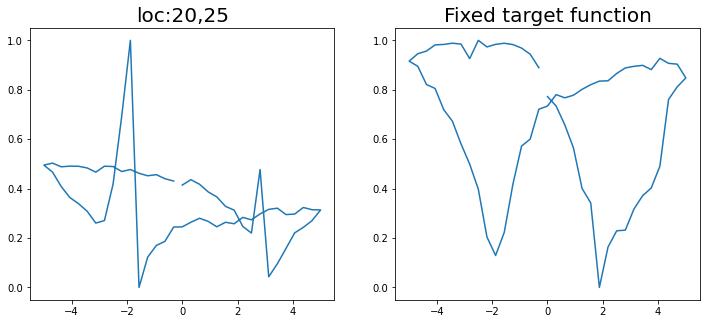

Epoch 1/200 ... Training loss: 2.5243
Epoch 10/200 ... Training loss: 2.2671
Epoch 20/200 ... Training loss: 2.0481
Epoch 30/200 ... Training loss: 1.9187
Epoch 40/200 ... Training loss: 1.7872
Epoch 50/200 ... Training loss: 1.6438
Epoch 60/200 ... Training loss: 1.5124
Epoch 70/200 ... Training loss: 1.6874
Epoch 80/200 ... Training loss: 1.4455
Epoch 90/200 ... Training loss: 1.3107
Epoch 100/200 ... Training loss: 1.5684
Epoch 110/200 ... Training loss: 1.3118
Epoch 120/200 ... Training loss: 1.3408
Epoch 130/200 ... Training loss: 1.3137
Epoch 140/200 ... Training loss: 1.2155
Epoch 150/200 ... Training loss: 1.1264
Epoch 160/200 ... Training loss: 1.13
Epoch 170/200 ... Training loss: 1.0526
Epoch 180/200 ... Training loss: 1.0239
Epoch 190/200 ... Training loss: 1.0631
Epoch 200/200 ... Training loss: 0.9264
step:  123
Sample #133




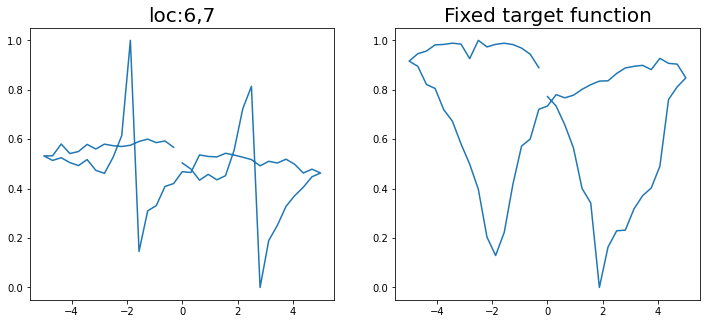

Epoch 1/200 ... Training loss: 2.5483
Epoch 10/200 ... Training loss: 2.3172
Epoch 20/200 ... Training loss: 2.122
Epoch 30/200 ... Training loss: 1.9808
Epoch 40/200 ... Training loss: 1.829
Epoch 50/200 ... Training loss: 1.7914
Epoch 60/200 ... Training loss: 1.633
Epoch 70/200 ... Training loss: 1.5949
Epoch 80/200 ... Training loss: 1.4788
Epoch 90/200 ... Training loss: 1.4866
Epoch 100/200 ... Training loss: 1.3644
Epoch 110/200 ... Training loss: 1.3038
Epoch 120/200 ... Training loss: 1.3119
Epoch 130/200 ... Training loss: 1.1957
Epoch 140/200 ... Training loss: 1.2324
Epoch 150/200 ... Training loss: 1.1992
Epoch 160/200 ... Training loss: 1.2395
Epoch 170/200 ... Training loss: 1.1166
Epoch 180/200 ... Training loss: 1.2878
Epoch 190/200 ... Training loss: 1.1044
Epoch 200/200 ... Training loss: 1.0007
step:  124
Sample #134




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


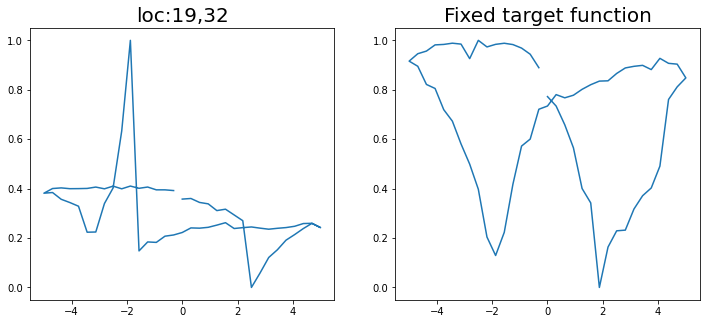

Epoch 1/200 ... Training loss: 2.5773
Epoch 10/200 ... Training loss: 2.2287
Epoch 20/200 ... Training loss: 2.039
Epoch 30/200 ... Training loss: 1.8394
Epoch 40/200 ... Training loss: 1.8339
Epoch 50/200 ... Training loss: 1.6451
Epoch 60/200 ... Training loss: 1.5003
Epoch 70/200 ... Training loss: 1.4903
Epoch 80/200 ... Training loss: 1.5701
Epoch 90/200 ... Training loss: 1.5426
Epoch 100/200 ... Training loss: 1.3741
Epoch 110/200 ... Training loss: 1.2828
Epoch 120/200 ... Training loss: 1.1953
Epoch 130/200 ... Training loss: 1.2349
Epoch 140/200 ... Training loss: 1.098
Epoch 150/200 ... Training loss: 1.0325
Epoch 160/200 ... Training loss: 1.5104
Epoch 170/200 ... Training loss: 1.2086
Epoch 180/200 ... Training loss: 1.0402
Epoch 190/200 ... Training loss: 1.0032
Epoch 200/200 ... Training loss: 1.0616
step:  125
Sample #135




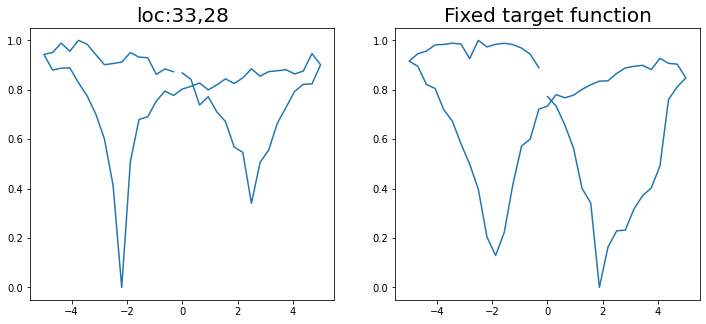

Epoch 1/200 ... Training loss: 2.5781
Epoch 10/200 ... Training loss: 2.3488
Epoch 20/200 ... Training loss: 2.1279
Epoch 30/200 ... Training loss: 1.9855
Epoch 40/200 ... Training loss: 1.8641
Epoch 50/200 ... Training loss: 1.6786
Epoch 60/200 ... Training loss: 1.5816
Epoch 70/200 ... Training loss: 1.5229
Epoch 80/200 ... Training loss: 1.7554
Epoch 90/200 ... Training loss: 1.503
Epoch 100/200 ... Training loss: 1.4412
Epoch 110/200 ... Training loss: 1.2925
Epoch 120/200 ... Training loss: 1.3925
Epoch 130/200 ... Training loss: 1.3824
Epoch 140/200 ... Training loss: 1.2765
Epoch 150/200 ... Training loss: 1.1682
Epoch 160/200 ... Training loss: 1.1603
Epoch 170/200 ... Training loss: 1.1755
Epoch 180/200 ... Training loss: 1.1059
Epoch 190/200 ... Training loss: 1.0943
Epoch 200/200 ... Training loss: 1.1049
step:  126
Sample #136




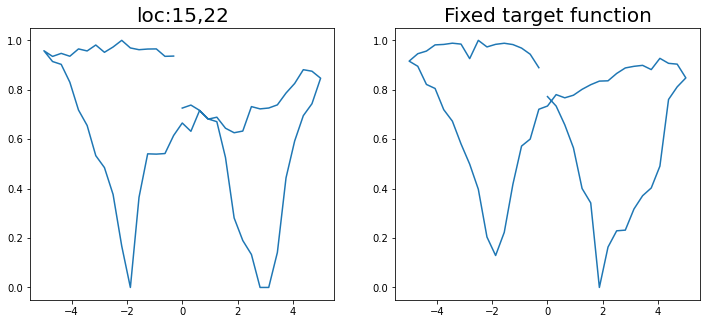

Epoch 1/200 ... Training loss: 2.5888
Epoch 10/200 ... Training loss: 2.3549
Epoch 20/200 ... Training loss: 2.1358
Epoch 30/200 ... Training loss: 1.9964
Epoch 40/200 ... Training loss: 1.8641
Epoch 50/200 ... Training loss: 1.6609
Epoch 60/200 ... Training loss: 1.805
Epoch 70/200 ... Training loss: 1.7649
Epoch 80/200 ... Training loss: 1.6025
Epoch 90/200 ... Training loss: 1.4847
Epoch 100/200 ... Training loss: 1.3709
Epoch 110/200 ... Training loss: 1.35
Epoch 120/200 ... Training loss: 1.2667
Epoch 130/200 ... Training loss: 1.2082
Epoch 140/200 ... Training loss: 1.3932
Epoch 150/200 ... Training loss: 1.2495
Epoch 160/200 ... Training loss: 1.1567
Epoch 170/200 ... Training loss: 1.2027
Epoch 180/200 ... Training loss: 1.0749
Epoch 190/200 ... Training loss: 1.0164
Epoch 200/200 ... Training loss: 1.0538
step:  127
Sample #137




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


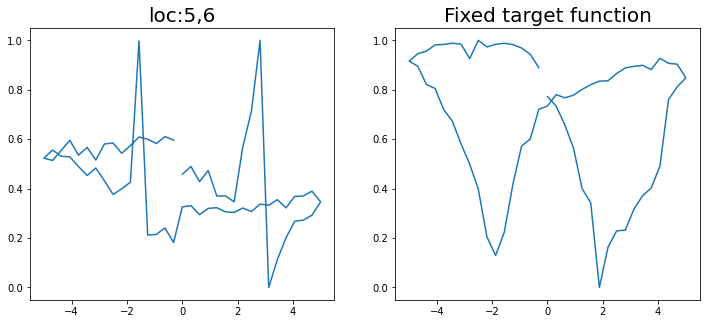

Epoch 1/200 ... Training loss: 2.6106
Epoch 10/200 ... Training loss: 2.3448
Epoch 20/200 ... Training loss: 2.1594
Epoch 30/200 ... Training loss: 2.0258
Epoch 40/200 ... Training loss: 1.8871
Epoch 50/200 ... Training loss: 1.8433
Epoch 60/200 ... Training loss: 1.7998
Epoch 70/200 ... Training loss: 1.6147
Epoch 80/200 ... Training loss: 1.6141
Epoch 90/200 ... Training loss: 1.4185
Epoch 100/200 ... Training loss: 1.3131
Epoch 110/200 ... Training loss: 1.2985
Epoch 120/200 ... Training loss: 1.7507
Epoch 130/200 ... Training loss: 1.5005
Epoch 140/200 ... Training loss: 1.2944
Epoch 150/200 ... Training loss: 1.2395
Epoch 160/200 ... Training loss: 1.1748
Epoch 170/200 ... Training loss: 1.1055
Epoch 180/200 ... Training loss: 1.0981
Epoch 190/200 ... Training loss: 1.0538
Epoch 200/200 ... Training loss: 1.0168
step:  128
Sample #138




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


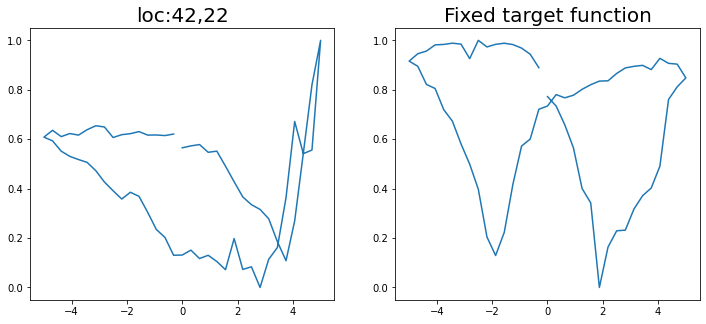

Epoch 1/200 ... Training loss: 2.6197
Epoch 10/200 ... Training loss: 2.302
Epoch 20/200 ... Training loss: 2.1082
Epoch 30/200 ... Training loss: 1.9172
Epoch 40/200 ... Training loss: 1.759
Epoch 50/200 ... Training loss: 1.797
Epoch 60/200 ... Training loss: 1.5217
Epoch 70/200 ... Training loss: 1.7762
Epoch 80/200 ... Training loss: 1.5098
Epoch 90/200 ... Training loss: 1.4829
Epoch 100/200 ... Training loss: 1.3899
Epoch 110/200 ... Training loss: 1.3442
Epoch 120/200 ... Training loss: 1.204
Epoch 130/200 ... Training loss: 1.1311
Epoch 140/200 ... Training loss: 1.1548
Epoch 150/200 ... Training loss: 1.1078
Epoch 160/200 ... Training loss: 1.0722
Epoch 170/200 ... Training loss: 1.054
Epoch 180/200 ... Training loss: 1.079
Epoch 190/200 ... Training loss: 1.007
Epoch 200/200 ... Training loss: 0.8973
step:  129
Sample #139




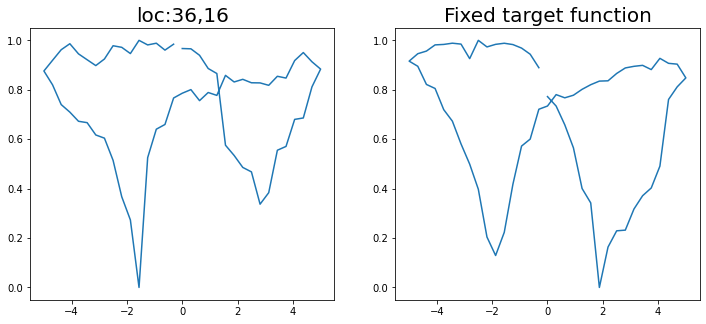

Epoch 1/200 ... Training loss: 2.6313
Epoch 10/200 ... Training loss: 2.2739
Epoch 20/200 ... Training loss: 2.0696
Epoch 30/200 ... Training loss: 1.8223
Epoch 40/200 ... Training loss: 1.8203
Epoch 50/200 ... Training loss: 1.7883
Epoch 60/200 ... Training loss: 1.5569
Epoch 70/200 ... Training loss: 1.5192
Epoch 80/200 ... Training loss: 1.3938
Epoch 90/200 ... Training loss: 1.3995
Epoch 100/200 ... Training loss: 1.2616
Epoch 110/200 ... Training loss: 1.3351
Epoch 120/200 ... Training loss: 1.3984
Epoch 130/200 ... Training loss: 1.2062
Epoch 140/200 ... Training loss: 1.1092
Epoch 150/200 ... Training loss: 1.1212
Epoch 160/200 ... Training loss: 1.0566
Epoch 170/200 ... Training loss: 1.0386
Epoch 180/200 ... Training loss: 0.9805
Epoch 190/200 ... Training loss: 0.9074
Epoch 200/200 ... Training loss: 1.091
step:  130
Sample #140




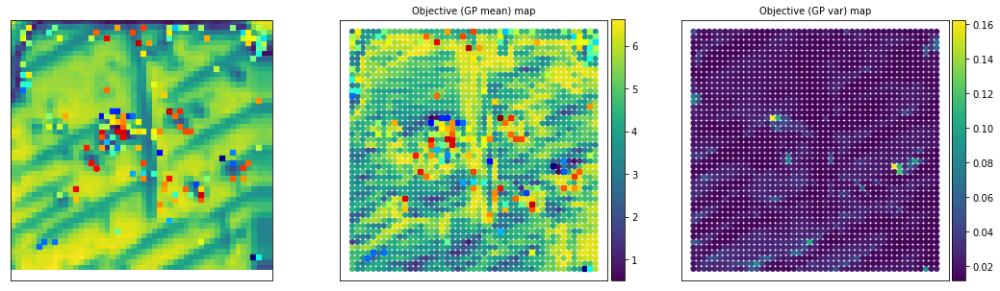

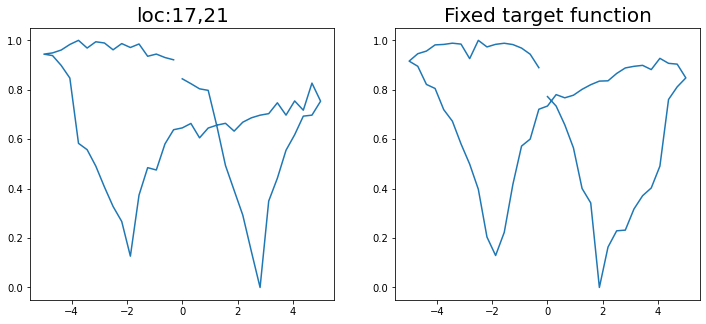

Epoch 1/200 ... Training loss: 2.6419
Epoch 10/200 ... Training loss: 2.3644
Epoch 20/200 ... Training loss: 2.146
Epoch 30/200 ... Training loss: 1.9804
Epoch 40/200 ... Training loss: 1.7533
Epoch 50/200 ... Training loss: 1.8175
Epoch 60/200 ... Training loss: 1.6034
Epoch 70/200 ... Training loss: 1.4914
Epoch 80/200 ... Training loss: 1.6467
Epoch 90/200 ... Training loss: 1.4024
Epoch 100/200 ... Training loss: 1.592
Epoch 110/200 ... Training loss: 1.4094
Epoch 120/200 ... Training loss: 1.3831
Epoch 130/200 ... Training loss: 1.3054
Epoch 140/200 ... Training loss: 1.1714
Epoch 150/200 ... Training loss: 1.2054
Epoch 160/200 ... Training loss: 1.128
Epoch 170/200 ... Training loss: 1.1116
Epoch 180/200 ... Training loss: 1.0918
Epoch 190/200 ... Training loss: 1.0115
Epoch 200/200 ... Training loss: 0.9275
step:  131
Sample #141




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


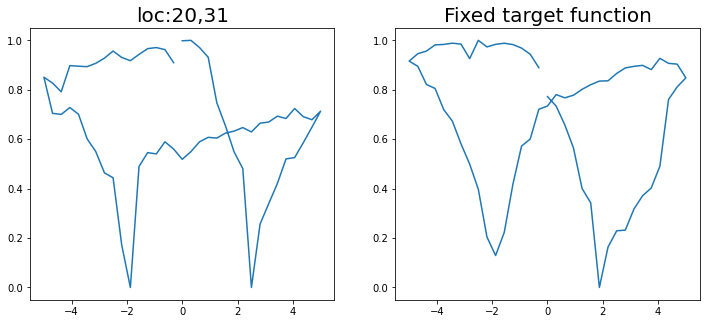

Epoch 1/200 ... Training loss: 2.647
Epoch 10/200 ... Training loss: 2.3144
Epoch 20/200 ... Training loss: 2.12
Epoch 30/200 ... Training loss: 1.9386
Epoch 40/200 ... Training loss: 2.0072
Epoch 50/200 ... Training loss: 1.8524
Epoch 60/200 ... Training loss: 1.6241
Epoch 70/200 ... Training loss: 1.5676
Epoch 80/200 ... Training loss: 1.4435
Epoch 90/200 ... Training loss: 1.3978
Epoch 100/200 ... Training loss: 1.3713
Epoch 110/200 ... Training loss: 1.3574
Epoch 120/200 ... Training loss: 1.2456
Epoch 130/200 ... Training loss: 1.3131
Epoch 140/200 ... Training loss: 1.1491
Epoch 150/200 ... Training loss: 1.1259
Epoch 160/200 ... Training loss: 1.0774
Epoch 170/200 ... Training loss: 1.0508
Epoch 180/200 ... Training loss: 1.0525
Epoch 190/200 ... Training loss: 1.0279
Epoch 200/200 ... Training loss: 1.1093
step:  132
Sample #142




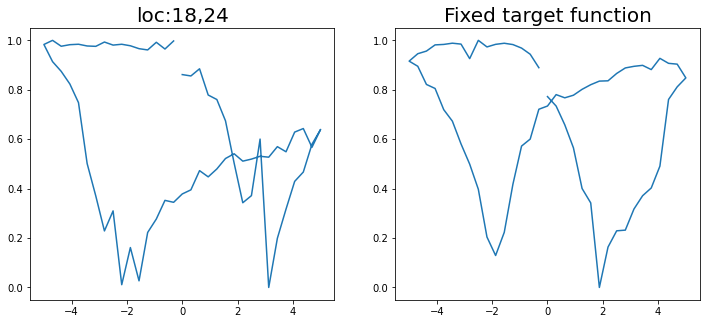

Epoch 1/200 ... Training loss: 2.6374
Epoch 10/200 ... Training loss: 2.3965
Epoch 20/200 ... Training loss: 2.1612
Epoch 30/200 ... Training loss: 2.0257
Epoch 40/200 ... Training loss: 1.7988
Epoch 50/200 ... Training loss: 1.6249
Epoch 60/200 ... Training loss: 1.6497
Epoch 70/200 ... Training loss: 1.5277
Epoch 80/200 ... Training loss: 1.4503
Epoch 90/200 ... Training loss: 1.4905
Epoch 100/200 ... Training loss: 1.3232
Epoch 110/200 ... Training loss: 1.2641
Epoch 120/200 ... Training loss: 1.1821
Epoch 130/200 ... Training loss: 1.2071
Epoch 140/200 ... Training loss: 1.1714
Epoch 150/200 ... Training loss: 1.0656
Epoch 160/200 ... Training loss: 1.2299
Epoch 170/200 ... Training loss: 0.9998
Epoch 180/200 ... Training loss: 0.9504
Epoch 190/200 ... Training loss: 0.9828
Epoch 200/200 ... Training loss: 0.9208
step:  133
Sample #143




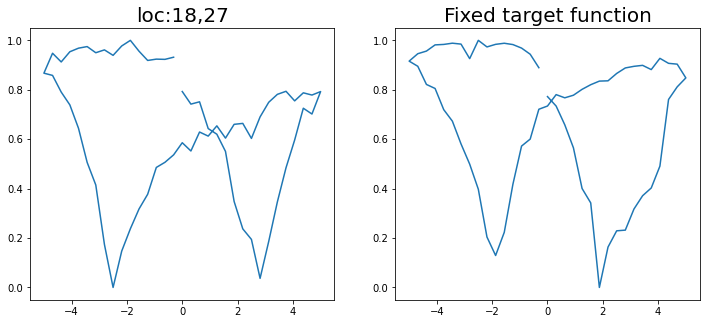

Epoch 1/200 ... Training loss: 2.6521
Epoch 10/200 ... Training loss: 2.3197
Epoch 20/200 ... Training loss: 2.1146
Epoch 30/200 ... Training loss: 1.8913
Epoch 40/200 ... Training loss: 1.6649
Epoch 50/200 ... Training loss: 1.6956
Epoch 60/200 ... Training loss: 1.5883
Epoch 70/200 ... Training loss: 1.5101
Epoch 80/200 ... Training loss: 1.5343
Epoch 90/200 ... Training loss: 1.3371
Epoch 100/200 ... Training loss: 1.274
Epoch 110/200 ... Training loss: 1.1931
Epoch 120/200 ... Training loss: 1.3741
Epoch 130/200 ... Training loss: 1.2129
Epoch 140/200 ... Training loss: 1.3589
Epoch 150/200 ... Training loss: 1.1341
Epoch 160/200 ... Training loss: 1.0867
Epoch 170/200 ... Training loss: 1.0307
Epoch 180/200 ... Training loss: 0.9848
Epoch 190/200 ... Training loss: 0.9331
Epoch 200/200 ... Training loss: 0.946
step:  134
Sample #144




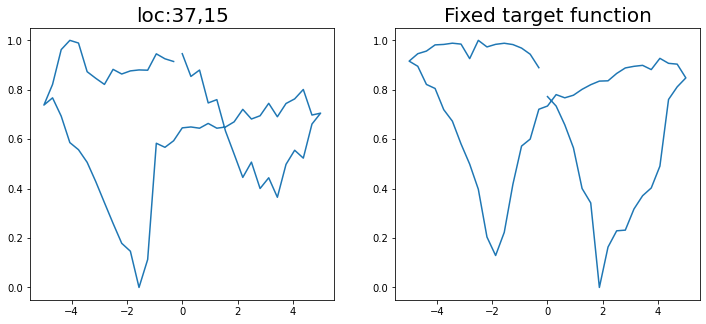

Epoch 1/200 ... Training loss: 2.6484
Epoch 10/200 ... Training loss: 2.345
Epoch 20/200 ... Training loss: 2.1317
Epoch 30/200 ... Training loss: 1.9765
Epoch 40/200 ... Training loss: 1.8513
Epoch 50/200 ... Training loss: 1.6522
Epoch 60/200 ... Training loss: 1.737
Epoch 70/200 ... Training loss: 1.746
Epoch 80/200 ... Training loss: 1.5599
Epoch 90/200 ... Training loss: 1.4879
Epoch 100/200 ... Training loss: 1.4079
Epoch 110/200 ... Training loss: 1.3655
Epoch 120/200 ... Training loss: 1.3372
Epoch 130/200 ... Training loss: 1.2171
Epoch 140/200 ... Training loss: 1.2042
Epoch 150/200 ... Training loss: 1.1332
Epoch 160/200 ... Training loss: 1.0938
Epoch 170/200 ... Training loss: 1.1922
Epoch 180/200 ... Training loss: 1.0293
Epoch 190/200 ... Training loss: 1.1817
Epoch 200/200 ... Training loss: 1.0827
step:  135
Sample #145




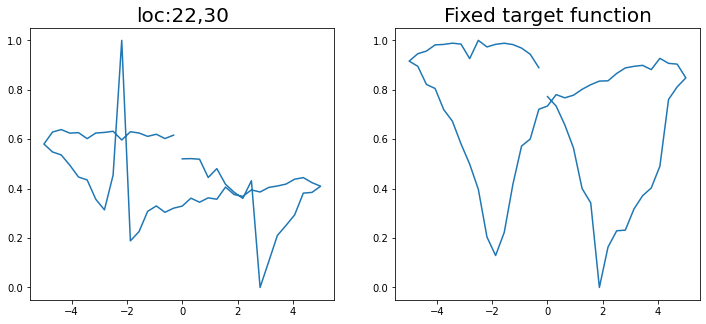

Epoch 1/200 ... Training loss: 2.636
Epoch 10/200 ... Training loss: 2.3619
Epoch 20/200 ... Training loss: 2.1354
Epoch 30/200 ... Training loss: 1.9712
Epoch 40/200 ... Training loss: 1.9793
Epoch 50/200 ... Training loss: 1.8114
Epoch 60/200 ... Training loss: 1.628
Epoch 70/200 ... Training loss: 1.6438
Epoch 80/200 ... Training loss: 1.4882
Epoch 90/200 ... Training loss: 1.5005
Epoch 100/200 ... Training loss: 1.343
Epoch 110/200 ... Training loss: 1.4499
Epoch 120/200 ... Training loss: 1.2954
Epoch 130/200 ... Training loss: 1.2706
Epoch 140/200 ... Training loss: 1.2138
Epoch 150/200 ... Training loss: 1.1629
Epoch 160/200 ... Training loss: 1.0926
Epoch 170/200 ... Training loss: 1.2586
Epoch 180/200 ... Training loss: 1.0946
Epoch 190/200 ... Training loss: 1.0222
Epoch 200/200 ... Training loss: 1.1126
step:  136
Sample #146




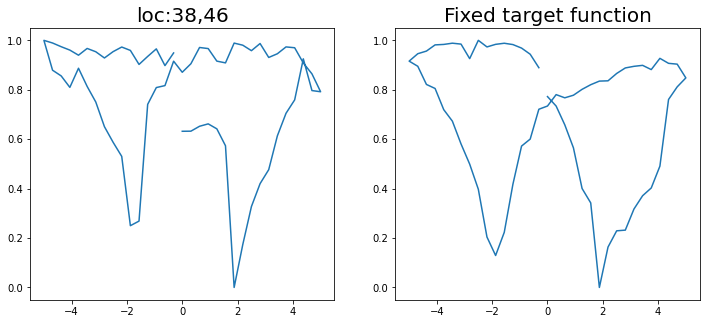

Epoch 1/200 ... Training loss: 2.634
Epoch 10/200 ... Training loss: 2.3837
Epoch 20/200 ... Training loss: 2.1657
Epoch 30/200 ... Training loss: 2.0269
Epoch 40/200 ... Training loss: 1.8736
Epoch 50/200 ... Training loss: 1.6737
Epoch 60/200 ... Training loss: 1.5559
Epoch 70/200 ... Training loss: 1.4263
Epoch 80/200 ... Training loss: 1.4135
Epoch 90/200 ... Training loss: 1.4282
Epoch 100/200 ... Training loss: 1.3046
Epoch 110/200 ... Training loss: 1.2118
Epoch 120/200 ... Training loss: 1.2396
Epoch 130/200 ... Training loss: 1.2083
Epoch 140/200 ... Training loss: 1.233
Epoch 150/200 ... Training loss: 1.1633
Epoch 160/200 ... Training loss: 1.0772
Epoch 170/200 ... Training loss: 1.0288
Epoch 180/200 ... Training loss: 0.9721
Epoch 190/200 ... Training loss: 0.9355
Epoch 200/200 ... Training loss: 1.0388
step:  137
Sample #147




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


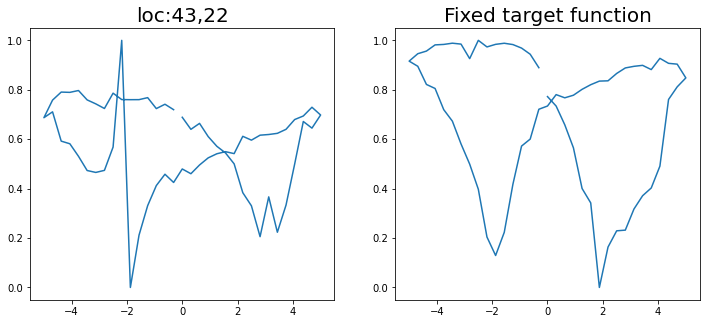

Epoch 1/200 ... Training loss: 2.6358
Epoch 10/200 ... Training loss: 2.3185
Epoch 20/200 ... Training loss: 2.1672
Epoch 30/200 ... Training loss: 2.0281
Epoch 40/200 ... Training loss: 1.8755
Epoch 50/200 ... Training loss: 1.7162
Epoch 60/200 ... Training loss: 1.5266
Epoch 70/200 ... Training loss: 1.4885
Epoch 80/200 ... Training loss: 1.3842
Epoch 90/200 ... Training loss: 1.4704
Epoch 100/200 ... Training loss: 1.3774
Epoch 110/200 ... Training loss: 1.2557
Epoch 120/200 ... Training loss: 1.3455
Epoch 130/200 ... Training loss: 1.2032
Epoch 140/200 ... Training loss: 1.1854
Epoch 150/200 ... Training loss: 1.1631
Epoch 160/200 ... Training loss: 1.2761
Epoch 170/200 ... Training loss: 1.1006
Epoch 180/200 ... Training loss: 1.1649
Epoch 190/200 ... Training loss: 0.9882
Epoch 200/200 ... Training loss: 1.0087
step:  138
Sample #148




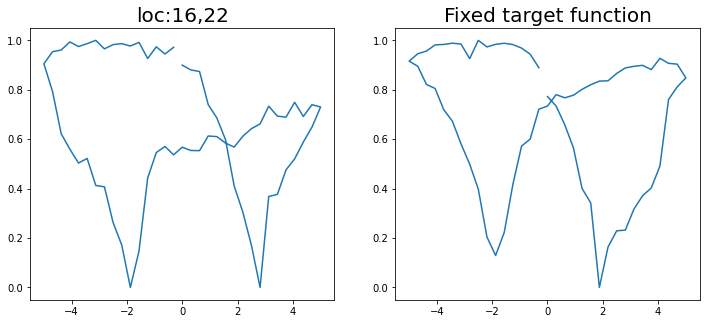

Epoch 1/200 ... Training loss: 2.6446
Epoch 10/200 ... Training loss: 2.4735
Epoch 20/200 ... Training loss: 2.1955
Epoch 30/200 ... Training loss: 2.072
Epoch 40/200 ... Training loss: 1.9379
Epoch 50/200 ... Training loss: 1.731
Epoch 60/200 ... Training loss: 1.7242
Epoch 70/200 ... Training loss: 1.8282
Epoch 80/200 ... Training loss: 1.6543
Epoch 90/200 ... Training loss: 1.514
Epoch 100/200 ... Training loss: 1.4426
Epoch 110/200 ... Training loss: 1.3446
Epoch 120/200 ... Training loss: 1.5496
Epoch 130/200 ... Training loss: 1.4123
Epoch 140/200 ... Training loss: 1.2553
Epoch 150/200 ... Training loss: 1.2406
Epoch 160/200 ... Training loss: 1.1929
Epoch 170/200 ... Training loss: 1.3327
Epoch 180/200 ... Training loss: 1.1661
Epoch 190/200 ... Training loss: 1.0841
Epoch 200/200 ... Training loss: 1.1188
step:  139
Sample #149




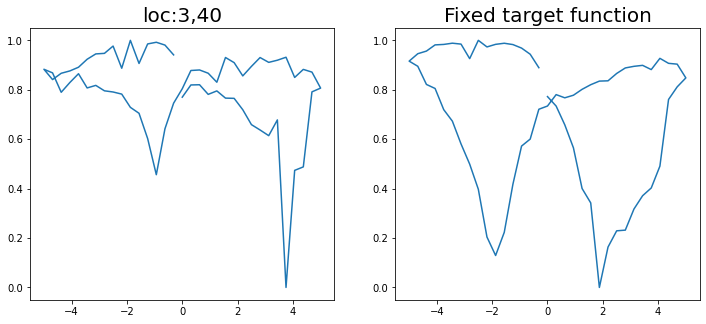

Epoch 1/200 ... Training loss: 2.6393
Epoch 10/200 ... Training loss: 2.3426
Epoch 20/200 ... Training loss: 2.1269
Epoch 30/200 ... Training loss: 1.9702
Epoch 40/200 ... Training loss: 1.9355
Epoch 50/200 ... Training loss: 1.7362
Epoch 60/200 ... Training loss: 1.5681
Epoch 70/200 ... Training loss: 1.427
Epoch 80/200 ... Training loss: 1.4525
Epoch 90/200 ... Training loss: 1.358
Epoch 100/200 ... Training loss: 1.2551
Epoch 110/200 ... Training loss: 1.2426
Epoch 120/200 ... Training loss: 1.1672
Epoch 130/200 ... Training loss: 1.3138
Epoch 140/200 ... Training loss: 1.1742
Epoch 150/200 ... Training loss: 1.071
Epoch 160/200 ... Training loss: 1.0217
Epoch 170/200 ... Training loss: 1.021
Epoch 180/200 ... Training loss: 1.0367
Epoch 190/200 ... Training loss: 0.9455
Epoch 200/200 ... Training loss: 0.9446
step:  140
Sample #150




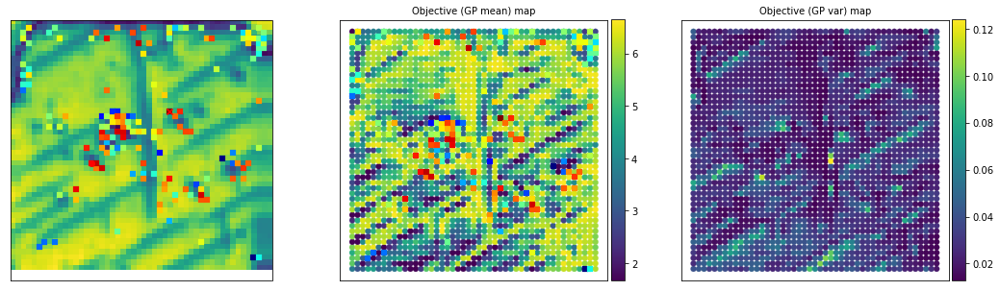

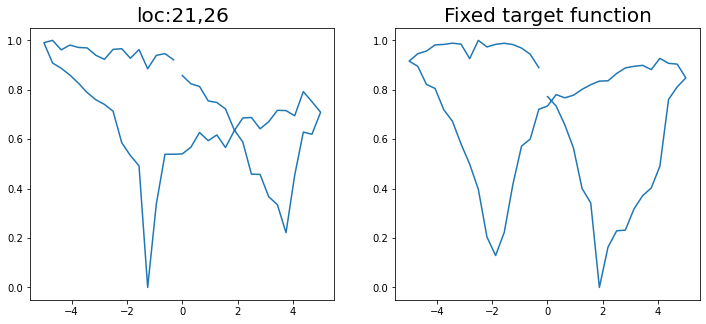

Epoch 1/200 ... Training loss: 2.6268
Epoch 10/200 ... Training loss: 2.4277
Epoch 20/200 ... Training loss: 2.1901
Epoch 30/200 ... Training loss: 2.0566
Epoch 40/200 ... Training loss: 1.8539
Epoch 50/200 ... Training loss: 1.7122
Epoch 60/200 ... Training loss: 1.5687
Epoch 70/200 ... Training loss: 1.5511
Epoch 80/200 ... Training loss: 1.4565
Epoch 90/200 ... Training loss: 1.395
Epoch 100/200 ... Training loss: 1.6416
Epoch 110/200 ... Training loss: 1.3483
Epoch 120/200 ... Training loss: 1.2899
Epoch 130/200 ... Training loss: 1.268
Epoch 140/200 ... Training loss: 1.2053
Epoch 150/200 ... Training loss: 1.1855
Epoch 160/200 ... Training loss: 1.1679
Epoch 170/200 ... Training loss: 1.11
Epoch 180/200 ... Training loss: 1.0358
Epoch 190/200 ... Training loss: 1.2231
Epoch 200/200 ... Training loss: 1.1066
step:  141
Sample #151




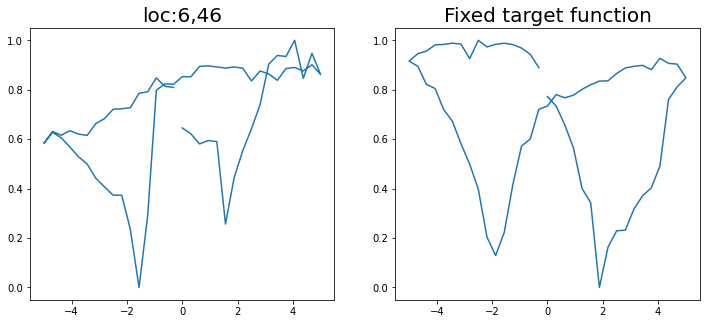

Epoch 1/200 ... Training loss: 2.6186
Epoch 10/200 ... Training loss: 2.3026
Epoch 20/200 ... Training loss: 2.097
Epoch 30/200 ... Training loss: 2.0087
Epoch 40/200 ... Training loss: 1.888
Epoch 50/200 ... Training loss: 1.687
Epoch 60/200 ... Training loss: 1.6433
Epoch 70/200 ... Training loss: 1.5448
Epoch 80/200 ... Training loss: 1.7264
Epoch 90/200 ... Training loss: 1.499
Epoch 100/200 ... Training loss: 1.4016
Epoch 110/200 ... Training loss: 1.4159
Epoch 120/200 ... Training loss: 1.373
Epoch 130/200 ... Training loss: 1.3349
Epoch 140/200 ... Training loss: 1.3567
Epoch 150/200 ... Training loss: 1.21
Epoch 160/200 ... Training loss: 1.1766
Epoch 170/200 ... Training loss: 1.1641
Epoch 180/200 ... Training loss: 1.0742
Epoch 190/200 ... Training loss: 1.0319
Epoch 200/200 ... Training loss: 1.1163
step:  142
Sample #152




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


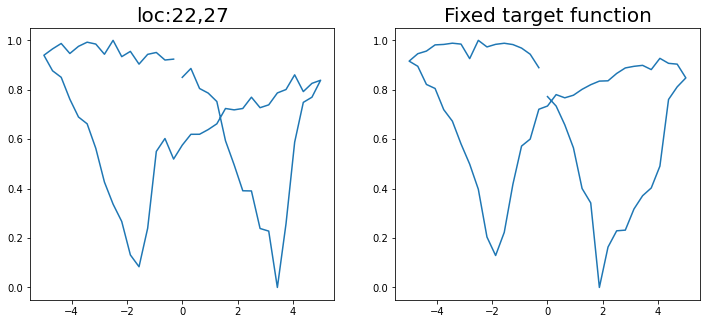

Epoch 1/200 ... Training loss: 2.6265
Epoch 10/200 ... Training loss: 2.4999
Epoch 20/200 ... Training loss: 2.2121
Epoch 30/200 ... Training loss: 2.0772
Epoch 40/200 ... Training loss: 1.9416
Epoch 50/200 ... Training loss: 1.7714
Epoch 60/200 ... Training loss: 1.6332
Epoch 70/200 ... Training loss: 1.6757
Epoch 80/200 ... Training loss: 1.4737
Epoch 90/200 ... Training loss: 1.4258
Epoch 100/200 ... Training loss: 1.4612
Epoch 110/200 ... Training loss: 1.3758
Epoch 120/200 ... Training loss: 1.2818
Epoch 130/200 ... Training loss: 1.2027
Epoch 140/200 ... Training loss: 1.2163
Epoch 150/200 ... Training loss: 1.1544
Epoch 160/200 ... Training loss: 1.123
Epoch 170/200 ... Training loss: 1.1281
Epoch 180/200 ... Training loss: 1.1173
Epoch 190/200 ... Training loss: 1.0642
Epoch 200/200 ... Training loss: 0.9703
step:  143
Sample #153




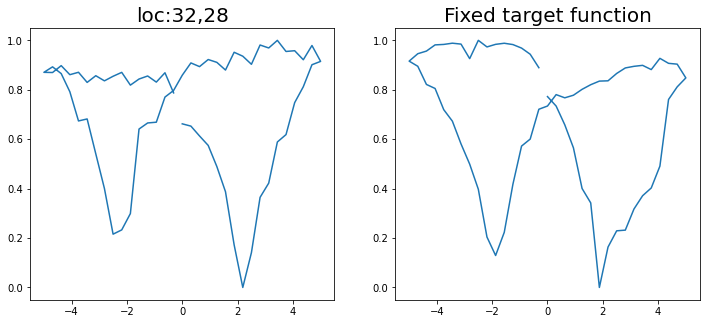

Epoch 1/200 ... Training loss: 2.6315
Epoch 10/200 ... Training loss: 2.4525
Epoch 20/200 ... Training loss: 2.2294
Epoch 30/200 ... Training loss: 2.0828
Epoch 40/200 ... Training loss: 1.9513
Epoch 50/200 ... Training loss: 1.7546
Epoch 60/200 ... Training loss: 1.6311
Epoch 70/200 ... Training loss: 1.7
Epoch 80/200 ... Training loss: 1.4805
Epoch 90/200 ... Training loss: 1.4595
Epoch 100/200 ... Training loss: 1.4962
Epoch 110/200 ... Training loss: 1.3389
Epoch 120/200 ... Training loss: 1.3185
Epoch 130/200 ... Training loss: 1.3165
Epoch 140/200 ... Training loss: 1.1991
Epoch 150/200 ... Training loss: 1.1153
Epoch 160/200 ... Training loss: 1.3373
Epoch 170/200 ... Training loss: 1.1253
Epoch 180/200 ... Training loss: 1.17
Epoch 190/200 ... Training loss: 1.0772
Epoch 200/200 ... Training loss: 1.0111
step:  144
Sample #154




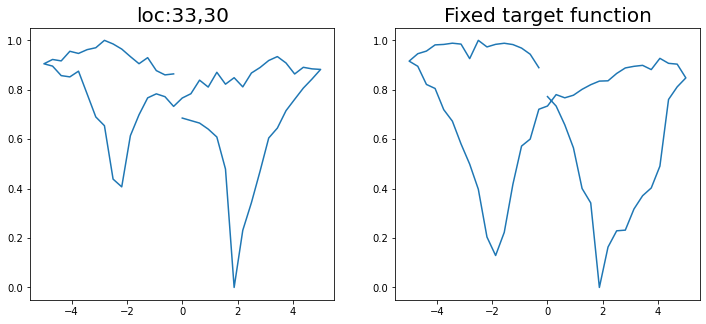

Epoch 1/200 ... Training loss: 2.6278
Epoch 10/200 ... Training loss: 2.4447
Epoch 20/200 ... Training loss: 2.2121
Epoch 30/200 ... Training loss: 2.0665
Epoch 40/200 ... Training loss: 1.8623
Epoch 50/200 ... Training loss: 1.8775
Epoch 60/200 ... Training loss: 1.7063
Epoch 70/200 ... Training loss: 1.6961
Epoch 80/200 ... Training loss: 1.5432
Epoch 90/200 ... Training loss: 1.7571
Epoch 100/200 ... Training loss: 1.5553
Epoch 110/200 ... Training loss: 1.411
Epoch 120/200 ... Training loss: 1.4992
Epoch 130/200 ... Training loss: 1.4164
Epoch 140/200 ... Training loss: 1.3396
Epoch 150/200 ... Training loss: 1.2521
Epoch 160/200 ... Training loss: 1.208
Epoch 170/200 ... Training loss: 1.153
Epoch 180/200 ... Training loss: 1.1692
Epoch 190/200 ... Training loss: 1.1394
Epoch 200/200 ... Training loss: 1.0458
step:  145
Sample #155




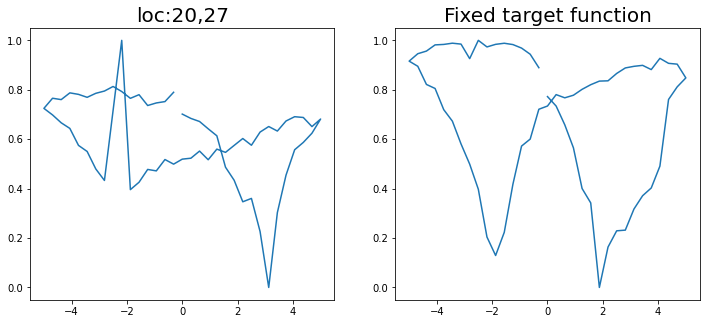

Epoch 1/200 ... Training loss: 2.6165
Epoch 10/200 ... Training loss: 2.4377
Epoch 20/200 ... Training loss: 2.2058
Epoch 30/200 ... Training loss: 2.0558
Epoch 40/200 ... Training loss: 1.8167
Epoch 50/200 ... Training loss: 1.7512
Epoch 60/200 ... Training loss: 1.6068
Epoch 70/200 ... Training loss: 1.5971
Epoch 80/200 ... Training loss: 1.4914
Epoch 90/200 ... Training loss: 1.4893
Epoch 100/200 ... Training loss: 1.4037
Epoch 110/200 ... Training loss: 1.3785
Epoch 120/200 ... Training loss: 1.3099
Epoch 130/200 ... Training loss: 1.2324
Epoch 140/200 ... Training loss: 1.3089
Epoch 150/200 ... Training loss: 1.1729
Epoch 160/200 ... Training loss: 1.1515
Epoch 170/200 ... Training loss: 1.1485
Epoch 180/200 ... Training loss: 1.0793
Epoch 190/200 ... Training loss: 1.2087
Epoch 200/200 ... Training loss: 1.0787
step:  146
Sample #156




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


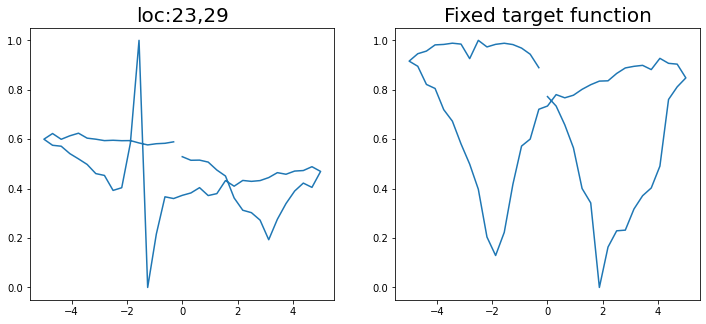

Epoch 1/200 ... Training loss: 2.6051
Epoch 10/200 ... Training loss: 2.4269
Epoch 20/200 ... Training loss: 2.1974
Epoch 30/200 ... Training loss: 2.0528
Epoch 40/200 ... Training loss: 1.8192
Epoch 50/200 ... Training loss: 1.8434
Epoch 60/200 ... Training loss: 1.6429
Epoch 70/200 ... Training loss: 1.5708
Epoch 80/200 ... Training loss: 1.602
Epoch 90/200 ... Training loss: 1.4386
Epoch 100/200 ... Training loss: 1.3315
Epoch 110/200 ... Training loss: 1.3996
Epoch 120/200 ... Training loss: 1.4672
Epoch 130/200 ... Training loss: 1.3063
Epoch 140/200 ... Training loss: 1.2016
Epoch 150/200 ... Training loss: 1.2299
Epoch 160/200 ... Training loss: 1.1579
Epoch 170/200 ... Training loss: 1.1307
Epoch 180/200 ... Training loss: 1.1904
Epoch 190/200 ... Training loss: 1.0165
Epoch 200/200 ... Training loss: 0.9857
step:  147
Sample #157




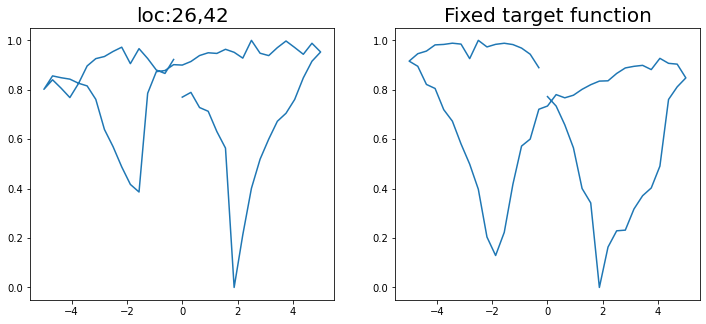

Epoch 1/200 ... Training loss: 2.5957
Epoch 10/200 ... Training loss: 2.3989
Epoch 20/200 ... Training loss: 2.1892
Epoch 30/200 ... Training loss: 2.0379
Epoch 40/200 ... Training loss: 1.8585
Epoch 50/200 ... Training loss: 1.6573
Epoch 60/200 ... Training loss: 1.7303
Epoch 70/200 ... Training loss: 1.5665
Epoch 80/200 ... Training loss: 1.4619
Epoch 90/200 ... Training loss: 1.4086
Epoch 100/200 ... Training loss: 1.3211
Epoch 110/200 ... Training loss: 1.2545
Epoch 120/200 ... Training loss: 1.5123
Epoch 130/200 ... Training loss: 1.2997
Epoch 140/200 ... Training loss: 1.171
Epoch 150/200 ... Training loss: 1.151
Epoch 160/200 ... Training loss: 1.0846
Epoch 170/200 ... Training loss: 1.106
Epoch 180/200 ... Training loss: 1.0683
Epoch 190/200 ... Training loss: 1.202
Epoch 200/200 ... Training loss: 1.0677
step:  148
Sample #158




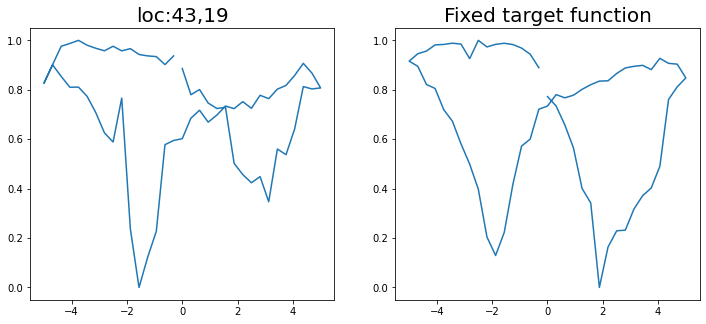

Epoch 1/200 ... Training loss: 2.5951
Epoch 10/200 ... Training loss: 2.4092
Epoch 20/200 ... Training loss: 2.1834
Epoch 30/200 ... Training loss: 2.0385
Epoch 40/200 ... Training loss: 1.8623
Epoch 50/200 ... Training loss: 1.6636
Epoch 60/200 ... Training loss: 1.5912
Epoch 70/200 ... Training loss: 1.5456
Epoch 80/200 ... Training loss: 1.4705
Epoch 90/200 ... Training loss: 1.3613
Epoch 100/200 ... Training loss: 1.6116
Epoch 110/200 ... Training loss: 1.3802
Epoch 120/200 ... Training loss: 1.2386
Epoch 130/200 ... Training loss: 1.2469
Epoch 140/200 ... Training loss: 1.2457
Epoch 150/200 ... Training loss: 1.1385
Epoch 160/200 ... Training loss: 1.0477
Epoch 170/200 ... Training loss: 1.0062
Epoch 180/200 ... Training loss: 0.9672
Epoch 190/200 ... Training loss: 0.9791
Epoch 200/200 ... Training loss: 0.9834
step:  149
Sample #159




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


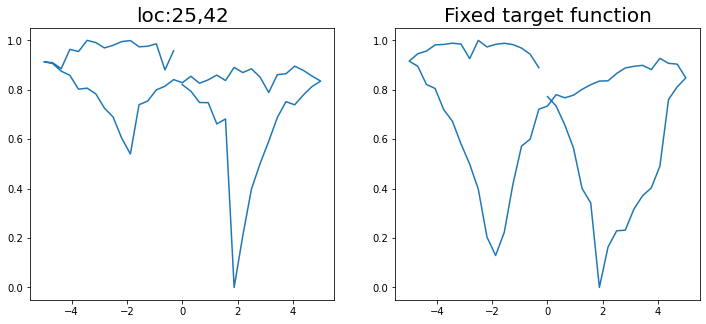

Epoch 1/200 ... Training loss: 2.591
Epoch 10/200 ... Training loss: 2.3689
Epoch 20/200 ... Training loss: 2.1253
Epoch 30/200 ... Training loss: 1.9757
Epoch 40/200 ... Training loss: 1.77
Epoch 50/200 ... Training loss: 1.6176
Epoch 60/200 ... Training loss: 1.6887
Epoch 70/200 ... Training loss: 1.4696
Epoch 80/200 ... Training loss: 1.4064
Epoch 90/200 ... Training loss: 1.6748
Epoch 100/200 ... Training loss: 1.3813
Epoch 110/200 ... Training loss: 1.3323
Epoch 120/200 ... Training loss: 1.2199
Epoch 130/200 ... Training loss: 1.1935
Epoch 140/200 ... Training loss: 1.1308
Epoch 150/200 ... Training loss: 1.0614
Epoch 160/200 ... Training loss: 1.0697
Epoch 170/200 ... Training loss: 1.0328
Epoch 180/200 ... Training loss: 0.9497
Epoch 190/200 ... Training loss: 1.0395
Epoch 200/200 ... Training loss: 0.9766
step:  150
Sample #160




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


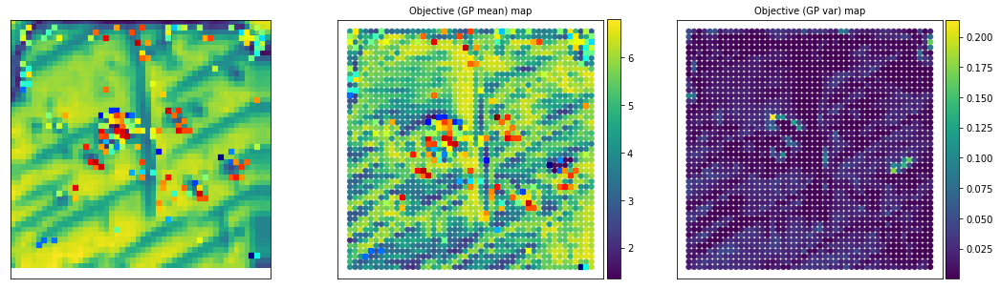

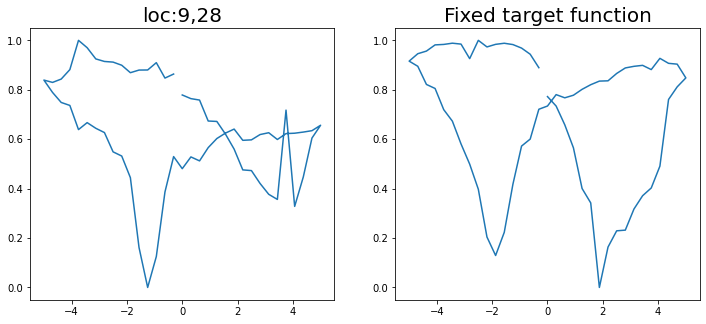

Epoch 1/200 ... Training loss: 2.5797
Epoch 10/200 ... Training loss: 2.2719
Epoch 20/200 ... Training loss: 2.1048
Epoch 30/200 ... Training loss: 2.0127
Epoch 40/200 ... Training loss: 1.836
Epoch 50/200 ... Training loss: 1.6537
Epoch 60/200 ... Training loss: 1.578
Epoch 70/200 ... Training loss: 1.4799
Epoch 80/200 ... Training loss: 1.5272
Epoch 90/200 ... Training loss: 1.3655
Epoch 100/200 ... Training loss: 1.2847
Epoch 110/200 ... Training loss: 1.3246
Epoch 120/200 ... Training loss: 1.2421
Epoch 130/200 ... Training loss: 1.1158
Epoch 140/200 ... Training loss: 1.1054
Epoch 150/200 ... Training loss: 1.3028
Epoch 160/200 ... Training loss: 1.1039
Epoch 170/200 ... Training loss: 1.0131
Epoch 180/200 ... Training loss: 1.1013
Epoch 190/200 ... Training loss: 0.994
Epoch 200/200 ... Training loss: 0.9068
step:  151
Sample #161




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


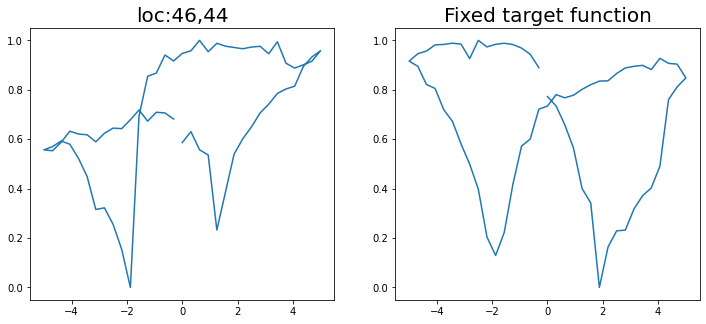

Epoch 1/200 ... Training loss: 2.5687
Epoch 10/200 ... Training loss: 2.2583
Epoch 20/200 ... Training loss: 2.1237
Epoch 30/200 ... Training loss: 1.9987
Epoch 40/200 ... Training loss: 1.8468
Epoch 50/200 ... Training loss: 1.6888
Epoch 60/200 ... Training loss: 1.6036
Epoch 70/200 ... Training loss: 1.619
Epoch 80/200 ... Training loss: 1.4773
Epoch 90/200 ... Training loss: 1.4361
Epoch 100/200 ... Training loss: 1.3906
Epoch 110/200 ... Training loss: 1.3279
Epoch 120/200 ... Training loss: 1.2587
Epoch 130/200 ... Training loss: 1.2501
Epoch 140/200 ... Training loss: 1.2517
Epoch 150/200 ... Training loss: 1.1382
Epoch 160/200 ... Training loss: 1.114
Epoch 170/200 ... Training loss: 1.0682
Epoch 180/200 ... Training loss: 1.0002
Epoch 190/200 ... Training loss: 1.0816
Epoch 200/200 ... Training loss: 0.9954
step:  152
Sample #162




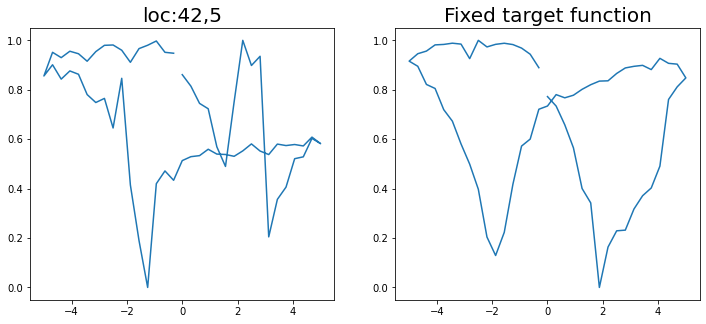

Epoch 1/200 ... Training loss: 2.5659
Epoch 10/200 ... Training loss: 2.2261
Epoch 20/200 ... Training loss: 2.0631
Epoch 30/200 ... Training loss: 1.9534
Epoch 40/200 ... Training loss: 1.7401
Epoch 50/200 ... Training loss: 1.5812
Epoch 60/200 ... Training loss: 1.6692
Epoch 70/200 ... Training loss: 1.456
Epoch 80/200 ... Training loss: 1.3087
Epoch 90/200 ... Training loss: 1.3924
Epoch 100/200 ... Training loss: 1.33
Epoch 110/200 ... Training loss: 1.2012
Epoch 120/200 ... Training loss: 1.1481
Epoch 130/200 ... Training loss: 1.1635
Epoch 140/200 ... Training loss: 1.1183
Epoch 150/200 ... Training loss: 1.0355
Epoch 160/200 ... Training loss: 0.9892
Epoch 170/200 ... Training loss: 0.9706
Epoch 180/200 ... Training loss: 0.9276
Epoch 190/200 ... Training loss: 1.1222
Epoch 200/200 ... Training loss: 1.0471
step:  153
Sample #163




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


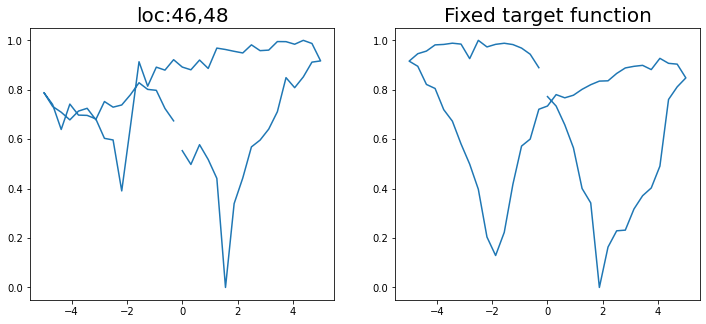

Epoch 1/200 ... Training loss: 2.5552
Epoch 10/200 ... Training loss: 2.2222
Epoch 20/200 ... Training loss: 2.1271
Epoch 30/200 ... Training loss: 2.0009
Epoch 40/200 ... Training loss: 1.8884
Epoch 50/200 ... Training loss: 1.6776
Epoch 60/200 ... Training loss: 1.5614
Epoch 70/200 ... Training loss: 1.4905
Epoch 80/200 ... Training loss: 1.5797
Epoch 90/200 ... Training loss: 1.6055
Epoch 100/200 ... Training loss: 1.4113
Epoch 110/200 ... Training loss: 1.3113
Epoch 120/200 ... Training loss: 1.2369
Epoch 130/200 ... Training loss: 1.1815
Epoch 140/200 ... Training loss: 1.2222
Epoch 150/200 ... Training loss: 1.1488
Epoch 160/200 ... Training loss: 1.1152
Epoch 170/200 ... Training loss: 1.0201
Epoch 180/200 ... Training loss: 0.9895
Epoch 190/200 ... Training loss: 1.2345
Epoch 200/200 ... Training loss: 1.1626
step:  154
Sample #164




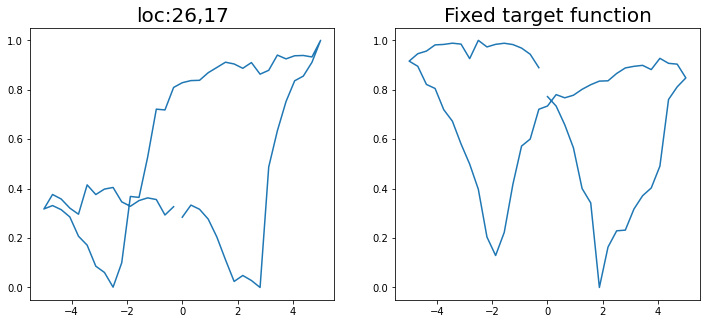

Epoch 1/200 ... Training loss: 2.5443
Epoch 10/200 ... Training loss: 2.2192
Epoch 20/200 ... Training loss: 2.3306
Epoch 30/200 ... Training loss: 1.9639
Epoch 40/200 ... Training loss: 1.7817
Epoch 50/200 ... Training loss: 1.6178
Epoch 60/200 ... Training loss: 1.7113
Epoch 70/200 ... Training loss: 1.5525
Epoch 80/200 ... Training loss: 1.4288
Epoch 90/200 ... Training loss: 1.4187
Epoch 100/200 ... Training loss: 1.5003
Epoch 110/200 ... Training loss: 1.34
Epoch 120/200 ... Training loss: 1.3109
Epoch 130/200 ... Training loss: 1.2247
Epoch 140/200 ... Training loss: 1.2586
Epoch 150/200 ... Training loss: 1.1833
Epoch 160/200 ... Training loss: 1.1301
Epoch 170/200 ... Training loss: 1.0661
Epoch 180/200 ... Training loss: 1.183
Epoch 190/200 ... Training loss: 1.044
Epoch 200/200 ... Training loss: 1.0488
step:  155
Sample #165




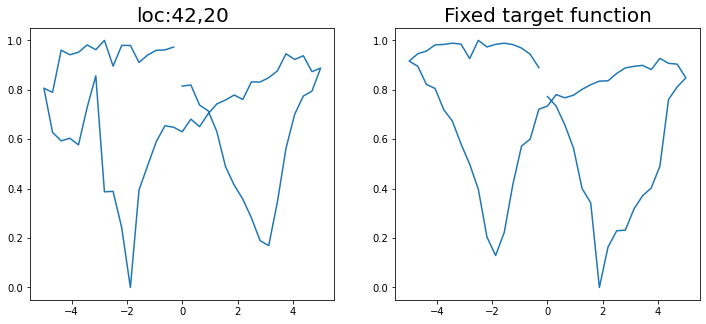

Epoch 1/200 ... Training loss: 2.5344
Epoch 10/200 ... Training loss: 2.3512
Epoch 20/200 ... Training loss: 2.1469
Epoch 30/200 ... Training loss: 2.0076
Epoch 40/200 ... Training loss: 1.8061
Epoch 50/200 ... Training loss: 1.8635
Epoch 60/200 ... Training loss: 1.6807
Epoch 70/200 ... Training loss: 1.6384
Epoch 80/200 ... Training loss: 1.461
Epoch 90/200 ... Training loss: 1.3972
Epoch 100/200 ... Training loss: 1.3852
Epoch 110/200 ... Training loss: 1.4158
Epoch 120/200 ... Training loss: 1.2859
Epoch 130/200 ... Training loss: 1.287
Epoch 140/200 ... Training loss: 1.3329
Epoch 150/200 ... Training loss: 1.1606
Epoch 160/200 ... Training loss: 1.2177
Epoch 170/200 ... Training loss: 1.1087
Epoch 180/200 ... Training loss: 1.1891
Epoch 190/200 ... Training loss: 1.0204
Epoch 200/200 ... Training loss: 0.9744
step:  156
Sample #166




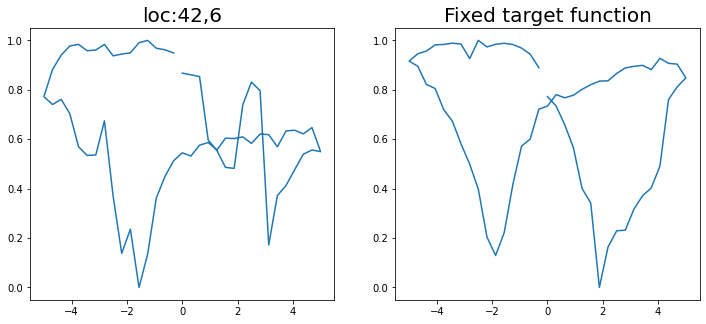

Epoch 1/200 ... Training loss: 2.524
Epoch 10/200 ... Training loss: 2.3045
Epoch 20/200 ... Training loss: 2.0916
Epoch 30/200 ... Training loss: 1.9678
Epoch 40/200 ... Training loss: 1.7484
Epoch 50/200 ... Training loss: 1.6179
Epoch 60/200 ... Training loss: 1.6015
Epoch 70/200 ... Training loss: 1.7625
Epoch 80/200 ... Training loss: 1.5873
Epoch 90/200 ... Training loss: 1.4379
Epoch 100/200 ... Training loss: 1.4023
Epoch 110/200 ... Training loss: 1.4356
Epoch 120/200 ... Training loss: 1.3026
Epoch 130/200 ... Training loss: 1.2523
Epoch 140/200 ... Training loss: 1.4032
Epoch 150/200 ... Training loss: 1.2484
Epoch 160/200 ... Training loss: 1.2309
Epoch 170/200 ... Training loss: 1.1224
Epoch 180/200 ... Training loss: 1.0655
Epoch 190/200 ... Training loss: 1.0066
Epoch 200/200 ... Training loss: 0.9551
step:  157
Sample #167




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


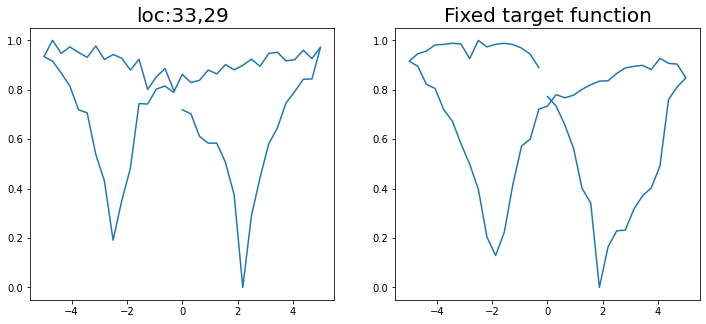

Epoch 1/200 ... Training loss: 2.518
Epoch 10/200 ... Training loss: 2.2333
Epoch 20/200 ... Training loss: 2.0942
Epoch 30/200 ... Training loss: 1.9868
Epoch 40/200 ... Training loss: 1.8707
Epoch 50/200 ... Training loss: 1.6766
Epoch 60/200 ... Training loss: 1.562
Epoch 70/200 ... Training loss: 1.5257
Epoch 80/200 ... Training loss: 1.581
Epoch 90/200 ... Training loss: 1.4323
Epoch 100/200 ... Training loss: 1.4855
Epoch 110/200 ... Training loss: 1.4208
Epoch 120/200 ... Training loss: 1.3586
Epoch 130/200 ... Training loss: 1.3137
Epoch 140/200 ... Training loss: 1.1837
Epoch 150/200 ... Training loss: 1.184
Epoch 160/200 ... Training loss: 1.0953
Epoch 170/200 ... Training loss: 1.1163
Epoch 180/200 ... Training loss: 1.0087
Epoch 190/200 ... Training loss: 1.3042
Epoch 200/200 ... Training loss: 1.1229
step:  158
Sample #168




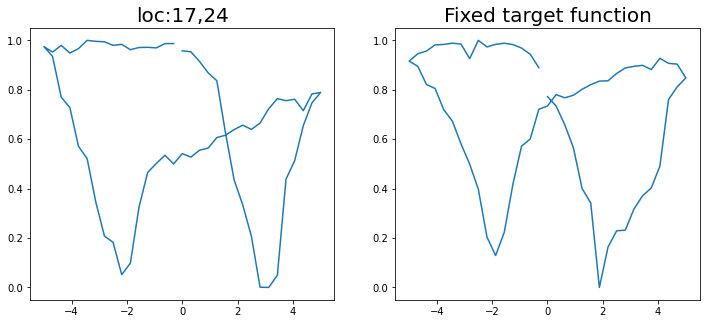

Epoch 1/200 ... Training loss: 2.5145
Epoch 10/200 ... Training loss: 2.2727
Epoch 20/200 ... Training loss: 2.1118
Epoch 30/200 ... Training loss: 1.9541
Epoch 40/200 ... Training loss: 1.729
Epoch 50/200 ... Training loss: 1.6934
Epoch 60/200 ... Training loss: 1.5571
Epoch 70/200 ... Training loss: 1.4415
Epoch 80/200 ... Training loss: 1.4614
Epoch 90/200 ... Training loss: 1.3721
Epoch 100/200 ... Training loss: 1.3732
Epoch 110/200 ... Training loss: 1.2889
Epoch 120/200 ... Training loss: 1.2613
Epoch 130/200 ... Training loss: 1.1909
Epoch 140/200 ... Training loss: 1.1859
Epoch 150/200 ... Training loss: 1.0634
Epoch 160/200 ... Training loss: 1.0941
Epoch 170/200 ... Training loss: 1.0074
Epoch 180/200 ... Training loss: 1.0212
Epoch 190/200 ... Training loss: 0.9165
Epoch 200/200 ... Training loss: 0.9355
step:  159
Sample #169




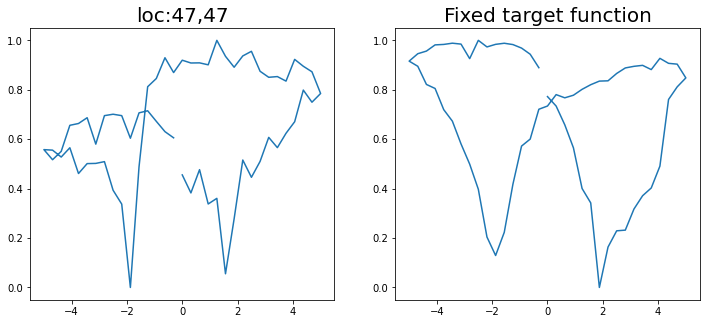

Epoch 1/200 ... Training loss: 2.5046
Epoch 10/200 ... Training loss: 2.298
Epoch 20/200 ... Training loss: 2.0837
Epoch 30/200 ... Training loss: 1.8951
Epoch 40/200 ... Training loss: 1.9217
Epoch 50/200 ... Training loss: 1.7932
Epoch 60/200 ... Training loss: 1.6281
Epoch 70/200 ... Training loss: 1.5988
Epoch 80/200 ... Training loss: 1.4407
Epoch 90/200 ... Training loss: 1.5258
Epoch 100/200 ... Training loss: 1.4523
Epoch 110/200 ... Training loss: 1.4755
Epoch 120/200 ... Training loss: 1.3339
Epoch 130/200 ... Training loss: 1.2627
Epoch 140/200 ... Training loss: 1.1526
Epoch 150/200 ... Training loss: 1.2413
Epoch 160/200 ... Training loss: 1.1371
Epoch 170/200 ... Training loss: 1.0728
Epoch 180/200 ... Training loss: 1.0773
Epoch 190/200 ... Training loss: 0.9974
Epoch 200/200 ... Training loss: 0.9508
step:  160
Sample #170




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


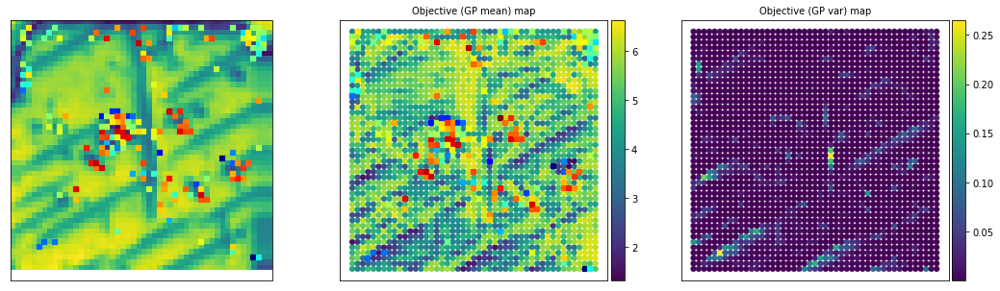

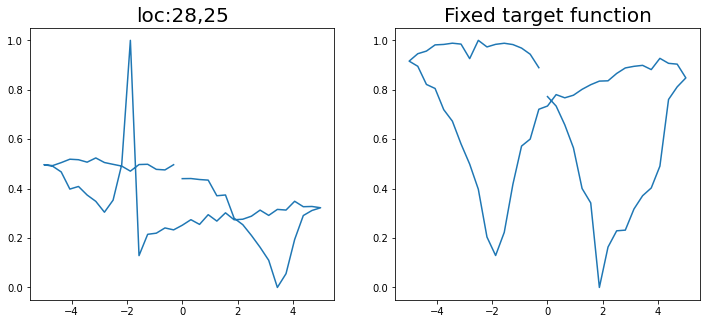

Epoch 1/200 ... Training loss: 2.5117
Epoch 10/200 ... Training loss: 2.2978
Epoch 20/200 ... Training loss: 2.1443
Epoch 30/200 ... Training loss: 2.0124
Epoch 40/200 ... Training loss: 1.7783
Epoch 50/200 ... Training loss: 1.8397
Epoch 60/200 ... Training loss: 1.6597
Epoch 70/200 ... Training loss: 1.5607
Epoch 80/200 ... Training loss: 1.4551
Epoch 90/200 ... Training loss: 1.4674
Epoch 100/200 ... Training loss: 1.3618
Epoch 110/200 ... Training loss: 1.4651
Epoch 120/200 ... Training loss: 1.2936
Epoch 130/200 ... Training loss: 1.3902
Epoch 140/200 ... Training loss: 1.2137
Epoch 150/200 ... Training loss: 1.1464
Epoch 160/200 ... Training loss: 1.1012
Epoch 170/200 ... Training loss: 1.0549
Epoch 180/200 ... Training loss: 1.0974
Epoch 190/200 ... Training loss: 0.9745
Epoch 200/200 ... Training loss: 1.1515
step:  161
Sample #171




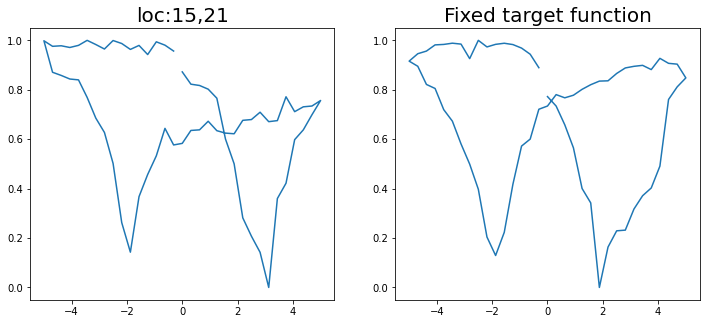

Epoch 1/200 ... Training loss: 2.5099
Epoch 10/200 ... Training loss: 2.1933
Epoch 20/200 ... Training loss: 2.4033
Epoch 30/200 ... Training loss: 1.924
Epoch 40/200 ... Training loss: 1.7134
Epoch 50/200 ... Training loss: 1.5881
Epoch 60/200 ... Training loss: 1.7479
Epoch 70/200 ... Training loss: 1.5591
Epoch 80/200 ... Training loss: 1.4485
Epoch 90/200 ... Training loss: 1.3627
Epoch 100/200 ... Training loss: 1.4348
Epoch 110/200 ... Training loss: 1.3275
Epoch 120/200 ... Training loss: 1.2267
Epoch 130/200 ... Training loss: 1.1548
Epoch 140/200 ... Training loss: 1.1995
Epoch 150/200 ... Training loss: 1.112
Epoch 160/200 ... Training loss: 1.0532
Epoch 170/200 ... Training loss: 0.9988
Epoch 180/200 ... Training loss: 1.2927
Epoch 190/200 ... Training loss: 1.1096
Epoch 200/200 ... Training loss: 1.0033
step:  162
Sample #172




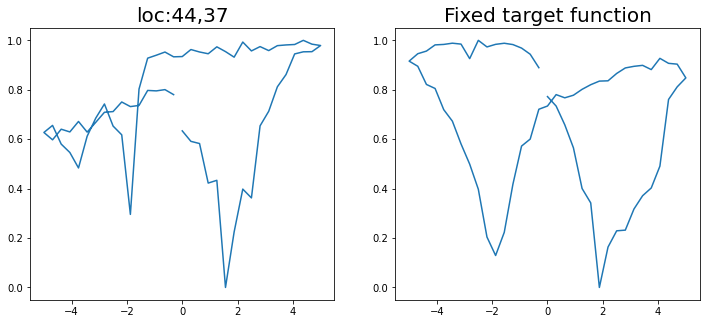

Epoch 1/200 ... Training loss: 2.5067
Epoch 10/200 ... Training loss: 2.2761
Epoch 20/200 ... Training loss: 2.1284
Epoch 30/200 ... Training loss: 1.954
Epoch 40/200 ... Training loss: 1.7635
Epoch 50/200 ... Training loss: 1.7595
Epoch 60/200 ... Training loss: 1.6312
Epoch 70/200 ... Training loss: 1.5334
Epoch 80/200 ... Training loss: 1.4275
Epoch 90/200 ... Training loss: 1.4841
Epoch 100/200 ... Training loss: 1.3273
Epoch 110/200 ... Training loss: 1.3161
Epoch 120/200 ... Training loss: 1.2482
Epoch 130/200 ... Training loss: 1.2195
Epoch 140/200 ... Training loss: 1.2173
Epoch 150/200 ... Training loss: 1.1036
Epoch 160/200 ... Training loss: 1.2867
Epoch 170/200 ... Training loss: 1.1805
Epoch 180/200 ... Training loss: 1.1563
Epoch 190/200 ... Training loss: 1.0266
Epoch 200/200 ... Training loss: 0.9514
step:  163
Sample #173




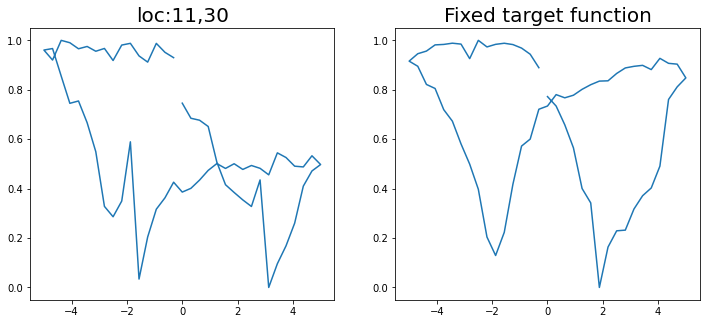

Epoch 1/200 ... Training loss: 2.4969
Epoch 10/200 ... Training loss: 2.249
Epoch 20/200 ... Training loss: 2.0921
Epoch 30/200 ... Training loss: 1.8736
Epoch 40/200 ... Training loss: 1.8715
Epoch 50/200 ... Training loss: 1.6582
Epoch 60/200 ... Training loss: 1.5438
Epoch 70/200 ... Training loss: 1.4737
Epoch 80/200 ... Training loss: 1.398
Epoch 90/200 ... Training loss: 1.3997
Epoch 100/200 ... Training loss: 1.3024
Epoch 110/200 ... Training loss: 1.3243
Epoch 120/200 ... Training loss: 1.2105
Epoch 130/200 ... Training loss: 1.2566
Epoch 140/200 ... Training loss: 1.1842
Epoch 150/200 ... Training loss: 1.2267
Epoch 160/200 ... Training loss: 1.089
Epoch 170/200 ... Training loss: 1.0537
Epoch 180/200 ... Training loss: 1.1455
Epoch 190/200 ... Training loss: 1.0055
Epoch 200/200 ... Training loss: 1.0134
step:  164
Sample #174




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


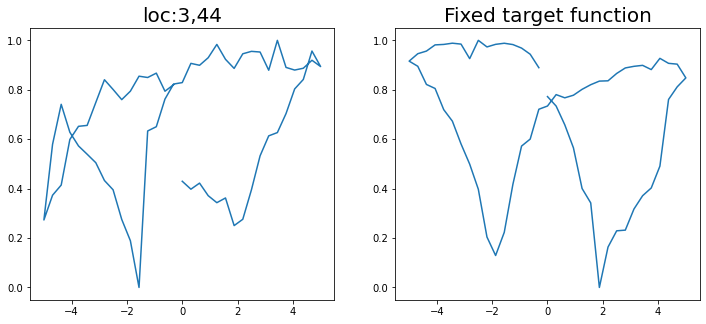

Epoch 1/200 ... Training loss: 2.4899
Epoch 10/200 ... Training loss: 2.2606
Epoch 20/200 ... Training loss: 2.1158
Epoch 30/200 ... Training loss: 1.9949
Epoch 40/200 ... Training loss: 1.8156
Epoch 50/200 ... Training loss: 1.7218
Epoch 60/200 ... Training loss: 1.6223
Epoch 70/200 ... Training loss: 1.5332
Epoch 80/200 ... Training loss: 1.464
Epoch 90/200 ... Training loss: 1.5107
Epoch 100/200 ... Training loss: 1.395
Epoch 110/200 ... Training loss: 1.5873
Epoch 120/200 ... Training loss: 1.3624
Epoch 130/200 ... Training loss: 1.3114
Epoch 140/200 ... Training loss: 1.3371
Epoch 150/200 ... Training loss: 1.2766
Epoch 160/200 ... Training loss: 1.1519
Epoch 170/200 ... Training loss: 1.2472
Epoch 180/200 ... Training loss: 1.1528
Epoch 190/200 ... Training loss: 1.0849
Epoch 200/200 ... Training loss: 1.0835
step:  165
Sample #175




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


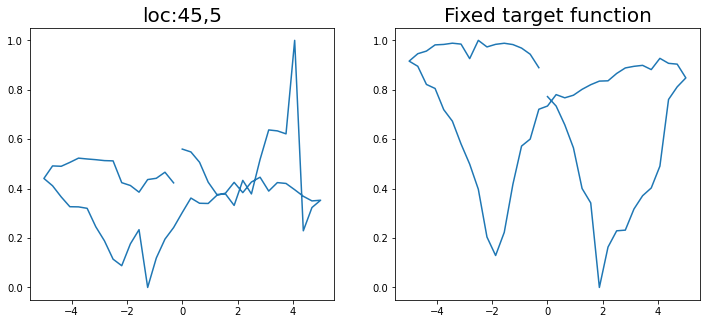

Epoch 1/200 ... Training loss: 2.4884
Epoch 10/200 ... Training loss: 2.3322
Epoch 20/200 ... Training loss: 2.1346
Epoch 30/200 ... Training loss: 1.9953
Epoch 40/200 ... Training loss: 1.8358
Epoch 50/200 ... Training loss: 1.6577
Epoch 60/200 ... Training loss: 1.7937
Epoch 70/200 ... Training loss: 1.6006
Epoch 80/200 ... Training loss: 1.5034
Epoch 90/200 ... Training loss: 1.425
Epoch 100/200 ... Training loss: 1.488
Epoch 110/200 ... Training loss: 1.3387
Epoch 120/200 ... Training loss: 1.3446
Epoch 130/200 ... Training loss: 1.2997
Epoch 140/200 ... Training loss: 1.2231
Epoch 150/200 ... Training loss: 1.2284
Epoch 160/200 ... Training loss: 1.1962
Epoch 170/200 ... Training loss: 1.1059
Epoch 180/200 ... Training loss: 1.2662
Epoch 190/200 ... Training loss: 1.0819
Epoch 200/200 ... Training loss: 1.0566
step:  166
Sample #176




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


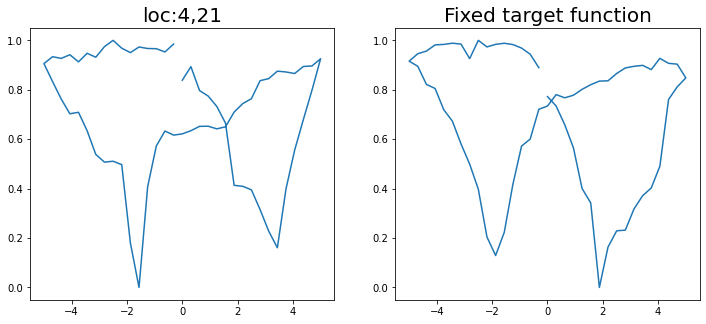

Epoch 1/200 ... Training loss: 2.4886
Epoch 10/200 ... Training loss: 2.1875
Epoch 20/200 ... Training loss: 2.0827
Epoch 30/200 ... Training loss: 1.9073
Epoch 40/200 ... Training loss: 1.8331
Epoch 50/200 ... Training loss: 1.6818
Epoch 60/200 ... Training loss: 1.6472
Epoch 70/200 ... Training loss: 1.5183
Epoch 80/200 ... Training loss: 1.5589
Epoch 90/200 ... Training loss: 1.4187
Epoch 100/200 ... Training loss: 1.4769
Epoch 110/200 ... Training loss: 1.4043
Epoch 120/200 ... Training loss: 1.3556
Epoch 130/200 ... Training loss: 1.3617
Epoch 140/200 ... Training loss: 1.2536
Epoch 150/200 ... Training loss: 1.302
Epoch 160/200 ... Training loss: 1.317
Epoch 170/200 ... Training loss: 1.1748
Epoch 180/200 ... Training loss: 1.2639
Epoch 190/200 ... Training loss: 1.0944
Epoch 200/200 ... Training loss: 1.2114
step:  167
Sample #177




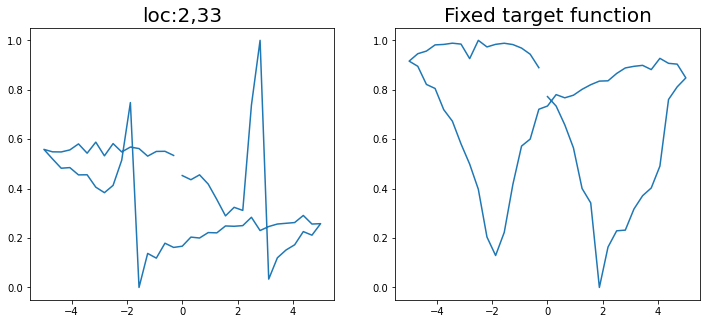

Epoch 1/200 ... Training loss: 2.5037
Epoch 10/200 ... Training loss: 2.2189
Epoch 20/200 ... Training loss: 2.0684
Epoch 30/200 ... Training loss: 1.9478
Epoch 40/200 ... Training loss: 1.7437
Epoch 50/200 ... Training loss: 1.622
Epoch 60/200 ... Training loss: 1.5463
Epoch 70/200 ... Training loss: 1.5468
Epoch 80/200 ... Training loss: 1.4103
Epoch 90/200 ... Training loss: 1.6019
Epoch 100/200 ... Training loss: 1.4176
Epoch 110/200 ... Training loss: 1.3957
Epoch 120/200 ... Training loss: 1.2977
Epoch 130/200 ... Training loss: 1.4113
Epoch 140/200 ... Training loss: 1.3582
Epoch 150/200 ... Training loss: 1.2237
Epoch 160/200 ... Training loss: 1.2562
Epoch 170/200 ... Training loss: 1.2133
Epoch 180/200 ... Training loss: 1.1302
Epoch 190/200 ... Training loss: 1.215
Epoch 200/200 ... Training loss: 1.1407
step:  168
Sample #178




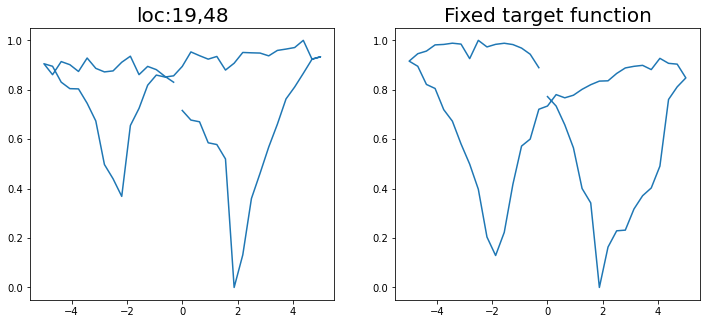

Epoch 1/200 ... Training loss: 2.5016
Epoch 10/200 ... Training loss: 2.3611
Epoch 20/200 ... Training loss: 2.1663
Epoch 30/200 ... Training loss: 2.0221
Epoch 40/200 ... Training loss: 1.8868
Epoch 50/200 ... Training loss: 1.7783
Epoch 60/200 ... Training loss: 1.6755
Epoch 70/200 ... Training loss: 1.5753
Epoch 80/200 ... Training loss: 1.5995
Epoch 90/200 ... Training loss: 1.5718
Epoch 100/200 ... Training loss: 1.4492
Epoch 110/200 ... Training loss: 1.3721
Epoch 120/200 ... Training loss: 1.3909
Epoch 130/200 ... Training loss: 1.3209
Epoch 140/200 ... Training loss: 1.3252
Epoch 150/200 ... Training loss: 1.2305
Epoch 160/200 ... Training loss: 1.2379
Epoch 170/200 ... Training loss: 1.1595
Epoch 180/200 ... Training loss: 1.177
Epoch 190/200 ... Training loss: 1.1328
Epoch 200/200 ... Training loss: 1.0994
step:  169
Sample #179




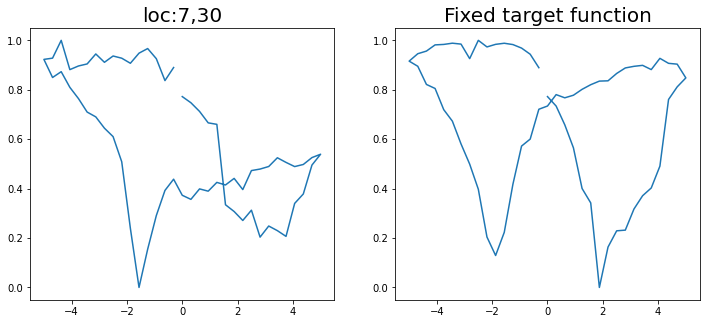

Epoch 1/200 ... Training loss: 2.4942
Epoch 10/200 ... Training loss: 2.3564
Epoch 20/200 ... Training loss: 2.1712
Epoch 30/200 ... Training loss: 2.0273
Epoch 40/200 ... Training loss: 1.9032
Epoch 50/200 ... Training loss: 1.7442
Epoch 60/200 ... Training loss: 1.6425
Epoch 70/200 ... Training loss: 1.57
Epoch 80/200 ... Training loss: 1.4914
Epoch 90/200 ... Training loss: 1.6601
Epoch 100/200 ... Training loss: 1.4846
Epoch 110/200 ... Training loss: 1.4523
Epoch 120/200 ... Training loss: 1.4557
Epoch 130/200 ... Training loss: 1.4991
Epoch 140/200 ... Training loss: 1.3776
Epoch 150/200 ... Training loss: 1.2758
Epoch 160/200 ... Training loss: 1.4633
Epoch 170/200 ... Training loss: 1.2842
Epoch 180/200 ... Training loss: 1.2207
Epoch 190/200 ... Training loss: 1.2807
Epoch 200/200 ... Training loss: 1.2277
step:  170
Sample #180




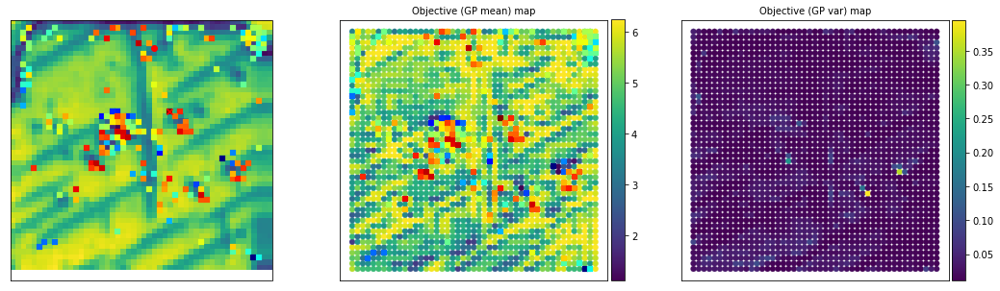

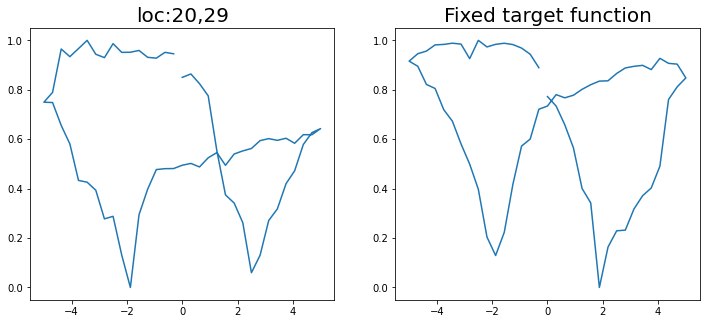

Epoch 1/200 ... Training loss: 2.5099
Epoch 10/200 ... Training loss: 2.2563
Epoch 20/200 ... Training loss: 2.2359
Epoch 30/200 ... Training loss: 2.0865
Epoch 40/200 ... Training loss: 1.9148
Epoch 50/200 ... Training loss: 1.7704
Epoch 60/200 ... Training loss: 1.7262
Epoch 70/200 ... Training loss: 1.6216
Epoch 80/200 ... Training loss: 1.5541
Epoch 90/200 ... Training loss: 1.6408
Epoch 100/200 ... Training loss: 1.4975
Epoch 110/200 ... Training loss: 1.4924
Epoch 120/200 ... Training loss: 1.3947
Epoch 130/200 ... Training loss: 1.3347
Epoch 140/200 ... Training loss: 1.3398
Epoch 150/200 ... Training loss: 1.2752
Epoch 160/200 ... Training loss: 1.2883
Epoch 170/200 ... Training loss: 1.2937
Epoch 180/200 ... Training loss: 1.2339
Epoch 190/200 ... Training loss: 1.3238
Epoch 200/200 ... Training loss: 1.2322
step:  171
Sample #181




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


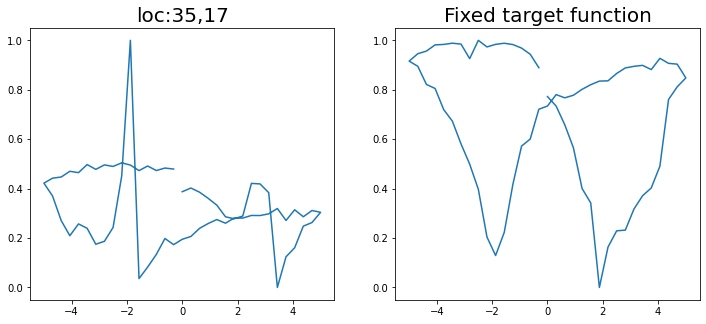

Epoch 1/200 ... Training loss: 2.5243
Epoch 10/200 ... Training loss: 2.3856
Epoch 20/200 ... Training loss: 2.2001
Epoch 30/200 ... Training loss: 2.0615
Epoch 40/200 ... Training loss: 1.9464
Epoch 50/200 ... Training loss: 1.7459
Epoch 60/200 ... Training loss: 1.6585
Epoch 70/200 ... Training loss: 1.6477
Epoch 80/200 ... Training loss: 1.5366
Epoch 90/200 ... Training loss: 1.5761
Epoch 100/200 ... Training loss: 1.4109
Epoch 110/200 ... Training loss: 1.4604
Epoch 120/200 ... Training loss: 1.3552
Epoch 130/200 ... Training loss: 1.3044
Epoch 140/200 ... Training loss: 1.2646
Epoch 150/200 ... Training loss: 1.2408
Epoch 160/200 ... Training loss: 1.2463
Epoch 170/200 ... Training loss: 1.2003
Epoch 180/200 ... Training loss: 1.1558
Epoch 190/200 ... Training loss: 1.2165
Epoch 200/200 ... Training loss: 1.1157
step:  172
Sample #182




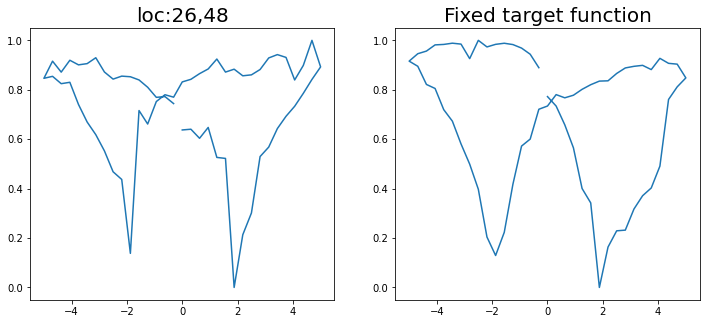

Epoch 1/200 ... Training loss: 2.5225
Epoch 10/200 ... Training loss: 2.4017
Epoch 20/200 ... Training loss: 2.3368
Epoch 30/200 ... Training loss: 2.1853
Epoch 40/200 ... Training loss: 2.0774
Epoch 50/200 ... Training loss: 1.9814
Epoch 60/200 ... Training loss: 1.8937
Epoch 70/200 ... Training loss: 1.7291
Epoch 80/200 ... Training loss: 1.6526
Epoch 90/200 ... Training loss: 1.5766
Epoch 100/200 ... Training loss: 1.6341
Epoch 110/200 ... Training loss: 1.4724
Epoch 120/200 ... Training loss: 1.515
Epoch 130/200 ... Training loss: 1.3688
Epoch 140/200 ... Training loss: 1.4825
Epoch 150/200 ... Training loss: 1.3251
Epoch 160/200 ... Training loss: 1.2839
Epoch 170/200 ... Training loss: 1.2351
Epoch 180/200 ... Training loss: 1.5195
Epoch 190/200 ... Training loss: 1.328
Epoch 200/200 ... Training loss: 1.2513
step:  173
Sample #183




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


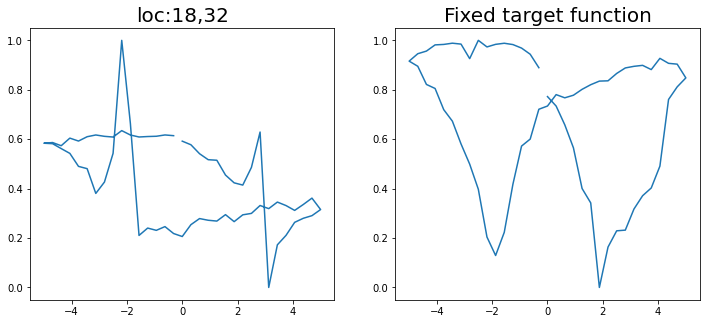

Epoch 1/200 ... Training loss: 2.5304
Epoch 10/200 ... Training loss: 2.2825
Epoch 20/200 ... Training loss: 2.1173
Epoch 30/200 ... Training loss: 2.0076
Epoch 40/200 ... Training loss: 1.7703
Epoch 50/200 ... Training loss: 1.6611
Epoch 60/200 ... Training loss: 1.6087
Epoch 70/200 ... Training loss: 1.472
Epoch 80/200 ... Training loss: 1.6492
Epoch 90/200 ... Training loss: 1.4963
Epoch 100/200 ... Training loss: 1.3231
Epoch 110/200 ... Training loss: 1.3857
Epoch 120/200 ... Training loss: 1.3147
Epoch 130/200 ... Training loss: 1.2599
Epoch 140/200 ... Training loss: 1.3382
Epoch 150/200 ... Training loss: 1.2572
Epoch 160/200 ... Training loss: 1.179
Epoch 170/200 ... Training loss: 1.1244
Epoch 180/200 ... Training loss: 1.3385
Epoch 190/200 ... Training loss: 1.1203
Epoch 200/200 ... Training loss: 1.2149
step:  174
Sample #184




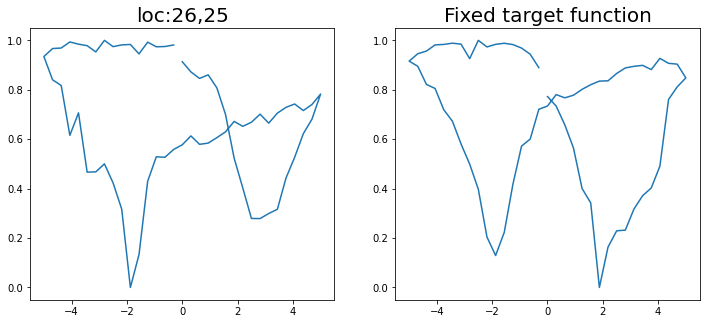

Epoch 1/200 ... Training loss: 2.5372
Epoch 10/200 ... Training loss: 2.3074
Epoch 20/200 ... Training loss: 2.0573
Epoch 30/200 ... Training loss: 1.9273
Epoch 40/200 ... Training loss: 1.7769
Epoch 50/200 ... Training loss: 1.7243
Epoch 60/200 ... Training loss: 1.6001
Epoch 70/200 ... Training loss: 1.5193
Epoch 80/200 ... Training loss: 1.6777
Epoch 90/200 ... Training loss: 1.4316
Epoch 100/200 ... Training loss: 1.4024
Epoch 110/200 ... Training loss: 1.4518
Epoch 120/200 ... Training loss: 1.4152
Epoch 130/200 ... Training loss: 1.2516
Epoch 140/200 ... Training loss: 1.2571
Epoch 150/200 ... Training loss: 1.2651
Epoch 160/200 ... Training loss: 1.2642
Epoch 170/200 ... Training loss: 1.1637
Epoch 180/200 ... Training loss: 1.1748
Epoch 190/200 ... Training loss: 1.1092
Epoch 200/200 ... Training loss: 1.2431
step:  175
Sample #185




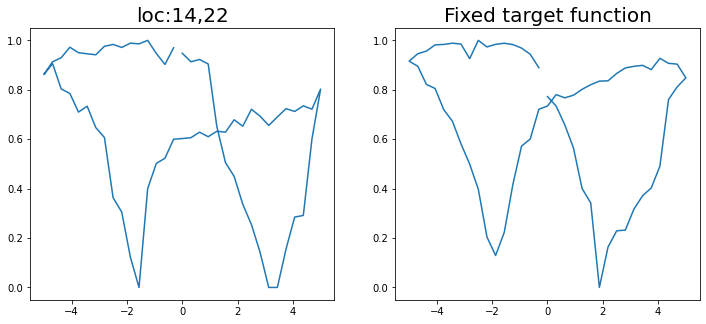

Epoch 1/200 ... Training loss: 2.5352
Epoch 10/200 ... Training loss: 2.2847
Epoch 20/200 ... Training loss: 2.0861
Epoch 30/200 ... Training loss: 1.9514
Epoch 40/200 ... Training loss: 1.8021
Epoch 50/200 ... Training loss: 1.6795
Epoch 60/200 ... Training loss: 1.6568
Epoch 70/200 ... Training loss: 1.535
Epoch 80/200 ... Training loss: 1.5082
Epoch 90/200 ... Training loss: 1.4101
Epoch 100/200 ... Training loss: 1.5588
Epoch 110/200 ... Training loss: 1.3374
Epoch 120/200 ... Training loss: 1.3593
Epoch 130/200 ... Training loss: 1.309
Epoch 140/200 ... Training loss: 1.2708
Epoch 150/200 ... Training loss: 1.3286
Epoch 160/200 ... Training loss: 1.2023
Epoch 170/200 ... Training loss: 1.1239
Epoch 180/200 ... Training loss: 1.1922
Epoch 190/200 ... Training loss: 1.0825
Epoch 200/200 ... Training loss: 1.1614
step:  176
Sample #186




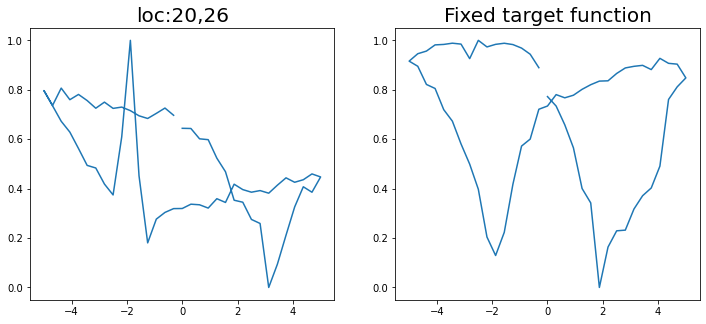

Epoch 1/200 ... Training loss: 2.5329
Epoch 10/200 ... Training loss: 2.3048
Epoch 20/200 ... Training loss: 2.1399
Epoch 30/200 ... Training loss: 1.9501
Epoch 40/200 ... Training loss: 1.815
Epoch 50/200 ... Training loss: 1.6856
Epoch 60/200 ... Training loss: 1.6701
Epoch 70/200 ... Training loss: 1.5901
Epoch 80/200 ... Training loss: 1.6398
Epoch 90/200 ... Training loss: 1.4931
Epoch 100/200 ... Training loss: 1.532
Epoch 110/200 ... Training loss: 1.4174
Epoch 120/200 ... Training loss: 1.3338
Epoch 130/200 ... Training loss: 1.3821
Epoch 140/200 ... Training loss: 1.4116
Epoch 150/200 ... Training loss: 1.2858
Epoch 160/200 ... Training loss: 1.2677
Epoch 170/200 ... Training loss: 1.4233
Epoch 180/200 ... Training loss: 1.2463
Epoch 190/200 ... Training loss: 1.1454
Epoch 200/200 ... Training loss: 1.2881
step:  177
Sample #187




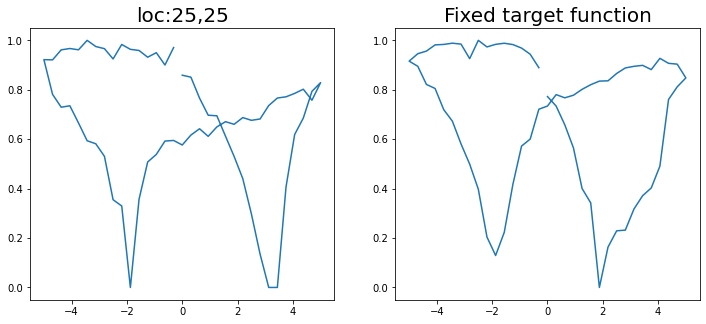

Epoch 1/200 ... Training loss: 2.5306
Epoch 10/200 ... Training loss: 2.2843
Epoch 20/200 ... Training loss: 2.1511
Epoch 30/200 ... Training loss: 2.0323
Epoch 40/200 ... Training loss: 1.8556
Epoch 50/200 ... Training loss: 1.6704
Epoch 60/200 ... Training loss: 1.6214
Epoch 70/200 ... Training loss: 1.5276
Epoch 80/200 ... Training loss: 1.5339
Epoch 90/200 ... Training loss: 1.485
Epoch 100/200 ... Training loss: 1.4718
Epoch 110/200 ... Training loss: 1.4113
Epoch 120/200 ... Training loss: 1.3492
Epoch 130/200 ... Training loss: 1.3104
Epoch 140/200 ... Training loss: 1.2331
Epoch 150/200 ... Training loss: 1.2412
Epoch 160/200 ... Training loss: 1.1525
Epoch 170/200 ... Training loss: 1.1342
Epoch 180/200 ... Training loss: 1.1209
Epoch 190/200 ... Training loss: 1.031
Epoch 200/200 ... Training loss: 1.0217
step:  178
Sample #188




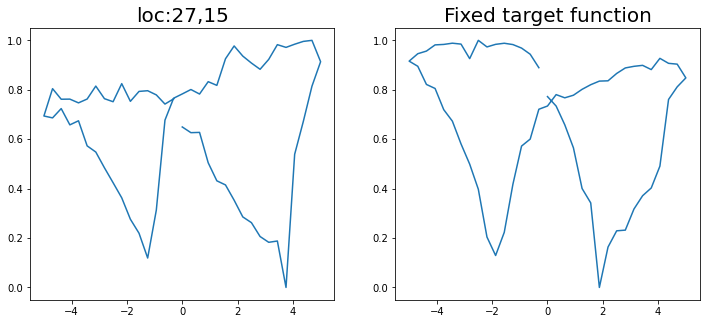

Epoch 1/200 ... Training loss: 2.5281
Epoch 10/200 ... Training loss: 2.293
Epoch 20/200 ... Training loss: 2.0385
Epoch 30/200 ... Training loss: 1.9073
Epoch 40/200 ... Training loss: 1.7322
Epoch 50/200 ... Training loss: 1.6975
Epoch 60/200 ... Training loss: 1.5639
Epoch 70/200 ... Training loss: 1.518
Epoch 80/200 ... Training loss: 1.4873
Epoch 90/200 ... Training loss: 1.3903
Epoch 100/200 ... Training loss: 1.4061
Epoch 110/200 ... Training loss: 1.3714
Epoch 120/200 ... Training loss: 1.2979
Epoch 130/200 ... Training loss: 1.2926
Epoch 140/200 ... Training loss: 1.2438
Epoch 150/200 ... Training loss: 1.2468
Epoch 160/200 ... Training loss: 1.2437
Epoch 170/200 ... Training loss: 1.1479
Epoch 180/200 ... Training loss: 1.106
Epoch 190/200 ... Training loss: 1.058
Epoch 200/200 ... Training loss: 1.1065
step:  179
Sample #189




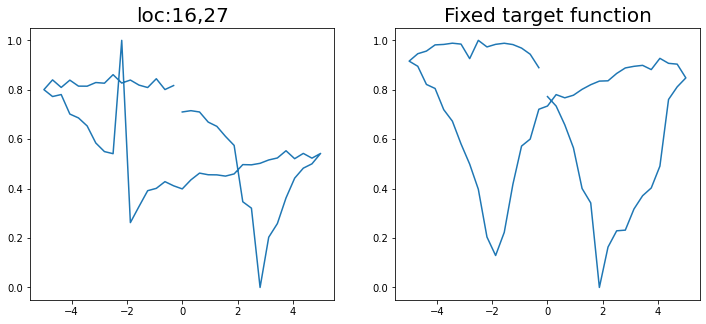

Epoch 1/200 ... Training loss: 2.5187
Epoch 10/200 ... Training loss: 2.2704
Epoch 20/200 ... Training loss: 2.1781
Epoch 30/200 ... Training loss: 1.9826
Epoch 40/200 ... Training loss: 1.871
Epoch 50/200 ... Training loss: 1.729
Epoch 60/200 ... Training loss: 1.6973
Epoch 70/200 ... Training loss: 1.6581
Epoch 80/200 ... Training loss: 1.5757
Epoch 90/200 ... Training loss: 1.5313
Epoch 100/200 ... Training loss: 1.4309
Epoch 110/200 ... Training loss: 1.5079
Epoch 120/200 ... Training loss: 1.4251
Epoch 130/200 ... Training loss: 1.407
Epoch 140/200 ... Training loss: 1.4652
Epoch 150/200 ... Training loss: 1.406
Epoch 160/200 ... Training loss: 1.2802
Epoch 170/200 ... Training loss: 1.248
Epoch 180/200 ... Training loss: 1.334
Epoch 190/200 ... Training loss: 1.2051
Epoch 200/200 ... Training loss: 1.1397
step:  180
Sample #190




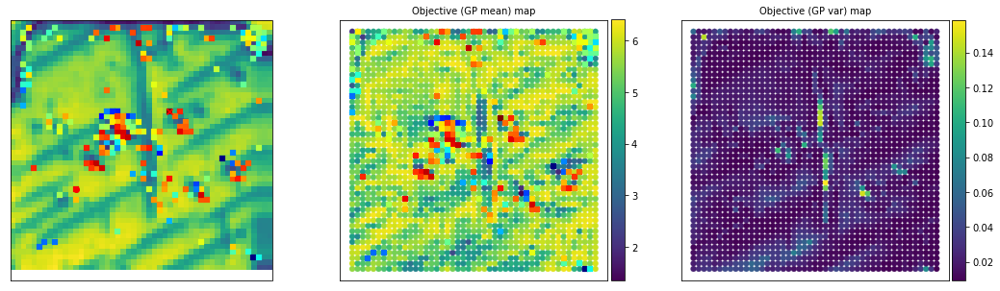

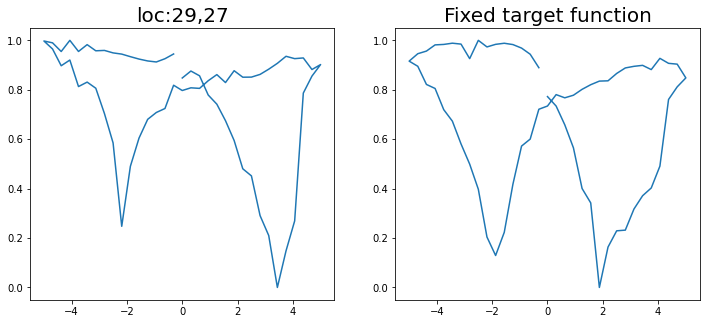

Epoch 1/200 ... Training loss: 2.5136
Epoch 10/200 ... Training loss: 2.2966
Epoch 20/200 ... Training loss: 2.1459
Epoch 30/200 ... Training loss: 1.9476
Epoch 40/200 ... Training loss: 1.8463
Epoch 50/200 ... Training loss: 1.7316
Epoch 60/200 ... Training loss: 1.7568
Epoch 70/200 ... Training loss: 1.6423
Epoch 80/200 ... Training loss: 1.5563
Epoch 90/200 ... Training loss: 1.4778
Epoch 100/200 ... Training loss: 1.4518
Epoch 110/200 ... Training loss: 1.4293
Epoch 120/200 ... Training loss: 1.3436
Epoch 130/200 ... Training loss: 1.3779
Epoch 140/200 ... Training loss: 1.3649
Epoch 150/200 ... Training loss: 1.2349
Epoch 160/200 ... Training loss: 1.2088
Epoch 170/200 ... Training loss: 1.188
Epoch 180/200 ... Training loss: 1.1848
Epoch 190/200 ... Training loss: 1.1987
Epoch 200/200 ... Training loss: 1.1533
step:  181
Sample #191




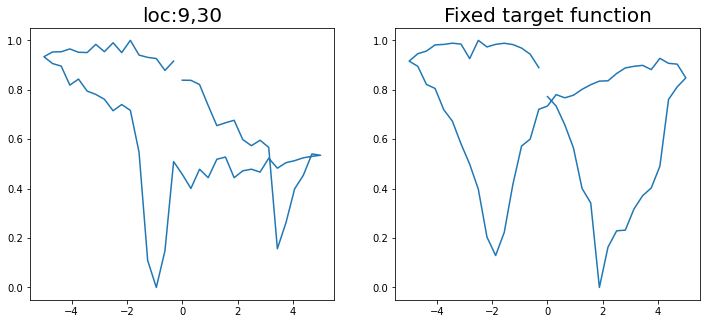

Epoch 1/200 ... Training loss: 2.5074
Epoch 10/200 ... Training loss: 2.2892
Epoch 20/200 ... Training loss: 2.1978
Epoch 30/200 ... Training loss: 2.0421
Epoch 40/200 ... Training loss: 1.8788
Epoch 50/200 ... Training loss: 1.7432
Epoch 60/200 ... Training loss: 1.7707
Epoch 70/200 ... Training loss: 1.6246
Epoch 80/200 ... Training loss: 1.561
Epoch 90/200 ... Training loss: 1.5076
Epoch 100/200 ... Training loss: 1.4761
Epoch 110/200 ... Training loss: 1.5401
Epoch 120/200 ... Training loss: 1.4417
Epoch 130/200 ... Training loss: 1.3391
Epoch 140/200 ... Training loss: 1.4556
Epoch 150/200 ... Training loss: 1.3945
Epoch 160/200 ... Training loss: 1.2521
Epoch 170/200 ... Training loss: 1.2537
Epoch 180/200 ... Training loss: 1.3576
Epoch 190/200 ... Training loss: 1.2093
Epoch 200/200 ... Training loss: 1.1226
step:  182
Sample #192




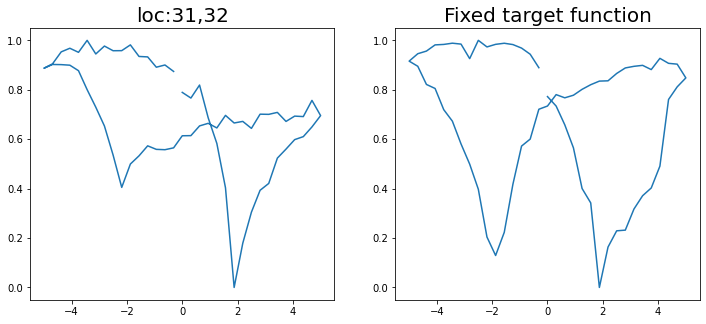

Epoch 1/200 ... Training loss: 2.5131
Epoch 10/200 ... Training loss: 2.2911
Epoch 20/200 ... Training loss: 2.0917
Epoch 30/200 ... Training loss: 1.9254
Epoch 40/200 ... Training loss: 1.7643
Epoch 50/200 ... Training loss: 1.6641
Epoch 60/200 ... Training loss: 1.6178
Epoch 70/200 ... Training loss: 1.541
Epoch 80/200 ... Training loss: 1.4831
Epoch 90/200 ... Training loss: 1.3827
Epoch 100/200 ... Training loss: 1.3719
Epoch 110/200 ... Training loss: 1.3153
Epoch 120/200 ... Training loss: 1.3964
Epoch 130/200 ... Training loss: 1.3307
Epoch 140/200 ... Training loss: 1.2568
Epoch 150/200 ... Training loss: 1.1773
Epoch 160/200 ... Training loss: 1.1965
Epoch 170/200 ... Training loss: 1.2848
Epoch 180/200 ... Training loss: 1.1208
Epoch 190/200 ... Training loss: 1.2044
Epoch 200/200 ... Training loss: 1.0824
step:  183
Sample #193




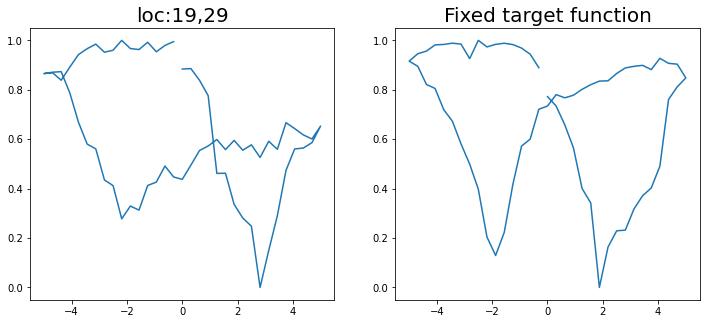

Epoch 1/200 ... Training loss: 2.5077
Epoch 10/200 ... Training loss: 2.2555
Epoch 20/200 ... Training loss: 2.2006
Epoch 30/200 ... Training loss: 2.0911
Epoch 40/200 ... Training loss: 1.9353
Epoch 50/200 ... Training loss: 1.8272
Epoch 60/200 ... Training loss: 1.7748
Epoch 70/200 ... Training loss: 1.6581
Epoch 80/200 ... Training loss: 1.6077
Epoch 90/200 ... Training loss: 1.5174
Epoch 100/200 ... Training loss: 1.4901
Epoch 110/200 ... Training loss: 1.4137
Epoch 120/200 ... Training loss: 1.4123
Epoch 130/200 ... Training loss: 1.3787
Epoch 140/200 ... Training loss: 1.3402
Epoch 150/200 ... Training loss: 1.2842
Epoch 160/200 ... Training loss: 1.2457
Epoch 170/200 ... Training loss: 1.4984
Epoch 180/200 ... Training loss: 1.2585
Epoch 190/200 ... Training loss: 1.3241
Epoch 200/200 ... Training loss: 1.1849
step:  184
Sample #194




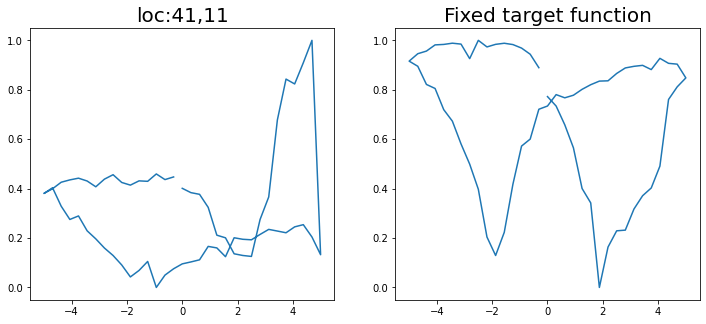

Epoch 1/200 ... Training loss: 2.5046
Epoch 10/200 ... Training loss: 2.3047
Epoch 20/200 ... Training loss: 2.033
Epoch 30/200 ... Training loss: 1.9323
Epoch 40/200 ... Training loss: 1.7876
Epoch 50/200 ... Training loss: 1.702
Epoch 60/200 ... Training loss: 1.613
Epoch 70/200 ... Training loss: 1.5379
Epoch 80/200 ... Training loss: 1.7988
Epoch 90/200 ... Training loss: 1.5272
Epoch 100/200 ... Training loss: 1.4644
Epoch 110/200 ... Training loss: 1.4143
Epoch 120/200 ... Training loss: 1.3894
Epoch 130/200 ... Training loss: 1.2756
Epoch 140/200 ... Training loss: 1.2612
Epoch 150/200 ... Training loss: 1.239
Epoch 160/200 ... Training loss: 1.1478
Epoch 170/200 ... Training loss: 1.2693
Epoch 180/200 ... Training loss: 1.2022
Epoch 190/200 ... Training loss: 1.1116
Epoch 200/200 ... Training loss: 1.1319
step:  185
Sample #195




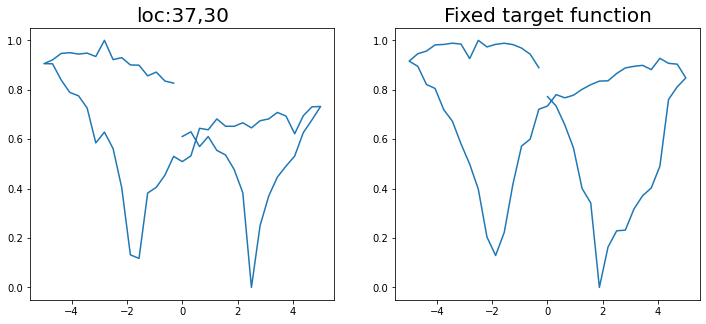

Epoch 1/200 ... Training loss: 2.4972
Epoch 10/200 ... Training loss: 2.4019
Epoch 20/200 ... Training loss: 2.1884
Epoch 30/200 ... Training loss: 2.0438
Epoch 40/200 ... Training loss: 1.8669
Epoch 50/200 ... Training loss: 1.7097
Epoch 60/200 ... Training loss: 1.6958
Epoch 70/200 ... Training loss: 1.6333
Epoch 80/200 ... Training loss: 1.5545
Epoch 90/200 ... Training loss: 1.4709
Epoch 100/200 ... Training loss: 1.4886
Epoch 110/200 ... Training loss: 1.3972
Epoch 120/200 ... Training loss: 1.4069
Epoch 130/200 ... Training loss: 1.3258
Epoch 140/200 ... Training loss: 1.303
Epoch 150/200 ... Training loss: 1.3349
Epoch 160/200 ... Training loss: 1.2934
Epoch 170/200 ... Training loss: 1.2214
Epoch 180/200 ... Training loss: 1.2625
Epoch 190/200 ... Training loss: 1.1917
Epoch 200/200 ... Training loss: 1.2226
step:  186
Sample #196




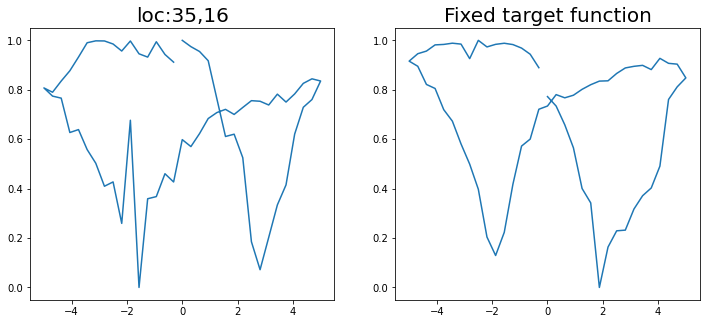

Epoch 1/200 ... Training loss: 2.4889
Epoch 10/200 ... Training loss: 2.236
Epoch 20/200 ... Training loss: 1.969
Epoch 30/200 ... Training loss: 1.8939
Epoch 40/200 ... Training loss: 1.7263
Epoch 50/200 ... Training loss: 1.6837
Epoch 60/200 ... Training loss: 1.5612
Epoch 70/200 ... Training loss: 1.5052
Epoch 80/200 ... Training loss: 1.5008
Epoch 90/200 ... Training loss: 1.4653
Epoch 100/200 ... Training loss: 1.4
Epoch 110/200 ... Training loss: 1.2811
Epoch 120/200 ... Training loss: 1.3022
Epoch 130/200 ... Training loss: 1.2251
Epoch 140/200 ... Training loss: 1.1824
Epoch 150/200 ... Training loss: 1.1907
Epoch 160/200 ... Training loss: 1.1788
Epoch 170/200 ... Training loss: 1.0793
Epoch 180/200 ... Training loss: 1.1213
Epoch 190/200 ... Training loss: 1.0162
Epoch 200/200 ... Training loss: 0.9918
step:  187
Sample #197




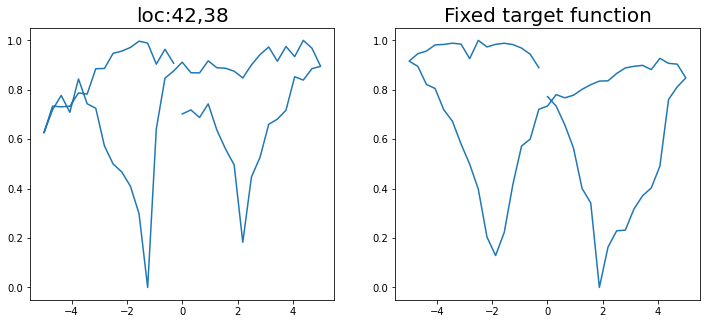

Epoch 1/200 ... Training loss: 2.4806
Epoch 10/200 ... Training loss: 2.2447
Epoch 20/200 ... Training loss: 2.1272
Epoch 30/200 ... Training loss: 1.9415
Epoch 40/200 ... Training loss: 1.8212
Epoch 50/200 ... Training loss: 1.6903
Epoch 60/200 ... Training loss: 1.6211
Epoch 70/200 ... Training loss: 1.5386
Epoch 80/200 ... Training loss: 1.5311
Epoch 90/200 ... Training loss: 1.6261
Epoch 100/200 ... Training loss: 1.4961
Epoch 110/200 ... Training loss: 1.4
Epoch 120/200 ... Training loss: 1.3474
Epoch 130/200 ... Training loss: 1.4476
Epoch 140/200 ... Training loss: 1.2934
Epoch 150/200 ... Training loss: 1.4607
Epoch 160/200 ... Training loss: 1.299
Epoch 170/200 ... Training loss: 1.2057
Epoch 180/200 ... Training loss: 1.2561
Epoch 190/200 ... Training loss: 1.2119
Epoch 200/200 ... Training loss: 1.1267
step:  188
Sample #198




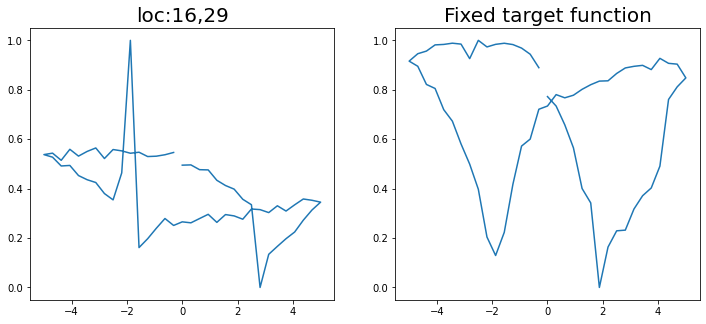

Epoch 1/200 ... Training loss: 2.4815
Epoch 10/200 ... Training loss: 2.223
Epoch 20/200 ... Training loss: 2.1143
Epoch 30/200 ... Training loss: 1.9251
Epoch 40/200 ... Training loss: 1.8138
Epoch 50/200 ... Training loss: 1.71
Epoch 60/200 ... Training loss: 1.7482
Epoch 70/200 ... Training loss: 1.6438
Epoch 80/200 ... Training loss: 1.5344
Epoch 90/200 ... Training loss: 1.5314
Epoch 100/200 ... Training loss: 1.4692
Epoch 110/200 ... Training loss: 1.3677
Epoch 120/200 ... Training loss: 1.3421
Epoch 130/200 ... Training loss: 1.3473
Epoch 140/200 ... Training loss: 1.3445
Epoch 150/200 ... Training loss: 1.3812
Epoch 160/200 ... Training loss: 1.3276
Epoch 170/200 ... Training loss: 1.3188
Epoch 180/200 ... Training loss: 1.2045
Epoch 190/200 ... Training loss: 1.2911
Epoch 200/200 ... Training loss: 1.2811
step:  189
Sample #199




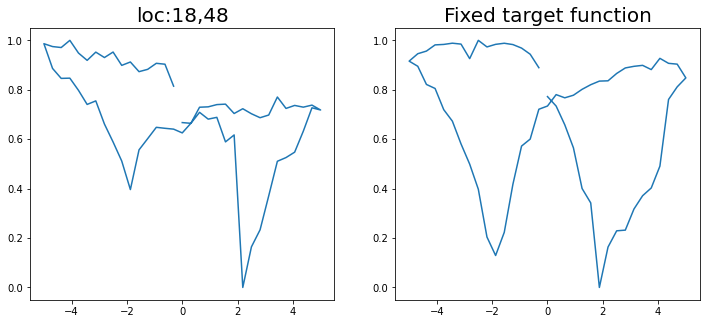

Epoch 1/200 ... Training loss: 2.4736
Epoch 10/200 ... Training loss: 2.151
Epoch 20/200 ... Training loss: 2.1579
Epoch 30/200 ... Training loss: 2.0617
Epoch 40/200 ... Training loss: 1.9822
Epoch 50/200 ... Training loss: 1.8436
Epoch 60/200 ... Training loss: 1.7332
Epoch 70/200 ... Training loss: 1.6538
Epoch 80/200 ... Training loss: 1.5648
Epoch 90/200 ... Training loss: 1.4919
Epoch 100/200 ... Training loss: 1.5507
Epoch 110/200 ... Training loss: 1.4877
Epoch 120/200 ... Training loss: 1.4381
Epoch 130/200 ... Training loss: 1.4518
Epoch 140/200 ... Training loss: 1.4544
Epoch 150/200 ... Training loss: 1.3217
Epoch 160/200 ... Training loss: 1.2901
Epoch 170/200 ... Training loss: 1.3425
Epoch 180/200 ... Training loss: 1.2463
Epoch 190/200 ... Training loss: 1.167
Epoch 200/200 ... Training loss: 1.3656
step:  190
Sample #200




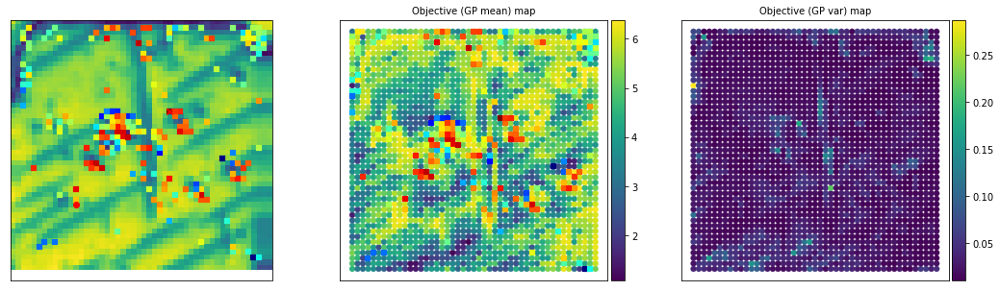

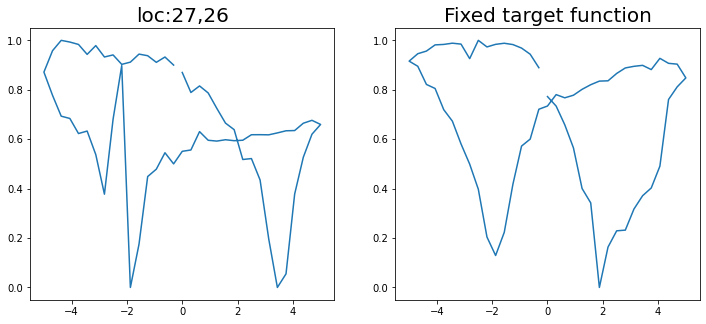

Epoch 1/200 ... Training loss: 2.4671
Epoch 10/200 ... Training loss: 2.372
Epoch 20/200 ... Training loss: 2.1251
Epoch 30/200 ... Training loss: 1.9302
Epoch 40/200 ... Training loss: 1.8296
Epoch 50/200 ... Training loss: 1.6892
Epoch 60/200 ... Training loss: 1.6603
Epoch 70/200 ... Training loss: 1.5902
Epoch 80/200 ... Training loss: 1.5343
Epoch 90/200 ... Training loss: 1.4852
Epoch 100/200 ... Training loss: 1.4533
Epoch 110/200 ... Training loss: 1.4958
Epoch 120/200 ... Training loss: 1.3921
Epoch 130/200 ... Training loss: 1.468
Epoch 140/200 ... Training loss: 1.3559
Epoch 150/200 ... Training loss: 1.3099
Epoch 160/200 ... Training loss: 1.3279
Epoch 170/200 ... Training loss: 1.4227
Epoch 180/200 ... Training loss: 1.2581
Epoch 190/200 ... Training loss: 1.277
Epoch 200/200 ... Training loss: 1.2005
step:  191
Sample #201




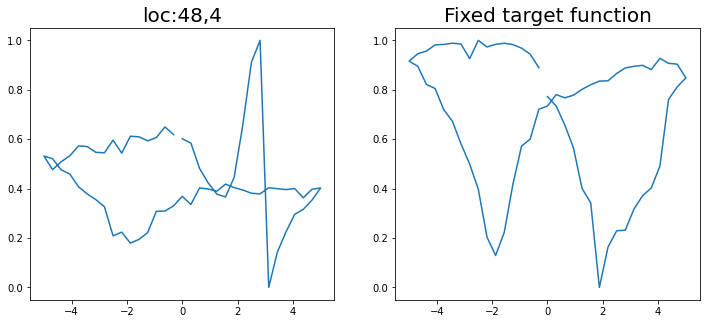

Epoch 1/200 ... Training loss: 2.46
Epoch 10/200 ... Training loss: 2.3544
Epoch 20/200 ... Training loss: 2.237
Epoch 30/200 ... Training loss: 2.0827
Epoch 40/200 ... Training loss: 1.9739
Epoch 50/200 ... Training loss: 1.8834
Epoch 60/200 ... Training loss: 1.7098
Epoch 70/200 ... Training loss: 1.6126
Epoch 80/200 ... Training loss: 1.5788
Epoch 90/200 ... Training loss: 1.6283
Epoch 100/200 ... Training loss: 1.5014
Epoch 110/200 ... Training loss: 1.4796
Epoch 120/200 ... Training loss: 1.3834
Epoch 130/200 ... Training loss: 1.6305
Epoch 140/200 ... Training loss: 1.3846
Epoch 150/200 ... Training loss: 1.3072
Epoch 160/200 ... Training loss: 1.4061
Epoch 170/200 ... Training loss: 1.2496
Epoch 180/200 ... Training loss: 1.2184
Epoch 190/200 ... Training loss: 1.6023
Epoch 200/200 ... Training loss: 1.3538
step:  192
Sample #202




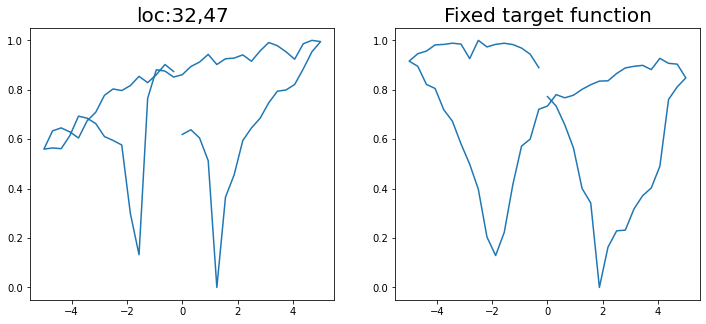

Epoch 1/200 ... Training loss: 2.4565
Epoch 10/200 ... Training loss: 2.3252
Epoch 20/200 ... Training loss: 2.132
Epoch 30/200 ... Training loss: 1.991
Epoch 40/200 ... Training loss: 1.8542
Epoch 50/200 ... Training loss: 1.7097
Epoch 60/200 ... Training loss: 1.619
Epoch 70/200 ... Training loss: 1.563
Epoch 80/200 ... Training loss: 1.502
Epoch 90/200 ... Training loss: 1.4601
Epoch 100/200 ... Training loss: 1.4676
Epoch 110/200 ... Training loss: 1.7624
Epoch 120/200 ... Training loss: 1.5603
Epoch 130/200 ... Training loss: 1.3966
Epoch 140/200 ... Training loss: 1.4048
Epoch 150/200 ... Training loss: 1.2826
Epoch 160/200 ... Training loss: 1.3453
Epoch 170/200 ... Training loss: 1.2137
Epoch 180/200 ... Training loss: 1.3078
Epoch 190/200 ... Training loss: 1.1601
Epoch 200/200 ... Training loss: 1.1491
step:  193
Sample #203




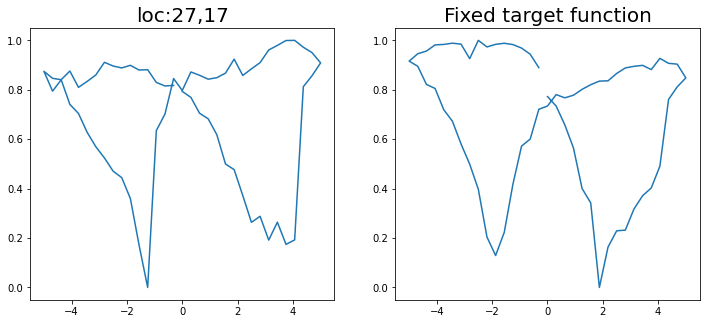

Epoch 1/200 ... Training loss: 2.4515
Epoch 10/200 ... Training loss: 2.3161
Epoch 20/200 ... Training loss: 2.1252
Epoch 30/200 ... Training loss: 1.9821
Epoch 40/200 ... Training loss: 1.8289
Epoch 50/200 ... Training loss: 1.7503
Epoch 60/200 ... Training loss: 1.7103
Epoch 70/200 ... Training loss: 1.6433
Epoch 80/200 ... Training loss: 1.5779
Epoch 90/200 ... Training loss: 1.5582
Epoch 100/200 ... Training loss: 1.4702
Epoch 110/200 ... Training loss: 1.681
Epoch 120/200 ... Training loss: 1.5307
Epoch 130/200 ... Training loss: 1.3863
Epoch 140/200 ... Training loss: 1.43
Epoch 150/200 ... Training loss: 1.3578
Epoch 160/200 ... Training loss: 1.2953
Epoch 170/200 ... Training loss: 1.2257
Epoch 180/200 ... Training loss: 1.2652
Epoch 190/200 ... Training loss: 1.1742
Epoch 200/200 ... Training loss: 1.1176
step:  194
Sample #204




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


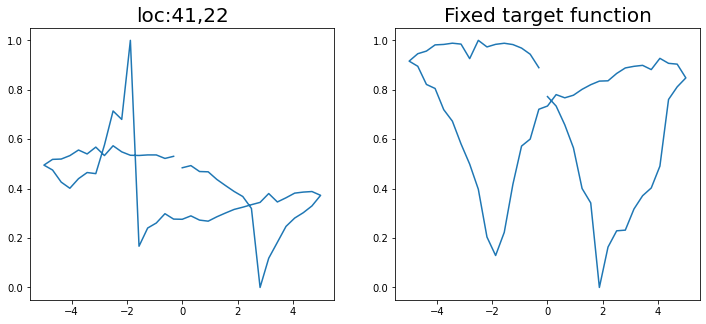

Epoch 1/200 ... Training loss: 2.4501
Epoch 10/200 ... Training loss: 2.3047
Epoch 20/200 ... Training loss: 2.1226
Epoch 30/200 ... Training loss: 1.9875
Epoch 40/200 ... Training loss: 1.84
Epoch 50/200 ... Training loss: 1.6823
Epoch 60/200 ... Training loss: 1.6214
Epoch 70/200 ... Training loss: 1.5394
Epoch 80/200 ... Training loss: 1.6874
Epoch 90/200 ... Training loss: 1.5998
Epoch 100/200 ... Training loss: 1.4661
Epoch 110/200 ... Training loss: 1.5578
Epoch 120/200 ... Training loss: 1.4038
Epoch 130/200 ... Training loss: 1.3272
Epoch 140/200 ... Training loss: 1.4352
Epoch 150/200 ... Training loss: 1.2929
Epoch 160/200 ... Training loss: 1.2317
Epoch 170/200 ... Training loss: 1.4651
Epoch 180/200 ... Training loss: 1.271
Epoch 190/200 ... Training loss: 1.3038
Epoch 200/200 ... Training loss: 1.2066
step:  195
Sample #205




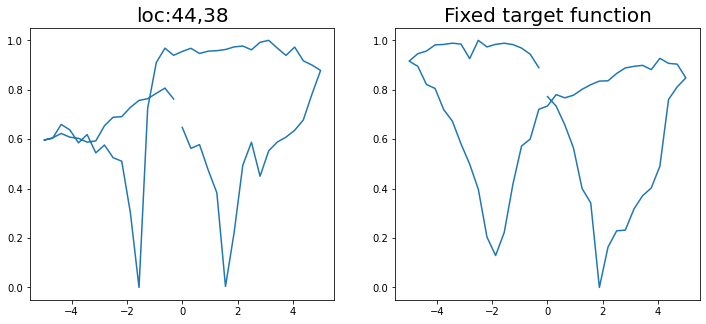

Epoch 1/200 ... Training loss: 2.443
Epoch 10/200 ... Training loss: 2.2734
Epoch 20/200 ... Training loss: 2.0538
Epoch 30/200 ... Training loss: 1.9544
Epoch 40/200 ... Training loss: 1.8222
Epoch 50/200 ... Training loss: 1.7139
Epoch 60/200 ... Training loss: 1.6233
Epoch 70/200 ... Training loss: 1.6563
Epoch 80/200 ... Training loss: 1.5217
Epoch 90/200 ... Training loss: 1.5463
Epoch 100/200 ... Training loss: 1.4441
Epoch 110/200 ... Training loss: 1.3852
Epoch 120/200 ... Training loss: 1.391
Epoch 130/200 ... Training loss: 1.3827
Epoch 140/200 ... Training loss: 1.266
Epoch 150/200 ... Training loss: 1.3734
Epoch 160/200 ... Training loss: 1.2371
Epoch 170/200 ... Training loss: 1.1961
Epoch 180/200 ... Training loss: 1.168
Epoch 190/200 ... Training loss: 1.1528
Epoch 200/200 ... Training loss: 1.12
step:  196
Sample #206




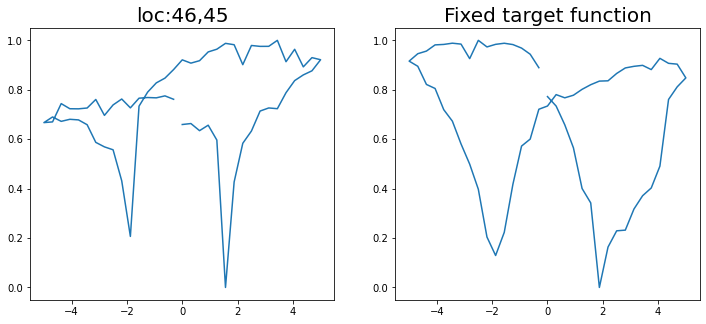

Epoch 1/200 ... Training loss: 2.4404
Epoch 10/200 ... Training loss: 2.2833
Epoch 20/200 ... Training loss: 2.1044
Epoch 30/200 ... Training loss: 1.9976
Epoch 40/200 ... Training loss: 1.8676
Epoch 50/200 ... Training loss: 1.7054
Epoch 60/200 ... Training loss: 1.6111
Epoch 70/200 ... Training loss: 1.7714
Epoch 80/200 ... Training loss: 1.6016
Epoch 90/200 ... Training loss: 1.4825
Epoch 100/200 ... Training loss: 1.6506
Epoch 110/200 ... Training loss: 1.4714
Epoch 120/200 ... Training loss: 1.3525
Epoch 130/200 ... Training loss: 1.3872
Epoch 140/200 ... Training loss: 1.2788
Epoch 150/200 ... Training loss: 1.279
Epoch 160/200 ... Training loss: 1.213
Epoch 170/200 ... Training loss: 1.2139
Epoch 180/200 ... Training loss: 1.11
Epoch 190/200 ... Training loss: 1.4579
Epoch 200/200 ... Training loss: 1.2354
step:  197
Sample #207




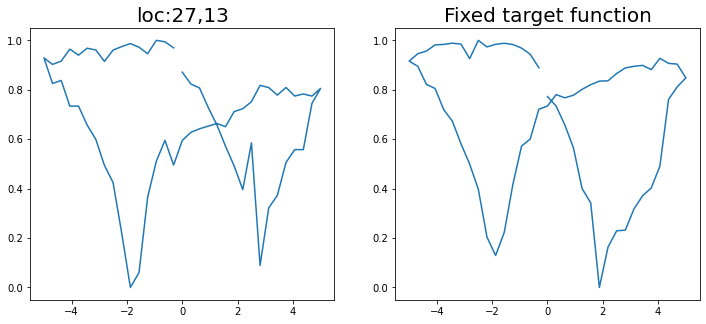

Epoch 1/200 ... Training loss: 2.4571
Epoch 10/200 ... Training loss: 2.1801
Epoch 20/200 ... Training loss: 2.0412
Epoch 30/200 ... Training loss: 2.0384
Epoch 40/200 ... Training loss: 1.8725
Epoch 50/200 ... Training loss: 1.7287
Epoch 60/200 ... Training loss: 1.6167
Epoch 70/200 ... Training loss: 1.6435
Epoch 80/200 ... Training loss: 1.5445
Epoch 90/200 ... Training loss: 1.4963
Epoch 100/200 ... Training loss: 1.4169
Epoch 110/200 ... Training loss: 1.4098
Epoch 120/200 ... Training loss: 1.3349
Epoch 130/200 ... Training loss: 1.4337
Epoch 140/200 ... Training loss: 1.3162
Epoch 150/200 ... Training loss: 1.2994
Epoch 160/200 ... Training loss: 1.2565
Epoch 170/200 ... Training loss: 1.215
Epoch 180/200 ... Training loss: 1.1939
Epoch 190/200 ... Training loss: 1.2578
Epoch 200/200 ... Training loss: 1.1398
step:  198
Sample #208




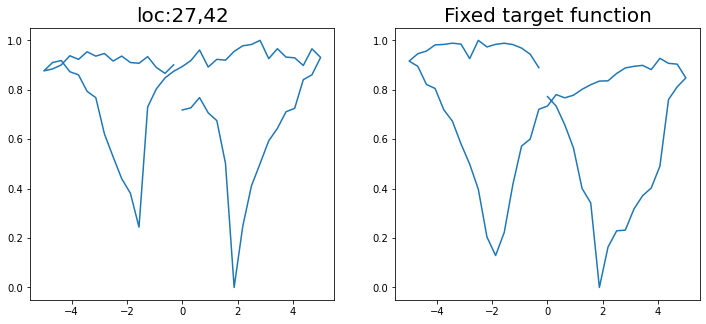

Epoch 1/200 ... Training loss: 2.4551
Epoch 10/200 ... Training loss: 2.1838
Epoch 20/200 ... Training loss: 2.0187
Epoch 30/200 ... Training loss: 1.9061
Epoch 40/200 ... Training loss: 1.9475
Epoch 50/200 ... Training loss: 1.7718
Epoch 60/200 ... Training loss: 1.6152
Epoch 70/200 ... Training loss: 1.5609
Epoch 80/200 ... Training loss: 1.4882
Epoch 90/200 ... Training loss: 1.4628
Epoch 100/200 ... Training loss: 1.4132
Epoch 110/200 ... Training loss: 1.3638
Epoch 120/200 ... Training loss: 1.6387
Epoch 130/200 ... Training loss: 1.6825
Epoch 140/200 ... Training loss: 1.411
Epoch 150/200 ... Training loss: 1.3206
Epoch 160/200 ... Training loss: 1.2611
Epoch 170/200 ... Training loss: 1.23
Epoch 180/200 ... Training loss: 1.3299
Epoch 190/200 ... Training loss: 1.2089
Epoch 200/200 ... Training loss: 1.2278
step:  199
Sample #209




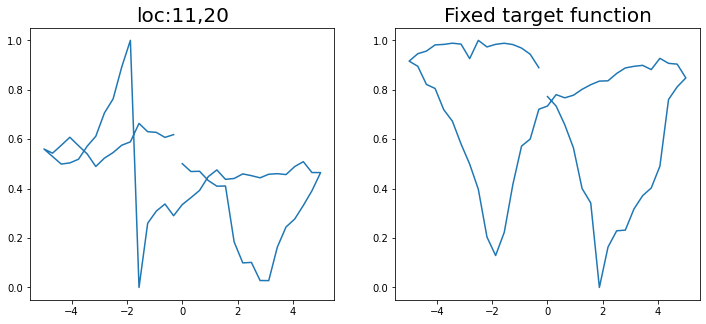

Epoch 1/200 ... Training loss: 2.4548
Epoch 10/200 ... Training loss: 2.1824
Epoch 20/200 ... Training loss: 2.0254
Epoch 30/200 ... Training loss: 1.8643
Epoch 40/200 ... Training loss: 1.8098
Epoch 50/200 ... Training loss: 1.7357
Epoch 60/200 ... Training loss: 1.61
Epoch 70/200 ... Training loss: 1.5233
Epoch 80/200 ... Training loss: 1.531
Epoch 90/200 ... Training loss: 1.5452
Epoch 100/200 ... Training loss: 1.4563
Epoch 110/200 ... Training loss: 1.3597
Epoch 120/200 ... Training loss: 1.4462
Epoch 130/200 ... Training loss: 1.3582
Epoch 140/200 ... Training loss: 1.2826
Epoch 150/200 ... Training loss: 1.3181
Epoch 160/200 ... Training loss: 1.2215
Epoch 170/200 ... Training loss: 1.2062
Epoch 180/200 ... Training loss: 1.1978
Epoch 190/200 ... Training loss: 1.2227
Epoch 200/200 ... Training loss: 1.0789
step:  200
Sample #210




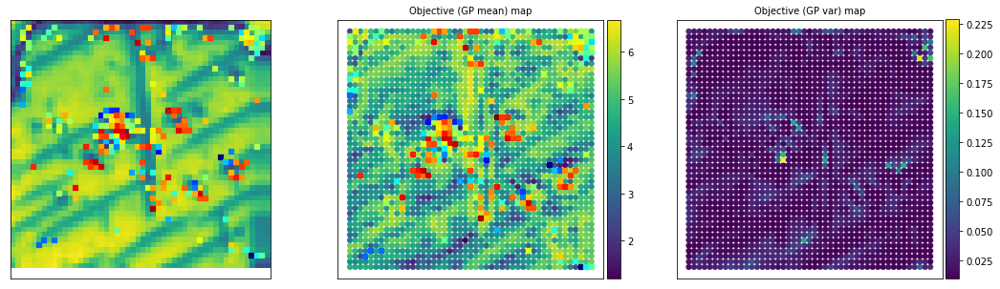

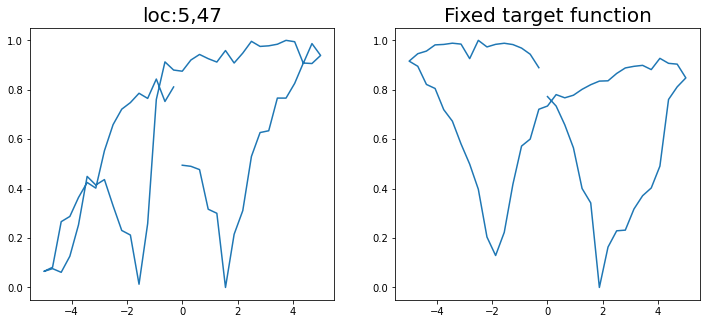

Epoch 1/200 ... Training loss: 2.4505
Epoch 10/200 ... Training loss: 2.1816
Epoch 20/200 ... Training loss: 2.04
Epoch 30/200 ... Training loss: 1.8774
Epoch 40/200 ... Training loss: 1.7523
Epoch 50/200 ... Training loss: 1.6537
Epoch 60/200 ... Training loss: 1.5618
Epoch 70/200 ... Training loss: 1.5304
Epoch 80/200 ... Training loss: 1.8205
Epoch 90/200 ... Training loss: 1.6577
Epoch 100/200 ... Training loss: 1.4925
Epoch 110/200 ... Training loss: 1.4025
Epoch 120/200 ... Training loss: 1.3988
Epoch 130/200 ... Training loss: 1.3698
Epoch 140/200 ... Training loss: 1.3865
Epoch 150/200 ... Training loss: 1.323
Epoch 160/200 ... Training loss: 1.3781
Epoch 170/200 ... Training loss: 1.3486
Epoch 180/200 ... Training loss: 1.2961
Epoch 190/200 ... Training loss: 1.277
Epoch 200/200 ... Training loss: 1.152


#####----Max. sampling reached, model stopped----#####


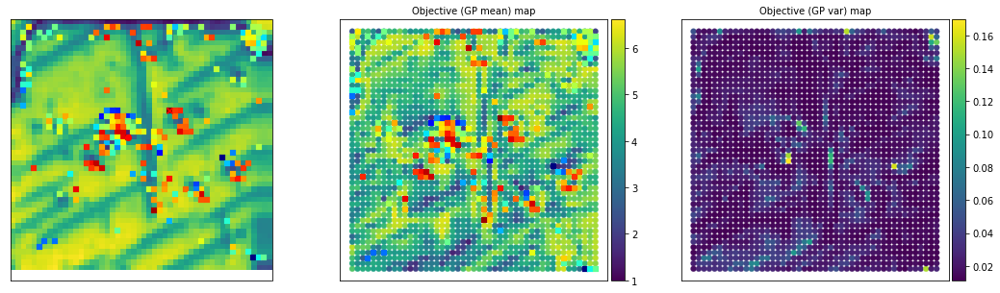

/usr/local/lib/python3.8/dist-packages/numpy/lib/npyio.py:528: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.asanyarray(arr)


In [15]:
## Gp model fit
# Calling function to fit and optimizize Hyperparameter of Gaussian Process (using Adam optimizer)
# Input args- Torch arrays of normalized training data, parameter X and objective eval Y
# Output args- Gaussian process model lists
switch_obj_index = 0 # This is the index parameter to switch from 0 to 1 when the user satisfy with updating target
#Set up the surrogat emodel
gp_surro = play_varTBO.optimize_dKLgp(train_X_norm, train_Y[:, 0])

for i in range(1, N + 1):
    print("step: ", i)
    print("Sample #" + str(m + 1)+ "\n\n")
    # Calculate posterior for analysis for intermidiate iterations
    y_pred_means, y_pred_vars = play_varTBO.cal_posterior(gp_surro, test_X_norm)
        
    #Plot every tenth iteration after running the evaluation
    if ((i == 1) or ((i % 10) == 0)):
        #This will estimate the surrogate
        X_eval, X_GP, _, _ = play_varTBO.estimate(train_indices, train_Y, indices, y_pred_means)
        #print(X_eval, X_GP)
        fig = plot_results(train_indices, train_Y, indices, y_pred_means, y_pred_vars, X_eval, X_GP, img, i)
        #put the savefig within the plot function
        #fig.savefig('acquisition_results_step=' + str(i) +'.png', dpi = 300, bbox_inches = 'tight', pad_inches = 1.0)
    #calculate acquisition function
    acq_cand, acq_val, EI_val = play_varTBO.acqmanEI(y_pred_means, y_pred_vars, train_Y, idx)
    val = acq_val
    ind = np.random.choice(acq_cand) # When multiple points have same acq values
    idx = np.hstack((idx, ind))
    #print(new_points_measured, idx)

    ## Find next point which maximizes the learning through exploration-exploitation
    if (i == 1):
        val_ini = val
      # Check for convergence
    if ((val) < 0):  # Stop for negligible expected improvement
        print("Model converged due to sufficient learning over search space ")
        break
    else:
        nextX = np.zeros((1, test_X.shape[1]))
        nextX_norm = np.zeros((1, test_X_norm.shape[1]))
        next_indices = np.zeros((1,2))
        nextX[0,:] = test_X[ind, :]
        nextX_norm [0, :] = test_X_norm[ind, :]
        next_indices[0, :] = indices[ind, :]
        idx_x = int(next_indices[0, 0])
        idx_y = int(next_indices[0, 1])

        next_loc = np.asarray([idx_x, idx_y])
        new_points_measured = idx
        
        #polarization loop area
        IV, points_measured = return_new_measurement(targets, new_points_measured)

        new_iv = IV[points_measured,:]

        #new_spec_x = torch.from_numpy(vdc_vec)
        #new_spec_y = torch.from_numpy(new_iv)[-1]

        new_spec_x = vdc_vec
        new_spec_y = new_iv[-1]

      
        new_spec_y = (new_spec_y - new_spec_y.min())/(new_spec_y.max() - new_spec_y.min())
        
        #clear_output(wait=True) Comment out as I need to check the run in colab
        
        eval_spec_y[idx_x, idx_y, :] = new_spec_y
        # Evaluate true function for new data, augment data
        train_X, train_X_norm, train_indices, train_Y, var_params, switch_obj_index, m =\
        play_varTBO.augment_newdata_KL(nextX, nextX_norm, next_indices, train_X, train_X_norm, train_indices, train_Y,
                                        new_spec_x, new_spec_y, eval_spec_y, img, var_params, switch_obj_index, m)


        #print(next_indices)
        # Gp model fit
        # Updating GP with augmented training data
        gp_surro = play_varTBO.optimize_dKLgp(train_X_norm, train_Y[:, 0])

    ## Final posterior prediction after all the sampling done

if (i == N):
    print("\n\n#####----Max. sampling reached, model stopped----#####")

#Optimal GP learning
gp_opt = gp_surro
# Posterior calculation with converged GP model
y_pred_means, y_pred_vars = play_varTBO.cal_posterior(gp_opt, test_X_norm)

# Plotting functions to check final iteration
X_opt, X_opt_GP, ind_opt, ind_opt_GP = play_varTBO.estimate(train_indices, train_Y, indices, y_pred_means)
plot_results(train_indices, train_Y, indices, y_pred_means, y_pred_vars, X_opt, X_opt_GP, img, i)

explored_data = [train_indices, train_indices, train_Y]
final_GP_estim = [y_pred_means, y_pred_vars]
user_votes = var_params[1]
optim_results = [X_opt, X_opt_GP, ind_opt, ind_opt_GP, user_votes, explored_data, y_pred_means, y_pred_vars]

#Save few data
np.save("optim_resultsd1_dklBOpatch", optim_results)

# Generate spectral ground truth image -- compute objective, given target at all the grid points

In [19]:
spec_ground = np.zeros((indices.shape[0],1))
spec_ground.shape

(2115, 1)

In [20]:
for i in range(0, indices.shape[0]):
  idx_x = int(indices[i, 0])
  idx_y = int(indices[i, 1])
  new_spec_y = targets[i, :]
  new_spec_y = (new_spec_y - new_spec_y.min())/(new_spec_y.max() - new_spec_y.min())
  #print(idx_x, idx_y, spec_y)
  spec_ground[i, 0] = play_varTBO.func_automated_obj(idx_x, idx_y, new_spec_x, new_spec_y, target_func)

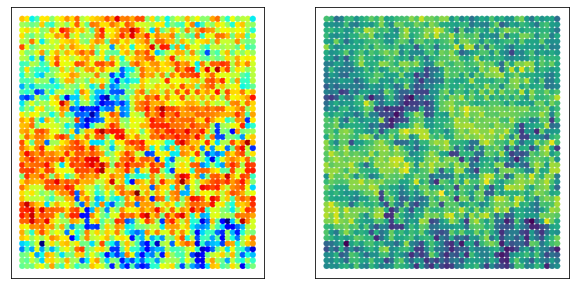

In [21]:
  fig,ax=plt.subplots(ncols=2,figsize=(10,5))
  a = ax[0].scatter(indices[:,1], indices[:,0], c=spec_ground, cmap='jet', linewidth=0.2)
  #cax = divider.append_axes('right', size='5%', pad=0.05)
  #fig.colorbar(a, cax=cax, orientation='vertical')
  #ax[1].set_title('Objective (GP mean) map', fontsize=10)
  ax[0].axes.xaxis.set_visible(False)
  ax[0].axes.yaxis.set_visible(False)

  a = ax[1].scatter(indices[:,1], indices[:,0], c=spec_ground, cmap='viridis', linewidth=0.2)
  #cax = divider.append_axes('right', size='5%', pad=0.05)
  #fig.colorbar(a, cax=cax, orientation='vertical')
  #ax[1].set_title('Objective (GP mean) map', fontsize=10)
  ax[1].axes.xaxis.set_visible(False)
  ax[1].axes.yaxis.set_visible(False)

Error map between ground truth and GP prediction of SSIM

0.19024357949921253


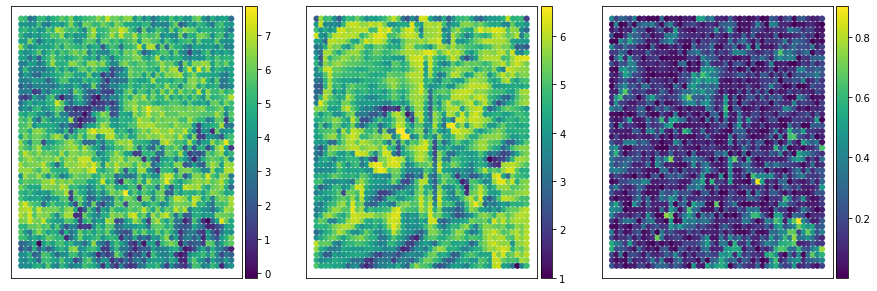

In [22]:
spec_ground_norm = (spec_ground -np.min(spec_ground))/(np.max(spec_ground)-np.min(spec_ground))
y_pred_means_norm = (y_pred_means-np.min(y_pred_means))/(np.max(y_pred_means)-np.min(y_pred_means))
error = np.absolute(spec_ground_norm-y_pred_means_norm)
mae = np.mean(error)
print(mae)
fig,ax=plt.subplots(ncols=3,figsize=(15,5))
a = ax[0].scatter(indices[:,1], indices[:,0], c=spec_ground, cmap='viridis', linewidth=0.2)
divider = make_axes_locatable(ax[0])
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(a, cax=cax, orientation='vertical')
#ax[0].set_title('Objective (GP mean) map', fontsize=10)
ax[0].axes.xaxis.set_visible(False)
ax[0].axes.yaxis.set_visible(False)

a = ax[1].scatter(indices[:,1], indices[:,0], c=y_pred_means, cmap='viridis', linewidth=0.2)
divider = make_axes_locatable(ax[1])
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(a, cax=cax, orientation='vertical')
#ax[1].set_title('Objective (GP mean) map', fontsize=10)
ax[1].axes.xaxis.set_visible(False)
ax[1].axes.yaxis.set_visible(False)

a = ax[2].scatter(indices[:,1], indices[:,0], c=error, cmap='viridis', linewidth=0.2)
divider = make_axes_locatable(ax[2])
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(a, cax=cax, orientation='vertical')
#ax[1].set_title('Objective (GP mean) map', fontsize=10)
ax[2].axes.xaxis.set_visible(False)
ax[2].axes.yaxis.set_visible(False)

0.05888187027164286


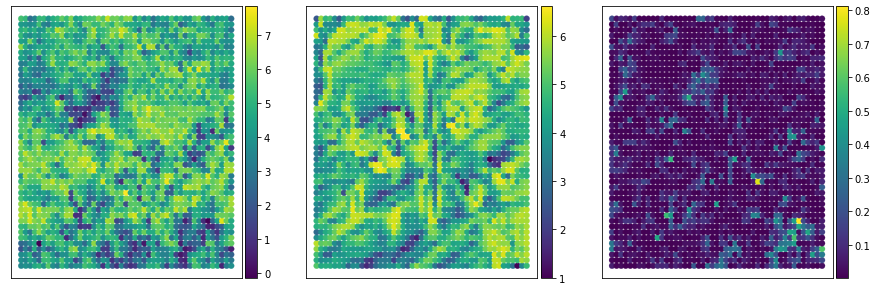

In [23]:
spec_ground_norm = (spec_ground -np.min(spec_ground))/(np.max(spec_ground)-np.min(spec_ground))
y_pred_means_norm = (y_pred_means-np.min(y_pred_means))/(np.max(y_pred_means)-np.min(y_pred_means))
error = (spec_ground_norm-y_pred_means_norm)**2
mse = np.mean(error)
print(mse)
fig,ax=plt.subplots(ncols=3,figsize=(15,5))
a = ax[0].scatter(indices[:,1], indices[:,0], c=spec_ground, cmap='viridis', linewidth=0.2)
divider = make_axes_locatable(ax[0])
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(a, cax=cax, orientation='vertical')
#ax[0].set_title('Objective (GP mean) map', fontsize=10)
ax[0].axes.xaxis.set_visible(False)
ax[0].axes.yaxis.set_visible(False)

a = ax[1].scatter(indices[:,1], indices[:,0], c=y_pred_means, cmap='viridis', linewidth=0.2)
divider = make_axes_locatable(ax[1])
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(a, cax=cax, orientation='vertical')
#ax[1].set_title('Objective (GP mean) map', fontsize=10)
ax[1].axes.xaxis.set_visible(False)
ax[1].axes.yaxis.set_visible(False)

a = ax[2].scatter(indices[:,1], indices[:,0], c=error, cmap='viridis', linewidth=0.2)
divider = make_axes_locatable(ax[2])
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(a, cax=cax, orientation='vertical')
#ax[1].set_title('Objective (GP mean) map', fontsize=10)
ax[2].axes.xaxis.set_visible(False)
ax[2].axes.yaxis.set_visible(False)

#Next data

In [6]:
!gdown https://drive.google.com/uc?id=1pl7tJwDH0xsx21TwrN_i8KM7yEFHT4Xw
pickle_file_loc = r'beps_ground_truth_d2.p'
original_data = pickle.load(open(pickle_file_loc, "rb"))
beps_all = original_data['results_beps']

Downloading...
From: https://drive.google.com/uc?id=1pl7tJwDH0xsx21TwrN_i8KM7yEFHT4Xw
To: /content/beps_ground_truth_d2.p
100% 758M/758M [00:04<00:00, 166MB/s]


In [7]:
!gdown https://drive.google.com/uc?id=1djbYo-Gjgu6oVGaZlnp3idkUDDOru991
results = np.load("iterative_results_d2.npy", allow_pickle=True)

Downloading...
From: https://drive.google.com/uc?id=1djbYo-Gjgu6oVGaZlnp3idkUDDOru991
To: /content/iterative_results_d2.npy
100% 112M/112M [00:00<00:00, 133MB/s]


In [8]:
img_big = results[0][-2]

In [10]:
dim = 50
img = resize(img_big, (50, 50),
                       anti_aliasing=True)

In [11]:
spec_length = 64  #spectral data length
dim = 50
amp_slices = []
for ind in range(len(beps_all)):
    amp_slices.append(beps_all[ind][1][2])
amp_slices = np.array(amp_slices)
#img = amp_slices[:,10].reshape(50,50)

vdc_full = np.array(beps_all[0][1][0])
vdc_vec = vdc_full[-64:]

amp_mat = amp_slices[:,128:][:,1::2]
amp_masked = np.zeros_like(amp_mat)


spec_length = amp_mat.shape[-1]  #spectral data length
specim = np.reshape(amp_mat, (dim, dim, spec_length))

print(img.shape, vdc_vec.shape, amp_slices.shape, specim.shape)

(50, 50) (64,) (2500, 256) (50, 50, 64)


# Ground truth image

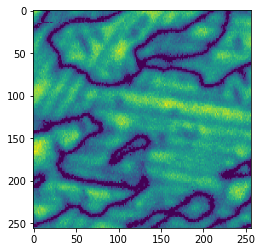

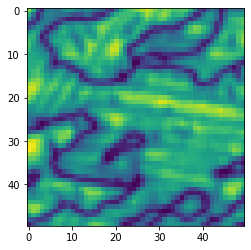

In [12]:
plt.imshow(img_big)
plt.show()
plt.imshow(img)
plt.show()

In [13]:
window_size = 4

coordinates = aoi.utils.get_coord_grid(img, step=1, return_dict=False)
features, targets, indices = aoi.utils.extract_patches_and_spectra(
    specim, img, coordinates=coordinates, window_size=window_size, avg_pool=1)

features.shape, targets.shape

/usr/local/lib/python3.8/dist-packages/atomai/utils/img.py:450: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:230.)
  spectra = torch.tensor(spectra).unsqueeze(1)


((2209, 4, 4), (2209, 64))

In [14]:
norm_ = lambda x: (x - x.min()) / x.ptp()
features, targets = norm_(features), norm_(targets)

In [15]:
n, d1, d2 = features.shape
num_start = int(10)
N = int(200)
m = 0
spec_length = 64  #spectral data length



spec_length = amp_mat.shape[-1]  #spectral data length

coordinates = utils.get_coord_grid(img, 1)
X_feas = features.reshape(n, d1*d2)

X_feas_norm = features.reshape(n, d1*d2)

amp_masked = np.zeros_like(targets)
np.random.seed(10)

idx = np.random.randint(0, len(X_feas), num_start)
for ind in range(num_start):
    amp_masked[int(idx[ind]),:] = targets[int(idx[ind]),:]

train_X = X_feas[idx]
train_X_norm = X_feas_norm[idx]
#indices = torch.from_numpy(indices)
train_indices = indices[idx]

print(X_feas.shape, X_feas_norm.shape,train_X.shape, train_X_norm.shape, train_indices.shape, amp_masked.shape)

(2209, 16) (2209, 16) (10, 16) (10, 16) (10, 2) (2209, 64)


# Initial sampling

i is 0, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #1


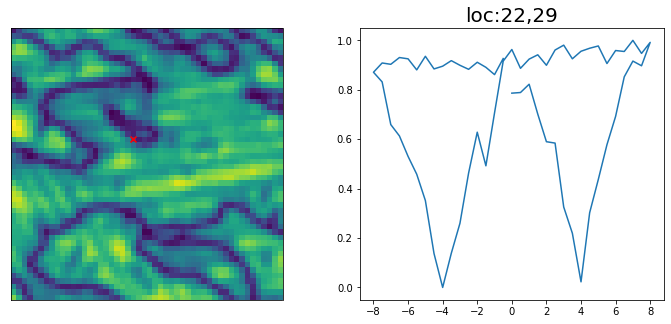

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 2
2.0
i is 1, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #2


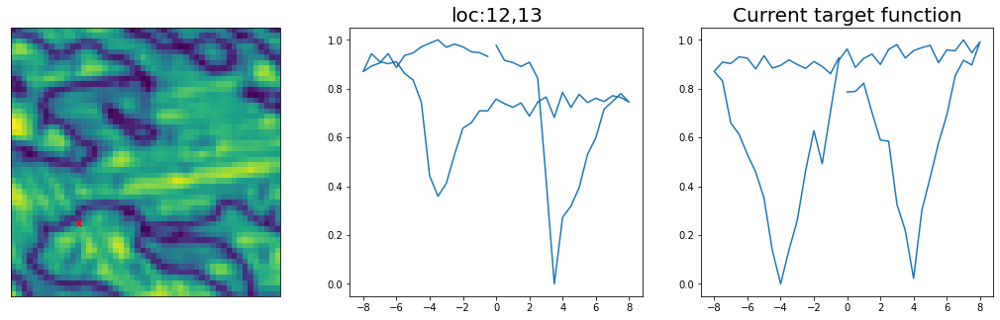

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 1
1.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 2, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #3


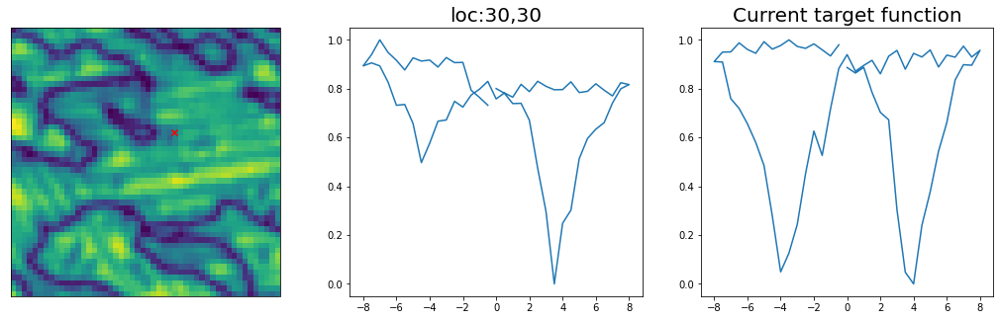

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 
0
i is 3, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #4


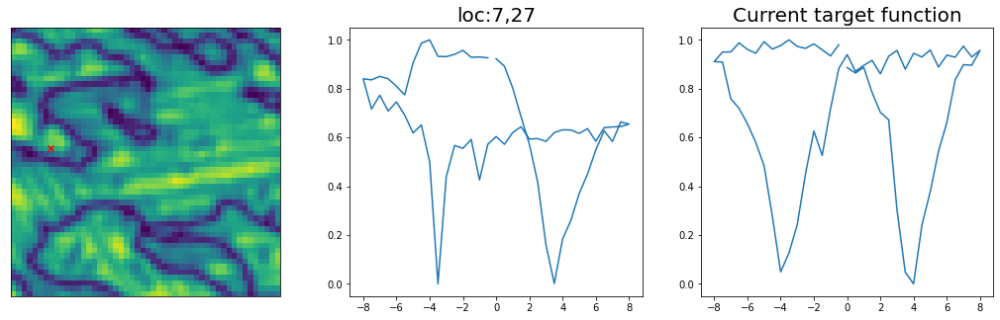

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 
0
i is 4, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #5


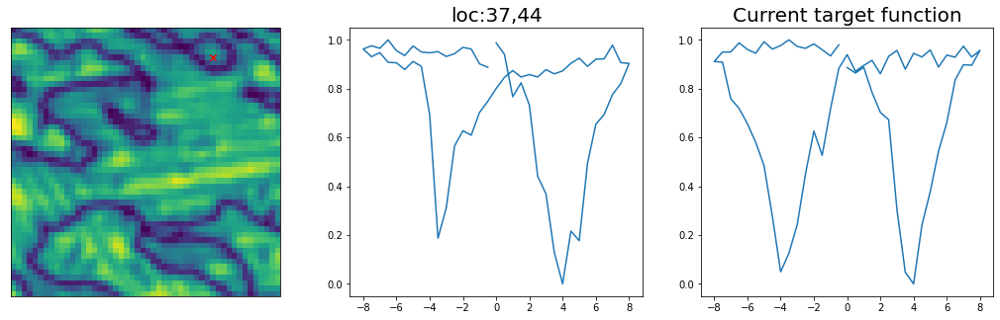

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 2
2.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 5, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #6


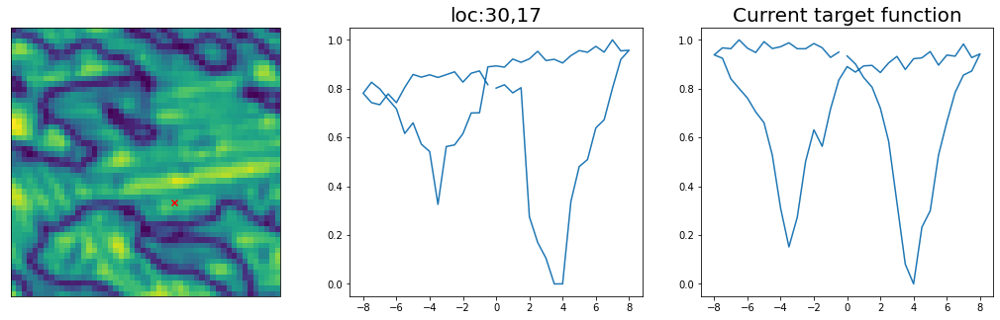

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 
0
i is 6, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #7


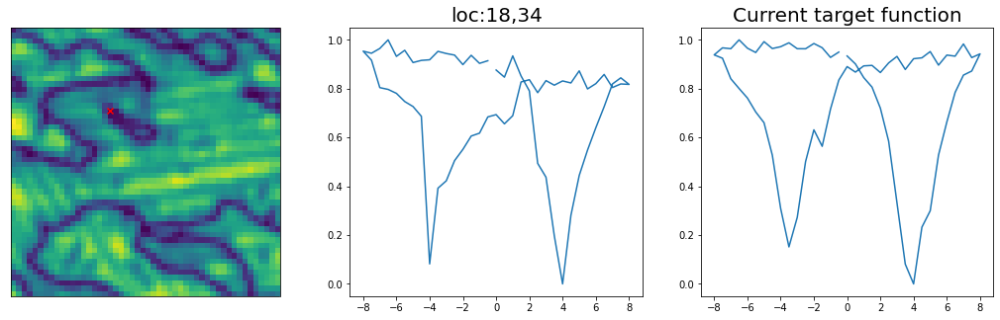

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 2
2.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 7, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #8


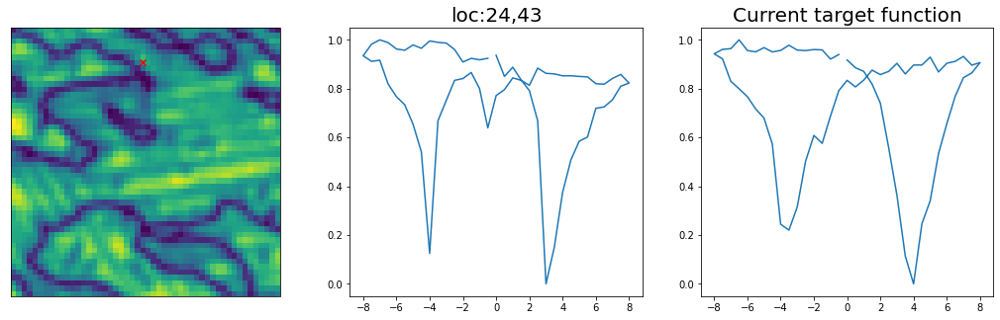

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 2
2.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 8, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #9


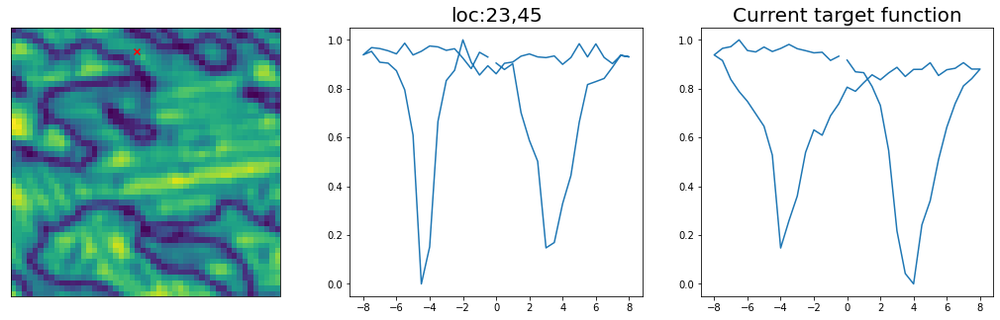

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 1
1.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 
i is 9, measurement done
points measured [1289  527 1344 1180 2009  733 1520 1949 2042 1032]
new_points_measured []


Sample #10


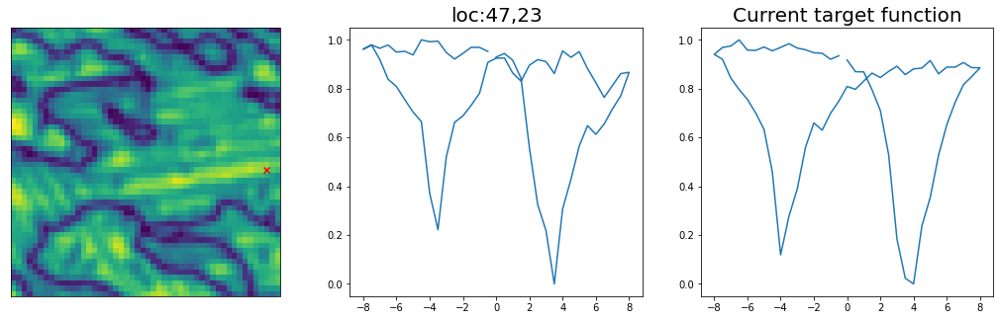

Rating: 0-Bad or press ENTER, 1-Good, 2-Very good
enter rating: 1
1.0
Do you want to update preference to new spectral over prioir mean target? y- Yes or press ENTER- No
Answer: 


In [16]:
def return_new_measurement(full_dataset, points_measured):
    ampdat_masked = np.zeros_like(full_dataset)
    ampdat_masked[points_measured,:] = full_dataset[points_measured,:]
    return ampdat_masked, points_measured

# set parameters
IV = np.copy(amp_masked)
points_measured = np.array(idx)
last_points_measured = np.array(points_measured)
vdc = vdc_vec

train_Y = np.zeros((num_start, 1))
pref = np.zeros((num_start, 1))
init_spec = np.zeros((num_start, spec_length))
# Define a sparse grid to store evaluated spectral locations
eval_spec_y = np.zeros((img.shape[0],img.shape[0],spec_length))
#Evaluate initial training data
x = np.zeros((1,2))

# First generate target loop, based on initial training data
wcount_good= 0
target_func = np.zeros(spec_length)

mask = np.isin(points_measured, last_points_measured, invert = True)
new_points_measured = points_measured[mask]
last_points_measured = np.append(last_points_measured, new_points_measured)

for i in range(0, num_start):
    
    ##******************experiment start*******************##
    time.sleep(0.1)

    idx_x = int(train_indices[i, 0])
    idx_y = int(train_indices[i, 1])

    next_loc = np.asarray([idx_x, idx_y])
    
    print("i is {}, measurement done".format(i))
    
    mask = np.isin(points_measured, last_points_measured, invert = True)
    new_points_measured = points_measured[mask]
    last_points_measured = np.append(last_points_measured, new_points_measured)
    print('points measured {}'.format(points_measured))
    print('new_points_measured {}'.format(new_points_measured))

    new_iv = IV[last_points_measured,:]

    #new_spec_x = torch.from_numpy(vdc_vec)
    #new_spec_y = torch.from_numpy(new_iv)[i,:]

    new_spec_x = vdc_vec
    new_spec_y = new_iv[i,:]
    

    new_spec_y = (new_spec_y - new_spec_y.min())/(new_spec_y.max() - new_spec_y.min())

    init_spec[i,] = new_spec_y
    eval_spec_y[idx_x, idx_y, :] = new_spec_y
    print("\n\nSample #" + str(m + 1))
    pref[i, 0], wcount_good, target_func = play_varTBO.generate_targetobj(idx_x, idx_y, new_spec_x,new_spec_y, 
                                                              img, wcount_good, target_func)
    m = m + 1


# Once target loop is defined (unless are loops are selected bad by user), we compute the obj
for i in range(0, num_start):
  idx_x = int(train_indices[i, 0])
  idx_y = int(train_indices[i, 1])
  spec_y = eval_spec_y[idx_x, idx_y, :]
  #print(idx_x, idx_y, spec_y)
  train_Y[i, 0] = play_varTBO.func_human_interacted_obj(idx_x, idx_y, new_spec_x, spec_y, wcount_good, target_func, pref[i, 0])

var_params = [wcount_good, pref, target_func]
test_X, test_X_norm, train_X, train_X_norm, train_Y, var_params, idx, m \
= X_feas, X_feas_norm, train_X, train_X_norm, train_Y, var_params, idx, m


# Run dKLBO

Epoch 1/200 ... Training loss: 1.7806
Epoch 10/200 ... Training loss: 1.6345
Epoch 20/200 ... Training loss: 1.5697
Epoch 30/200 ... Training loss: 1.4916
Epoch 40/200 ... Training loss: 1.4739
Epoch 50/200 ... Training loss: 1.4225
Epoch 60/200 ... Training loss: 1.3048
Epoch 70/200 ... Training loss: 1.1002
Epoch 80/200 ... Training loss: 1.0235
Epoch 90/200 ... Training loss: 0.9575
Epoch 100/200 ... Training loss: 0.8978
Epoch 110/200 ... Training loss: 0.8421
Epoch 120/200 ... Training loss: 0.7894
Epoch 130/200 ... Training loss: 0.7374
Epoch 140/200 ... Training loss: 0.687
Epoch 150/200 ... Training loss: 0.6379
Epoch 160/200 ... Training loss: 0.5929
Epoch 170/200 ... Training loss: 0.5477
Epoch 180/200 ... Training loss: 0.5006
Epoch 190/200 ... Training loss: 0.4529
Epoch 200/200 ... Training loss: 0.4071
step:  1
Sample #11




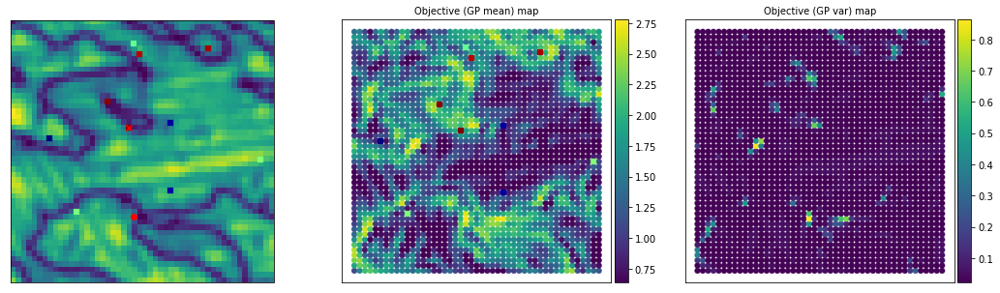

Are you satisfied with current target? (y- yes or press ENTER- No)
Answer: y
Spectral target now fixed. Continue automated BO...


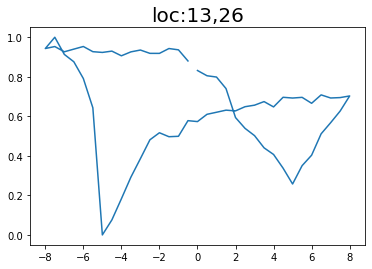

Epoch 1/200 ... Training loss: 6.1454
Epoch 10/200 ... Training loss: 5.292
Epoch 20/200 ... Training loss: 4.7933
Epoch 30/200 ... Training loss: 4.1478
Epoch 40/200 ... Training loss: 3.7136
Epoch 50/200 ... Training loss: 3.4416
Epoch 60/200 ... Training loss: 3.1944
Epoch 70/200 ... Training loss: 3.0138
Epoch 80/200 ... Training loss: 2.8654
Epoch 90/200 ... Training loss: 2.7414
Epoch 100/200 ... Training loss: 2.6369
Epoch 110/200 ... Training loss: 2.5447
Epoch 120/200 ... Training loss: 2.4593
Epoch 130/200 ... Training loss: 2.379
Epoch 140/200 ... Training loss: 2.3005
Epoch 150/200 ... Training loss: 2.2231
Epoch 160/200 ... Training loss: 2.1439
Epoch 170/200 ... Training loss: 2.0686
Epoch 180/200 ... Training loss: 2.0026
Epoch 190/200 ... Training loss: 1.939
Epoch 200/200 ... Training loss: 1.8749
step:  2
Sample #12




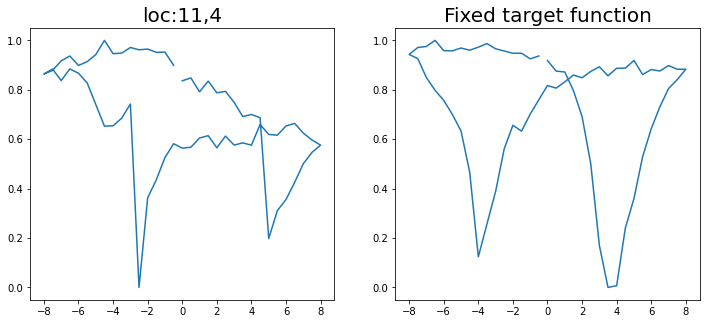

Epoch 1/200 ... Training loss: 6.1364
Epoch 10/200 ... Training loss: 5.2866
Epoch 20/200 ... Training loss: 4.7273
Epoch 30/200 ... Training loss: 3.9907
Epoch 40/200 ... Training loss: 3.4879
Epoch 50/200 ... Training loss: 3.2078
Epoch 60/200 ... Training loss: 3.0321
Epoch 70/200 ... Training loss: 2.8414
Epoch 80/200 ... Training loss: 2.6968
Epoch 90/200 ... Training loss: 2.5672
Epoch 100/200 ... Training loss: 2.4596
Epoch 110/200 ... Training loss: 2.3661
Epoch 120/200 ... Training loss: 2.281
Epoch 130/200 ... Training loss: 2.1954
Epoch 140/200 ... Training loss: 2.1092
Epoch 150/200 ... Training loss: 2.0323
Epoch 160/200 ... Training loss: 1.9627
Epoch 170/200 ... Training loss: 1.8959
Epoch 180/200 ... Training loss: 1.8312
Epoch 190/200 ... Training loss: 1.7682
Epoch 200/200 ... Training loss: 1.7064
step:  3
Sample #13




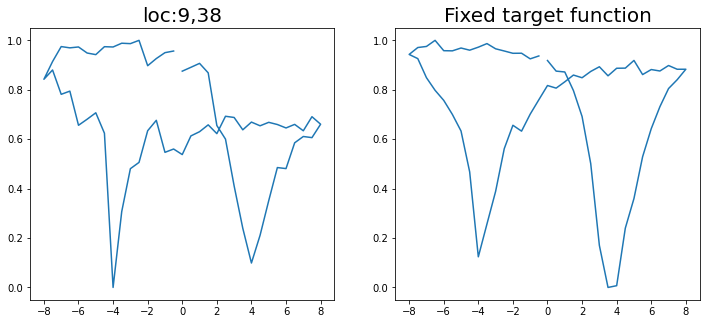

Epoch 1/200 ... Training loss: 5.8035
Epoch 10/200 ... Training loss: 5.0878
Epoch 20/200 ... Training loss: 4.5386
Epoch 30/200 ... Training loss: 4.1207
Epoch 40/200 ... Training loss: 3.6847
Epoch 50/200 ... Training loss: 3.337
Epoch 60/200 ... Training loss: 3.0193
Epoch 70/200 ... Training loss: 2.7963
Epoch 80/200 ... Training loss: 2.6138
Epoch 90/200 ... Training loss: 2.4699
Epoch 100/200 ... Training loss: 2.3676
Epoch 110/200 ... Training loss: 2.2773
Epoch 120/200 ... Training loss: 2.1914
Epoch 130/200 ... Training loss: 2.1112
Epoch 140/200 ... Training loss: 2.038
Epoch 150/200 ... Training loss: 1.9718
Epoch 160/200 ... Training loss: 1.9093
Epoch 170/200 ... Training loss: 1.85
Epoch 180/200 ... Training loss: 1.793
Epoch 190/200 ... Training loss: 1.738
Epoch 200/200 ... Training loss: 1.6841
step:  4
Sample #14




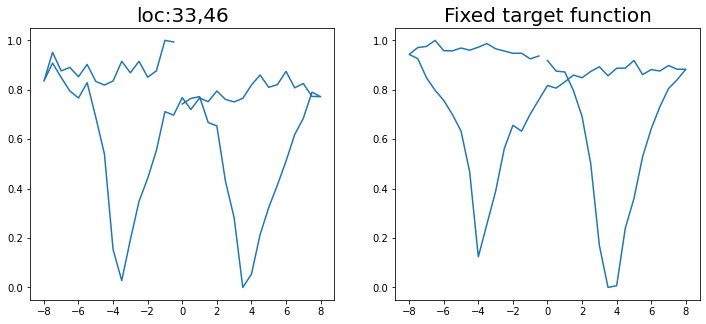

Epoch 1/200 ... Training loss: 5.4687
Epoch 10/200 ... Training loss: 4.7134
Epoch 20/200 ... Training loss: 4.1261
Epoch 30/200 ... Training loss: 3.6571
Epoch 40/200 ... Training loss: 3.2583
Epoch 50/200 ... Training loss: 2.9764
Epoch 60/200 ... Training loss: 2.7717
Epoch 70/200 ... Training loss: 2.5942
Epoch 80/200 ... Training loss: 2.4438
Epoch 90/200 ... Training loss: 2.3231
Epoch 100/200 ... Training loss: 2.2217
Epoch 110/200 ... Training loss: 2.1295
Epoch 120/200 ... Training loss: 2.0419
Epoch 130/200 ... Training loss: 1.9603
Epoch 140/200 ... Training loss: 1.8858
Epoch 150/200 ... Training loss: 1.815
Epoch 160/200 ... Training loss: 1.747
Epoch 170/200 ... Training loss: 1.6809
Epoch 180/200 ... Training loss: 1.6163
Epoch 190/200 ... Training loss: 1.5526
Epoch 200/200 ... Training loss: 1.4896
step:  5
Sample #15




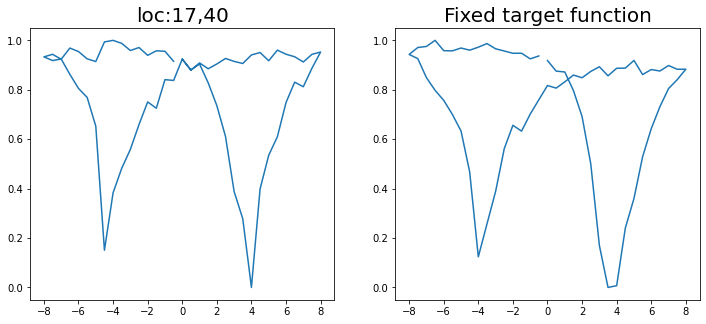

Epoch 1/200 ... Training loss: 5.2705
Epoch 10/200 ... Training loss: 4.6135
Epoch 20/200 ... Training loss: 4.0584
Epoch 30/200 ... Training loss: 3.4428
Epoch 40/200 ... Training loss: 3.062
Epoch 50/200 ... Training loss: 2.7929
Epoch 60/200 ... Training loss: 2.5942
Epoch 70/200 ... Training loss: 2.4494
Epoch 80/200 ... Training loss: 2.3231
Epoch 90/200 ... Training loss: 2.2095
Epoch 100/200 ... Training loss: 2.1075
Epoch 110/200 ... Training loss: 2.0152
Epoch 120/200 ... Training loss: 1.9303
Epoch 130/200 ... Training loss: 1.8511
Epoch 140/200 ... Training loss: 1.7763
Epoch 150/200 ... Training loss: 1.7049
Epoch 160/200 ... Training loss: 1.6359
Epoch 170/200 ... Training loss: 1.5688
Epoch 180/200 ... Training loss: 1.5032
Epoch 190/200 ... Training loss: 1.4383
Epoch 200/200 ... Training loss: 1.3741
step:  6
Sample #16




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


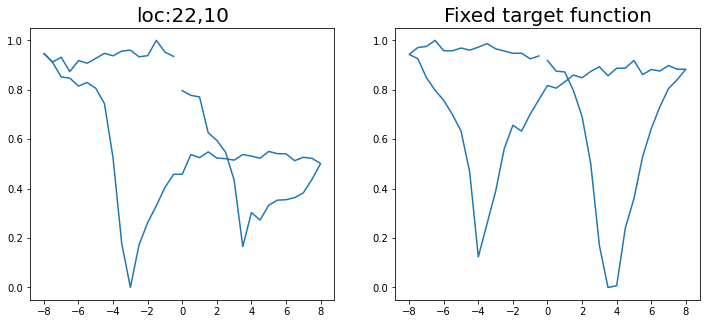

Epoch 1/200 ... Training loss: 5.0227
Epoch 10/200 ... Training loss: 4.4524
Epoch 20/200 ... Training loss: 3.8822
Epoch 30/200 ... Training loss: 3.48
Epoch 40/200 ... Training loss: 3.1241
Epoch 50/200 ... Training loss: 2.8439
Epoch 60/200 ... Training loss: 2.6315
Epoch 70/200 ... Training loss: 2.4631
Epoch 80/200 ... Training loss: 2.3159
Epoch 90/200 ... Training loss: 2.1972
Epoch 100/200 ... Training loss: 2.1063
Epoch 110/200 ... Training loss: 2.0256
Epoch 120/200 ... Training loss: 1.9422
Epoch 130/200 ... Training loss: 1.8642
Epoch 140/200 ... Training loss: 1.7932
Epoch 150/200 ... Training loss: 1.728
Epoch 160/200 ... Training loss: 1.6657
Epoch 170/200 ... Training loss: 1.6056
Epoch 180/200 ... Training loss: 1.5489
Epoch 190/200 ... Training loss: 1.4931
Epoch 200/200 ... Training loss: 1.4331
step:  7
Sample #17




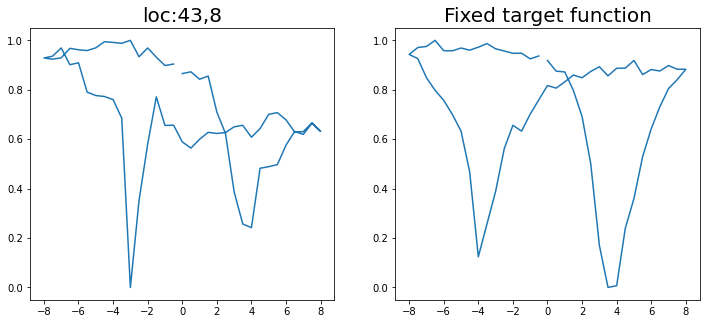

Epoch 1/200 ... Training loss: 4.879
Epoch 10/200 ... Training loss: 4.1182
Epoch 20/200 ... Training loss: 3.5246
Epoch 30/200 ... Training loss: 3.1413
Epoch 40/200 ... Training loss: 2.9704
Epoch 50/200 ... Training loss: 2.767
Epoch 60/200 ... Training loss: 2.5887
Epoch 70/200 ... Training loss: 2.3631
Epoch 80/200 ... Training loss: 2.217
Epoch 90/200 ... Training loss: 2.116
Epoch 100/200 ... Training loss: 2.0233
Epoch 110/200 ... Training loss: 1.9367
Epoch 120/200 ... Training loss: 1.8595
Epoch 130/200 ... Training loss: 1.7866
Epoch 140/200 ... Training loss: 1.7204
Epoch 150/200 ... Training loss: 1.6552
Epoch 160/200 ... Training loss: 1.5944
Epoch 170/200 ... Training loss: 1.5403
Epoch 180/200 ... Training loss: 1.4861
Epoch 190/200 ... Training loss: 1.4321
Epoch 200/200 ... Training loss: 1.3879
step:  8
Sample #18




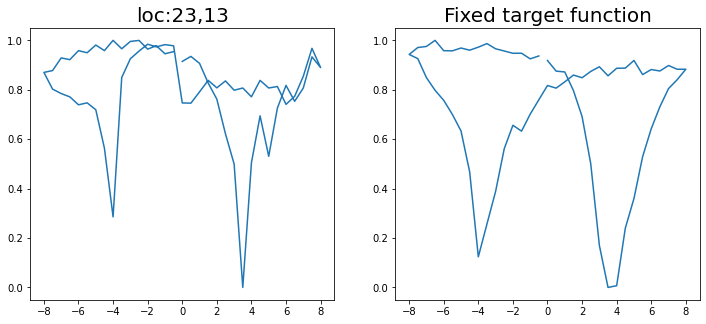

Epoch 1/200 ... Training loss: 4.7434
Epoch 10/200 ... Training loss: 4.0778
Epoch 20/200 ... Training loss: 3.5758
Epoch 30/200 ... Training loss: 3.0841
Epoch 40/200 ... Training loss: 2.8952
Epoch 50/200 ... Training loss: 2.6755
Epoch 60/200 ... Training loss: 2.4542
Epoch 70/200 ... Training loss: 2.2495
Epoch 80/200 ... Training loss: 2.1424
Epoch 90/200 ... Training loss: 2.0458
Epoch 100/200 ... Training loss: 1.9519
Epoch 110/200 ... Training loss: 1.8715
Epoch 120/200 ... Training loss: 1.7989
Epoch 130/200 ... Training loss: 1.7319
Epoch 140/200 ... Training loss: 1.6694
Epoch 150/200 ... Training loss: 1.6109
Epoch 160/200 ... Training loss: 1.5536
Epoch 170/200 ... Training loss: 1.4995
Epoch 180/200 ... Training loss: 1.4481
Epoch 190/200 ... Training loss: 1.409
Epoch 200/200 ... Training loss: 1.3516
step:  9
Sample #19




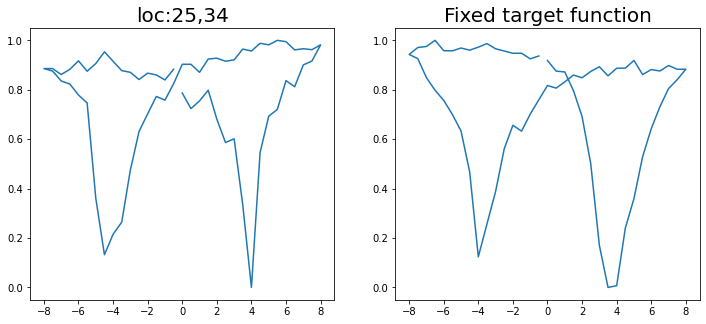

Epoch 1/200 ... Training loss: 4.5437
Epoch 10/200 ... Training loss: 3.9182
Epoch 20/200 ... Training loss: 3.483
Epoch 30/200 ... Training loss: 2.9982
Epoch 40/200 ... Training loss: 2.8274
Epoch 50/200 ... Training loss: 2.6072
Epoch 60/200 ... Training loss: 2.398
Epoch 70/200 ... Training loss: 2.1881
Epoch 80/200 ... Training loss: 2.0777
Epoch 90/200 ... Training loss: 1.9811
Epoch 100/200 ... Training loss: 1.8918
Epoch 110/200 ... Training loss: 1.8137
Epoch 120/200 ... Training loss: 1.7436
Epoch 130/200 ... Training loss: 1.6779
Epoch 140/200 ... Training loss: 1.616
Epoch 150/200 ... Training loss: 1.5561
Epoch 160/200 ... Training loss: 1.5026
Epoch 170/200 ... Training loss: 1.4486
Epoch 180/200 ... Training loss: 1.3957
Epoch 190/200 ... Training loss: 1.3432
Epoch 200/200 ... Training loss: 1.2932
step:  10
Sample #20




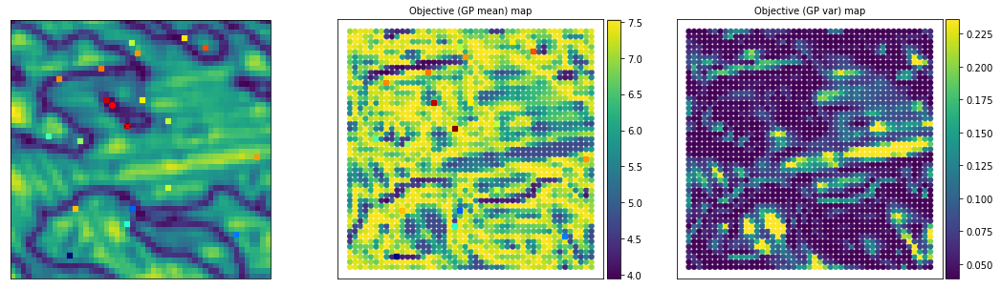

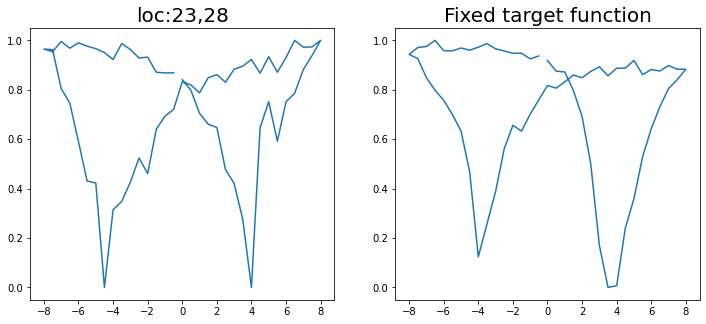

Epoch 1/200 ... Training loss: 4.404
Epoch 10/200 ... Training loss: 3.7564
Epoch 20/200 ... Training loss: 3.3831
Epoch 30/200 ... Training loss: 2.9738
Epoch 40/200 ... Training loss: 2.7258
Epoch 50/200 ... Training loss: 2.5206
Epoch 60/200 ... Training loss: 2.2739
Epoch 70/200 ... Training loss: 2.1211
Epoch 80/200 ... Training loss: 2.0154
Epoch 90/200 ... Training loss: 1.9151
Epoch 100/200 ... Training loss: 1.8288
Epoch 110/200 ... Training loss: 1.7541
Epoch 120/200 ... Training loss: 1.6853
Epoch 130/200 ... Training loss: 1.619
Epoch 140/200 ... Training loss: 1.5608
Epoch 150/200 ... Training loss: 1.4985
Epoch 160/200 ... Training loss: 1.4417
Epoch 170/200 ... Training loss: 1.3856
Epoch 180/200 ... Training loss: 1.3384
Epoch 190/200 ... Training loss: 1.2778
Epoch 200/200 ... Training loss: 1.2399
step:  11
Sample #21




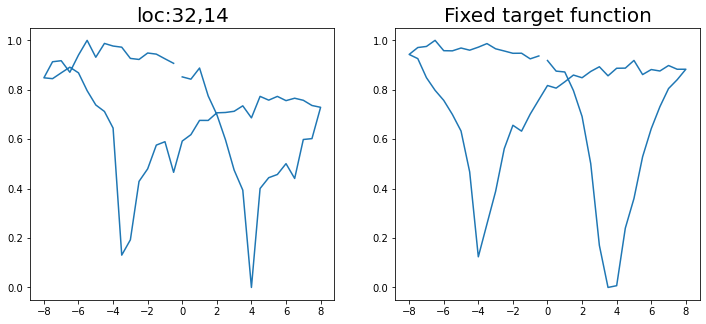

Epoch 1/200 ... Training loss: 4.248
Epoch 10/200 ... Training loss: 3.6469
Epoch 20/200 ... Training loss: 3.3338
Epoch 30/200 ... Training loss: 2.9453
Epoch 40/200 ... Training loss: 2.6964
Epoch 50/200 ... Training loss: 2.5041
Epoch 60/200 ... Training loss: 2.3156
Epoch 70/200 ... Training loss: 2.1533
Epoch 80/200 ... Training loss: 2.0083
Epoch 90/200 ... Training loss: 1.8974
Epoch 100/200 ... Training loss: 1.8112
Epoch 110/200 ... Training loss: 1.7366
Epoch 120/200 ... Training loss: 1.6686
Epoch 130/200 ... Training loss: 1.6053
Epoch 140/200 ... Training loss: 1.5457
Epoch 150/200 ... Training loss: 1.4881
Epoch 160/200 ... Training loss: 1.4383
Epoch 170/200 ... Training loss: 1.3788
Epoch 180/200 ... Training loss: 1.3239
Epoch 190/200 ... Training loss: 1.2707
Epoch 200/200 ... Training loss: 1.2444
step:  12
Sample #22




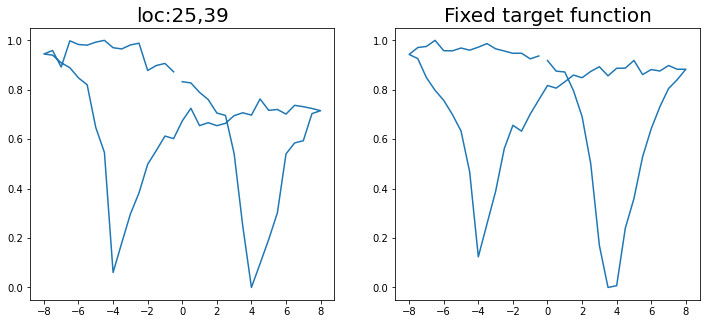

Epoch 1/200 ... Training loss: 4.1041
Epoch 10/200 ... Training loss: 3.6403
Epoch 20/200 ... Training loss: 3.2582
Epoch 30/200 ... Training loss: 2.8636
Epoch 40/200 ... Training loss: 2.5805
Epoch 50/200 ... Training loss: 2.3758
Epoch 60/200 ... Training loss: 2.1919
Epoch 70/200 ... Training loss: 2.0325
Epoch 80/200 ... Training loss: 1.9192
Epoch 90/200 ... Training loss: 1.8221
Epoch 100/200 ... Training loss: 1.7386
Epoch 110/200 ... Training loss: 1.6655
Epoch 120/200 ... Training loss: 1.5984
Epoch 130/200 ... Training loss: 1.5341
Epoch 140/200 ... Training loss: 1.4749
Epoch 150/200 ... Training loss: 1.4145
Epoch 160/200 ... Training loss: 1.3599
Epoch 170/200 ... Training loss: 1.3082
Epoch 180/200 ... Training loss: 1.2518
Epoch 190/200 ... Training loss: 1.2075
Epoch 200/200 ... Training loss: 1.1639
step:  13
Sample #23




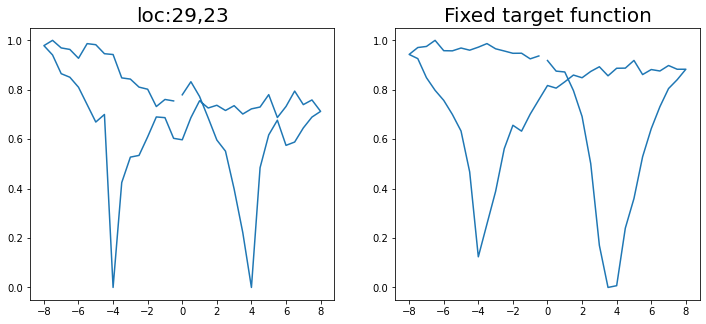

Epoch 1/200 ... Training loss: 3.965
Epoch 10/200 ... Training loss: 3.6992
Epoch 20/200 ... Training loss: 3.1984
Epoch 30/200 ... Training loss: 2.8975
Epoch 40/200 ... Training loss: 2.5826
Epoch 50/200 ... Training loss: 2.3874
Epoch 60/200 ... Training loss: 2.23
Epoch 70/200 ... Training loss: 2.0928
Epoch 80/200 ... Training loss: 1.964
Epoch 90/200 ... Training loss: 1.8421
Epoch 100/200 ... Training loss: 1.7486
Epoch 110/200 ... Training loss: 1.6655
Epoch 120/200 ... Training loss: 1.5962
Epoch 130/200 ... Training loss: 1.5293
Epoch 140/200 ... Training loss: 1.4675
Epoch 150/200 ... Training loss: 1.4065
Epoch 160/200 ... Training loss: 1.3716
Epoch 170/200 ... Training loss: 1.3019
Epoch 180/200 ... Training loss: 1.2344
Epoch 190/200 ... Training loss: 1.1807
Epoch 200/200 ... Training loss: 1.1218
step:  14
Sample #24




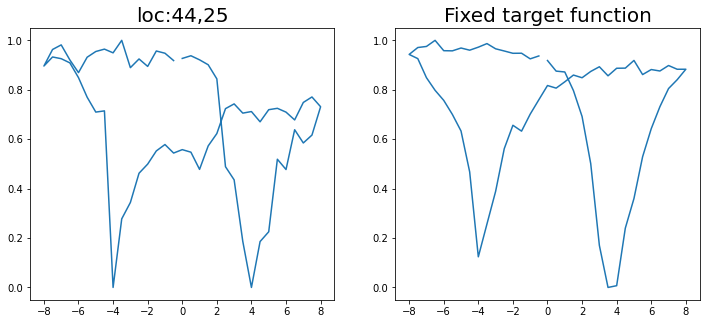

Epoch 1/200 ... Training loss: 3.8589
Epoch 10/200 ... Training loss: 3.4593
Epoch 20/200 ... Training loss: 3.0493
Epoch 30/200 ... Training loss: 2.7112
Epoch 40/200 ... Training loss: 2.4703
Epoch 50/200 ... Training loss: 2.3189
Epoch 60/200 ... Training loss: 2.18
Epoch 70/200 ... Training loss: 2.039
Epoch 80/200 ... Training loss: 1.8843
Epoch 90/200 ... Training loss: 1.7885
Epoch 100/200 ... Training loss: 1.6982
Epoch 110/200 ... Training loss: 1.6251
Epoch 120/200 ... Training loss: 1.5504
Epoch 130/200 ... Training loss: 1.4881
Epoch 140/200 ... Training loss: 1.4279
Epoch 150/200 ... Training loss: 1.3714
Epoch 160/200 ... Training loss: 1.3004
Epoch 170/200 ... Training loss: 1.2407
Epoch 180/200 ... Training loss: 1.2098
Epoch 190/200 ... Training loss: 1.1415
Epoch 200/200 ... Training loss: 1.113
step:  15
Sample #25




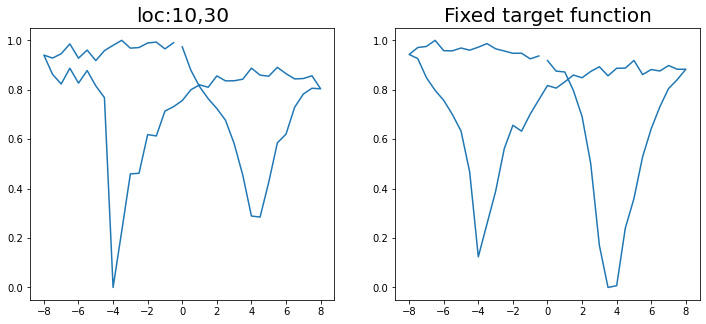

Epoch 1/200 ... Training loss: 3.787
Epoch 10/200 ... Training loss: 3.401
Epoch 20/200 ... Training loss: 3.0331
Epoch 30/200 ... Training loss: 2.7041
Epoch 40/200 ... Training loss: 2.5035
Epoch 50/200 ... Training loss: 2.3054
Epoch 60/200 ... Training loss: 2.184
Epoch 70/200 ... Training loss: 2.0691
Epoch 80/200 ... Training loss: 1.9807
Epoch 90/200 ... Training loss: 1.8352
Epoch 100/200 ... Training loss: 1.7159
Epoch 110/200 ... Training loss: 1.6322
Epoch 120/200 ... Training loss: 1.5547
Epoch 130/200 ... Training loss: 1.4895
Epoch 140/200 ... Training loss: 1.4263
Epoch 150/200 ... Training loss: 1.3632
Epoch 160/200 ... Training loss: 1.301
Epoch 170/200 ... Training loss: 1.2642
Epoch 180/200 ... Training loss: 1.1919
Epoch 190/200 ... Training loss: 1.1272
Epoch 200/200 ... Training loss: 1.0783
step:  16
Sample #26




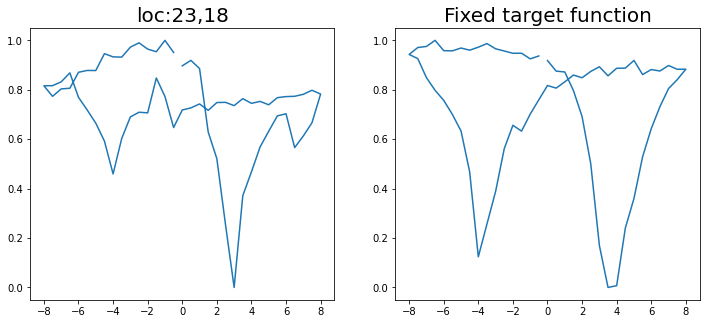

Epoch 1/200 ... Training loss: 3.8603
Epoch 10/200 ... Training loss: 3.3634
Epoch 20/200 ... Training loss: 3.032
Epoch 30/200 ... Training loss: 2.6676
Epoch 40/200 ... Training loss: 2.4479
Epoch 50/200 ... Training loss: 2.2516
Epoch 60/200 ... Training loss: 2.0786
Epoch 70/200 ... Training loss: 1.9476
Epoch 80/200 ... Training loss: 1.811
Epoch 90/200 ... Training loss: 1.7035
Epoch 100/200 ... Training loss: 1.6252
Epoch 110/200 ... Training loss: 1.5524
Epoch 120/200 ... Training loss: 1.4885
Epoch 130/200 ... Training loss: 1.4287
Epoch 140/200 ... Training loss: 1.372
Epoch 150/200 ... Training loss: 1.3178
Epoch 160/200 ... Training loss: 1.271
Epoch 170/200 ... Training loss: 1.2104
Epoch 180/200 ... Training loss: 1.1612
Epoch 190/200 ... Training loss: 1.1114
Epoch 200/200 ... Training loss: 1.074
step:  17
Sample #27




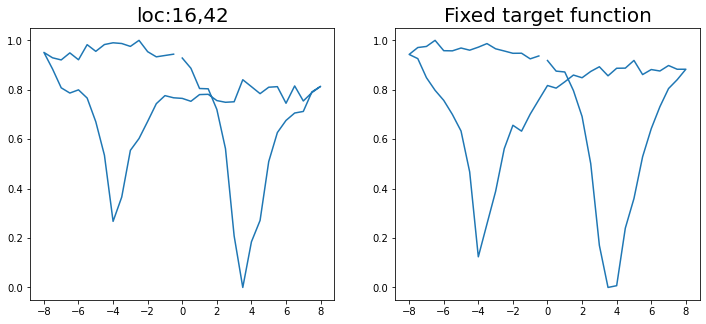

Epoch 1/200 ... Training loss: 3.752
Epoch 10/200 ... Training loss: 3.2924
Epoch 20/200 ... Training loss: 3.045
Epoch 30/200 ... Training loss: 2.5849
Epoch 40/200 ... Training loss: 2.4845
Epoch 50/200 ... Training loss: 2.3567
Epoch 60/200 ... Training loss: 2.2298
Epoch 70/200 ... Training loss: 2.0901
Epoch 80/200 ... Training loss: 1.9355
Epoch 90/200 ... Training loss: 1.7904
Epoch 100/200 ... Training loss: 1.6966
Epoch 110/200 ... Training loss: 1.6088
Epoch 120/200 ... Training loss: 1.5779
Epoch 130/200 ... Training loss: 1.4861
Epoch 140/200 ... Training loss: 1.4255
Epoch 150/200 ... Training loss: 1.3714
Epoch 160/200 ... Training loss: 1.3278
Epoch 170/200 ... Training loss: 1.27
Epoch 180/200 ... Training loss: 1.2391
Epoch 190/200 ... Training loss: 1.173
Epoch 200/200 ... Training loss: 1.1264
step:  18
Sample #28




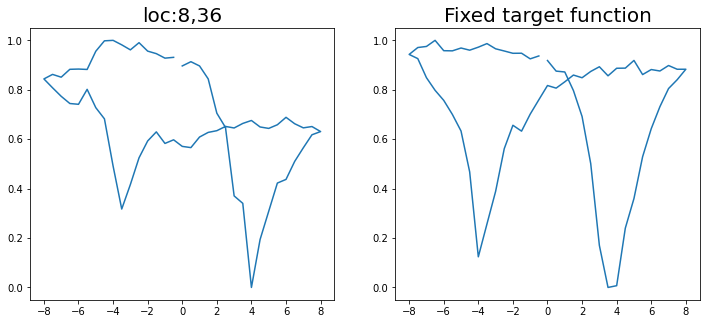

Epoch 1/200 ... Training loss: 3.6457
Epoch 10/200 ... Training loss: 3.4424
Epoch 20/200 ... Training loss: 3.0159
Epoch 30/200 ... Training loss: 2.7035
Epoch 40/200 ... Training loss: 2.4796
Epoch 50/200 ... Training loss: 2.3452
Epoch 60/200 ... Training loss: 2.2335
Epoch 70/200 ... Training loss: 2.123
Epoch 80/200 ... Training loss: 2.0109
Epoch 90/200 ... Training loss: 1.9144
Epoch 100/200 ... Training loss: 1.8082
Epoch 110/200 ... Training loss: 1.7328
Epoch 120/200 ... Training loss: 1.6411
Epoch 130/200 ... Training loss: 1.5382
Epoch 140/200 ... Training loss: 1.4806
Epoch 150/200 ... Training loss: 1.4269
Epoch 160/200 ... Training loss: 1.374
Epoch 170/200 ... Training loss: 1.3168
Epoch 180/200 ... Training loss: 1.2965
Epoch 190/200 ... Training loss: 1.2339
Epoch 200/200 ... Training loss: 1.1645
step:  19
Sample #29




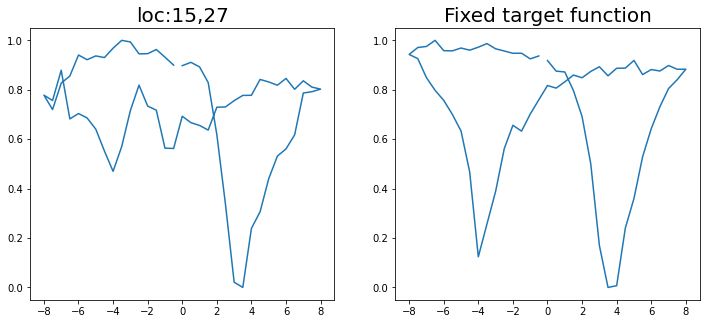

Epoch 1/200 ... Training loss: 3.5531
Epoch 10/200 ... Training loss: 3.2654
Epoch 20/200 ... Training loss: 2.8565
Epoch 30/200 ... Training loss: 2.5974
Epoch 40/200 ... Training loss: 2.3615
Epoch 50/200 ... Training loss: 2.2032
Epoch 60/200 ... Training loss: 2.0698
Epoch 70/200 ... Training loss: 1.9379
Epoch 80/200 ... Training loss: 1.7911
Epoch 90/200 ... Training loss: 1.6533
Epoch 100/200 ... Training loss: 1.5654
Epoch 110/200 ... Training loss: 1.4969
Epoch 120/200 ... Training loss: 1.4329
Epoch 130/200 ... Training loss: 1.3746
Epoch 140/200 ... Training loss: 1.3183
Epoch 150/200 ... Training loss: 1.2626
Epoch 160/200 ... Training loss: 1.2171
Epoch 170/200 ... Training loss: 1.157
Epoch 180/200 ... Training loss: 1.0969
Epoch 190/200 ... Training loss: 1.048
Epoch 200/200 ... Training loss: 1.0006
step:  20
Sample #30




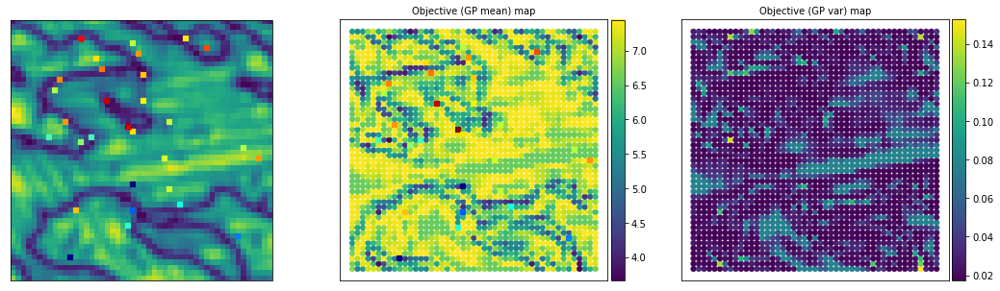

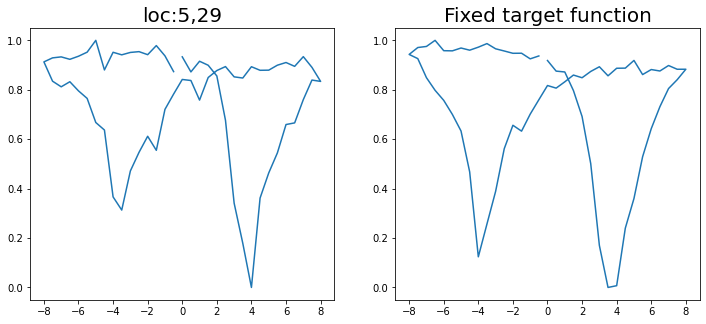

Epoch 1/200 ... Training loss: 3.4837
Epoch 10/200 ... Training loss: 3.0699
Epoch 20/200 ... Training loss: 2.7725
Epoch 30/200 ... Training loss: 2.4597
Epoch 40/200 ... Training loss: 2.2378
Epoch 50/200 ... Training loss: 2.0901
Epoch 60/200 ... Training loss: 1.8454
Epoch 70/200 ... Training loss: 1.6885
Epoch 80/200 ... Training loss: 1.5993
Epoch 90/200 ... Training loss: 1.5201
Epoch 100/200 ... Training loss: 1.4474
Epoch 110/200 ... Training loss: 1.3861
Epoch 120/200 ... Training loss: 1.3148
Epoch 130/200 ... Training loss: 1.2559
Epoch 140/200 ... Training loss: 1.1961
Epoch 150/200 ... Training loss: 1.1456
Epoch 160/200 ... Training loss: 1.0787
Epoch 170/200 ... Training loss: 1.0761
Epoch 180/200 ... Training loss: 0.9812
Epoch 190/200 ... Training loss: 0.9184
Epoch 200/200 ... Training loss: 0.8651
step:  21
Sample #31




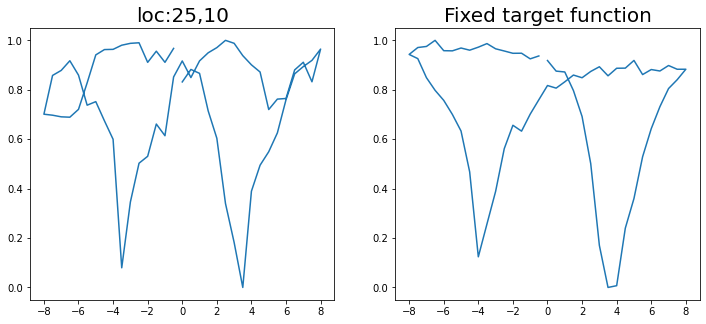

Epoch 1/200 ... Training loss: 3.4754
Epoch 10/200 ... Training loss: 3.0738
Epoch 20/200 ... Training loss: 2.7754
Epoch 30/200 ... Training loss: 2.5136
Epoch 40/200 ... Training loss: 2.3161
Epoch 50/200 ... Training loss: 2.1644
Epoch 60/200 ... Training loss: 1.9882
Epoch 70/200 ... Training loss: 1.7315
Epoch 80/200 ... Training loss: 1.62
Epoch 90/200 ... Training loss: 1.5417
Epoch 100/200 ... Training loss: 1.4755
Epoch 110/200 ... Training loss: 1.4092
Epoch 120/200 ... Training loss: 1.3466
Epoch 130/200 ... Training loss: 1.2856
Epoch 140/200 ... Training loss: 1.2312
Epoch 150/200 ... Training loss: 1.182
Epoch 160/200 ... Training loss: 1.1243
Epoch 170/200 ... Training loss: 1.0691
Epoch 180/200 ... Training loss: 1.0185
Epoch 190/200 ... Training loss: 0.9715
Epoch 200/200 ... Training loss: 0.9313
step:  22
Sample #32




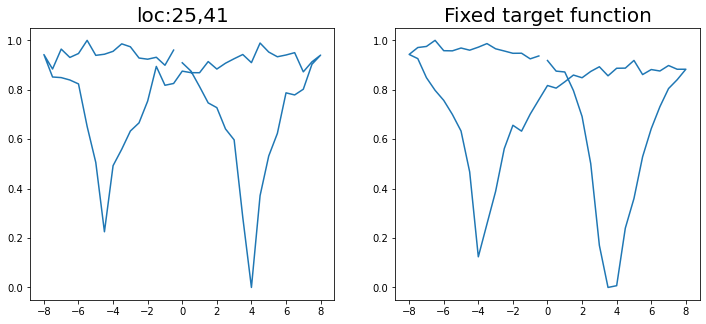

Epoch 1/200 ... Training loss: 3.4095
Epoch 10/200 ... Training loss: 3.0138
Epoch 20/200 ... Training loss: 2.5796
Epoch 30/200 ... Training loss: 2.3165
Epoch 40/200 ... Training loss: 2.1094
Epoch 50/200 ... Training loss: 1.9887
Epoch 60/200 ... Training loss: 1.7577
Epoch 70/200 ... Training loss: 1.6238
Epoch 80/200 ... Training loss: 1.5391
Epoch 90/200 ... Training loss: 1.4606
Epoch 100/200 ... Training loss: 1.3889
Epoch 110/200 ... Training loss: 1.3311
Epoch 120/200 ... Training loss: 1.2612
Epoch 130/200 ... Training loss: 1.1957
Epoch 140/200 ... Training loss: 1.1341
Epoch 150/200 ... Training loss: 1.0808
Epoch 160/200 ... Training loss: 1.0338
Epoch 170/200 ... Training loss: 0.977
Epoch 180/200 ... Training loss: 0.9267
Epoch 190/200 ... Training loss: 0.8969
Epoch 200/200 ... Training loss: 0.8495
step:  23
Sample #33




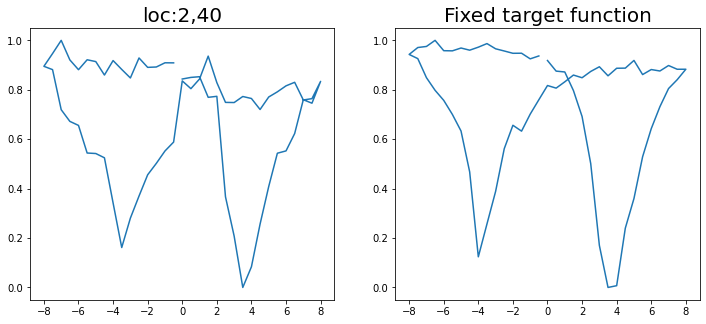

Epoch 1/200 ... Training loss: 3.333
Epoch 10/200 ... Training loss: 2.9717
Epoch 20/200 ... Training loss: 2.7647
Epoch 30/200 ... Training loss: 2.4073
Epoch 40/200 ... Training loss: 2.1841
Epoch 50/200 ... Training loss: 2.0299
Epoch 60/200 ... Training loss: 1.8587
Epoch 70/200 ... Training loss: 1.6689
Epoch 80/200 ... Training loss: 1.5561
Epoch 90/200 ... Training loss: 1.481
Epoch 100/200 ... Training loss: 1.4101
Epoch 110/200 ... Training loss: 1.3462
Epoch 120/200 ... Training loss: 1.2747
Epoch 130/200 ... Training loss: 1.2132
Epoch 140/200 ... Training loss: 1.1546
Epoch 150/200 ... Training loss: 1.0984
Epoch 160/200 ... Training loss: 1.04
Epoch 170/200 ... Training loss: 0.9777
Epoch 180/200 ... Training loss: 0.9452
Epoch 190/200 ... Training loss: 0.8728
Epoch 200/200 ... Training loss: 0.8388
step:  24
Sample #34




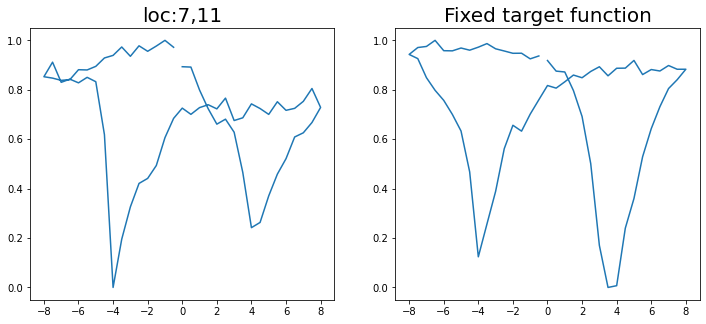

Epoch 1/200 ... Training loss: 3.2683
Epoch 10/200 ... Training loss: 2.9051
Epoch 20/200 ... Training loss: 2.6237
Epoch 30/200 ... Training loss: 2.3774
Epoch 40/200 ... Training loss: 2.211
Epoch 50/200 ... Training loss: 2.0802
Epoch 60/200 ... Training loss: 1.9348
Epoch 70/200 ... Training loss: 1.7401
Epoch 80/200 ... Training loss: 1.5746
Epoch 90/200 ... Training loss: 1.515
Epoch 100/200 ... Training loss: 1.4184
Epoch 110/200 ... Training loss: 1.3515
Epoch 120/200 ... Training loss: 1.2883
Epoch 130/200 ... Training loss: 1.225
Epoch 140/200 ... Training loss: 1.1775
Epoch 150/200 ... Training loss: 1.1108
Epoch 160/200 ... Training loss: 1.0648
Epoch 170/200 ... Training loss: 1.0025
Epoch 180/200 ... Training loss: 0.95
Epoch 190/200 ... Training loss: 0.8921
Epoch 200/200 ... Training loss: 0.8644
step:  25
Sample #35




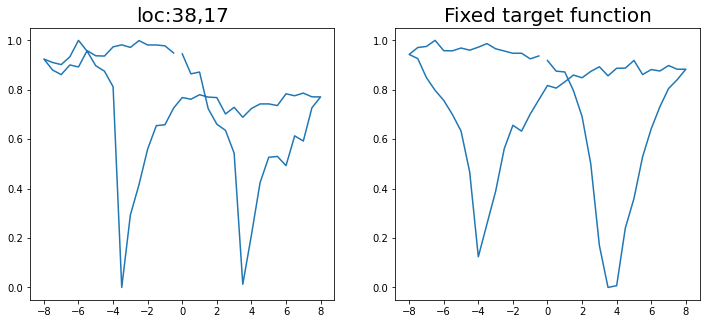

Epoch 1/200 ... Training loss: 3.2182
Epoch 10/200 ... Training loss: 2.6014
Epoch 20/200 ... Training loss: 2.5872
Epoch 30/200 ... Training loss: 2.282
Epoch 40/200 ... Training loss: 2.1579
Epoch 50/200 ... Training loss: 2.0286
Epoch 60/200 ... Training loss: 1.869
Epoch 70/200 ... Training loss: 1.6936
Epoch 80/200 ... Training loss: 1.5672
Epoch 90/200 ... Training loss: 1.4774
Epoch 100/200 ... Training loss: 1.4044
Epoch 110/200 ... Training loss: 1.3355
Epoch 120/200 ... Training loss: 1.2869
Epoch 130/200 ... Training loss: 1.2129
Epoch 140/200 ... Training loss: 1.1744
Epoch 150/200 ... Training loss: 1.1514
Epoch 160/200 ... Training loss: 1.0503
Epoch 170/200 ... Training loss: 0.9898
Epoch 180/200 ... Training loss: 0.9713
Epoch 190/200 ... Training loss: 0.8744
Epoch 200/200 ... Training loss: 0.9732
step:  26
Sample #36




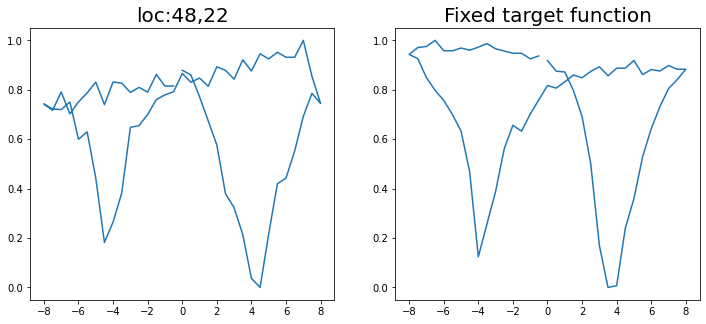

Epoch 1/200 ... Training loss: 3.1553
Epoch 10/200 ... Training loss: 2.8261
Epoch 20/200 ... Training loss: 2.6079
Epoch 30/200 ... Training loss: 2.4114
Epoch 40/200 ... Training loss: 2.2487
Epoch 50/200 ... Training loss: 2.1152
Epoch 60/200 ... Training loss: 2.031
Epoch 70/200 ... Training loss: 1.9412
Epoch 80/200 ... Training loss: 1.8474
Epoch 90/200 ... Training loss: 1.7328
Epoch 100/200 ... Training loss: 1.5425
Epoch 110/200 ... Training loss: 1.4313
Epoch 120/200 ... Training loss: 1.3681
Epoch 130/200 ... Training loss: 1.3096
Epoch 140/200 ... Training loss: 1.247
Epoch 150/200 ... Training loss: 1.1903
Epoch 160/200 ... Training loss: 1.1338
Epoch 170/200 ... Training loss: 1.09
Epoch 180/200 ... Training loss: 1.0279
Epoch 190/200 ... Training loss: 0.9701
Epoch 200/200 ... Training loss: 0.9145
step:  27
Sample #37




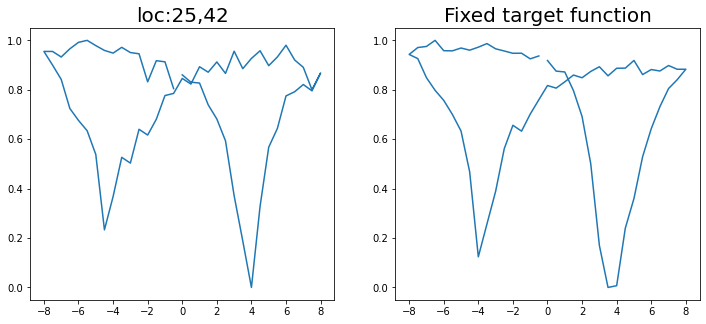

Epoch 1/200 ... Training loss: 3.1103
Epoch 10/200 ... Training loss: 2.6672
Epoch 20/200 ... Training loss: 2.3154
Epoch 30/200 ... Training loss: 2.2102
Epoch 40/200 ... Training loss: 2.0913
Epoch 50/200 ... Training loss: 1.9662
Epoch 60/200 ... Training loss: 1.8191
Epoch 70/200 ... Training loss: 1.6677
Epoch 80/200 ... Training loss: 1.5496
Epoch 90/200 ... Training loss: 1.4389
Epoch 100/200 ... Training loss: 1.3613
Epoch 110/200 ... Training loss: 1.2919
Epoch 120/200 ... Training loss: 1.2242
Epoch 130/200 ... Training loss: 1.1831
Epoch 140/200 ... Training loss: 1.1314
Epoch 150/200 ... Training loss: 1.0473
Epoch 160/200 ... Training loss: 1.002
Epoch 170/200 ... Training loss: 0.9379
Epoch 180/200 ... Training loss: 0.8729
Epoch 190/200 ... Training loss: 1.0632
Epoch 200/200 ... Training loss: 0.839
step:  28
Sample #38




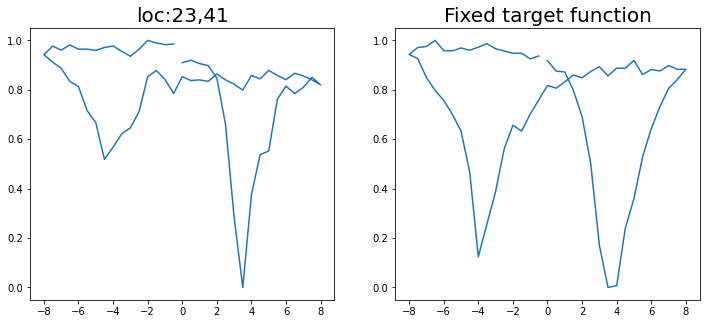

Epoch 1/200 ... Training loss: 3.0529
Epoch 10/200 ... Training loss: 2.5939
Epoch 20/200 ... Training loss: 2.3143
Epoch 30/200 ... Training loss: 2.1625
Epoch 40/200 ... Training loss: 2.039
Epoch 50/200 ... Training loss: 1.9015
Epoch 60/200 ... Training loss: 1.7449
Epoch 70/200 ... Training loss: 1.565
Epoch 80/200 ... Training loss: 1.4585
Epoch 90/200 ... Training loss: 1.3774
Epoch 100/200 ... Training loss: 1.3669
Epoch 110/200 ... Training loss: 1.2636
Epoch 120/200 ... Training loss: 1.1818
Epoch 130/200 ... Training loss: 1.1148
Epoch 140/200 ... Training loss: 1.0574
Epoch 150/200 ... Training loss: 1.0106
Epoch 160/200 ... Training loss: 0.9349
Epoch 170/200 ... Training loss: 0.9237
Epoch 180/200 ... Training loss: 0.8561
Epoch 190/200 ... Training loss: 0.7708
Epoch 200/200 ... Training loss: 0.8018
step:  29
Sample #39




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


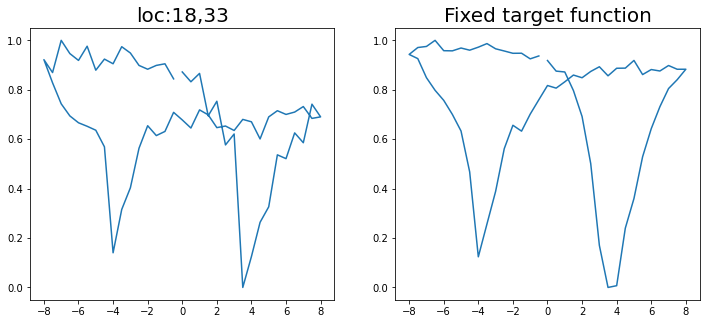

Epoch 1/200 ... Training loss: 2.9939
Epoch 10/200 ... Training loss: 2.8167
Epoch 20/200 ... Training loss: 2.3352
Epoch 30/200 ... Training loss: 2.1414
Epoch 40/200 ... Training loss: 2.0272
Epoch 50/200 ... Training loss: 1.9016
Epoch 60/200 ... Training loss: 1.7628
Epoch 70/200 ... Training loss: 1.5872
Epoch 80/200 ... Training loss: 1.4511
Epoch 90/200 ... Training loss: 1.3801
Epoch 100/200 ... Training loss: 1.2948
Epoch 110/200 ... Training loss: 1.2231
Epoch 120/200 ... Training loss: 1.152
Epoch 130/200 ... Training loss: 1.1006
Epoch 140/200 ... Training loss: 1.0272
Epoch 150/200 ... Training loss: 0.982
Epoch 160/200 ... Training loss: 0.9155
Epoch 170/200 ... Training loss: 0.8517
Epoch 180/200 ... Training loss: 0.8612
Epoch 190/200 ... Training loss: 0.7701
Epoch 200/200 ... Training loss: 0.7068
step:  30
Sample #40




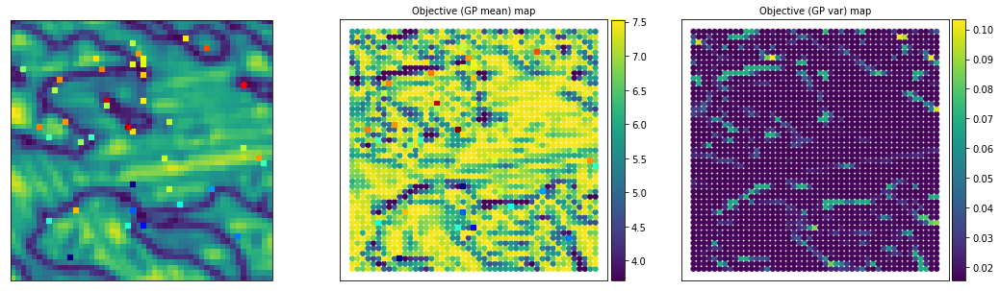

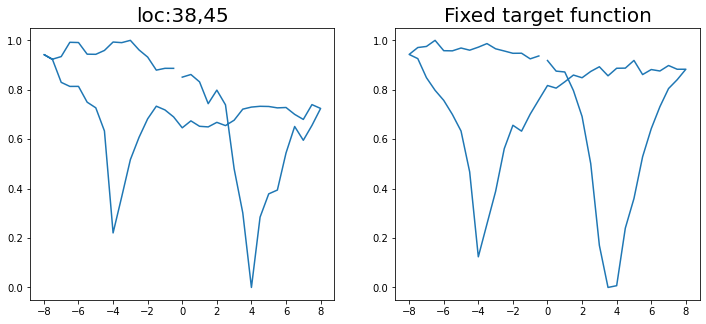

Epoch 1/200 ... Training loss: 2.9418
Epoch 10/200 ... Training loss: 2.6317
Epoch 20/200 ... Training loss: 2.2957
Epoch 30/200 ... Training loss: 2.1022
Epoch 40/200 ... Training loss: 2.0233
Epoch 50/200 ... Training loss: 1.9295
Epoch 60/200 ... Training loss: 1.8357
Epoch 70/200 ... Training loss: 1.7268
Epoch 80/200 ... Training loss: 1.6044
Epoch 90/200 ... Training loss: 1.4433
Epoch 100/200 ... Training loss: 1.3605
Epoch 110/200 ... Training loss: 1.2834
Epoch 120/200 ... Training loss: 1.2116
Epoch 130/200 ... Training loss: 1.1522
Epoch 140/200 ... Training loss: 1.0955
Epoch 150/200 ... Training loss: 1.072
Epoch 160/200 ... Training loss: 0.99
Epoch 170/200 ... Training loss: 0.9485
Epoch 180/200 ... Training loss: 0.8887
Epoch 190/200 ... Training loss: 0.8634
Epoch 200/200 ... Training loss: 0.8326
step:  31
Sample #41




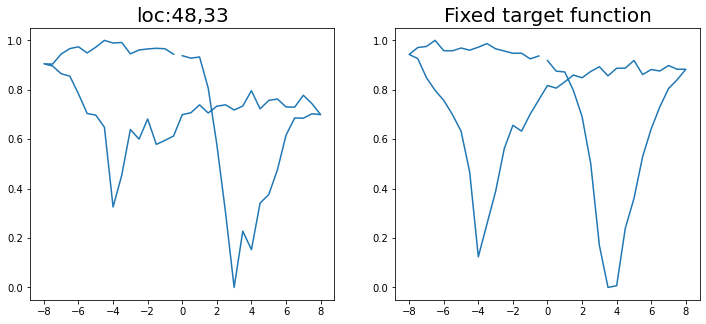

Epoch 1/200 ... Training loss: 2.9318
Epoch 10/200 ... Training loss: 2.5406
Epoch 20/200 ... Training loss: 2.4108
Epoch 30/200 ... Training loss: 2.2209
Epoch 40/200 ... Training loss: 2.061
Epoch 50/200 ... Training loss: 1.9712
Epoch 60/200 ... Training loss: 1.886
Epoch 70/200 ... Training loss: 1.7982
Epoch 80/200 ... Training loss: 1.7049
Epoch 90/200 ... Training loss: 1.6151
Epoch 100/200 ... Training loss: 1.4548
Epoch 110/200 ... Training loss: 1.3749
Epoch 120/200 ... Training loss: 1.2834
Epoch 130/200 ... Training loss: 1.2337
Epoch 140/200 ... Training loss: 1.1742
Epoch 150/200 ... Training loss: 1.1016
Epoch 160/200 ... Training loss: 1.0465
Epoch 170/200 ... Training loss: 1.0035
Epoch 180/200 ... Training loss: 0.9156
Epoch 190/200 ... Training loss: 0.9256
Epoch 200/200 ... Training loss: 0.814
step:  32
Sample #42




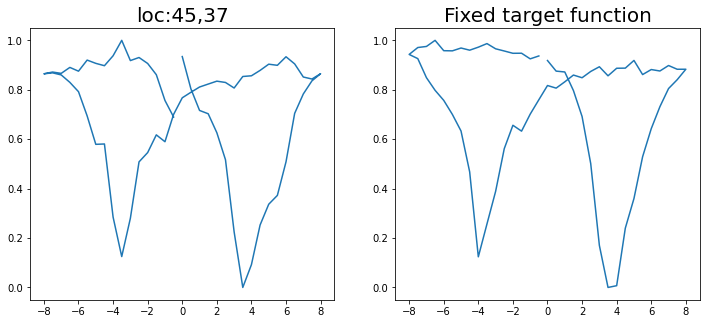

Epoch 1/200 ... Training loss: 2.9034
Epoch 10/200 ... Training loss: 2.6346
Epoch 20/200 ... Training loss: 2.3801
Epoch 30/200 ... Training loss: 2.1468
Epoch 40/200 ... Training loss: 2.0372
Epoch 50/200 ... Training loss: 1.9317
Epoch 60/200 ... Training loss: 1.8246
Epoch 70/200 ... Training loss: 1.6916
Epoch 80/200 ... Training loss: 1.5314
Epoch 90/200 ... Training loss: 1.4346
Epoch 100/200 ... Training loss: 1.3767
Epoch 110/200 ... Training loss: 1.271
Epoch 120/200 ... Training loss: 1.1979
Epoch 130/200 ... Training loss: 1.1351
Epoch 140/200 ... Training loss: 1.0691
Epoch 150/200 ... Training loss: 1.0247
Epoch 160/200 ... Training loss: 0.973
Epoch 170/200 ... Training loss: 0.9073
Epoch 180/200 ... Training loss: 0.8415
Epoch 190/200 ... Training loss: 0.7797
Epoch 200/200 ... Training loss: 0.7343
step:  33
Sample #43




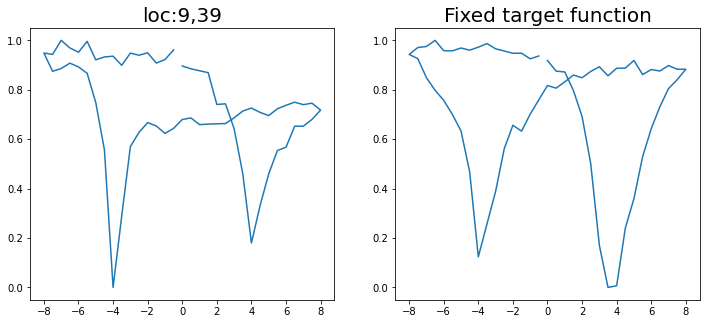

Epoch 1/200 ... Training loss: 2.8545
Epoch 10/200 ... Training loss: 2.5816
Epoch 20/200 ... Training loss: 2.3339
Epoch 30/200 ... Training loss: 2.1477
Epoch 40/200 ... Training loss: 2.0286
Epoch 50/200 ... Training loss: 1.9437
Epoch 60/200 ... Training loss: 1.866
Epoch 70/200 ... Training loss: 1.7992
Epoch 80/200 ... Training loss: 1.7335
Epoch 90/200 ... Training loss: 1.6298
Epoch 100/200 ... Training loss: 1.5295
Epoch 110/200 ... Training loss: 1.4393
Epoch 120/200 ... Training loss: 1.3441
Epoch 130/200 ... Training loss: 1.2603
Epoch 140/200 ... Training loss: 1.1776
Epoch 150/200 ... Training loss: 1.0989
Epoch 160/200 ... Training loss: 1.0292
Epoch 170/200 ... Training loss: 0.967
Epoch 180/200 ... Training loss: 0.9376
Epoch 190/200 ... Training loss: 0.878
Epoch 200/200 ... Training loss: 0.8171
step:  34
Sample #44




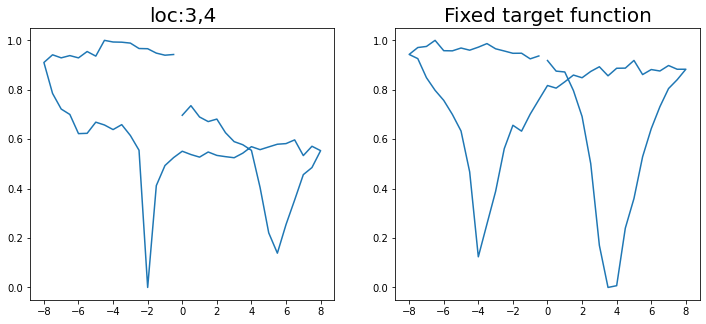

Epoch 1/200 ... Training loss: 2.8978
Epoch 10/200 ... Training loss: 2.527
Epoch 20/200 ... Training loss: 2.4527
Epoch 30/200 ... Training loss: 2.047
Epoch 40/200 ... Training loss: 1.8997
Epoch 50/200 ... Training loss: 1.7695
Epoch 60/200 ... Training loss: 1.6228
Epoch 70/200 ... Training loss: 1.4882
Epoch 80/200 ... Training loss: 1.3829
Epoch 90/200 ... Training loss: 1.303
Epoch 100/200 ... Training loss: 1.2129
Epoch 110/200 ... Training loss: 1.1422
Epoch 120/200 ... Training loss: 1.0762
Epoch 130/200 ... Training loss: 1.1052
Epoch 140/200 ... Training loss: 0.9697
Epoch 150/200 ... Training loss: 0.9073
Epoch 160/200 ... Training loss: 0.8405
Epoch 170/200 ... Training loss: 0.7833
Epoch 180/200 ... Training loss: 0.7528
Epoch 190/200 ... Training loss: 0.6756
Epoch 200/200 ... Training loss: 0.7588
step:  35
Sample #45




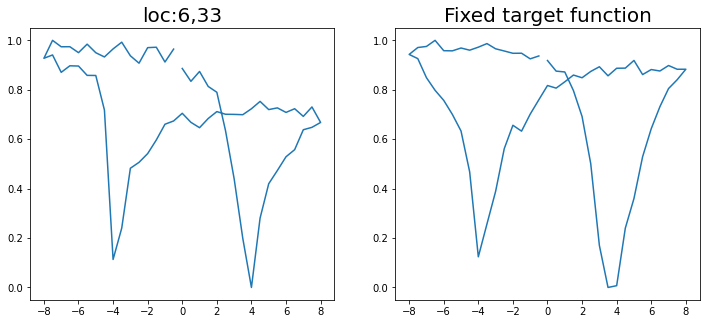

Epoch 1/200 ... Training loss: 2.881
Epoch 10/200 ... Training loss: 2.596
Epoch 20/200 ... Training loss: 2.3395
Epoch 30/200 ... Training loss: 2.0785
Epoch 40/200 ... Training loss: 1.8785
Epoch 50/200 ... Training loss: 1.7392
Epoch 60/200 ... Training loss: 1.6084
Epoch 70/200 ... Training loss: 1.4488
Epoch 80/200 ... Training loss: 1.3544
Epoch 90/200 ... Training loss: 1.28
Epoch 100/200 ... Training loss: 1.2077
Epoch 110/200 ... Training loss: 1.1357
Epoch 120/200 ... Training loss: 1.0776
Epoch 130/200 ... Training loss: 1.0348
Epoch 140/200 ... Training loss: 0.9602
Epoch 150/200 ... Training loss: 0.8963
Epoch 160/200 ... Training loss: 0.8417
Epoch 170/200 ... Training loss: 0.7834
Epoch 180/200 ... Training loss: 0.77
Epoch 190/200 ... Training loss: 0.7055
Epoch 200/200 ... Training loss: 0.6407
step:  36
Sample #46




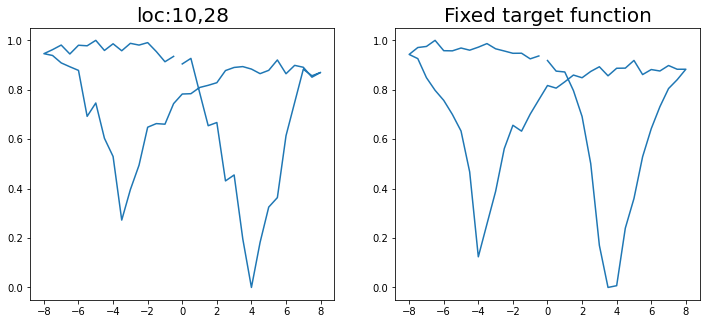

Epoch 1/200 ... Training loss: 2.8465
Epoch 10/200 ... Training loss: 2.5661
Epoch 20/200 ... Training loss: 2.3377
Epoch 30/200 ... Training loss: 2.1987
Epoch 40/200 ... Training loss: 2.0201
Epoch 50/200 ... Training loss: 1.8693
Epoch 60/200 ... Training loss: 1.7565
Epoch 70/200 ... Training loss: 1.6326
Epoch 80/200 ... Training loss: 1.4927
Epoch 90/200 ... Training loss: 1.3559
Epoch 100/200 ... Training loss: 1.2678
Epoch 110/200 ... Training loss: 1.1979
Epoch 120/200 ... Training loss: 1.1352
Epoch 130/200 ... Training loss: 1.0797
Epoch 140/200 ... Training loss: 1.0123
Epoch 150/200 ... Training loss: 0.9537
Epoch 160/200 ... Training loss: 0.8947
Epoch 170/200 ... Training loss: 0.836
Epoch 180/200 ... Training loss: 0.8551
Epoch 190/200 ... Training loss: 0.7722
Epoch 200/200 ... Training loss: 0.6974
step:  37
Sample #47




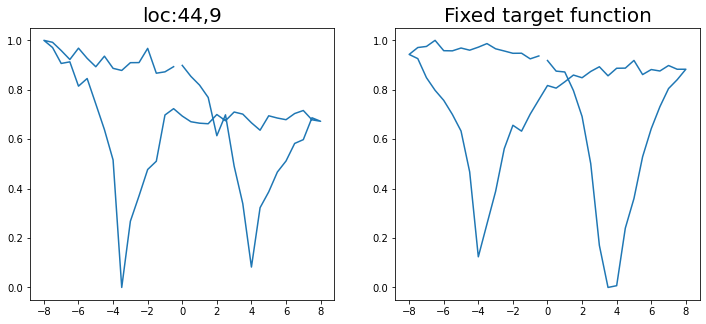

Epoch 1/200 ... Training loss: 2.8092
Epoch 10/200 ... Training loss: 2.523
Epoch 20/200 ... Training loss: 2.253
Epoch 30/200 ... Training loss: 2.065
Epoch 40/200 ... Training loss: 1.8551
Epoch 50/200 ... Training loss: 1.7154
Epoch 60/200 ... Training loss: 1.5479
Epoch 70/200 ... Training loss: 1.4199
Epoch 80/200 ... Training loss: 1.343
Epoch 90/200 ... Training loss: 1.2573
Epoch 100/200 ... Training loss: 1.1827
Epoch 110/200 ... Training loss: 1.1165
Epoch 120/200 ... Training loss: 1.0589
Epoch 130/200 ... Training loss: 0.9893
Epoch 140/200 ... Training loss: 0.944
Epoch 150/200 ... Training loss: 0.89
Epoch 160/200 ... Training loss: 0.8727
Epoch 170/200 ... Training loss: 0.7915
Epoch 180/200 ... Training loss: 0.7287
Epoch 190/200 ... Training loss: 0.7918
Epoch 200/200 ... Training loss: 0.7247
step:  38
Sample #48




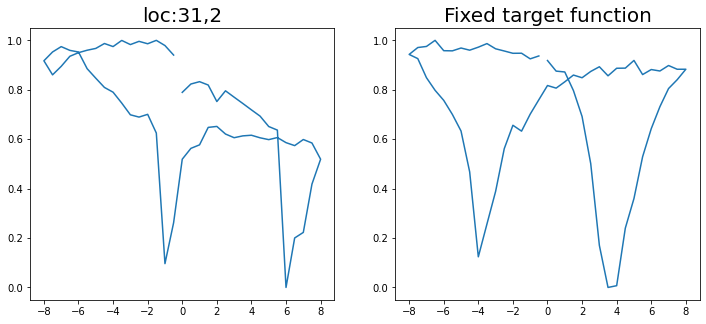

Epoch 1/200 ... Training loss: 2.9655
Epoch 10/200 ... Training loss: 2.6879
Epoch 20/200 ... Training loss: 2.4659
Epoch 30/200 ... Training loss: 2.286
Epoch 40/200 ... Training loss: 2.1687
Epoch 50/200 ... Training loss: 2.0885
Epoch 60/200 ... Training loss: 1.9884
Epoch 70/200 ... Training loss: 1.7957
Epoch 80/200 ... Training loss: 1.6053
Epoch 90/200 ... Training loss: 1.476
Epoch 100/200 ... Training loss: 1.5346
Epoch 110/200 ... Training loss: 1.3654
Epoch 120/200 ... Training loss: 1.2764
Epoch 130/200 ... Training loss: 1.2204
Epoch 140/200 ... Training loss: 1.1659
Epoch 150/200 ... Training loss: 1.1113
Epoch 160/200 ... Training loss: 1.0826
Epoch 170/200 ... Training loss: 1.0438
Epoch 180/200 ... Training loss: 0.9773
Epoch 190/200 ... Training loss: 0.9247
Epoch 200/200 ... Training loss: 0.9764
step:  39
Sample #49




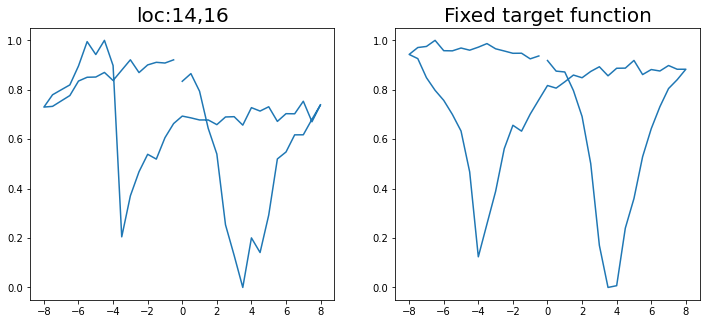

Epoch 1/200 ... Training loss: 2.9388
Epoch 10/200 ... Training loss: 2.7371
Epoch 20/200 ... Training loss: 2.5468
Epoch 30/200 ... Training loss: 2.3825
Epoch 40/200 ... Training loss: 2.2304
Epoch 50/200 ... Training loss: 2.1418
Epoch 60/200 ... Training loss: 2.0648
Epoch 70/200 ... Training loss: 1.9989
Epoch 80/200 ... Training loss: 1.9217
Epoch 90/200 ... Training loss: 1.7955
Epoch 100/200 ... Training loss: 1.6617
Epoch 110/200 ... Training loss: 1.51
Epoch 120/200 ... Training loss: 1.3998
Epoch 130/200 ... Training loss: 1.3542
Epoch 140/200 ... Training loss: 1.2869
Epoch 150/200 ... Training loss: 1.2276
Epoch 160/200 ... Training loss: 1.3164
Epoch 170/200 ... Training loss: 1.1723
Epoch 180/200 ... Training loss: 1.1124
Epoch 190/200 ... Training loss: 1.0566
Epoch 200/200 ... Training loss: 1.0097
step:  40
Sample #50




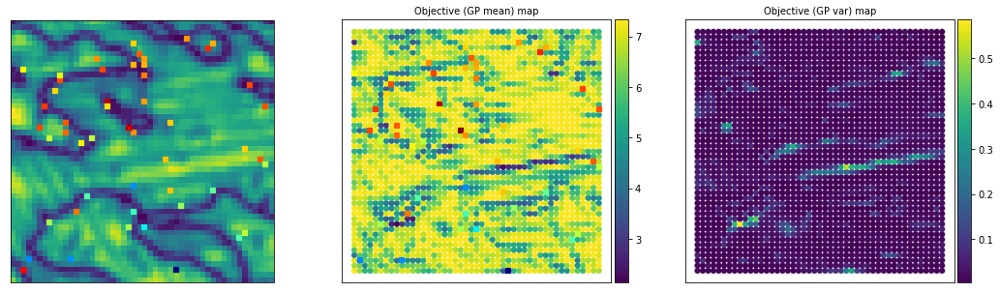

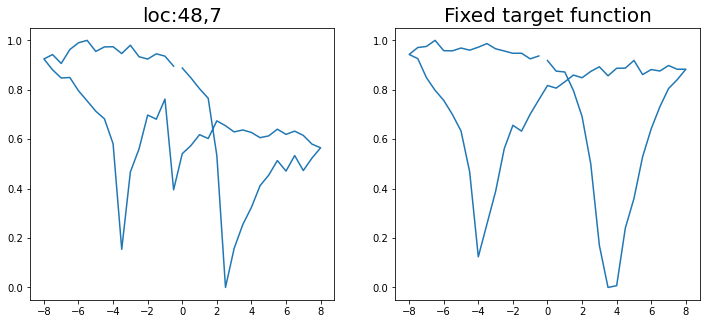

Epoch 1/200 ... Training loss: 2.9097
Epoch 10/200 ... Training loss: 2.6441
Epoch 20/200 ... Training loss: 2.4096
Epoch 30/200 ... Training loss: 2.2538
Epoch 40/200 ... Training loss: 2.1446
Epoch 50/200 ... Training loss: 2.049
Epoch 60/200 ... Training loss: 1.8918
Epoch 70/200 ... Training loss: 1.6976
Epoch 80/200 ... Training loss: 1.4952
Epoch 90/200 ... Training loss: 1.539
Epoch 100/200 ... Training loss: 1.3567
Epoch 110/200 ... Training loss: 1.2821
Epoch 120/200 ... Training loss: 1.2472
Epoch 130/200 ... Training loss: 1.1681
Epoch 140/200 ... Training loss: 1.1316
Epoch 150/200 ... Training loss: 1.0916
Epoch 160/200 ... Training loss: 1.0682
Epoch 170/200 ... Training loss: 1.0096
Epoch 180/200 ... Training loss: 0.9472
Epoch 190/200 ... Training loss: 0.9139
Epoch 200/200 ... Training loss: 0.8533
step:  41
Sample #51




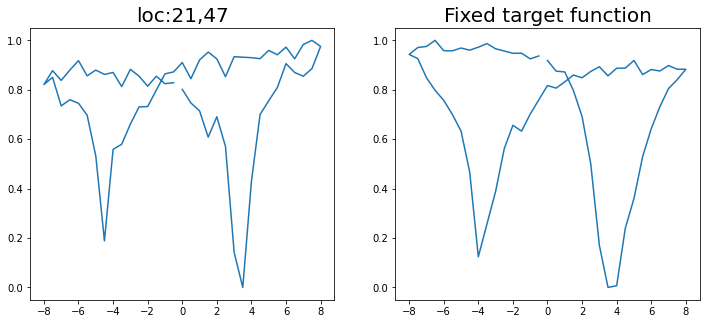

Epoch 1/200 ... Training loss: 2.8676
Epoch 10/200 ... Training loss: 2.6099
Epoch 20/200 ... Training loss: 2.3865
Epoch 30/200 ... Training loss: 2.2304
Epoch 40/200 ... Training loss: 2.1192
Epoch 50/200 ... Training loss: 2.0242
Epoch 60/200 ... Training loss: 1.8699
Epoch 70/200 ... Training loss: 1.6806
Epoch 80/200 ... Training loss: 1.6956
Epoch 90/200 ... Training loss: 1.4575
Epoch 100/200 ... Training loss: 1.3666
Epoch 110/200 ... Training loss: 1.3317
Epoch 120/200 ... Training loss: 1.2466
Epoch 130/200 ... Training loss: 1.1777
Epoch 140/200 ... Training loss: 1.1117
Epoch 150/200 ... Training loss: 1.0605
Epoch 160/200 ... Training loss: 1.0187
Epoch 170/200 ... Training loss: 0.968
Epoch 180/200 ... Training loss: 0.9088
Epoch 190/200 ... Training loss: 0.8756
Epoch 200/200 ... Training loss: 0.9255
step:  42
Sample #52




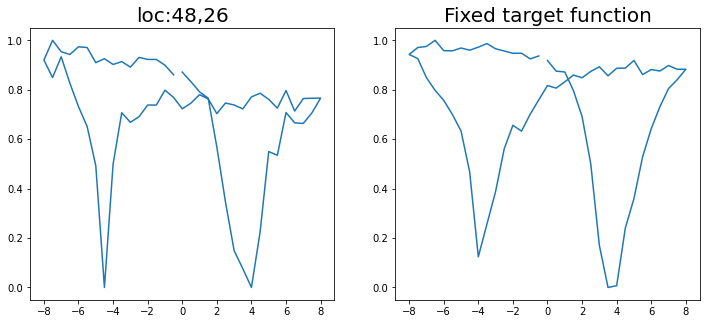

Epoch 1/200 ... Training loss: 2.8273
Epoch 10/200 ... Training loss: 2.5764
Epoch 20/200 ... Training loss: 2.3396
Epoch 30/200 ... Training loss: 2.2072
Epoch 40/200 ... Training loss: 2.0937
Epoch 50/200 ... Training loss: 2.0112
Epoch 60/200 ... Training loss: 1.8733
Epoch 70/200 ... Training loss: 1.6181
Epoch 80/200 ... Training loss: 1.5251
Epoch 90/200 ... Training loss: 1.4278
Epoch 100/200 ... Training loss: 1.3467
Epoch 110/200 ... Training loss: 1.3038
Epoch 120/200 ... Training loss: 1.2543
Epoch 130/200 ... Training loss: 1.2034
Epoch 140/200 ... Training loss: 1.2644
Epoch 150/200 ... Training loss: 1.1146
Epoch 160/200 ... Training loss: 1.0411
Epoch 170/200 ... Training loss: 0.9846
Epoch 180/200 ... Training loss: 0.9332
Epoch 190/200 ... Training loss: 0.8904
Epoch 200/200 ... Training loss: 1.206
step:  43
Sample #53




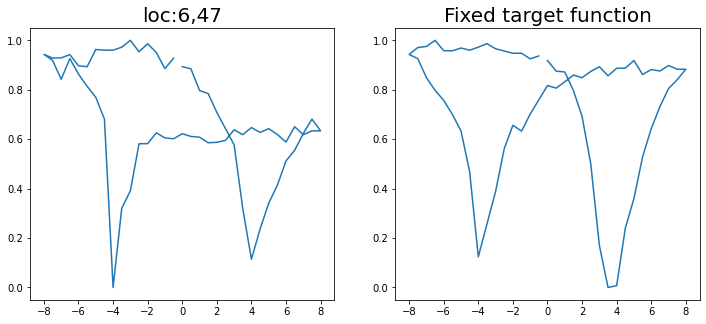

Epoch 1/200 ... Training loss: 2.7907
Epoch 10/200 ... Training loss: 2.5455
Epoch 20/200 ... Training loss: 2.3591
Epoch 30/200 ... Training loss: 2.1849
Epoch 40/200 ... Training loss: 2.0873
Epoch 50/200 ... Training loss: 1.992
Epoch 60/200 ... Training loss: 1.8354
Epoch 70/200 ... Training loss: 1.6553
Epoch 80/200 ... Training loss: 1.5564
Epoch 90/200 ... Training loss: 1.5067
Epoch 100/200 ... Training loss: 1.3914
Epoch 110/200 ... Training loss: 1.2966
Epoch 120/200 ... Training loss: 1.2291
Epoch 130/200 ... Training loss: 1.1723
Epoch 140/200 ... Training loss: 1.2982
Epoch 150/200 ... Training loss: 1.1787
Epoch 160/200 ... Training loss: 1.0674
Epoch 170/200 ... Training loss: 0.9998
Epoch 180/200 ... Training loss: 0.9625
Epoch 190/200 ... Training loss: 0.9383
Epoch 200/200 ... Training loss: 0.8634
step:  44
Sample #54




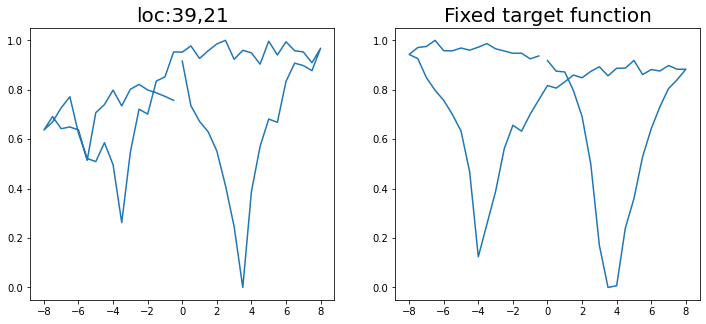

Epoch 1/200 ... Training loss: 2.7688
Epoch 10/200 ... Training loss: 2.3986
Epoch 20/200 ... Training loss: 2.3144
Epoch 30/200 ... Training loss: 2.1449
Epoch 40/200 ... Training loss: 2.0509
Epoch 50/200 ... Training loss: 1.9427
Epoch 60/200 ... Training loss: 1.8097
Epoch 70/200 ... Training loss: 1.644
Epoch 80/200 ... Training loss: 1.5047
Epoch 90/200 ... Training loss: 1.3964
Epoch 100/200 ... Training loss: 1.3095
Epoch 110/200 ... Training loss: 1.2414
Epoch 120/200 ... Training loss: 1.2005
Epoch 130/200 ... Training loss: 1.1402
Epoch 140/200 ... Training loss: 1.0698
Epoch 150/200 ... Training loss: 1.0008
Epoch 160/200 ... Training loss: 0.992
Epoch 170/200 ... Training loss: 0.9351
Epoch 180/200 ... Training loss: 0.8762
Epoch 190/200 ... Training loss: 0.8566
Epoch 200/200 ... Training loss: 0.8273
step:  45
Sample #55




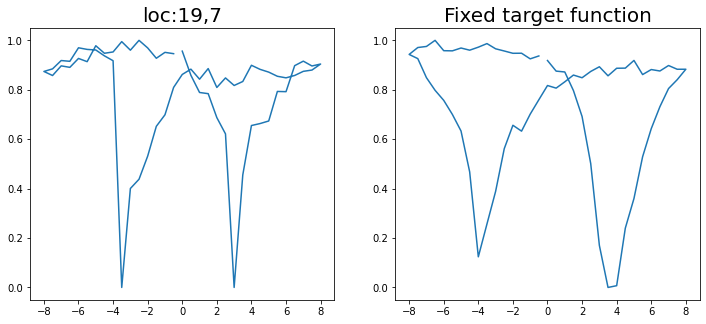

Epoch 1/200 ... Training loss: 2.7506
Epoch 10/200 ... Training loss: 2.4567
Epoch 20/200 ... Training loss: 2.246
Epoch 30/200 ... Training loss: 2.1242
Epoch 40/200 ... Training loss: 1.9958
Epoch 50/200 ... Training loss: 1.794
Epoch 60/200 ... Training loss: 1.5857
Epoch 70/200 ... Training loss: 1.5352
Epoch 80/200 ... Training loss: 1.3856
Epoch 90/200 ... Training loss: 1.4799
Epoch 100/200 ... Training loss: 1.4031
Epoch 110/200 ... Training loss: 1.2746
Epoch 120/200 ... Training loss: 1.1796
Epoch 130/200 ... Training loss: 1.1219
Epoch 140/200 ... Training loss: 1.1246
Epoch 150/200 ... Training loss: 1.0126
Epoch 160/200 ... Training loss: 0.9401
Epoch 170/200 ... Training loss: 0.8798
Epoch 180/200 ... Training loss: 0.8854
Epoch 190/200 ... Training loss: 0.7881
Epoch 200/200 ... Training loss: 0.7385
step:  46
Sample #56




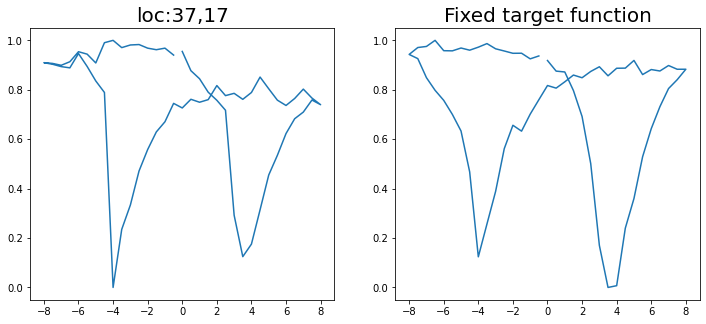

Epoch 1/200 ... Training loss: 2.7219
Epoch 10/200 ... Training loss: 2.4681
Epoch 20/200 ... Training loss: 2.2415
Epoch 30/200 ... Training loss: 2.1273
Epoch 40/200 ... Training loss: 2.0326
Epoch 50/200 ... Training loss: 1.9452
Epoch 60/200 ... Training loss: 1.8354
Epoch 70/200 ... Training loss: 1.6679
Epoch 80/200 ... Training loss: 1.5418
Epoch 90/200 ... Training loss: 1.3792
Epoch 100/200 ... Training loss: 1.3768
Epoch 110/200 ... Training loss: 1.2663
Epoch 120/200 ... Training loss: 1.1955
Epoch 130/200 ... Training loss: 1.2474
Epoch 140/200 ... Training loss: 1.0938
Epoch 150/200 ... Training loss: 1.0244
Epoch 160/200 ... Training loss: 1.0266
Epoch 170/200 ... Training loss: 0.9672
Epoch 180/200 ... Training loss: 0.8838
Epoch 190/200 ... Training loss: 0.8329
Epoch 200/200 ... Training loss: 0.7926
step:  47
Sample #57




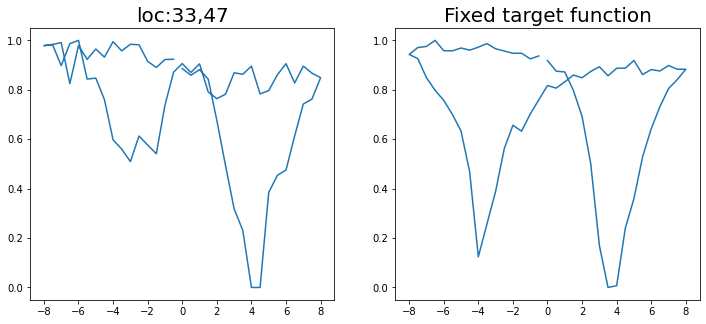

Epoch 1/200 ... Training loss: 2.6985
Epoch 10/200 ... Training loss: 2.4556
Epoch 20/200 ... Training loss: 2.2914
Epoch 30/200 ... Training loss: 2.1537
Epoch 40/200 ... Training loss: 2.0553
Epoch 50/200 ... Training loss: 1.9846
Epoch 60/200 ... Training loss: 1.9154
Epoch 70/200 ... Training loss: 1.8062
Epoch 80/200 ... Training loss: 1.641
Epoch 90/200 ... Training loss: 1.5054
Epoch 100/200 ... Training loss: 1.4637
Epoch 110/200 ... Training loss: 1.3195
Epoch 120/200 ... Training loss: 1.252
Epoch 130/200 ... Training loss: 1.2276
Epoch 140/200 ... Training loss: 1.1437
Epoch 150/200 ... Training loss: 1.0887
Epoch 160/200 ... Training loss: 1.1138
Epoch 170/200 ... Training loss: 1.0392
Epoch 180/200 ... Training loss: 0.9579
Epoch 190/200 ... Training loss: 0.9293
Epoch 200/200 ... Training loss: 0.8622
step:  48
Sample #58




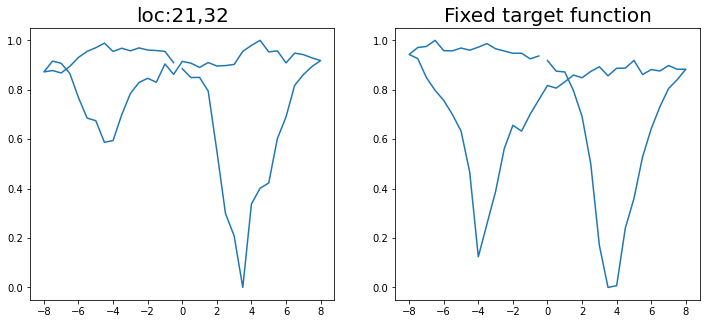

Epoch 1/200 ... Training loss: 2.665
Epoch 10/200 ... Training loss: 2.4188
Epoch 20/200 ... Training loss: 2.2379
Epoch 30/200 ... Training loss: 2.0993
Epoch 40/200 ... Training loss: 2.0132
Epoch 50/200 ... Training loss: 1.9045
Epoch 60/200 ... Training loss: 1.714
Epoch 70/200 ... Training loss: 1.5541
Epoch 80/200 ... Training loss: 1.5611
Epoch 90/200 ... Training loss: 1.3964
Epoch 100/200 ... Training loss: 1.313
Epoch 110/200 ... Training loss: 1.234
Epoch 120/200 ... Training loss: 1.2886
Epoch 130/200 ... Training loss: 1.2767
Epoch 140/200 ... Training loss: 1.1262
Epoch 150/200 ... Training loss: 1.0725
Epoch 160/200 ... Training loss: 0.9646
Epoch 170/200 ... Training loss: 0.9276
Epoch 180/200 ... Training loss: 1.0998
Epoch 190/200 ... Training loss: 0.9039
Epoch 200/200 ... Training loss: 0.836
step:  49
Sample #59




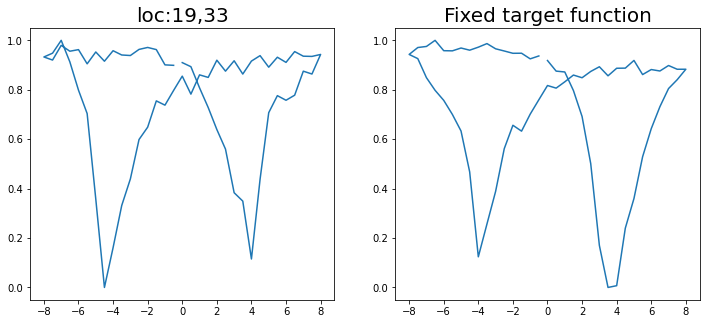

Epoch 1/200 ... Training loss: 2.6364
Epoch 10/200 ... Training loss: 2.4002
Epoch 20/200 ... Training loss: 2.2483
Epoch 30/200 ... Training loss: 2.0885
Epoch 40/200 ... Training loss: 2.0028
Epoch 50/200 ... Training loss: 1.9223
Epoch 60/200 ... Training loss: 1.8032
Epoch 70/200 ... Training loss: 1.637
Epoch 80/200 ... Training loss: 1.5431
Epoch 90/200 ... Training loss: 1.497
Epoch 100/200 ... Training loss: 1.349
Epoch 110/200 ... Training loss: 1.2764
Epoch 120/200 ... Training loss: 1.1863
Epoch 130/200 ... Training loss: 1.1667
Epoch 140/200 ... Training loss: 1.1017
Epoch 150/200 ... Training loss: 1.0259
Epoch 160/200 ... Training loss: 0.9958
Epoch 170/200 ... Training loss: 0.9369
Epoch 180/200 ... Training loss: 0.8541
Epoch 190/200 ... Training loss: 0.8043
Epoch 200/200 ... Training loss: 0.7641
step:  50
Sample #60




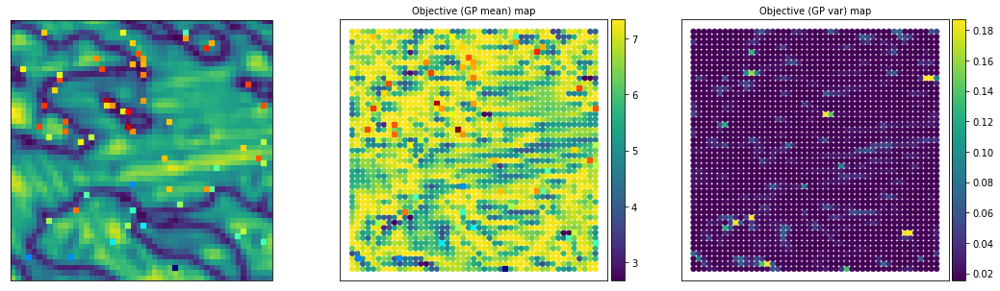

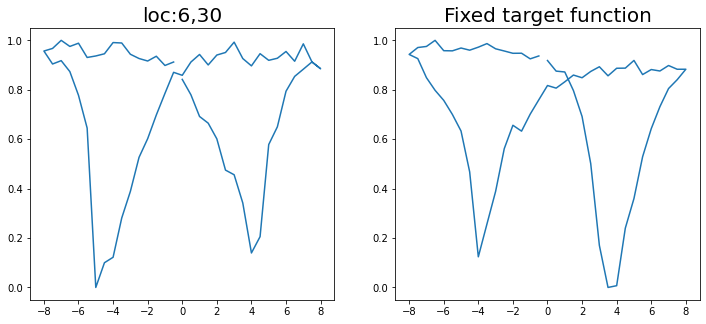

Epoch 1/200 ... Training loss: 2.6288
Epoch 10/200 ... Training loss: 2.3637
Epoch 20/200 ... Training loss: 2.1556
Epoch 30/200 ... Training loss: 2.0608
Epoch 40/200 ... Training loss: 1.9541
Epoch 50/200 ... Training loss: 1.7831
Epoch 60/200 ... Training loss: 1.6202
Epoch 70/200 ... Training loss: 1.4759
Epoch 80/200 ... Training loss: 1.3691
Epoch 90/200 ... Training loss: 1.2983
Epoch 100/200 ... Training loss: 1.2927
Epoch 110/200 ... Training loss: 1.2051
Epoch 120/200 ... Training loss: 1.1461
Epoch 130/200 ... Training loss: 1.1061
Epoch 140/200 ... Training loss: 1.0466
Epoch 150/200 ... Training loss: 1.0014
Epoch 160/200 ... Training loss: 0.9438
Epoch 170/200 ... Training loss: 0.8726
Epoch 180/200 ... Training loss: 0.8015
Epoch 190/200 ... Training loss: 0.7358
Epoch 200/200 ... Training loss: 0.6948
step:  51
Sample #61




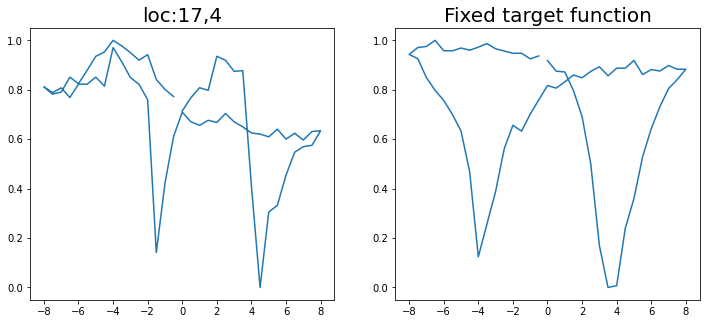

Epoch 1/200 ... Training loss: 2.7924
Epoch 10/200 ... Training loss: 2.5368
Epoch 20/200 ... Training loss: 2.3421
Epoch 30/200 ... Training loss: 2.1814
Epoch 40/200 ... Training loss: 2.0417
Epoch 50/200 ... Training loss: 1.9497
Epoch 60/200 ... Training loss: 1.8308
Epoch 70/200 ... Training loss: 1.7343
Epoch 80/200 ... Training loss: 1.5972
Epoch 90/200 ... Training loss: 1.43
Epoch 100/200 ... Training loss: 1.3321
Epoch 110/200 ... Training loss: 1.2821
Epoch 120/200 ... Training loss: 1.2389
Epoch 130/200 ... Training loss: 1.1574
Epoch 140/200 ... Training loss: 1.1038
Epoch 150/200 ... Training loss: 1.0567
Epoch 160/200 ... Training loss: 1.0415
Epoch 170/200 ... Training loss: 1.0552
Epoch 180/200 ... Training loss: 0.9506
Epoch 190/200 ... Training loss: 0.8853
Epoch 200/200 ... Training loss: 0.8533
step:  52
Sample #62




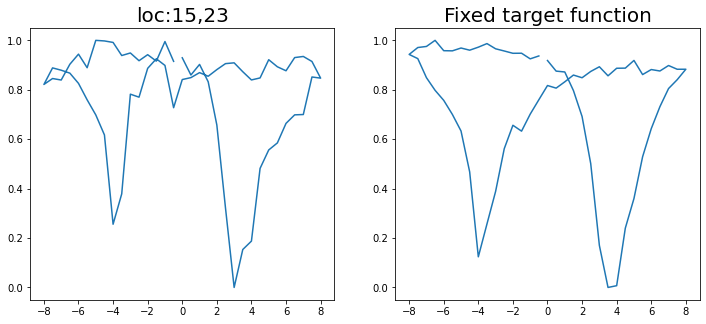

Epoch 1/200 ... Training loss: 2.7625
Epoch 10/200 ... Training loss: 2.5071
Epoch 20/200 ... Training loss: 2.3256
Epoch 30/200 ... Training loss: 2.169
Epoch 40/200 ... Training loss: 2.0319
Epoch 50/200 ... Training loss: 1.9494
Epoch 60/200 ... Training loss: 1.8446
Epoch 70/200 ... Training loss: 1.7327
Epoch 80/200 ... Training loss: 1.5989
Epoch 90/200 ... Training loss: 1.4839
Epoch 100/200 ... Training loss: 1.3494
Epoch 110/200 ... Training loss: 1.2946
Epoch 120/200 ... Training loss: 1.3912
Epoch 130/200 ... Training loss: 1.2559
Epoch 140/200 ... Training loss: 1.1716
Epoch 150/200 ... Training loss: 1.1117
Epoch 160/200 ... Training loss: 1.1199
Epoch 170/200 ... Training loss: 1.0176
Epoch 180/200 ... Training loss: 0.9509
Epoch 190/200 ... Training loss: 0.8977
Epoch 200/200 ... Training loss: 0.8938
step:  53
Sample #63




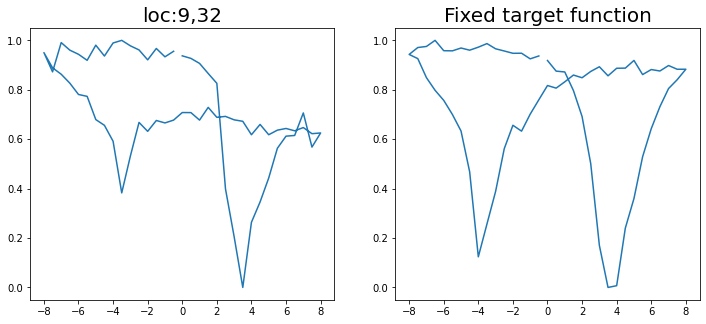

Epoch 1/200 ... Training loss: 2.7309
Epoch 10/200 ... Training loss: 2.4703
Epoch 20/200 ... Training loss: 2.2982
Epoch 30/200 ... Training loss: 2.14
Epoch 40/200 ... Training loss: 2.0098
Epoch 50/200 ... Training loss: 1.8709
Epoch 60/200 ... Training loss: 1.7482
Epoch 70/200 ... Training loss: 1.6151
Epoch 80/200 ... Training loss: 1.5141
Epoch 90/200 ... Training loss: 1.3978
Epoch 100/200 ... Training loss: 1.3104
Epoch 110/200 ... Training loss: 1.2416
Epoch 120/200 ... Training loss: 1.1902
Epoch 130/200 ... Training loss: 1.1093
Epoch 140/200 ... Training loss: 1.113
Epoch 150/200 ... Training loss: 1.053
Epoch 160/200 ... Training loss: 0.9749
Epoch 170/200 ... Training loss: 0.9493
Epoch 180/200 ... Training loss: 0.8829
Epoch 190/200 ... Training loss: 0.8357
Epoch 200/200 ... Training loss: 0.8283
step:  54
Sample #64




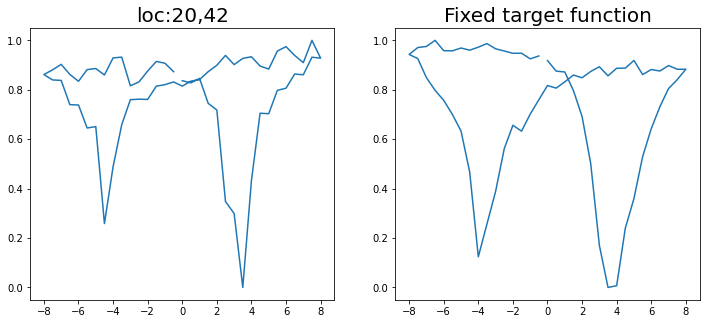

Epoch 1/200 ... Training loss: 2.7027
Epoch 10/200 ... Training loss: 2.4321
Epoch 20/200 ... Training loss: 2.3133
Epoch 30/200 ... Training loss: 2.1613
Epoch 40/200 ... Training loss: 2.0589
Epoch 50/200 ... Training loss: 1.9519
Epoch 60/200 ... Training loss: 1.8358
Epoch 70/200 ... Training loss: 1.7242
Epoch 80/200 ... Training loss: 1.5859
Epoch 90/200 ... Training loss: 1.5761
Epoch 100/200 ... Training loss: 1.4435
Epoch 110/200 ... Training loss: 1.302
Epoch 120/200 ... Training loss: 1.2267
Epoch 130/200 ... Training loss: 1.2099
Epoch 140/200 ... Training loss: 1.1408
Epoch 150/200 ... Training loss: 1.0774
Epoch 160/200 ... Training loss: 1.0168
Epoch 170/200 ... Training loss: 1.0634
Epoch 180/200 ... Training loss: 0.9452
Epoch 190/200 ... Training loss: 0.9063
Epoch 200/200 ... Training loss: 0.8536
step:  55
Sample #65




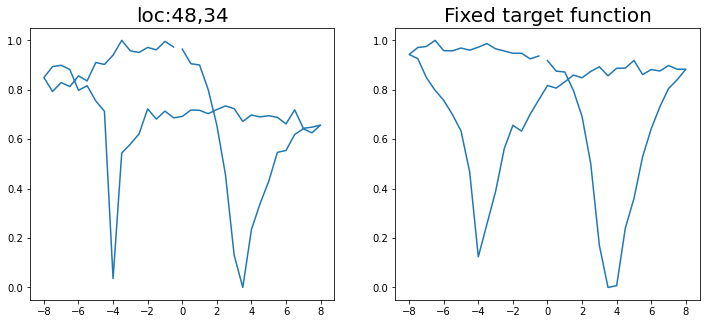

Epoch 1/200 ... Training loss: 2.6732
Epoch 10/200 ... Training loss: 2.4372
Epoch 20/200 ... Training loss: 2.2749
Epoch 30/200 ... Training loss: 2.1585
Epoch 40/200 ... Training loss: 2.0448
Epoch 50/200 ... Training loss: 1.9619
Epoch 60/200 ... Training loss: 1.8784
Epoch 70/200 ... Training loss: 1.766
Epoch 80/200 ... Training loss: 1.676
Epoch 90/200 ... Training loss: 1.5563
Epoch 100/200 ... Training loss: 1.504
Epoch 110/200 ... Training loss: 1.3765
Epoch 120/200 ... Training loss: 1.3305
Epoch 130/200 ... Training loss: 1.311
Epoch 140/200 ... Training loss: 1.2283
Epoch 150/200 ... Training loss: 1.1411
Epoch 160/200 ... Training loss: 1.0849
Epoch 170/200 ... Training loss: 1.1104
Epoch 180/200 ... Training loss: 1.0393
Epoch 190/200 ... Training loss: 0.9527
Epoch 200/200 ... Training loss: 0.9041
step:  56
Sample #66




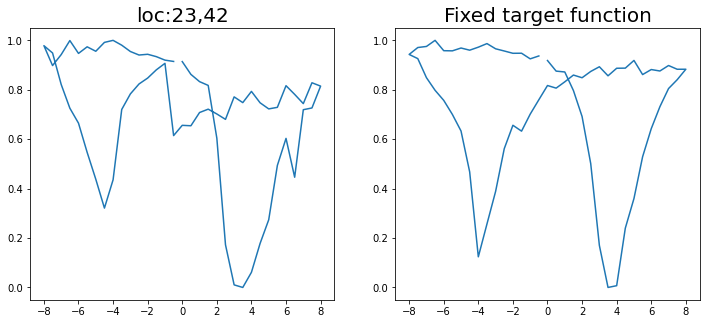

Epoch 1/200 ... Training loss: 2.6483
Epoch 10/200 ... Training loss: 2.4168
Epoch 20/200 ... Training loss: 2.2543
Epoch 30/200 ... Training loss: 2.1167
Epoch 40/200 ... Training loss: 2.0025
Epoch 50/200 ... Training loss: 1.8913
Epoch 60/200 ... Training loss: 1.7441
Epoch 70/200 ... Training loss: 1.631
Epoch 80/200 ... Training loss: 1.5413
Epoch 90/200 ... Training loss: 1.4355
Epoch 100/200 ... Training loss: 1.3529
Epoch 110/200 ... Training loss: 1.2451
Epoch 120/200 ... Training loss: 1.1869
Epoch 130/200 ... Training loss: 1.1162
Epoch 140/200 ... Training loss: 1.0864
Epoch 150/200 ... Training loss: 1.0519
Epoch 160/200 ... Training loss: 0.9626
Epoch 170/200 ... Training loss: 0.9342
Epoch 180/200 ... Training loss: 0.8712
Epoch 190/200 ... Training loss: 0.911
Epoch 200/200 ... Training loss: 0.8093
step:  57
Sample #67




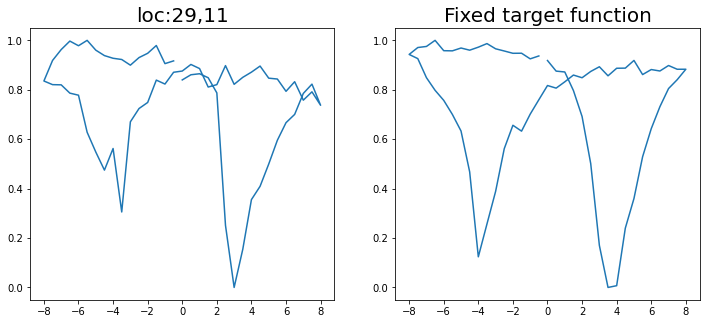

Epoch 1/200 ... Training loss: 2.6237
Epoch 10/200 ... Training loss: 2.4005
Epoch 20/200 ... Training loss: 2.2572
Epoch 30/200 ... Training loss: 2.127
Epoch 40/200 ... Training loss: 2.0071
Epoch 50/200 ... Training loss: 1.8953
Epoch 60/200 ... Training loss: 1.7788
Epoch 70/200 ... Training loss: 1.6676
Epoch 80/200 ... Training loss: 1.5433
Epoch 90/200 ... Training loss: 1.3929
Epoch 100/200 ... Training loss: 1.3748
Epoch 110/200 ... Training loss: 1.2401
Epoch 120/200 ... Training loss: 1.202
Epoch 130/200 ... Training loss: 1.121
Epoch 140/200 ... Training loss: 1.0736
Epoch 150/200 ... Training loss: 1.047
Epoch 160/200 ... Training loss: 1.0052
Epoch 170/200 ... Training loss: 0.9352
Epoch 180/200 ... Training loss: 0.91
Epoch 190/200 ... Training loss: 0.9031
Epoch 200/200 ... Training loss: 0.8303
step:  58
Sample #68




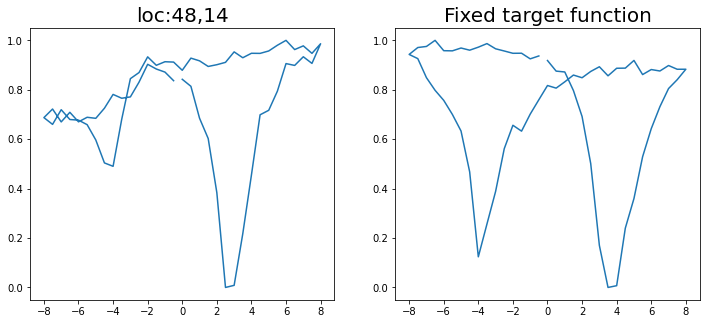

Epoch 1/200 ... Training loss: 2.6133
Epoch 10/200 ... Training loss: 2.3831
Epoch 20/200 ... Training loss: 2.2293
Epoch 30/200 ... Training loss: 2.0626
Epoch 40/200 ... Training loss: 1.9543
Epoch 50/200 ... Training loss: 1.8462
Epoch 60/200 ... Training loss: 1.7188
Epoch 70/200 ... Training loss: 1.6064
Epoch 80/200 ... Training loss: 1.5212
Epoch 90/200 ... Training loss: 1.3838
Epoch 100/200 ... Training loss: 1.2738
Epoch 110/200 ... Training loss: 1.2506
Epoch 120/200 ... Training loss: 1.1754
Epoch 130/200 ... Training loss: 1.1213
Epoch 140/200 ... Training loss: 1.0689
Epoch 150/200 ... Training loss: 1.0378
Epoch 160/200 ... Training loss: 0.9692
Epoch 170/200 ... Training loss: 0.9455
Epoch 180/200 ... Training loss: 0.9703
Epoch 190/200 ... Training loss: 0.8442
Epoch 200/200 ... Training loss: 0.7777
step:  59
Sample #69




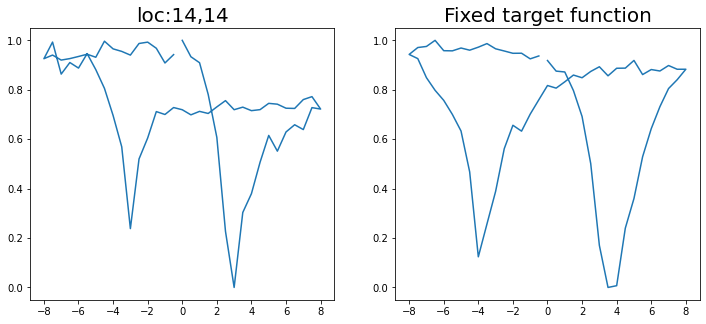

Epoch 1/200 ... Training loss: 2.5899
Epoch 10/200 ... Training loss: 2.3659
Epoch 20/200 ... Training loss: 2.2722
Epoch 30/200 ... Training loss: 2.0524
Epoch 40/200 ... Training loss: 1.9463
Epoch 50/200 ... Training loss: 1.8446
Epoch 60/200 ... Training loss: 1.7167
Epoch 70/200 ... Training loss: 1.6176
Epoch 80/200 ... Training loss: 1.5391
Epoch 90/200 ... Training loss: 1.3486
Epoch 100/200 ... Training loss: 1.348
Epoch 110/200 ... Training loss: 1.2148
Epoch 120/200 ... Training loss: 1.1776
Epoch 130/200 ... Training loss: 1.111
Epoch 140/200 ... Training loss: 1.0525
Epoch 150/200 ... Training loss: 1.0433
Epoch 160/200 ... Training loss: 1.0221
Epoch 170/200 ... Training loss: 0.9301
Epoch 180/200 ... Training loss: 0.8554
Epoch 190/200 ... Training loss: 0.849
Epoch 200/200 ... Training loss: 0.7587
step:  60
Sample #70




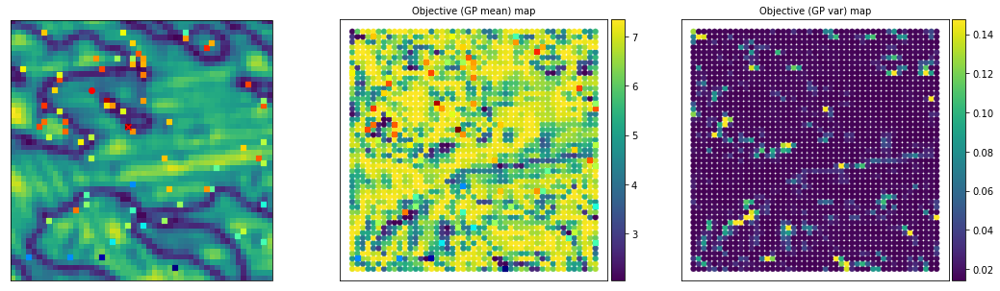

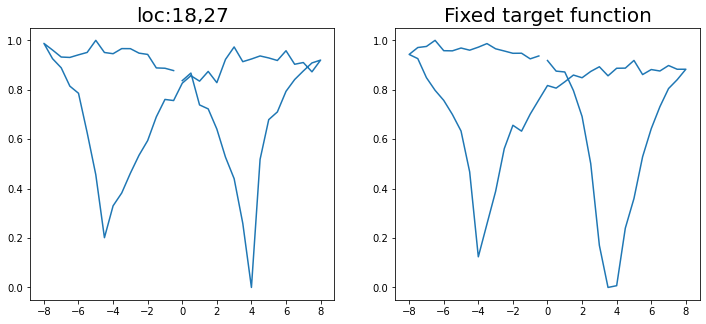

Epoch 1/200 ... Training loss: 2.5821
Epoch 10/200 ... Training loss: 2.368
Epoch 20/200 ... Training loss: 2.247
Epoch 30/200 ... Training loss: 2.0842
Epoch 40/200 ... Training loss: 1.9829
Epoch 50/200 ... Training loss: 1.8642
Epoch 60/200 ... Training loss: 1.709
Epoch 70/200 ... Training loss: 1.6202
Epoch 80/200 ... Training loss: 1.4727
Epoch 90/200 ... Training loss: 1.3844
Epoch 100/200 ... Training loss: 1.2803
Epoch 110/200 ... Training loss: 1.2484
Epoch 120/200 ... Training loss: 1.2511
Epoch 130/200 ... Training loss: 1.1108
Epoch 140/200 ... Training loss: 1.1187
Epoch 150/200 ... Training loss: 1.0215
Epoch 160/200 ... Training loss: 0.9798
Epoch 170/200 ... Training loss: 0.9126
Epoch 180/200 ... Training loss: 0.9871
Epoch 190/200 ... Training loss: 0.8294
Epoch 200/200 ... Training loss: 0.7951
step:  61
Sample #71




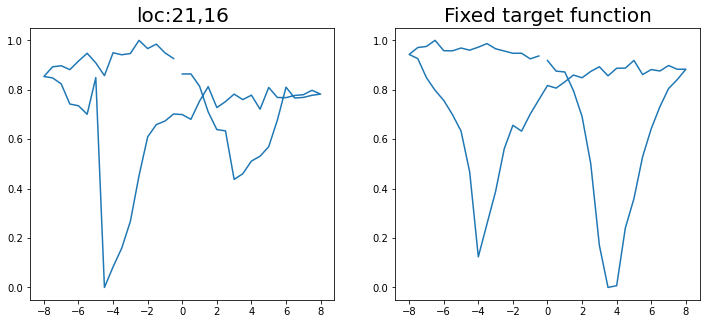

Epoch 1/200 ... Training loss: 2.5585
Epoch 10/200 ... Training loss: 2.324
Epoch 20/200 ... Training loss: 2.072
Epoch 30/200 ... Training loss: 1.9808
Epoch 40/200 ... Training loss: 1.8344
Epoch 50/200 ... Training loss: 1.6861
Epoch 60/200 ... Training loss: 1.5119
Epoch 70/200 ... Training loss: 1.4095
Epoch 80/200 ... Training loss: 1.3211
Epoch 90/200 ... Training loss: 1.2484
Epoch 100/200 ... Training loss: 1.2203
Epoch 110/200 ... Training loss: 1.1043
Epoch 120/200 ... Training loss: 1.0624
Epoch 130/200 ... Training loss: 1.014
Epoch 140/200 ... Training loss: 0.9324
Epoch 150/200 ... Training loss: 0.9279
Epoch 160/200 ... Training loss: 0.9017
Epoch 170/200 ... Training loss: 0.8349
Epoch 180/200 ... Training loss: 0.7509
Epoch 190/200 ... Training loss: 0.6656
Epoch 200/200 ... Training loss: 0.836
step:  62
Sample #72




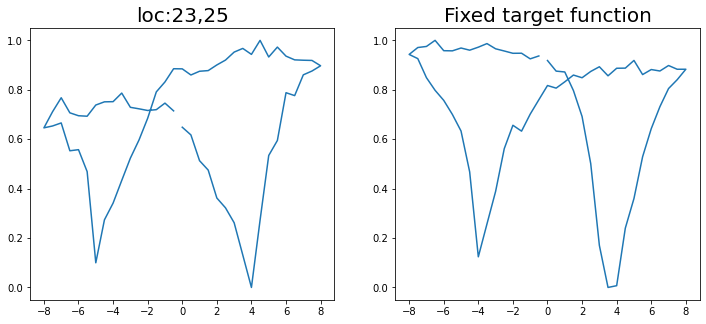

Epoch 1/200 ... Training loss: 2.5363
Epoch 10/200 ... Training loss: 2.2475
Epoch 20/200 ... Training loss: 2.1482
Epoch 30/200 ... Training loss: 1.991
Epoch 40/200 ... Training loss: 1.8922
Epoch 50/200 ... Training loss: 1.7541
Epoch 60/200 ... Training loss: 1.6353
Epoch 70/200 ... Training loss: 1.5106
Epoch 80/200 ... Training loss: 1.4392
Epoch 90/200 ... Training loss: 1.3274
Epoch 100/200 ... Training loss: 1.2218
Epoch 110/200 ... Training loss: 1.15
Epoch 120/200 ... Training loss: 1.2401
Epoch 130/200 ... Training loss: 1.0724
Epoch 140/200 ... Training loss: 0.9861
Epoch 150/200 ... Training loss: 0.9152
Epoch 160/200 ... Training loss: 0.917
Epoch 170/200 ... Training loss: 0.8535
Epoch 180/200 ... Training loss: 0.7863
Epoch 190/200 ... Training loss: 0.7237
Epoch 200/200 ... Training loss: 0.6578
step:  63
Sample #73




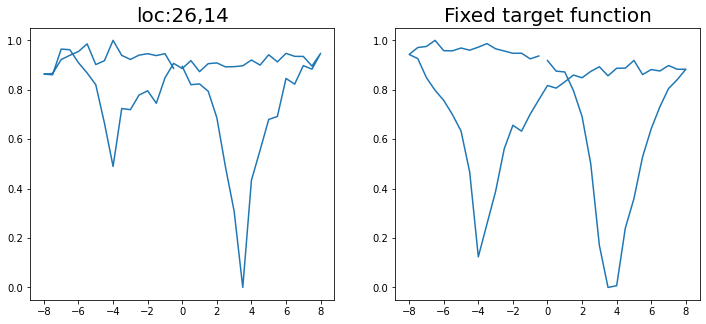

Epoch 1/200 ... Training loss: 2.5135
Epoch 10/200 ... Training loss: 2.2373
Epoch 20/200 ... Training loss: 2.149
Epoch 30/200 ... Training loss: 2.0064
Epoch 40/200 ... Training loss: 1.8974
Epoch 50/200 ... Training loss: 1.7869
Epoch 60/200 ... Training loss: 1.6596
Epoch 70/200 ... Training loss: 1.5394
Epoch 80/200 ... Training loss: 1.454
Epoch 90/200 ... Training loss: 1.292
Epoch 100/200 ... Training loss: 1.3056
Epoch 110/200 ... Training loss: 1.1944
Epoch 120/200 ... Training loss: 1.1005
Epoch 130/200 ... Training loss: 1.046
Epoch 140/200 ... Training loss: 0.983
Epoch 150/200 ... Training loss: 0.972
Epoch 160/200 ... Training loss: 0.9441
Epoch 170/200 ... Training loss: 0.8313
Epoch 180/200 ... Training loss: 0.8308
Epoch 190/200 ... Training loss: 0.7583
Epoch 200/200 ... Training loss: 0.6934
step:  64
Sample #74




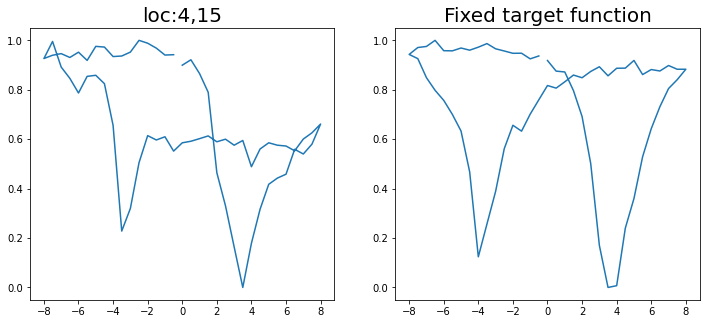

Epoch 1/200 ... Training loss: 2.4976
Epoch 10/200 ... Training loss: 2.1957
Epoch 20/200 ... Training loss: 2.0249
Epoch 30/200 ... Training loss: 1.8147
Epoch 40/200 ... Training loss: 1.5986
Epoch 50/200 ... Training loss: 1.5205
Epoch 60/200 ... Training loss: 1.4158
Epoch 70/200 ... Training loss: 1.3501
Epoch 80/200 ... Training loss: 1.2973
Epoch 90/200 ... Training loss: 1.1949
Epoch 100/200 ... Training loss: 1.1062
Epoch 110/200 ... Training loss: 1.0874
Epoch 120/200 ... Training loss: 1.0242
Epoch 130/200 ... Training loss: 0.9278
Epoch 140/200 ... Training loss: 0.9501
Epoch 150/200 ... Training loss: 0.8115
Epoch 160/200 ... Training loss: 0.7522
Epoch 170/200 ... Training loss: 0.7113
Epoch 180/200 ... Training loss: 0.6777
Epoch 190/200 ... Training loss: 0.6603
Epoch 200/200 ... Training loss: 0.716
step:  65
Sample #75




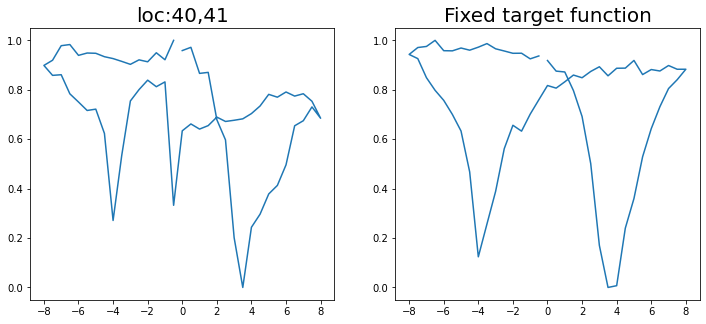

Epoch 1/200 ... Training loss: 2.4857
Epoch 10/200 ... Training loss: 2.1427
Epoch 20/200 ... Training loss: 1.9425
Epoch 30/200 ... Training loss: 1.7179
Epoch 40/200 ... Training loss: 1.5717
Epoch 50/200 ... Training loss: 1.5273
Epoch 60/200 ... Training loss: 1.404
Epoch 70/200 ... Training loss: 1.2618
Epoch 80/200 ... Training loss: 1.1994
Epoch 90/200 ... Training loss: 1.1307
Epoch 100/200 ... Training loss: 1.0536
Epoch 110/200 ... Training loss: 1.1026
Epoch 120/200 ... Training loss: 0.9547
Epoch 130/200 ... Training loss: 0.951
Epoch 140/200 ... Training loss: 0.964
Epoch 150/200 ... Training loss: 0.7978
Epoch 160/200 ... Training loss: 0.7037
Epoch 170/200 ... Training loss: 0.7574
Epoch 180/200 ... Training loss: 0.7342
Epoch 190/200 ... Training loss: 0.5751
Epoch 200/200 ... Training loss: 0.4957
step:  66
Sample #76




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


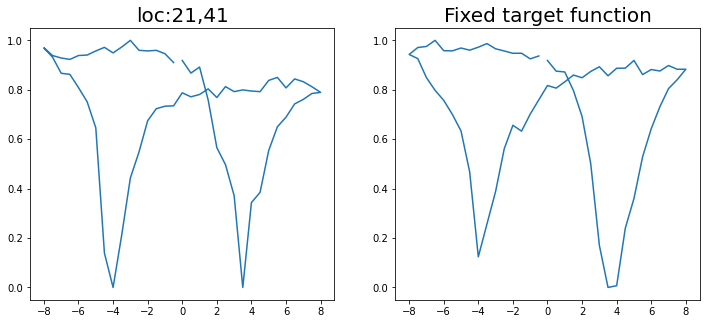

Epoch 1/200 ... Training loss: 2.4866
Epoch 10/200 ... Training loss: 2.2668
Epoch 20/200 ... Training loss: 2.0615
Epoch 30/200 ... Training loss: 1.9723
Epoch 40/200 ... Training loss: 1.877
Epoch 50/200 ... Training loss: 1.7812
Epoch 60/200 ... Training loss: 1.6546
Epoch 70/200 ... Training loss: 1.5315
Epoch 80/200 ... Training loss: 1.4251
Epoch 90/200 ... Training loss: 1.3133
Epoch 100/200 ... Training loss: 1.2218
Epoch 110/200 ... Training loss: 1.1653
Epoch 120/200 ... Training loss: 1.1037
Epoch 130/200 ... Training loss: 1.0344
Epoch 140/200 ... Training loss: 1.0269
Epoch 150/200 ... Training loss: 0.9723
Epoch 160/200 ... Training loss: 0.9348
Epoch 170/200 ... Training loss: 0.8362
Epoch 180/200 ... Training loss: 0.7728
Epoch 190/200 ... Training loss: 0.73
Epoch 200/200 ... Training loss: 0.6899
step:  67
Sample #77




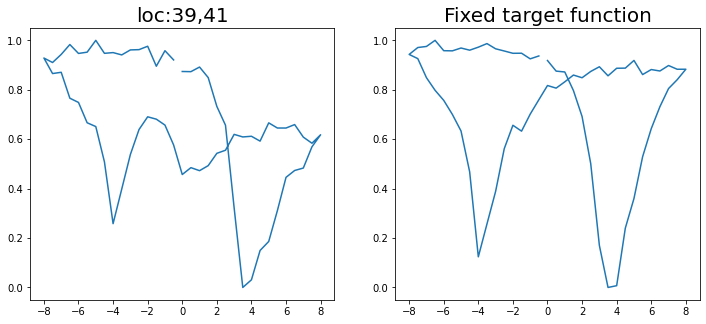

Epoch 1/200 ... Training loss: 2.4669
Epoch 10/200 ... Training loss: 2.2526
Epoch 20/200 ... Training loss: 2.0775
Epoch 30/200 ... Training loss: 1.9755
Epoch 40/200 ... Training loss: 1.8739
Epoch 50/200 ... Training loss: 1.78
Epoch 60/200 ... Training loss: 1.6637
Epoch 70/200 ... Training loss: 1.56
Epoch 80/200 ... Training loss: 1.5235
Epoch 90/200 ... Training loss: 1.3754
Epoch 100/200 ... Training loss: 1.2742
Epoch 110/200 ... Training loss: 1.2406
Epoch 120/200 ... Training loss: 1.1326
Epoch 130/200 ... Training loss: 1.1429
Epoch 140/200 ... Training loss: 1.0479
Epoch 150/200 ... Training loss: 0.9738
Epoch 160/200 ... Training loss: 0.9658
Epoch 170/200 ... Training loss: 0.9099
Epoch 180/200 ... Training loss: 0.8542
Epoch 190/200 ... Training loss: 0.7739
Epoch 200/200 ... Training loss: 0.7206
step:  68
Sample #78




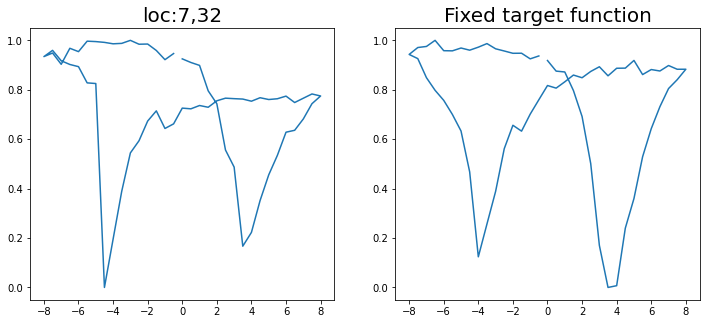

Epoch 1/200 ... Training loss: 2.4542
Epoch 10/200 ... Training loss: 2.2471
Epoch 20/200 ... Training loss: 2.1207
Epoch 30/200 ... Training loss: 1.9513
Epoch 40/200 ... Training loss: 1.8145
Epoch 50/200 ... Training loss: 1.6659
Epoch 60/200 ... Training loss: 1.5268
Epoch 70/200 ... Training loss: 1.3936
Epoch 80/200 ... Training loss: 1.2975
Epoch 90/200 ... Training loss: 1.2682
Epoch 100/200 ... Training loss: 1.199
Epoch 110/200 ... Training loss: 1.1041
Epoch 120/200 ... Training loss: 1.1206
Epoch 130/200 ... Training loss: 0.9967
Epoch 140/200 ... Training loss: 0.9333
Epoch 150/200 ... Training loss: 0.9253
Epoch 160/200 ... Training loss: 0.8277
Epoch 170/200 ... Training loss: 0.8555
Epoch 180/200 ... Training loss: 0.8421
Epoch 190/200 ... Training loss: 0.7294
Epoch 200/200 ... Training loss: 0.8506
step:  69
Sample #79




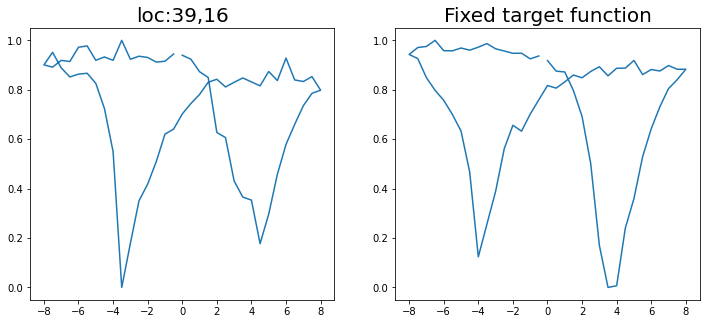

Epoch 1/200 ... Training loss: 2.4328
Epoch 10/200 ... Training loss: 2.2261
Epoch 20/200 ... Training loss: 2.0905
Epoch 30/200 ... Training loss: 1.9321
Epoch 40/200 ... Training loss: 1.8066
Epoch 50/200 ... Training loss: 1.6743
Epoch 60/200 ... Training loss: 1.5563
Epoch 70/200 ... Training loss: 1.4497
Epoch 80/200 ... Training loss: 1.3365
Epoch 90/200 ... Training loss: 1.2808
Epoch 100/200 ... Training loss: 1.2185
Epoch 110/200 ... Training loss: 1.138
Epoch 120/200 ... Training loss: 1.0487
Epoch 130/200 ... Training loss: 1.0711
Epoch 140/200 ... Training loss: 0.9394
Epoch 150/200 ... Training loss: 0.9529
Epoch 160/200 ... Training loss: 0.8252
Epoch 170/200 ... Training loss: 0.9028
Epoch 180/200 ... Training loss: 0.7955
Epoch 190/200 ... Training loss: 0.7046
Epoch 200/200 ... Training loss: 0.6575
step:  70
Sample #80




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


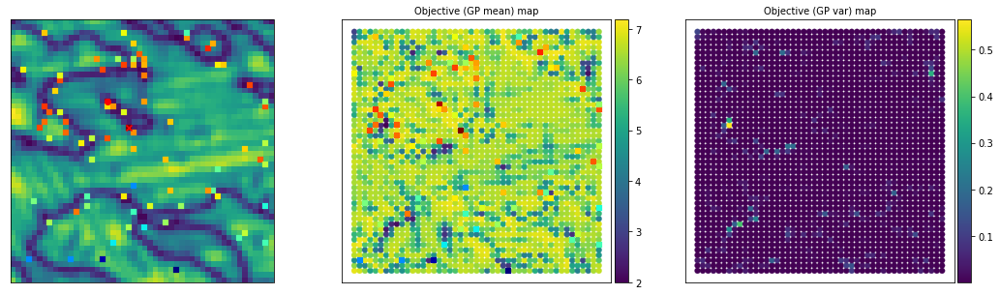

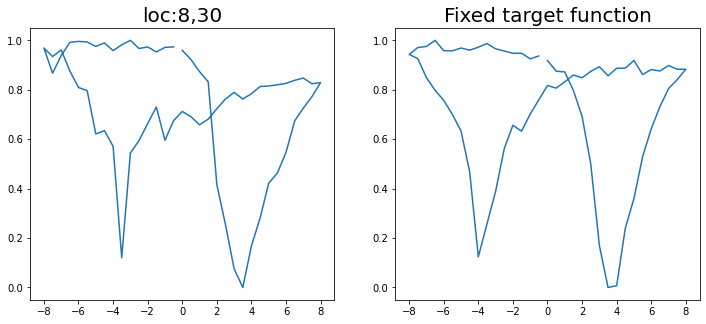

Epoch 1/200 ... Training loss: 2.4311
Epoch 10/200 ... Training loss: 2.2903
Epoch 20/200 ... Training loss: 2.0649
Epoch 30/200 ... Training loss: 1.939
Epoch 40/200 ... Training loss: 1.8396
Epoch 50/200 ... Training loss: 1.7454
Epoch 60/200 ... Training loss: 1.6411
Epoch 70/200 ... Training loss: 1.5018
Epoch 80/200 ... Training loss: 1.3672
Epoch 90/200 ... Training loss: 1.3275
Epoch 100/200 ... Training loss: 1.266
Epoch 110/200 ... Training loss: 1.2562
Epoch 120/200 ... Training loss: 1.1256
Epoch 130/200 ... Training loss: 1.0463
Epoch 140/200 ... Training loss: 0.9723
Epoch 150/200 ... Training loss: 0.9714
Epoch 160/200 ... Training loss: 0.8722
Epoch 170/200 ... Training loss: 0.8149
Epoch 180/200 ... Training loss: 0.8884
Epoch 190/200 ... Training loss: 0.8078
Epoch 200/200 ... Training loss: 0.6895
step:  71
Sample #81




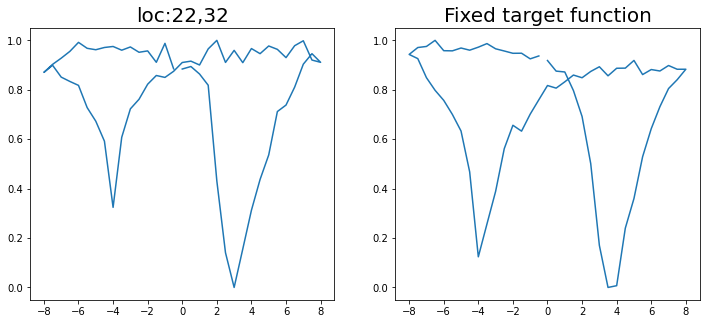

Epoch 1/200 ... Training loss: 2.4259
Epoch 10/200 ... Training loss: 2.147
Epoch 20/200 ... Training loss: 1.9758
Epoch 30/200 ... Training loss: 1.8395
Epoch 40/200 ... Training loss: 1.6749
Epoch 50/200 ... Training loss: 1.5115
Epoch 60/200 ... Training loss: 1.5145
Epoch 70/200 ... Training loss: 1.3903
Epoch 80/200 ... Training loss: 1.3291
Epoch 90/200 ... Training loss: 1.2498
Epoch 100/200 ... Training loss: 1.1195
Epoch 110/200 ... Training loss: 1.1039
Epoch 120/200 ... Training loss: 1.1043
Epoch 130/200 ... Training loss: 0.9673
Epoch 140/200 ... Training loss: 0.9212
Epoch 150/200 ... Training loss: 0.9458
Epoch 160/200 ... Training loss: 0.7729
Epoch 170/200 ... Training loss: 0.7205
Epoch 180/200 ... Training loss: 0.7952
Epoch 190/200 ... Training loss: 0.7284
Epoch 200/200 ... Training loss: 0.623
step:  72
Sample #82




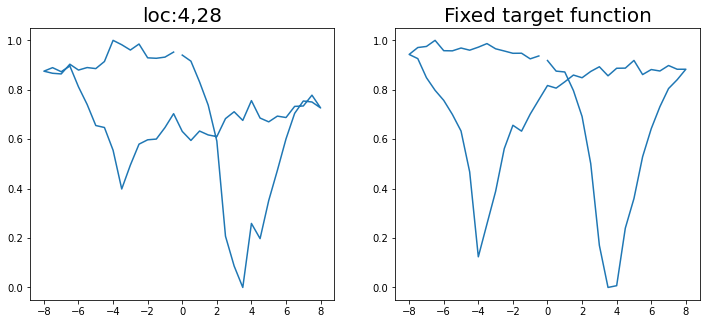

Epoch 1/200 ... Training loss: 2.4062
Epoch 10/200 ... Training loss: 2.1542
Epoch 20/200 ... Training loss: 1.9239
Epoch 30/200 ... Training loss: 1.8654
Epoch 40/200 ... Training loss: 1.7808
Epoch 50/200 ... Training loss: 1.6606
Epoch 60/200 ... Training loss: 1.556
Epoch 70/200 ... Training loss: 1.5434
Epoch 80/200 ... Training loss: 1.3716
Epoch 90/200 ... Training loss: 1.2942
Epoch 100/200 ... Training loss: 1.1793
Epoch 110/200 ... Training loss: 1.222
Epoch 120/200 ... Training loss: 1.1019
Epoch 130/200 ... Training loss: 0.9785
Epoch 140/200 ... Training loss: 0.9521
Epoch 150/200 ... Training loss: 0.8568
Epoch 160/200 ... Training loss: 0.8441
Epoch 170/200 ... Training loss: 0.8046
Epoch 180/200 ... Training loss: 0.8187
Epoch 190/200 ... Training loss: 0.754
Epoch 200/200 ... Training loss: 0.6287
step:  73
Sample #83




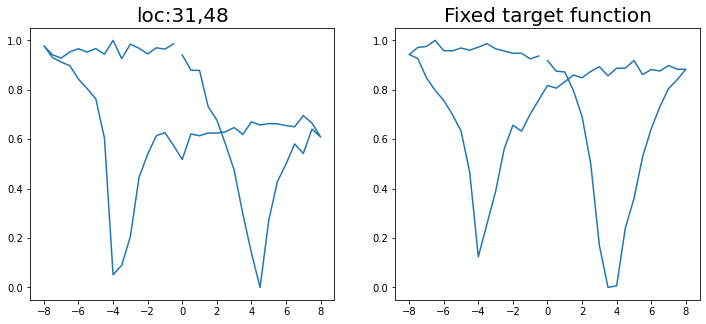

Epoch 1/200 ... Training loss: 2.3917
Epoch 10/200 ... Training loss: 2.137
Epoch 20/200 ... Training loss: 2.0428
Epoch 30/200 ... Training loss: 1.9542
Epoch 40/200 ... Training loss: 1.8588
Epoch 50/200 ... Training loss: 1.7829
Epoch 60/200 ... Training loss: 1.7283
Epoch 70/200 ... Training loss: 1.6441
Epoch 80/200 ... Training loss: 1.5796
Epoch 90/200 ... Training loss: 1.5008
Epoch 100/200 ... Training loss: 1.4253
Epoch 110/200 ... Training loss: 1.3143
Epoch 120/200 ... Training loss: 1.3566
Epoch 130/200 ... Training loss: 1.1927
Epoch 140/200 ... Training loss: 1.1111
Epoch 150/200 ... Training loss: 1.1706
Epoch 160/200 ... Training loss: 1.0251
Epoch 170/200 ... Training loss: 0.9239
Epoch 180/200 ... Training loss: 1.0831
Epoch 190/200 ... Training loss: 0.865
Epoch 200/200 ... Training loss: 0.8122
step:  74
Sample #84




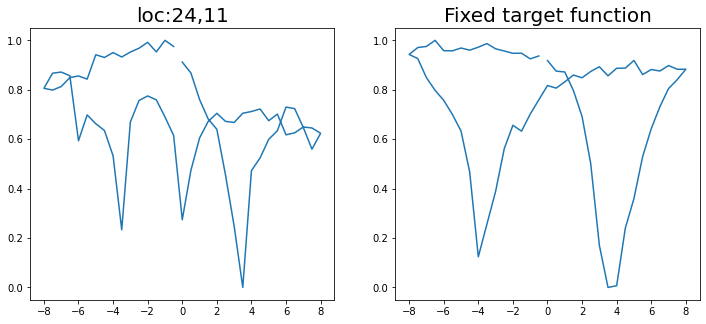

Epoch 1/200 ... Training loss: 2.4397
Epoch 10/200 ... Training loss: 2.1972
Epoch 20/200 ... Training loss: 2.0271
Epoch 30/200 ... Training loss: 1.8882
Epoch 40/200 ... Training loss: 1.7565
Epoch 50/200 ... Training loss: 1.634
Epoch 60/200 ... Training loss: 1.5885
Epoch 70/200 ... Training loss: 1.5297
Epoch 80/200 ... Training loss: 1.4018
Epoch 90/200 ... Training loss: 1.2563
Epoch 100/200 ... Training loss: 1.2101
Epoch 110/200 ... Training loss: 1.1304
Epoch 120/200 ... Training loss: 1.144
Epoch 130/200 ... Training loss: 0.9991
Epoch 140/200 ... Training loss: 0.9686
Epoch 150/200 ... Training loss: 0.9249
Epoch 160/200 ... Training loss: 0.887
Epoch 170/200 ... Training loss: 0.8163
Epoch 180/200 ... Training loss: 0.7623
Epoch 190/200 ... Training loss: 0.8043
Epoch 200/200 ... Training loss: 0.7515
step:  75
Sample #85




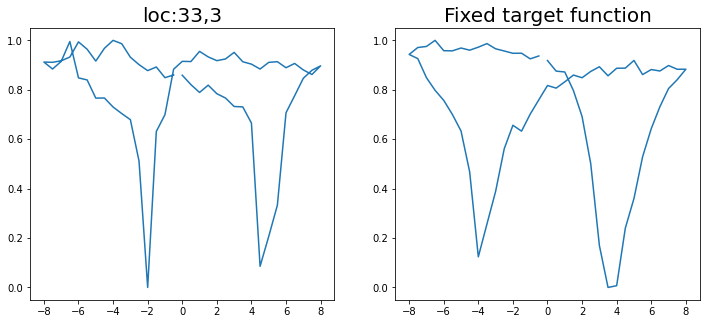

Epoch 1/200 ... Training loss: 2.4389
Epoch 10/200 ... Training loss: 2.2223
Epoch 20/200 ... Training loss: 2.0344
Epoch 30/200 ... Training loss: 1.9014
Epoch 40/200 ... Training loss: 1.8071
Epoch 50/200 ... Training loss: 1.7033
Epoch 60/200 ... Training loss: 1.5678
Epoch 70/200 ... Training loss: 1.5109
Epoch 80/200 ... Training loss: 1.3738
Epoch 90/200 ... Training loss: 1.2588
Epoch 100/200 ... Training loss: 1.3208
Epoch 110/200 ... Training loss: 1.1563
Epoch 120/200 ... Training loss: 1.085
Epoch 130/200 ... Training loss: 1.03
Epoch 140/200 ... Training loss: 1.0174
Epoch 150/200 ... Training loss: 0.931
Epoch 160/200 ... Training loss: 0.8795
Epoch 170/200 ... Training loss: 0.7946
Epoch 180/200 ... Training loss: 0.7555
Epoch 190/200 ... Training loss: 0.6939
Epoch 200/200 ... Training loss: 0.6408
step:  76
Sample #86




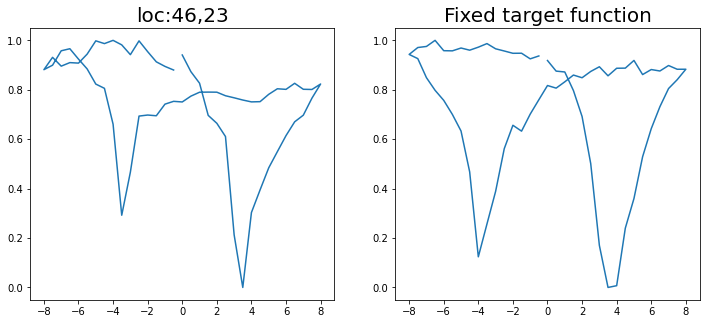

Epoch 1/200 ... Training loss: 2.4196
Epoch 10/200 ... Training loss: 2.0906
Epoch 20/200 ... Training loss: 1.8763
Epoch 30/200 ... Training loss: 1.6972
Epoch 40/200 ... Training loss: 1.7984
Epoch 50/200 ... Training loss: 1.7755
Epoch 60/200 ... Training loss: 1.5834
Epoch 70/200 ... Training loss: 1.422
Epoch 80/200 ... Training loss: 1.3312
Epoch 90/200 ... Training loss: 1.2597
Epoch 100/200 ... Training loss: 1.2243
Epoch 110/200 ... Training loss: 1.1072
Epoch 120/200 ... Training loss: 1.0426
Epoch 130/200 ... Training loss: 1.0641
Epoch 140/200 ... Training loss: 0.9813
Epoch 150/200 ... Training loss: 0.8838
Epoch 160/200 ... Training loss: 0.8627
Epoch 170/200 ... Training loss: 0.8669
Epoch 180/200 ... Training loss: 0.7435
Epoch 190/200 ... Training loss: 0.7047
Epoch 200/200 ... Training loss: 0.6185
step:  77
Sample #87




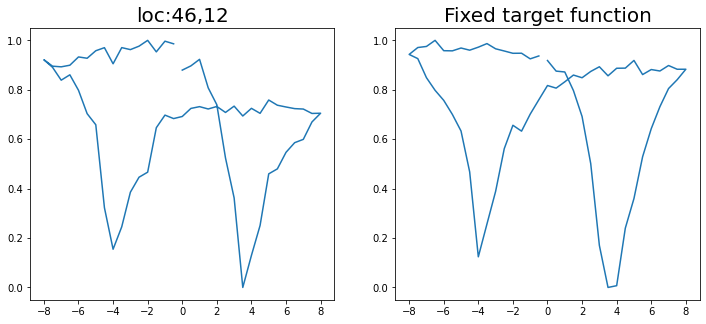

Epoch 1/200 ... Training loss: 2.4322
Epoch 10/200 ... Training loss: 2.1245
Epoch 20/200 ... Training loss: 1.962
Epoch 30/200 ... Training loss: 1.7788
Epoch 40/200 ... Training loss: 1.5952
Epoch 50/200 ... Training loss: 1.6044
Epoch 60/200 ... Training loss: 1.4415
Epoch 70/200 ... Training loss: 1.3278
Epoch 80/200 ... Training loss: 1.255
Epoch 90/200 ... Training loss: 1.1965
Epoch 100/200 ... Training loss: 1.2453
Epoch 110/200 ... Training loss: 1.0387
Epoch 120/200 ... Training loss: 1.0408
Epoch 130/200 ... Training loss: 0.9404
Epoch 140/200 ... Training loss: 0.9698
Epoch 150/200 ... Training loss: 0.8888
Epoch 160/200 ... Training loss: 0.7984
Epoch 170/200 ... Training loss: 0.7127
Epoch 180/200 ... Training loss: 0.6935
Epoch 190/200 ... Training loss: 0.671
Epoch 200/200 ... Training loss: 0.8409
step:  78
Sample #88




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


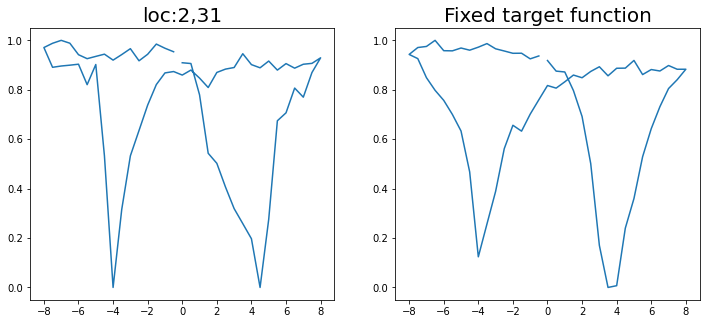

Epoch 1/200 ... Training loss: 2.4273
Epoch 10/200 ... Training loss: 2.1868
Epoch 20/200 ... Training loss: 2.1375
Epoch 30/200 ... Training loss: 1.9109
Epoch 40/200 ... Training loss: 1.8152
Epoch 50/200 ... Training loss: 1.6944
Epoch 60/200 ... Training loss: 1.5659
Epoch 70/200 ... Training loss: 1.4595
Epoch 80/200 ... Training loss: 1.3038
Epoch 90/200 ... Training loss: 1.2409
Epoch 100/200 ... Training loss: 1.2033
Epoch 110/200 ... Training loss: 1.1274
Epoch 120/200 ... Training loss: 1.0684
Epoch 130/200 ... Training loss: 1.0397
Epoch 140/200 ... Training loss: 0.9357
Epoch 150/200 ... Training loss: 0.9217
Epoch 160/200 ... Training loss: 0.9773
Epoch 170/200 ... Training loss: 0.8416
Epoch 180/200 ... Training loss: 0.7398
Epoch 190/200 ... Training loss: 0.7821
Epoch 200/200 ... Training loss: 0.6704
step:  79
Sample #89




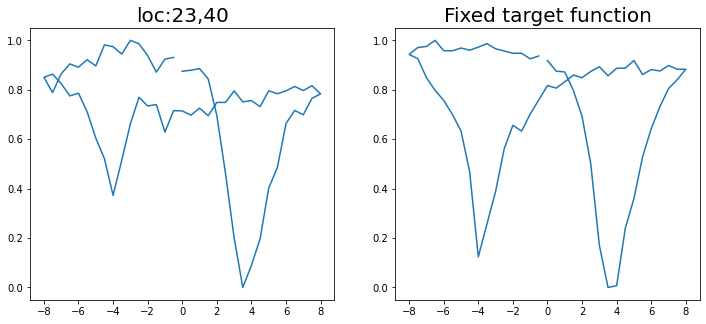

Epoch 1/200 ... Training loss: 2.4098
Epoch 10/200 ... Training loss: 2.0929
Epoch 20/200 ... Training loss: 1.8619
Epoch 30/200 ... Training loss: 1.7818
Epoch 40/200 ... Training loss: 1.5659
Epoch 50/200 ... Training loss: 1.5477
Epoch 60/200 ... Training loss: 1.5011
Epoch 70/200 ... Training loss: 1.3109
Epoch 80/200 ... Training loss: 1.2199
Epoch 90/200 ... Training loss: 1.1513
Epoch 100/200 ... Training loss: 1.1709
Epoch 110/200 ... Training loss: 1.0514
Epoch 120/200 ... Training loss: 0.988
Epoch 130/200 ... Training loss: 0.993
Epoch 140/200 ... Training loss: 0.8946
Epoch 150/200 ... Training loss: 0.8715
Epoch 160/200 ... Training loss: 0.8024
Epoch 170/200 ... Training loss: 0.9117
Epoch 180/200 ... Training loss: 0.6714
Epoch 190/200 ... Training loss: 0.6125
Epoch 200/200 ... Training loss: 0.5637
step:  80
Sample #90




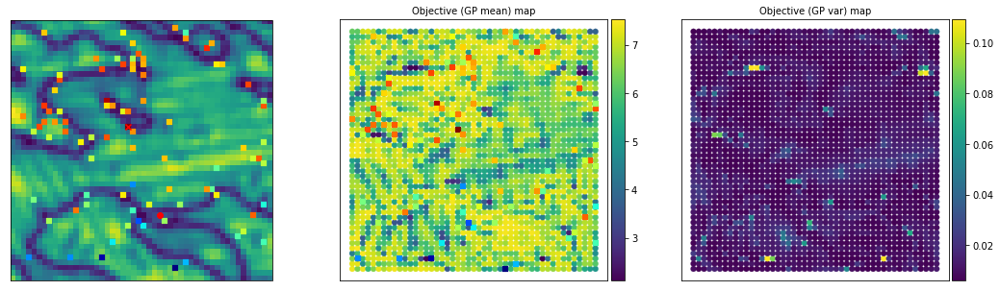

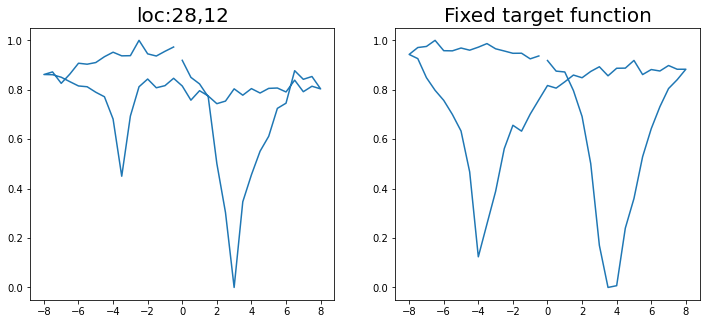

Epoch 1/200 ... Training loss: 2.4089
Epoch 10/200 ... Training loss: 2.1975
Epoch 20/200 ... Training loss: 2.0995
Epoch 30/200 ... Training loss: 1.912
Epoch 40/200 ... Training loss: 1.8505
Epoch 50/200 ... Training loss: 1.7562
Epoch 60/200 ... Training loss: 1.66
Epoch 70/200 ... Training loss: 1.5147
Epoch 80/200 ... Training loss: 1.4867
Epoch 90/200 ... Training loss: 1.3625
Epoch 100/200 ... Training loss: 1.3029
Epoch 110/200 ... Training loss: 1.199
Epoch 120/200 ... Training loss: 1.15
Epoch 130/200 ... Training loss: 1.0578
Epoch 140/200 ... Training loss: 1.038
Epoch 150/200 ... Training loss: 0.9701
Epoch 160/200 ... Training loss: 0.9126
Epoch 170/200 ... Training loss: 1.04
Epoch 180/200 ... Training loss: 0.8906
Epoch 190/200 ... Training loss: 0.7778
Epoch 200/200 ... Training loss: 0.8052
step:  81
Sample #91




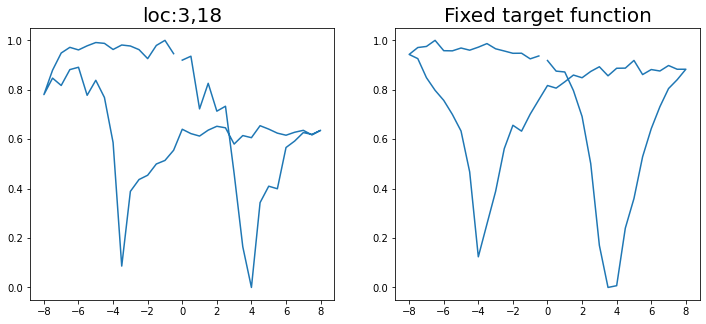

Epoch 1/200 ... Training loss: 2.3918
Epoch 10/200 ... Training loss: 2.284
Epoch 20/200 ... Training loss: 2.0092
Epoch 30/200 ... Training loss: 1.9294
Epoch 40/200 ... Training loss: 1.8254
Epoch 50/200 ... Training loss: 1.7258
Epoch 60/200 ... Training loss: 1.6232
Epoch 70/200 ... Training loss: 1.5132
Epoch 80/200 ... Training loss: 1.348
Epoch 90/200 ... Training loss: 1.4313
Epoch 100/200 ... Training loss: 1.2891
Epoch 110/200 ... Training loss: 1.1836
Epoch 120/200 ... Training loss: 1.1466
Epoch 130/200 ... Training loss: 1.0685
Epoch 140/200 ... Training loss: 1.0295
Epoch 150/200 ... Training loss: 0.9616
Epoch 160/200 ... Training loss: 0.9467
Epoch 170/200 ... Training loss: 0.8597
Epoch 180/200 ... Training loss: 0.8244
Epoch 190/200 ... Training loss: 0.7789
Epoch 200/200 ... Training loss: 0.6957
step:  82
Sample #92




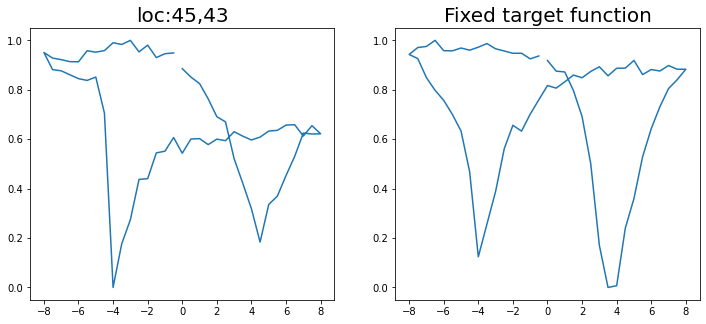

Epoch 1/200 ... Training loss: 2.3746
Epoch 10/200 ... Training loss: 2.1436
Epoch 20/200 ... Training loss: 1.9599
Epoch 30/200 ... Training loss: 1.8081
Epoch 40/200 ... Training loss: 1.661
Epoch 50/200 ... Training loss: 1.5167
Epoch 60/200 ... Training loss: 1.4004
Epoch 70/200 ... Training loss: 1.3134
Epoch 80/200 ... Training loss: 1.3084
Epoch 90/200 ... Training loss: 1.1931
Epoch 100/200 ... Training loss: 1.0926
Epoch 110/200 ... Training loss: 1.1346
Epoch 120/200 ... Training loss: 1.0285
Epoch 130/200 ... Training loss: 0.9469
Epoch 140/200 ... Training loss: 0.9
Epoch 150/200 ... Training loss: 0.9147
Epoch 160/200 ... Training loss: 0.8419
Epoch 170/200 ... Training loss: 0.7506
Epoch 180/200 ... Training loss: 0.8094
Epoch 190/200 ... Training loss: 0.8011
Epoch 200/200 ... Training loss: 0.6249
step:  83
Sample #93




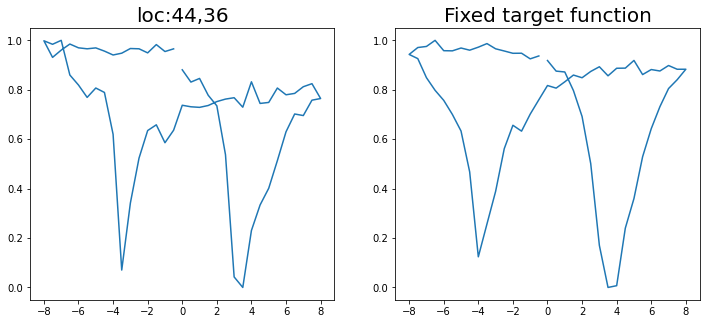

Epoch 1/200 ... Training loss: 2.3662
Epoch 10/200 ... Training loss: 2.1714
Epoch 20/200 ... Training loss: 1.9916
Epoch 30/200 ... Training loss: 1.9057
Epoch 40/200 ... Training loss: 1.8558
Epoch 50/200 ... Training loss: 1.7772
Epoch 60/200 ... Training loss: 1.6756
Epoch 70/200 ... Training loss: 1.5733
Epoch 80/200 ... Training loss: 1.425
Epoch 90/200 ... Training loss: 1.3532
Epoch 100/200 ... Training loss: 1.2557
Epoch 110/200 ... Training loss: 1.2103
Epoch 120/200 ... Training loss: 1.1406
Epoch 130/200 ... Training loss: 1.0977
Epoch 140/200 ... Training loss: 1.044
Epoch 150/200 ... Training loss: 1.0296
Epoch 160/200 ... Training loss: 0.9529
Epoch 170/200 ... Training loss: 0.9234
Epoch 180/200 ... Training loss: 0.8455
Epoch 190/200 ... Training loss: 0.8266
Epoch 200/200 ... Training loss: 0.8643
step:  84
Sample #94




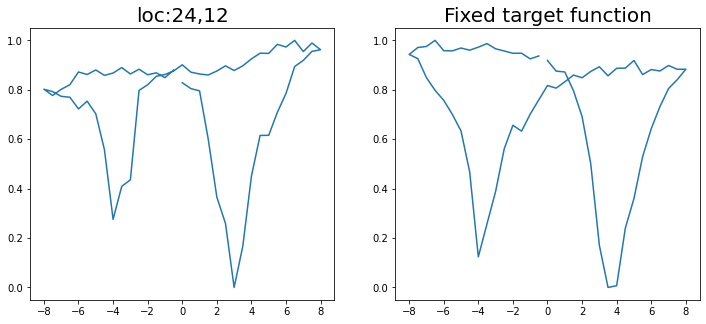

Epoch 1/200 ... Training loss: 2.3497
Epoch 10/200 ... Training loss: 2.179
Epoch 20/200 ... Training loss: 2.0075
Epoch 30/200 ... Training loss: 1.851
Epoch 40/200 ... Training loss: 1.7717
Epoch 50/200 ... Training loss: 1.6522
Epoch 60/200 ... Training loss: 1.5243
Epoch 70/200 ... Training loss: 1.3863
Epoch 80/200 ... Training loss: 1.3059
Epoch 90/200 ... Training loss: 1.2455
Epoch 100/200 ... Training loss: 1.2138
Epoch 110/200 ... Training loss: 1.1084
Epoch 120/200 ... Training loss: 1.0563
Epoch 130/200 ... Training loss: 0.9864
Epoch 140/200 ... Training loss: 0.9401
Epoch 150/200 ... Training loss: 0.9335
Epoch 160/200 ... Training loss: 0.9282
Epoch 170/200 ... Training loss: 0.9821
Epoch 180/200 ... Training loss: 0.9242
Epoch 190/200 ... Training loss: 0.7234
Epoch 200/200 ... Training loss: 0.6824
step:  85
Sample #95




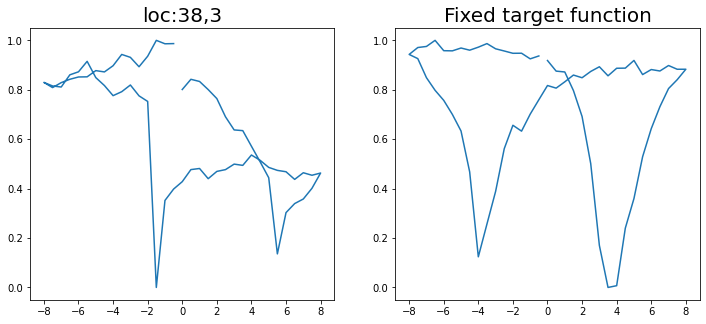

Epoch 1/200 ... Training loss: 2.4294
Epoch 10/200 ... Training loss: 2.2417
Epoch 20/200 ... Training loss: 2.0268
Epoch 30/200 ... Training loss: 1.9237
Epoch 40/200 ... Training loss: 1.8313
Epoch 50/200 ... Training loss: 1.7205
Epoch 60/200 ... Training loss: 1.5745
Epoch 70/200 ... Training loss: 1.4213
Epoch 80/200 ... Training loss: 1.3504
Epoch 90/200 ... Training loss: 1.2827
Epoch 100/200 ... Training loss: 1.2174
Epoch 110/200 ... Training loss: 1.15
Epoch 120/200 ... Training loss: 1.1047
Epoch 130/200 ... Training loss: 1.0644
Epoch 140/200 ... Training loss: 0.9832
Epoch 150/200 ... Training loss: 0.9808
Epoch 160/200 ... Training loss: 0.9313
Epoch 170/200 ... Training loss: 0.8535
Epoch 180/200 ... Training loss: 0.7969
Epoch 190/200 ... Training loss: 0.7331
Epoch 200/200 ... Training loss: 0.7642
step:  86
Sample #96




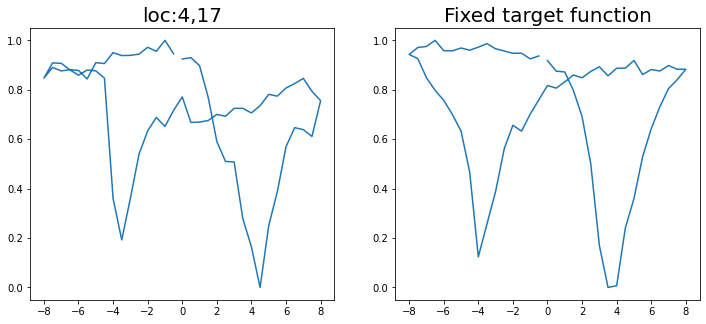

Epoch 1/200 ... Training loss: 2.4128
Epoch 10/200 ... Training loss: 2.2346
Epoch 20/200 ... Training loss: 2.0916
Epoch 30/200 ... Training loss: 1.9185
Epoch 40/200 ... Training loss: 1.8496
Epoch 50/200 ... Training loss: 1.7729
Epoch 60/200 ... Training loss: 1.6797
Epoch 70/200 ... Training loss: 1.5585
Epoch 80/200 ... Training loss: 1.5356
Epoch 90/200 ... Training loss: 1.3644
Epoch 100/200 ... Training loss: 1.2511
Epoch 110/200 ... Training loss: 1.2346
Epoch 120/200 ... Training loss: 1.162
Epoch 130/200 ... Training loss: 1.0972
Epoch 140/200 ... Training loss: 1.2004
Epoch 150/200 ... Training loss: 0.9931
Epoch 160/200 ... Training loss: 0.9658
Epoch 170/200 ... Training loss: 0.8843
Epoch 180/200 ... Training loss: 0.9072
Epoch 190/200 ... Training loss: 0.7908
Epoch 200/200 ... Training loss: 0.7836
step:  87
Sample #97




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


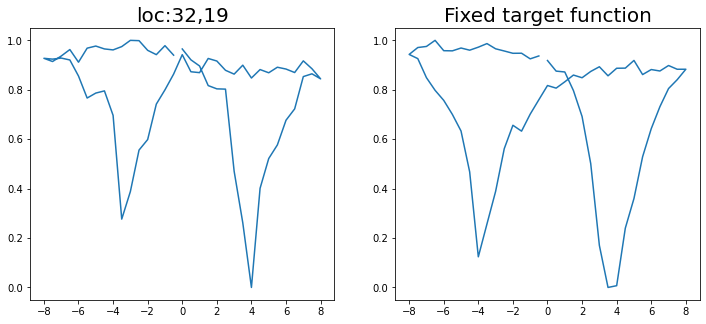

Epoch 1/200 ... Training loss: 2.3963
Epoch 10/200 ... Training loss: 2.2318
Epoch 20/200 ... Training loss: 2.0688
Epoch 30/200 ... Training loss: 1.9273
Epoch 40/200 ... Training loss: 1.855
Epoch 50/200 ... Training loss: 1.7718
Epoch 60/200 ... Training loss: 1.6793
Epoch 70/200 ... Training loss: 1.5556
Epoch 80/200 ... Training loss: 1.5991
Epoch 90/200 ... Training loss: 1.4008
Epoch 100/200 ... Training loss: 1.3028
Epoch 110/200 ... Training loss: 1.2957
Epoch 120/200 ... Training loss: 1.2208
Epoch 130/200 ... Training loss: 1.1619
Epoch 140/200 ... Training loss: 1.1114
Epoch 150/200 ... Training loss: 1.0801
Epoch 160/200 ... Training loss: 1.063
Epoch 170/200 ... Training loss: 1.0046
Epoch 180/200 ... Training loss: 0.94
Epoch 190/200 ... Training loss: 0.927
Epoch 200/200 ... Training loss: 0.8495
step:  88
Sample #98




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


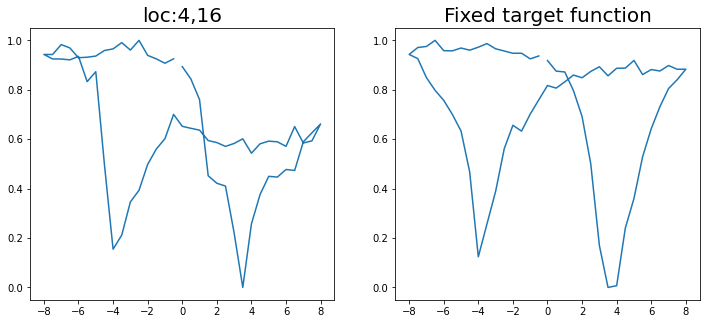

Epoch 1/200 ... Training loss: 2.3796
Epoch 10/200 ... Training loss: 2.2831
Epoch 20/200 ... Training loss: 2.08
Epoch 30/200 ... Training loss: 1.9163
Epoch 40/200 ... Training loss: 1.8401
Epoch 50/200 ... Training loss: 1.7688
Epoch 60/200 ... Training loss: 1.6949
Epoch 70/200 ... Training loss: 1.592
Epoch 80/200 ... Training loss: 1.5165
Epoch 90/200 ... Training loss: 1.3641
Epoch 100/200 ... Training loss: 1.2972
Epoch 110/200 ... Training loss: 1.2227
Epoch 120/200 ... Training loss: 1.3136
Epoch 130/200 ... Training loss: 1.1257
Epoch 140/200 ... Training loss: 1.1852
Epoch 150/200 ... Training loss: 1.0942
Epoch 160/200 ... Training loss: 0.9865
Epoch 170/200 ... Training loss: 0.9444
Epoch 180/200 ... Training loss: 0.9125
Epoch 190/200 ... Training loss: 0.8363
Epoch 200/200 ... Training loss: 0.8521
step:  89
Sample #99




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


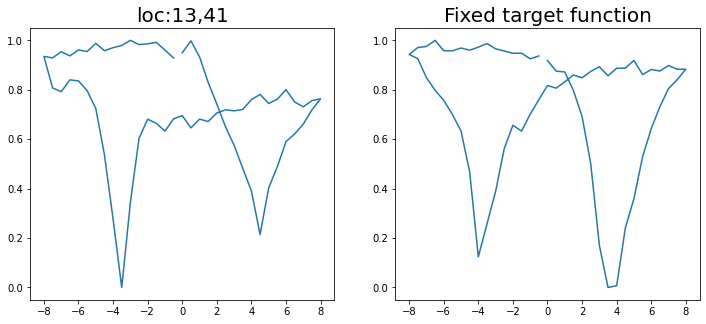

Epoch 1/200 ... Training loss: 2.3669
Epoch 10/200 ... Training loss: 2.0974
Epoch 20/200 ... Training loss: 1.9246
Epoch 30/200 ... Training loss: 1.7582
Epoch 40/200 ... Training loss: 1.5896
Epoch 50/200 ... Training loss: 1.4394
Epoch 60/200 ... Training loss: 1.3197
Epoch 70/200 ... Training loss: 1.2789
Epoch 80/200 ... Training loss: 1.1792
Epoch 90/200 ... Training loss: 1.145
Epoch 100/200 ... Training loss: 1.1535
Epoch 110/200 ... Training loss: 1.0806
Epoch 120/200 ... Training loss: 1.0113
Epoch 130/200 ... Training loss: 1.0147
Epoch 140/200 ... Training loss: 0.9175
Epoch 150/200 ... Training loss: 0.8143
Epoch 160/200 ... Training loss: 0.8388
Epoch 170/200 ... Training loss: 0.8596
Epoch 180/200 ... Training loss: 0.7051
Epoch 190/200 ... Training loss: 0.6631
Epoch 200/200 ... Training loss: 0.5813
step:  90
Sample #100




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


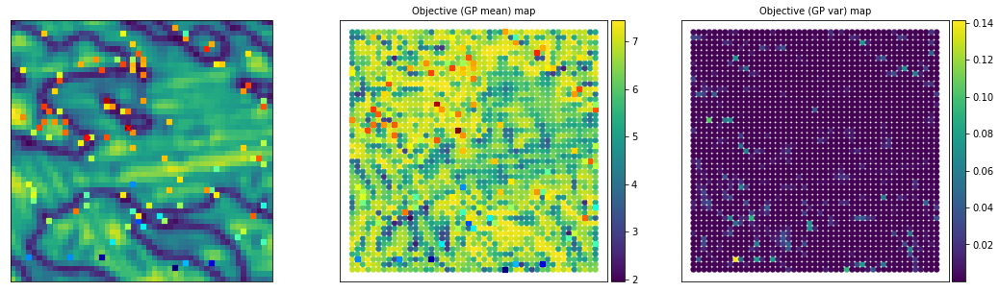

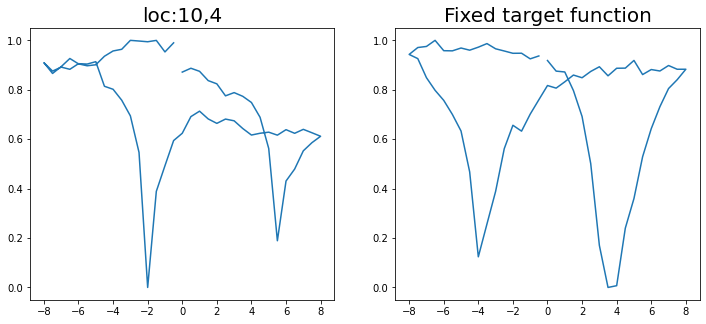

Epoch 1/200 ... Training loss: 2.4202
Epoch 10/200 ... Training loss: 2.2198
Epoch 20/200 ... Training loss: 2.1213
Epoch 30/200 ... Training loss: 1.9562
Epoch 40/200 ... Training loss: 1.8935
Epoch 50/200 ... Training loss: 1.8315
Epoch 60/200 ... Training loss: 1.731
Epoch 70/200 ... Training loss: 1.5445
Epoch 80/200 ... Training loss: 1.4189
Epoch 90/200 ... Training loss: 1.3317
Epoch 100/200 ... Training loss: 1.312
Epoch 110/200 ... Training loss: 1.2183
Epoch 120/200 ... Training loss: 1.2474
Epoch 130/200 ... Training loss: 1.1023
Epoch 140/200 ... Training loss: 1.0982
Epoch 150/200 ... Training loss: 1.0628
Epoch 160/200 ... Training loss: 0.9695
Epoch 170/200 ... Training loss: 0.9266
Epoch 180/200 ... Training loss: 0.8664
Epoch 190/200 ... Training loss: 0.9462
Epoch 200/200 ... Training loss: 0.7954
step:  91
Sample #101




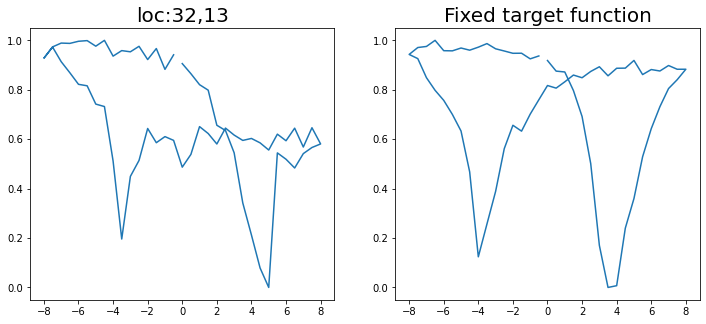

Epoch 1/200 ... Training loss: 2.4055
Epoch 10/200 ... Training loss: 2.1398
Epoch 20/200 ... Training loss: 1.9671
Epoch 30/200 ... Training loss: 1.7059
Epoch 40/200 ... Training loss: 1.513
Epoch 50/200 ... Training loss: 1.5319
Epoch 60/200 ... Training loss: 1.3611
Epoch 70/200 ... Training loss: 1.2639
Epoch 80/200 ... Training loss: 1.2444
Epoch 90/200 ... Training loss: 1.1586
Epoch 100/200 ... Training loss: 1.0858
Epoch 110/200 ... Training loss: 1.0011
Epoch 120/200 ... Training loss: 1.1186
Epoch 130/200 ... Training loss: 0.9777
Epoch 140/200 ... Training loss: 0.8907
Epoch 150/200 ... Training loss: 1.1267
Epoch 160/200 ... Training loss: 1.0098
Epoch 170/200 ... Training loss: 0.8273
Epoch 180/200 ... Training loss: 0.7345
Epoch 190/200 ... Training loss: 0.7974
Epoch 200/200 ... Training loss: 0.6167
step:  92
Sample #102




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


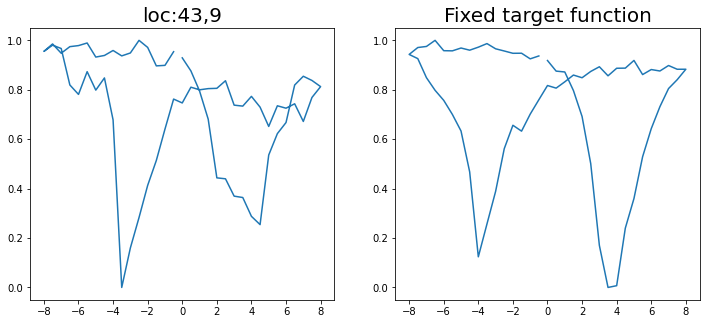

Epoch 1/200 ... Training loss: 2.4115
Epoch 10/200 ... Training loss: 2.1574
Epoch 20/200 ... Training loss: 1.9595
Epoch 30/200 ... Training loss: 1.8392
Epoch 40/200 ... Training loss: 1.5744
Epoch 50/200 ... Training loss: 1.4239
Epoch 60/200 ... Training loss: 1.3479
Epoch 70/200 ... Training loss: 1.3461
Epoch 80/200 ... Training loss: 1.2239
Epoch 90/200 ... Training loss: 1.1881
Epoch 100/200 ... Training loss: 1.1255
Epoch 110/200 ... Training loss: 1.0752
Epoch 120/200 ... Training loss: 1.0319
Epoch 130/200 ... Training loss: 0.9813
Epoch 140/200 ... Training loss: 0.8806
Epoch 150/200 ... Training loss: 0.8401
Epoch 160/200 ... Training loss: 0.7668
Epoch 170/200 ... Training loss: 0.7133
Epoch 180/200 ... Training loss: 0.7227
Epoch 190/200 ... Training loss: 0.6825
Epoch 200/200 ... Training loss: 0.6287
step:  93
Sample #103




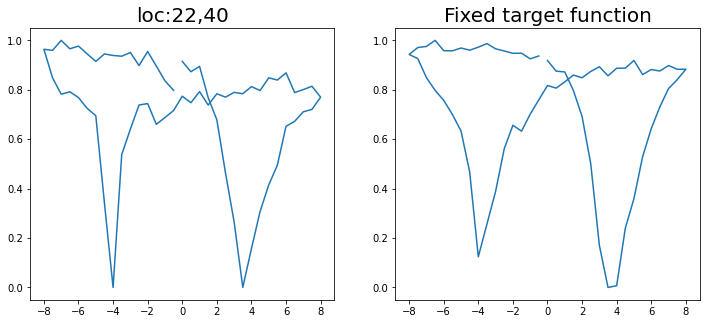

Epoch 1/200 ... Training loss: 2.4121
Epoch 10/200 ... Training loss: 2.2322
Epoch 20/200 ... Training loss: 2.0724
Epoch 30/200 ... Training loss: 1.9272
Epoch 40/200 ... Training loss: 1.8645
Epoch 50/200 ... Training loss: 1.7971
Epoch 60/200 ... Training loss: 1.6625
Epoch 70/200 ... Training loss: 1.483
Epoch 80/200 ... Training loss: 1.3673
Epoch 90/200 ... Training loss: 1.3084
Epoch 100/200 ... Training loss: 1.3046
Epoch 110/200 ... Training loss: 1.2157
Epoch 120/200 ... Training loss: 1.1209
Epoch 130/200 ... Training loss: 1.1572
Epoch 140/200 ... Training loss: 1.0769
Epoch 150/200 ... Training loss: 1.0065
Epoch 160/200 ... Training loss: 1.0107
Epoch 170/200 ... Training loss: 0.9778
Epoch 180/200 ... Training loss: 0.8858
Epoch 190/200 ... Training loss: 0.8714
Epoch 200/200 ... Training loss: 0.7764
step:  94
Sample #104




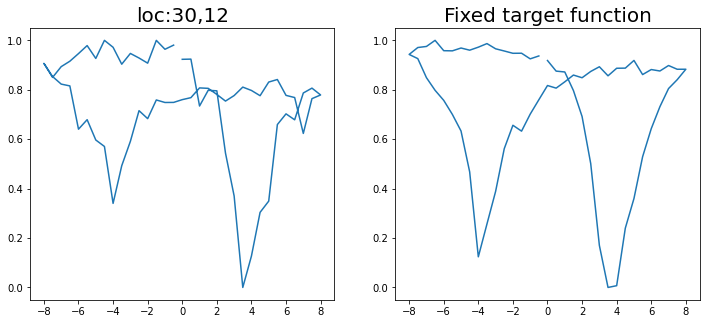

Epoch 1/200 ... Training loss: 2.3968
Epoch 10/200 ... Training loss: 2.229
Epoch 20/200 ... Training loss: 2.0426
Epoch 30/200 ... Training loss: 1.9275
Epoch 40/200 ... Training loss: 1.8482
Epoch 50/200 ... Training loss: 1.6972
Epoch 60/200 ... Training loss: 1.4874
Epoch 70/200 ... Training loss: 1.3692
Epoch 80/200 ... Training loss: 1.2971
Epoch 90/200 ... Training loss: 1.2312
Epoch 100/200 ... Training loss: 1.2296
Epoch 110/200 ... Training loss: 1.1373
Epoch 120/200 ... Training loss: 1.0736
Epoch 130/200 ... Training loss: 1.0941
Epoch 140/200 ... Training loss: 1.001
Epoch 150/200 ... Training loss: 1.0056
Epoch 160/200 ... Training loss: 0.9172
Epoch 170/200 ... Training loss: 0.8502
Epoch 180/200 ... Training loss: 0.7831
Epoch 190/200 ... Training loss: 0.7503
Epoch 200/200 ... Training loss: 0.6964
step:  95
Sample #105




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


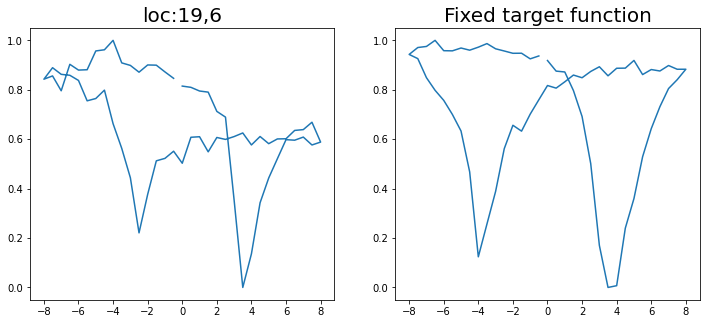

Epoch 1/200 ... Training loss: 2.3921
Epoch 10/200 ... Training loss: 2.1943
Epoch 20/200 ... Training loss: 1.9837
Epoch 30/200 ... Training loss: 1.877
Epoch 40/200 ... Training loss: 1.7711
Epoch 50/200 ... Training loss: 1.6391
Epoch 60/200 ... Training loss: 1.486
Epoch 70/200 ... Training loss: 1.3964
Epoch 80/200 ... Training loss: 1.2542
Epoch 90/200 ... Training loss: 1.2258
Epoch 100/200 ... Training loss: 1.1111
Epoch 110/200 ... Training loss: 1.0879
Epoch 120/200 ... Training loss: 1.0306
Epoch 130/200 ... Training loss: 0.9834
Epoch 140/200 ... Training loss: 0.9373
Epoch 150/200 ... Training loss: 0.8676
Epoch 160/200 ... Training loss: 0.8401
Epoch 170/200 ... Training loss: 0.7545
Epoch 180/200 ... Training loss: 0.7259
Epoch 190/200 ... Training loss: 0.6758
Epoch 200/200 ... Training loss: 0.6232
step:  96
Sample #106




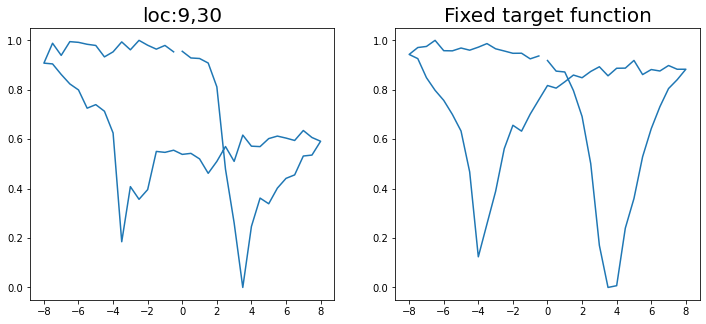

Epoch 1/200 ... Training loss: 2.3779
Epoch 10/200 ... Training loss: 2.1817
Epoch 20/200 ... Training loss: 1.9977
Epoch 30/200 ... Training loss: 1.8404
Epoch 40/200 ... Training loss: 1.7664
Epoch 50/200 ... Training loss: 1.6402
Epoch 60/200 ... Training loss: 1.4978
Epoch 70/200 ... Training loss: 1.3921
Epoch 80/200 ... Training loss: 1.2894
Epoch 90/200 ... Training loss: 1.2134
Epoch 100/200 ... Training loss: 1.1364
Epoch 110/200 ... Training loss: 1.0633
Epoch 120/200 ... Training loss: 1.0327
Epoch 130/200 ... Training loss: 0.9605
Epoch 140/200 ... Training loss: 0.9749
Epoch 150/200 ... Training loss: 0.8757
Epoch 160/200 ... Training loss: 0.8071
Epoch 170/200 ... Training loss: 0.8069
Epoch 180/200 ... Training loss: 0.7237
Epoch 190/200 ... Training loss: 0.6887
Epoch 200/200 ... Training loss: 0.6925
step:  97
Sample #107




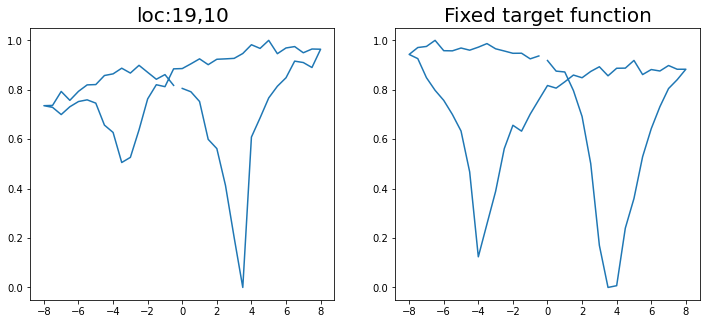

Epoch 1/200 ... Training loss: 2.3662
Epoch 10/200 ... Training loss: 2.1885
Epoch 20/200 ... Training loss: 1.9685
Epoch 30/200 ... Training loss: 1.8819
Epoch 40/200 ... Training loss: 1.8137
Epoch 50/200 ... Training loss: 1.7081
Epoch 60/200 ... Training loss: 1.5007
Epoch 70/200 ... Training loss: 1.3744
Epoch 80/200 ... Training loss: 1.3253
Epoch 90/200 ... Training loss: 1.2297
Epoch 100/200 ... Training loss: 1.263
Epoch 110/200 ... Training loss: 1.1415
Epoch 120/200 ... Training loss: 1.0615
Epoch 130/200 ... Training loss: 1.0494
Epoch 140/200 ... Training loss: 1.0038
Epoch 150/200 ... Training loss: 0.9195
Epoch 160/200 ... Training loss: 0.8938
Epoch 170/200 ... Training loss: 0.8399
Epoch 180/200 ... Training loss: 0.8262
Epoch 190/200 ... Training loss: 0.7323
Epoch 200/200 ... Training loss: 0.6684
step:  98
Sample #108




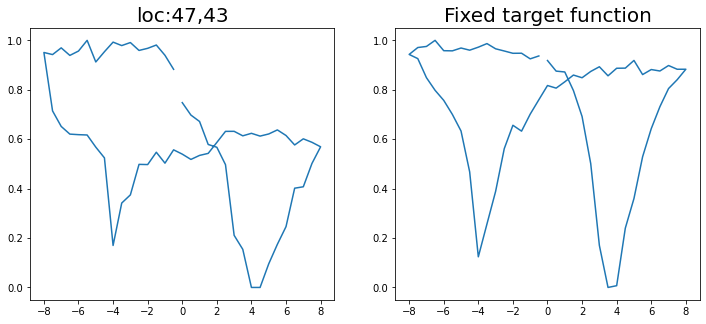

Epoch 1/200 ... Training loss: 2.359
Epoch 10/200 ... Training loss: 2.183
Epoch 20/200 ... Training loss: 2.0604
Epoch 30/200 ... Training loss: 1.8951
Epoch 40/200 ... Training loss: 1.8434
Epoch 50/200 ... Training loss: 1.7891
Epoch 60/200 ... Training loss: 1.7286
Epoch 70/200 ... Training loss: 1.5961
Epoch 80/200 ... Training loss: 1.43
Epoch 90/200 ... Training loss: 1.3164
Epoch 100/200 ... Training loss: 1.259
Epoch 110/200 ... Training loss: 1.2118
Epoch 120/200 ... Training loss: 1.1593
Epoch 130/200 ... Training loss: 1.1257
Epoch 140/200 ... Training loss: 1.0569
Epoch 150/200 ... Training loss: 1.0073
Epoch 160/200 ... Training loss: 0.9531
Epoch 170/200 ... Training loss: 0.9053
Epoch 180/200 ... Training loss: 0.8685
Epoch 190/200 ... Training loss: 0.8352
Epoch 200/200 ... Training loss: 0.7729
step:  99
Sample #109




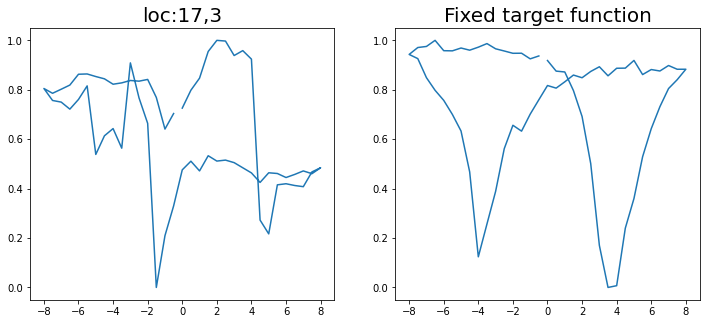

Epoch 1/200 ... Training loss: 2.4097
Epoch 10/200 ... Training loss: 2.0334
Epoch 20/200 ... Training loss: 1.9526
Epoch 30/200 ... Training loss: 1.8297
Epoch 40/200 ... Training loss: 1.7145
Epoch 50/200 ... Training loss: 1.5037
Epoch 60/200 ... Training loss: 1.369
Epoch 70/200 ... Training loss: 1.2994
Epoch 80/200 ... Training loss: 1.2637
Epoch 90/200 ... Training loss: 1.1307
Epoch 100/200 ... Training loss: 1.1572
Epoch 110/200 ... Training loss: 1.0746
Epoch 120/200 ... Training loss: 0.9724
Epoch 130/200 ... Training loss: 0.9657
Epoch 140/200 ... Training loss: 0.8984
Epoch 150/200 ... Training loss: 0.825
Epoch 160/200 ... Training loss: 0.7701
Epoch 170/200 ... Training loss: 0.8519
Epoch 180/200 ... Training loss: 0.6978
Epoch 190/200 ... Training loss: 0.6559
Epoch 200/200 ... Training loss: 0.5409
step:  100
Sample #110




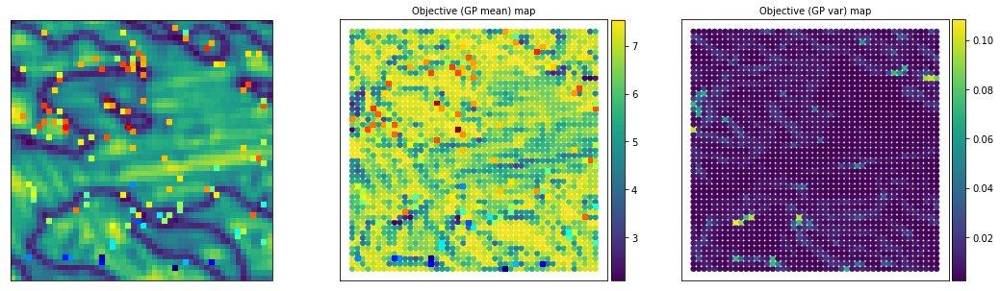

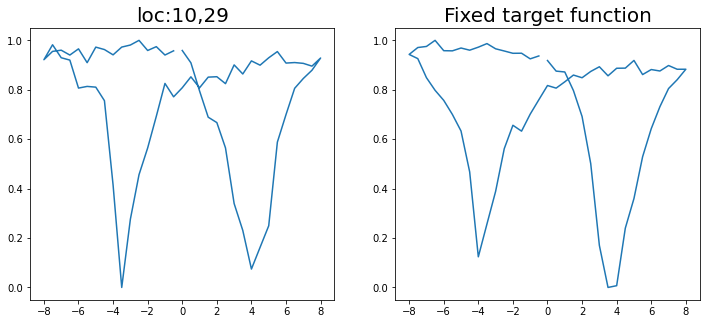

Epoch 1/200 ... Training loss: 2.4039
Epoch 10/200 ... Training loss: 2.0957
Epoch 20/200 ... Training loss: 1.9528
Epoch 30/200 ... Training loss: 1.8254
Epoch 40/200 ... Training loss: 1.6493
Epoch 50/200 ... Training loss: 1.5264
Epoch 60/200 ... Training loss: 1.3537
Epoch 70/200 ... Training loss: 1.4214
Epoch 80/200 ... Training loss: 1.2681
Epoch 90/200 ... Training loss: 1.1777
Epoch 100/200 ... Training loss: 1.2082
Epoch 110/200 ... Training loss: 1.0576
Epoch 120/200 ... Training loss: 1.0725
Epoch 130/200 ... Training loss: 1.0192
Epoch 140/200 ... Training loss: 0.9594
Epoch 150/200 ... Training loss: 0.8503
Epoch 160/200 ... Training loss: 0.8339
Epoch 170/200 ... Training loss: 0.7728
Epoch 180/200 ... Training loss: 0.6859
Epoch 190/200 ... Training loss: 0.636
Epoch 200/200 ... Training loss: 0.6524
step:  101
Sample #111




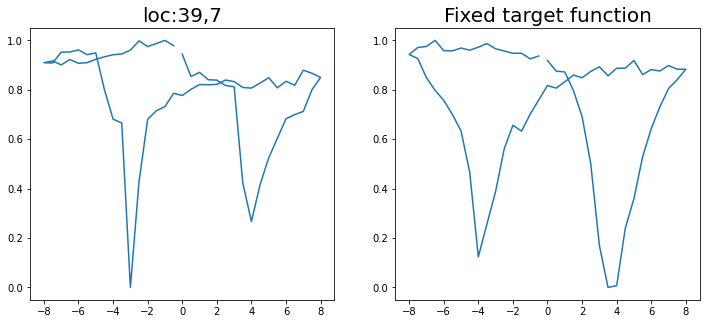

Epoch 1/200 ... Training loss: 2.3895
Epoch 10/200 ... Training loss: 2.1427
Epoch 20/200 ... Training loss: 1.9196
Epoch 30/200 ... Training loss: 1.8586
Epoch 40/200 ... Training loss: 1.7338
Epoch 50/200 ... Training loss: 1.5514
Epoch 60/200 ... Training loss: 1.3781
Epoch 70/200 ... Training loss: 1.2965
Epoch 80/200 ... Training loss: 1.2216
Epoch 90/200 ... Training loss: 1.1398
Epoch 100/200 ... Training loss: 1.0942
Epoch 110/200 ... Training loss: 1.0753
Epoch 120/200 ... Training loss: 1.0002
Epoch 130/200 ... Training loss: 0.9422
Epoch 140/200 ... Training loss: 0.9029
Epoch 150/200 ... Training loss: 0.9409
Epoch 160/200 ... Training loss: 0.8114
Epoch 170/200 ... Training loss: 0.7212
Epoch 180/200 ... Training loss: 0.9106
Epoch 190/200 ... Training loss: 0.6971
Epoch 200/200 ... Training loss: 0.6521
step:  102
Sample #112




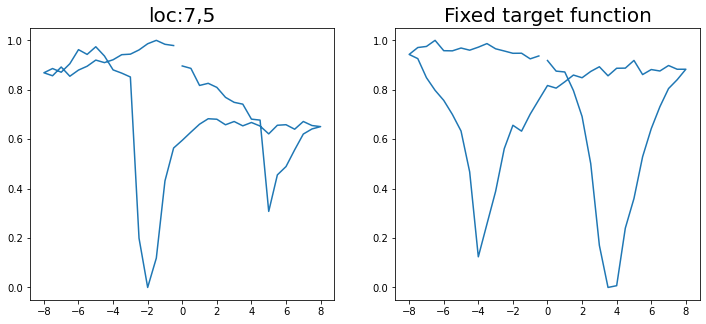

Epoch 1/200 ... Training loss: 2.4565
Epoch 10/200 ... Training loss: 2.3802
Epoch 20/200 ... Training loss: 2.1947
Epoch 30/200 ... Training loss: 2.0558
Epoch 40/200 ... Training loss: 1.9353
Epoch 50/200 ... Training loss: 1.8802
Epoch 60/200 ... Training loss: 1.836
Epoch 70/200 ... Training loss: 1.799
Epoch 80/200 ... Training loss: 1.7665
Epoch 90/200 ... Training loss: 1.7192
Epoch 100/200 ... Training loss: 1.6521
Epoch 110/200 ... Training loss: 1.5029
Epoch 120/200 ... Training loss: 1.4234
Epoch 130/200 ... Training loss: 1.3158
Epoch 140/200 ... Training loss: 1.2887
Epoch 150/200 ... Training loss: 1.2187
Epoch 160/200 ... Training loss: 1.1704
Epoch 170/200 ... Training loss: 1.1168
Epoch 180/200 ... Training loss: 1.0721
Epoch 190/200 ... Training loss: 1.0696
Epoch 200/200 ... Training loss: 1.0251
step:  103
Sample #113




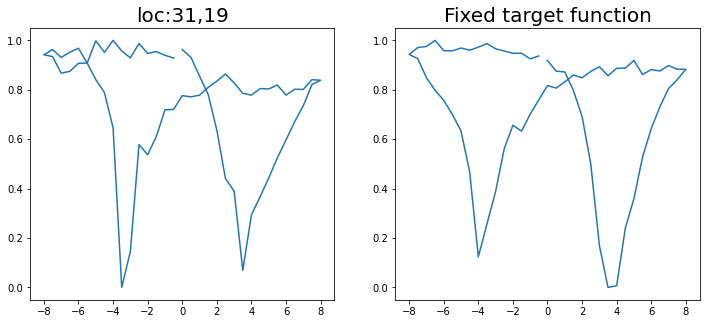

Epoch 1/200 ... Training loss: 2.4453
Epoch 10/200 ... Training loss: 2.2613
Epoch 20/200 ... Training loss: 1.9632
Epoch 30/200 ... Training loss: 1.8252
Epoch 40/200 ... Training loss: 1.7547
Epoch 50/200 ... Training loss: 1.5387
Epoch 60/200 ... Training loss: 1.3894
Epoch 70/200 ... Training loss: 1.348
Epoch 80/200 ... Training loss: 1.3216
Epoch 90/200 ... Training loss: 1.3
Epoch 100/200 ... Training loss: 1.2009
Epoch 110/200 ... Training loss: 1.1117
Epoch 120/200 ... Training loss: 1.1178
Epoch 130/200 ... Training loss: 1.0353
Epoch 140/200 ... Training loss: 1.0089
Epoch 150/200 ... Training loss: 0.9043
Epoch 160/200 ... Training loss: 0.8157
Epoch 170/200 ... Training loss: 0.7668
Epoch 180/200 ... Training loss: 0.7039
Epoch 190/200 ... Training loss: 0.6491
Epoch 200/200 ... Training loss: 0.657
step:  104
Sample #114




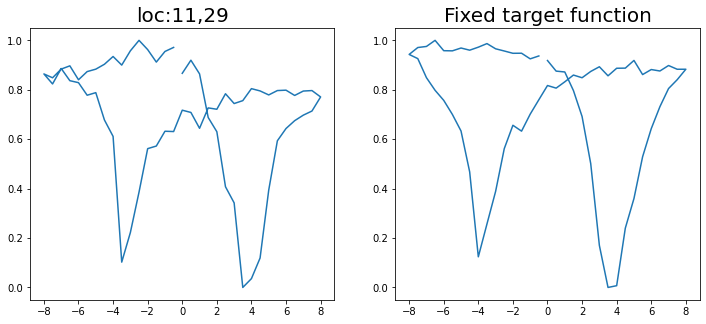

Epoch 1/200 ... Training loss: 2.432
Epoch 10/200 ... Training loss: 2.2782
Epoch 20/200 ... Training loss: 2.0897
Epoch 30/200 ... Training loss: 1.8896
Epoch 40/200 ... Training loss: 1.7758
Epoch 50/200 ... Training loss: 1.6094
Epoch 60/200 ... Training loss: 1.4218
Epoch 70/200 ... Training loss: 1.3456
Epoch 80/200 ... Training loss: 1.2353
Epoch 90/200 ... Training loss: 1.2296
Epoch 100/200 ... Training loss: 1.2813
Epoch 110/200 ... Training loss: 1.2604
Epoch 120/200 ... Training loss: 1.3162
Epoch 130/200 ... Training loss: 1.1573
Epoch 140/200 ... Training loss: 1.151
Epoch 150/200 ... Training loss: 1.0309
Epoch 160/200 ... Training loss: 0.9553
Epoch 170/200 ... Training loss: 1.0405
Epoch 180/200 ... Training loss: 0.89
Epoch 190/200 ... Training loss: 0.7837
Epoch 200/200 ... Training loss: 0.7583
step:  105
Sample #115




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


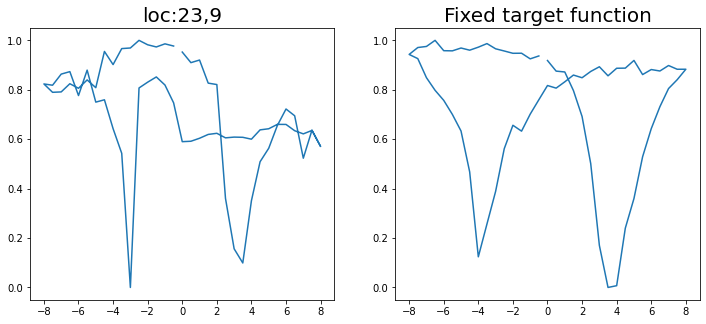

Epoch 1/200 ... Training loss: 2.4853
Epoch 10/200 ... Training loss: 2.4213
Epoch 20/200 ... Training loss: 2.1503
Epoch 30/200 ... Training loss: 1.9924
Epoch 40/200 ... Training loss: 1.8925
Epoch 50/200 ... Training loss: 1.8159
Epoch 60/200 ... Training loss: 1.691
Epoch 70/200 ... Training loss: 1.559
Epoch 80/200 ... Training loss: 1.4667
Epoch 90/200 ... Training loss: 1.3781
Epoch 100/200 ... Training loss: 1.293
Epoch 110/200 ... Training loss: 1.2186
Epoch 120/200 ... Training loss: 1.166
Epoch 130/200 ... Training loss: 1.0822
Epoch 140/200 ... Training loss: 1.0453
Epoch 150/200 ... Training loss: 1.0531
Epoch 160/200 ... Training loss: 0.963
Epoch 170/200 ... Training loss: 0.9332
Epoch 180/200 ... Training loss: 1.018
Epoch 190/200 ... Training loss: 0.8809
Epoch 200/200 ... Training loss: 0.8593
step:  106
Sample #116




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


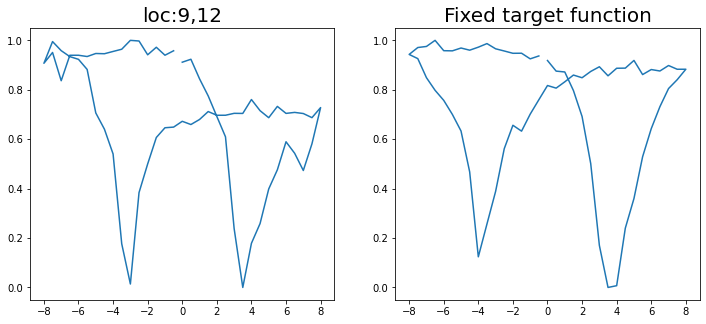

Epoch 1/200 ... Training loss: 2.4703
Epoch 10/200 ... Training loss: 2.3949
Epoch 20/200 ... Training loss: 2.2314
Epoch 30/200 ... Training loss: 2.1087
Epoch 40/200 ... Training loss: 1.9697
Epoch 50/200 ... Training loss: 1.9011
Epoch 60/200 ... Training loss: 1.8522
Epoch 70/200 ... Training loss: 1.8022
Epoch 80/200 ... Training loss: 1.7321
Epoch 90/200 ... Training loss: 1.5778
Epoch 100/200 ... Training loss: 1.524
Epoch 110/200 ... Training loss: 1.3655
Epoch 120/200 ... Training loss: 1.3049
Epoch 130/200 ... Training loss: 1.2463
Epoch 140/200 ... Training loss: 1.2176
Epoch 150/200 ... Training loss: 1.1574
Epoch 160/200 ... Training loss: 1.0891
Epoch 170/200 ... Training loss: 1.2878
Epoch 180/200 ... Training loss: 1.0722
Epoch 190/200 ... Training loss: 0.9995
Epoch 200/200 ... Training loss: 0.9377
step:  107
Sample #117




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


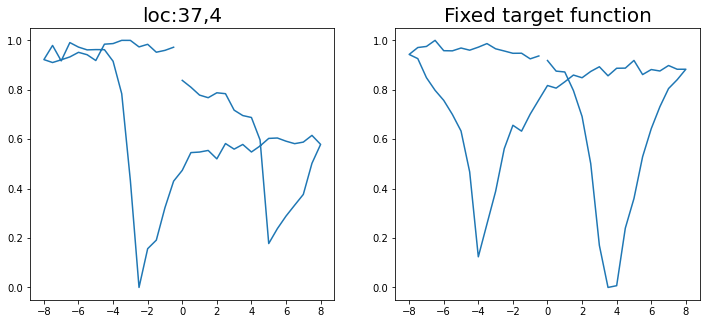

Epoch 1/200 ... Training loss: 2.5095
Epoch 10/200 ... Training loss: 2.3277
Epoch 20/200 ... Training loss: 2.0846
Epoch 30/200 ... Training loss: 1.9002
Epoch 40/200 ... Training loss: 1.7163
Epoch 50/200 ... Training loss: 1.5459
Epoch 60/200 ... Training loss: 1.5604
Epoch 70/200 ... Training loss: 1.3991
Epoch 80/200 ... Training loss: 1.3233
Epoch 90/200 ... Training loss: 1.2271
Epoch 100/200 ... Training loss: 1.1328
Epoch 110/200 ... Training loss: 1.1584
Epoch 120/200 ... Training loss: 1.0446
Epoch 130/200 ... Training loss: 0.9876
Epoch 140/200 ... Training loss: 1.0408
Epoch 150/200 ... Training loss: 0.9206
Epoch 160/200 ... Training loss: 0.8554
Epoch 170/200 ... Training loss: 0.8289
Epoch 180/200 ... Training loss: 0.8607
Epoch 190/200 ... Training loss: 0.7694
Epoch 200/200 ... Training loss: 0.7246
step:  108
Sample #118




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


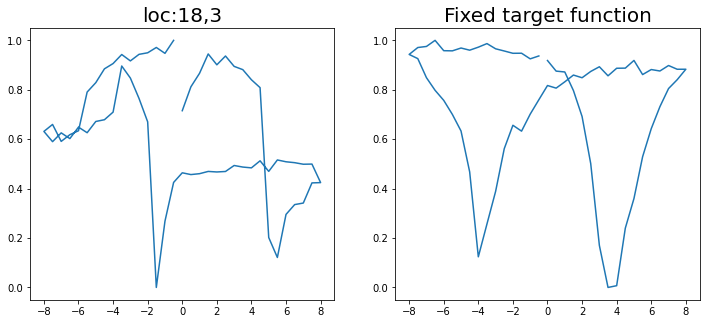

Epoch 1/200 ... Training loss: 2.6357
Epoch 10/200 ... Training loss: 2.2674
Epoch 20/200 ... Training loss: 2.0863
Epoch 30/200 ... Training loss: 1.9447
Epoch 40/200 ... Training loss: 1.9275
Epoch 50/200 ... Training loss: 1.7671
Epoch 60/200 ... Training loss: 1.5305
Epoch 70/200 ... Training loss: 1.441
Epoch 80/200 ... Training loss: 1.4018
Epoch 90/200 ... Training loss: 1.275
Epoch 100/200 ... Training loss: 1.1711
Epoch 110/200 ... Training loss: 1.1282
Epoch 120/200 ... Training loss: 1.0925
Epoch 130/200 ... Training loss: 1.0505
Epoch 140/200 ... Training loss: 1.0307
Epoch 150/200 ... Training loss: 0.9398
Epoch 160/200 ... Training loss: 0.8868
Epoch 170/200 ... Training loss: 0.9167
Epoch 180/200 ... Training loss: 0.8516
Epoch 190/200 ... Training loss: 0.7652
Epoch 200/200 ... Training loss: 0.7381
step:  109
Sample #119




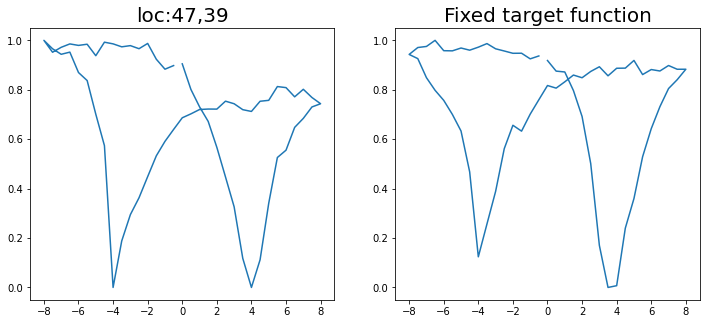

Epoch 1/200 ... Training loss: 2.6485
Epoch 10/200 ... Training loss: 2.5247
Epoch 20/200 ... Training loss: 2.1543
Epoch 30/200 ... Training loss: 2.047
Epoch 40/200 ... Training loss: 1.8934
Epoch 50/200 ... Training loss: 1.7764
Epoch 60/200 ... Training loss: 1.5713
Epoch 70/200 ... Training loss: 1.4507
Epoch 80/200 ... Training loss: 1.432
Epoch 90/200 ... Training loss: 1.3402
Epoch 100/200 ... Training loss: 1.2538
Epoch 110/200 ... Training loss: 1.185
Epoch 120/200 ... Training loss: 1.139
Epoch 130/200 ... Training loss: 1.1157
Epoch 140/200 ... Training loss: 1.1223
Epoch 150/200 ... Training loss: 1.0105
Epoch 160/200 ... Training loss: 1.1168
Epoch 170/200 ... Training loss: 0.9388
Epoch 180/200 ... Training loss: 0.8697
Epoch 190/200 ... Training loss: 0.8136
Epoch 200/200 ... Training loss: 0.8908
step:  110
Sample #120




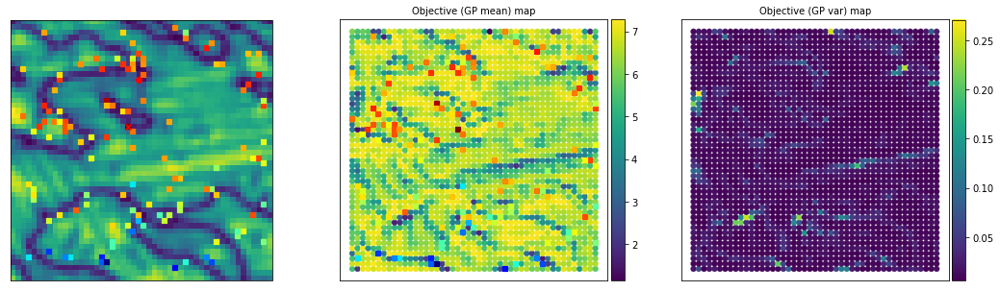

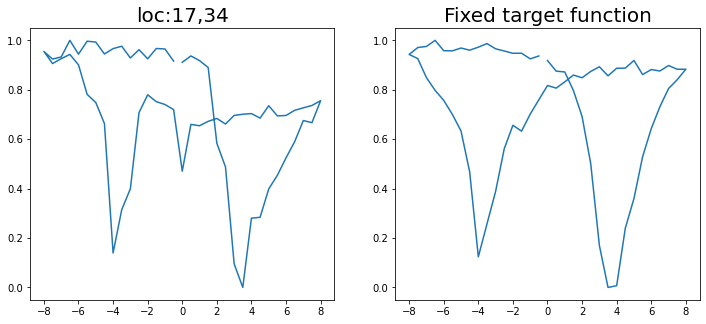

Epoch 1/200 ... Training loss: 2.6371
Epoch 10/200 ... Training loss: 2.4149
Epoch 20/200 ... Training loss: 2.1966
Epoch 30/200 ... Training loss: 2.0285
Epoch 40/200 ... Training loss: 1.8771
Epoch 50/200 ... Training loss: 1.7291
Epoch 60/200 ... Training loss: 1.5397
Epoch 70/200 ... Training loss: 1.472
Epoch 80/200 ... Training loss: 1.3397
Epoch 90/200 ... Training loss: 1.2204
Epoch 100/200 ... Training loss: 1.1608
Epoch 110/200 ... Training loss: 1.1055
Epoch 120/200 ... Training loss: 1.1505
Epoch 130/200 ... Training loss: 1.0716
Epoch 140/200 ... Training loss: 0.9947
Epoch 150/200 ... Training loss: 0.9659
Epoch 160/200 ... Training loss: 0.9219
Epoch 170/200 ... Training loss: 0.8763
Epoch 180/200 ... Training loss: 0.8169
Epoch 190/200 ... Training loss: 0.7709
Epoch 200/200 ... Training loss: 0.7221
step:  111
Sample #121




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


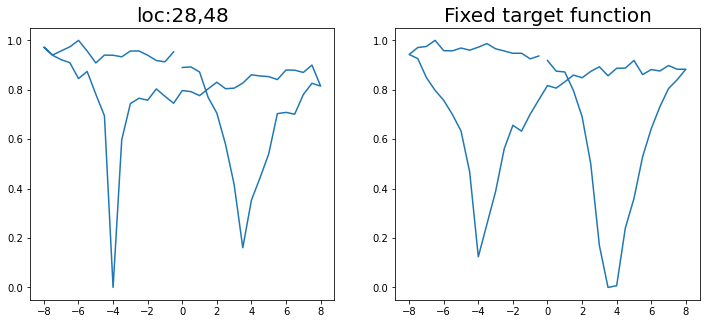

Epoch 1/200 ... Training loss: 2.6278
Epoch 10/200 ... Training loss: 2.5436
Epoch 20/200 ... Training loss: 2.34
Epoch 30/200 ... Training loss: 2.0952
Epoch 40/200 ... Training loss: 1.9442
Epoch 50/200 ... Training loss: 1.8523
Epoch 60/200 ... Training loss: 1.7142
Epoch 70/200 ... Training loss: 1.5476
Epoch 80/200 ... Training loss: 1.4747
Epoch 90/200 ... Training loss: 1.3845
Epoch 100/200 ... Training loss: 1.3057
Epoch 110/200 ... Training loss: 1.2602
Epoch 120/200 ... Training loss: 1.1661
Epoch 130/200 ... Training loss: 1.1308
Epoch 140/200 ... Training loss: 1.0704
Epoch 150/200 ... Training loss: 1.0508
Epoch 160/200 ... Training loss: 1.0341
Epoch 170/200 ... Training loss: 0.9739
Epoch 180/200 ... Training loss: 0.9319
Epoch 190/200 ... Training loss: 0.8798
Epoch 200/200 ... Training loss: 0.8352
step:  112
Sample #122




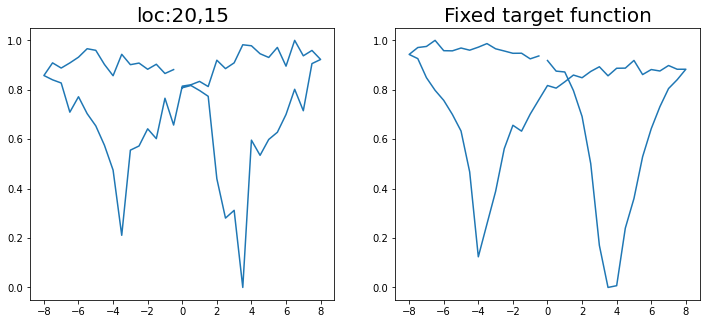

Epoch 1/200 ... Training loss: 2.6124
Epoch 10/200 ... Training loss: 2.5042
Epoch 20/200 ... Training loss: 2.3923
Epoch 30/200 ... Training loss: 2.1989
Epoch 40/200 ... Training loss: 2.038
Epoch 50/200 ... Training loss: 1.9526
Epoch 60/200 ... Training loss: 1.8237
Epoch 70/200 ... Training loss: 1.7192
Epoch 80/200 ... Training loss: 1.591
Epoch 90/200 ... Training loss: 1.4622
Epoch 100/200 ... Training loss: 1.4358
Epoch 110/200 ... Training loss: 1.3474
Epoch 120/200 ... Training loss: 1.3055
Epoch 130/200 ... Training loss: 1.2156
Epoch 140/200 ... Training loss: 1.1648
Epoch 150/200 ... Training loss: 1.1013
Epoch 160/200 ... Training loss: 1.0841
Epoch 170/200 ... Training loss: 1.0273
Epoch 180/200 ... Training loss: 0.9694
Epoch 190/200 ... Training loss: 0.9895
Epoch 200/200 ... Training loss: 0.9042
step:  113
Sample #123




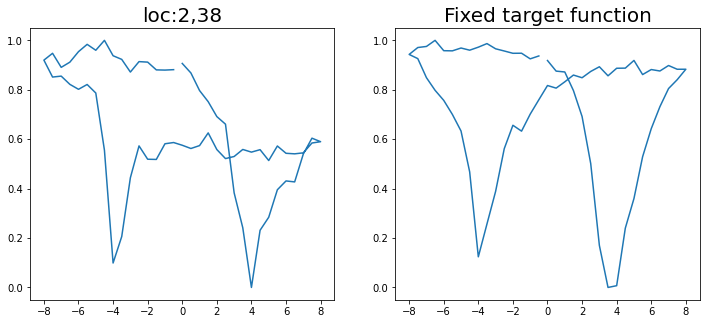

Epoch 1/200 ... Training loss: 2.5991
Epoch 10/200 ... Training loss: 2.3886
Epoch 20/200 ... Training loss: 2.1798
Epoch 30/200 ... Training loss: 1.9949
Epoch 40/200 ... Training loss: 1.9457
Epoch 50/200 ... Training loss: 1.8044
Epoch 60/200 ... Training loss: 1.7003
Epoch 70/200 ... Training loss: 1.5364
Epoch 80/200 ... Training loss: 1.388
Epoch 90/200 ... Training loss: 1.3808
Epoch 100/200 ... Training loss: 1.2995
Epoch 110/200 ... Training loss: 1.2174
Epoch 120/200 ... Training loss: 1.1379
Epoch 130/200 ... Training loss: 1.2625
Epoch 140/200 ... Training loss: 1.1219
Epoch 150/200 ... Training loss: 1.0221
Epoch 160/200 ... Training loss: 0.959
Epoch 170/200 ... Training loss: 0.915
Epoch 180/200 ... Training loss: 0.8613
Epoch 190/200 ... Training loss: 0.8684
Epoch 200/200 ... Training loss: 0.9094
step:  114
Sample #124




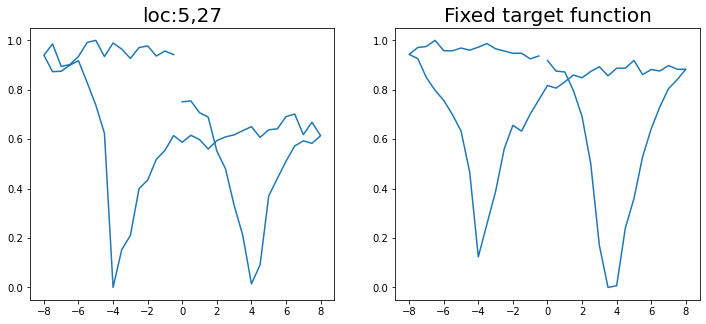

Epoch 1/200 ... Training loss: 2.5855
Epoch 10/200 ... Training loss: 2.3121
Epoch 20/200 ... Training loss: 1.993
Epoch 30/200 ... Training loss: 1.8072
Epoch 40/200 ... Training loss: 1.7777
Epoch 50/200 ... Training loss: 1.5183
Epoch 60/200 ... Training loss: 1.4136
Epoch 70/200 ... Training loss: 1.3088
Epoch 80/200 ... Training loss: 1.2457
Epoch 90/200 ... Training loss: 1.1659
Epoch 100/200 ... Training loss: 1.1772
Epoch 110/200 ... Training loss: 1.0712
Epoch 120/200 ... Training loss: 0.9889
Epoch 130/200 ... Training loss: 0.9572
Epoch 140/200 ... Training loss: 0.8812
Epoch 150/200 ... Training loss: 0.8324
Epoch 160/200 ... Training loss: 0.7732
Epoch 170/200 ... Training loss: 0.853
Epoch 180/200 ... Training loss: 0.728
Epoch 190/200 ... Training loss: 0.6517
Epoch 200/200 ... Training loss: 0.5961
step:  115
Sample #125




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


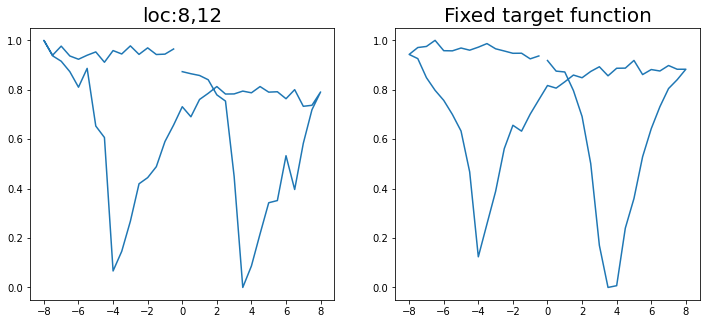

Epoch 1/200 ... Training loss: 2.5802
Epoch 10/200 ... Training loss: 2.4883
Epoch 20/200 ... Training loss: 2.3478
Epoch 30/200 ... Training loss: 2.157
Epoch 40/200 ... Training loss: 2.0429
Epoch 50/200 ... Training loss: 1.9888
Epoch 60/200 ... Training loss: 1.8949
Epoch 70/200 ... Training loss: 1.853
Epoch 80/200 ... Training loss: 1.8159
Epoch 90/200 ... Training loss: 1.7823
Epoch 100/200 ... Training loss: 1.7463
Epoch 110/200 ... Training loss: 1.6348
Epoch 120/200 ... Training loss: 1.5027
Epoch 130/200 ... Training loss: 1.4354
Epoch 140/200 ... Training loss: 1.3592
Epoch 150/200 ... Training loss: 1.2974
Epoch 160/200 ... Training loss: 1.3318
Epoch 170/200 ... Training loss: 1.197
Epoch 180/200 ... Training loss: 1.1436
Epoch 190/200 ... Training loss: 1.1288
Epoch 200/200 ... Training loss: 1.198
step:  116
Sample #126




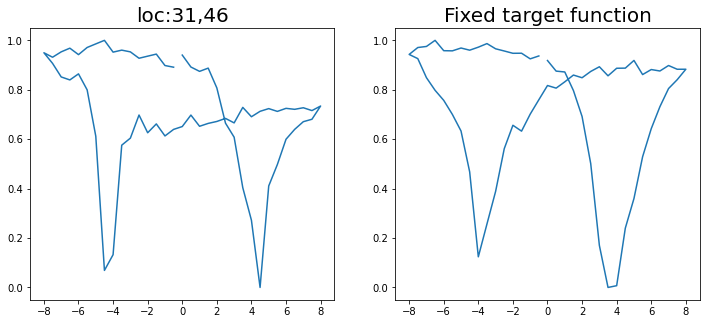

Epoch 1/200 ... Training loss: 2.5676
Epoch 10/200 ... Training loss: 2.3047
Epoch 20/200 ... Training loss: 2.0574
Epoch 30/200 ... Training loss: 1.8495
Epoch 40/200 ... Training loss: 1.7181
Epoch 50/200 ... Training loss: 1.5288
Epoch 60/200 ... Training loss: 1.3928
Epoch 70/200 ... Training loss: 1.398
Epoch 80/200 ... Training loss: 1.3494
Epoch 90/200 ... Training loss: 1.2327
Epoch 100/200 ... Training loss: 1.1458
Epoch 110/200 ... Training loss: 1.0679
Epoch 120/200 ... Training loss: 1.2757
Epoch 130/200 ... Training loss: 1.035
Epoch 140/200 ... Training loss: 0.9588
Epoch 150/200 ... Training loss: 0.9087
Epoch 160/200 ... Training loss: 0.8513
Epoch 170/200 ... Training loss: 0.9034
Epoch 180/200 ... Training loss: 0.8151
Epoch 190/200 ... Training loss: 0.7634
Epoch 200/200 ... Training loss: 0.7713
step:  117
Sample #127




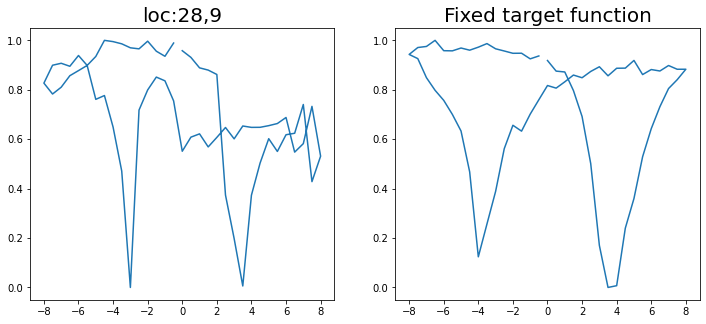

Epoch 1/200 ... Training loss: 2.6052
Epoch 10/200 ... Training loss: 2.5066
Epoch 20/200 ... Training loss: 2.3232
Epoch 30/200 ... Training loss: 2.1009
Epoch 40/200 ... Training loss: 2.011
Epoch 50/200 ... Training loss: 1.9242
Epoch 60/200 ... Training loss: 1.8535
Epoch 70/200 ... Training loss: 1.7522
Epoch 80/200 ... Training loss: 1.6346
Epoch 90/200 ... Training loss: 1.5215
Epoch 100/200 ... Training loss: 1.4797
Epoch 110/200 ... Training loss: 1.3487
Epoch 120/200 ... Training loss: 1.218
Epoch 130/200 ... Training loss: 1.181
Epoch 140/200 ... Training loss: 1.1282
Epoch 150/200 ... Training loss: 1.0836
Epoch 160/200 ... Training loss: 1.0761
Epoch 170/200 ... Training loss: 1.0096
Epoch 180/200 ... Training loss: 0.9722
Epoch 190/200 ... Training loss: 0.9399
Epoch 200/200 ... Training loss: 0.8887
step:  118
Sample #128




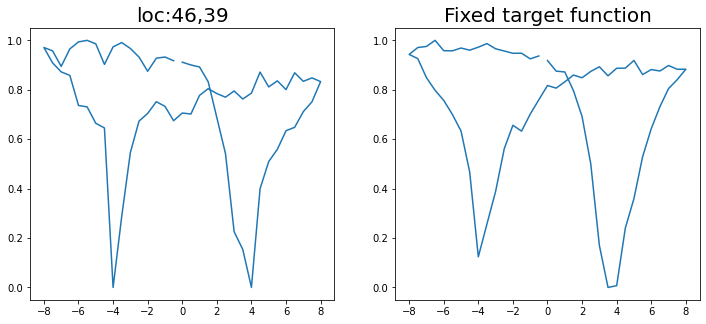

Epoch 1/200 ... Training loss: 2.6041
Epoch 10/200 ... Training loss: 2.3308
Epoch 20/200 ... Training loss: 1.9336
Epoch 30/200 ... Training loss: 1.8359
Epoch 40/200 ... Training loss: 1.6348
Epoch 50/200 ... Training loss: 1.5021
Epoch 60/200 ... Training loss: 1.4102
Epoch 70/200 ... Training loss: 1.2846
Epoch 80/200 ... Training loss: 1.1919
Epoch 90/200 ... Training loss: 1.2001
Epoch 100/200 ... Training loss: 1.0618
Epoch 110/200 ... Training loss: 1.026
Epoch 120/200 ... Training loss: 0.9889
Epoch 130/200 ... Training loss: 0.9601
Epoch 140/200 ... Training loss: 0.8753
Epoch 150/200 ... Training loss: 0.8842
Epoch 160/200 ... Training loss: 0.8068
Epoch 170/200 ... Training loss: 0.75
Epoch 180/200 ... Training loss: 0.704
Epoch 190/200 ... Training loss: 0.6419
Epoch 200/200 ... Training loss: 0.5983
step:  119
Sample #129




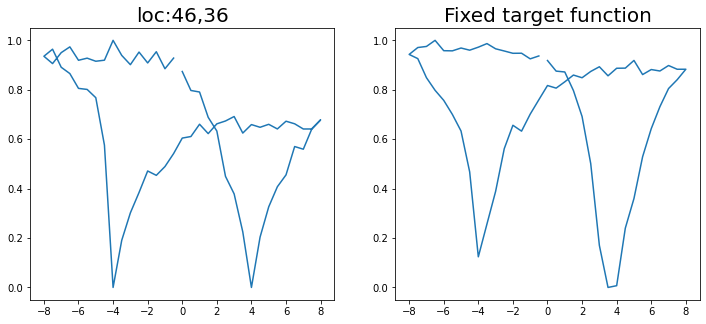

Epoch 1/200 ... Training loss: 2.6129
Epoch 10/200 ... Training loss: 2.3589
Epoch 20/200 ... Training loss: 2.0649
Epoch 30/200 ... Training loss: 1.8901
Epoch 40/200 ... Training loss: 1.7764
Epoch 50/200 ... Training loss: 1.5269
Epoch 60/200 ... Training loss: 1.4105
Epoch 70/200 ... Training loss: 1.3592
Epoch 80/200 ... Training loss: 1.2905
Epoch 90/200 ... Training loss: 1.2331
Epoch 100/200 ... Training loss: 1.1617
Epoch 110/200 ... Training loss: 1.1223
Epoch 120/200 ... Training loss: 1.0348
Epoch 130/200 ... Training loss: 1.045
Epoch 140/200 ... Training loss: 0.9452
Epoch 150/200 ... Training loss: 0.9202
Epoch 160/200 ... Training loss: 0.8654
Epoch 170/200 ... Training loss: 0.8131
Epoch 180/200 ... Training loss: 0.7918
Epoch 190/200 ... Training loss: 0.7066
Epoch 200/200 ... Training loss: 0.6877
step:  120
Sample #130




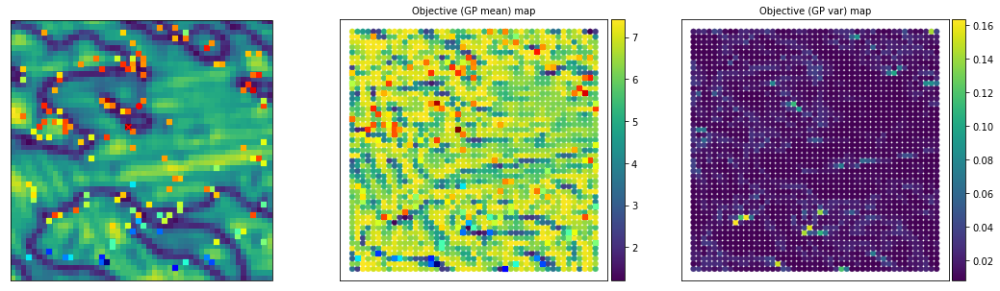

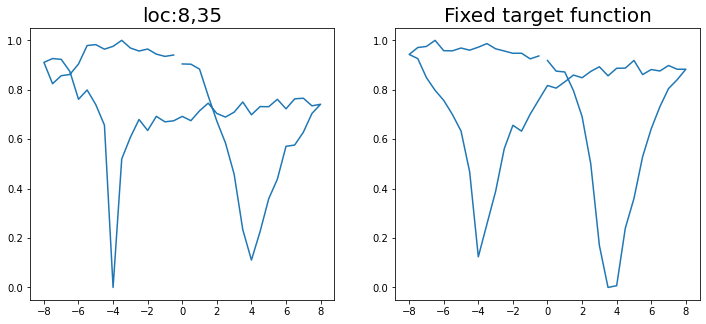

Epoch 1/200 ... Training loss: 2.5987
Epoch 10/200 ... Training loss: 2.4136
Epoch 20/200 ... Training loss: 2.0789
Epoch 30/200 ... Training loss: 1.8927
Epoch 40/200 ... Training loss: 1.7946
Epoch 50/200 ... Training loss: 1.5307
Epoch 60/200 ... Training loss: 1.3991
Epoch 70/200 ... Training loss: 1.3362
Epoch 80/200 ... Training loss: 1.2434
Epoch 90/200 ... Training loss: 1.1604
Epoch 100/200 ... Training loss: 1.0937
Epoch 110/200 ... Training loss: 1.0527
Epoch 120/200 ... Training loss: 1.0061
Epoch 130/200 ... Training loss: 0.9345
Epoch 140/200 ... Training loss: 0.8884
Epoch 150/200 ... Training loss: 0.8528
Epoch 160/200 ... Training loss: 0.8208
Epoch 170/200 ... Training loss: 0.8497
Epoch 180/200 ... Training loss: 0.7413
Epoch 190/200 ... Training loss: 0.6696
Epoch 200/200 ... Training loss: 0.6306
step:  121
Sample #131




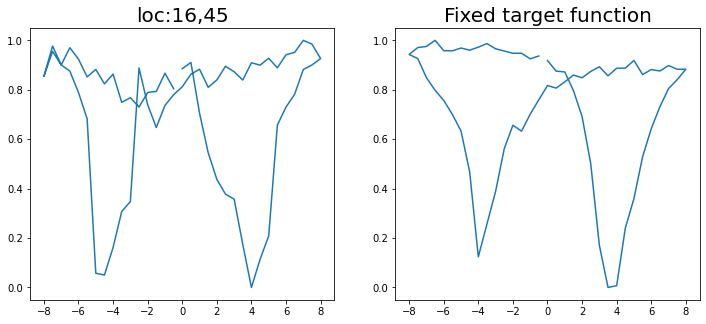

Epoch 1/200 ... Training loss: 2.5849
Epoch 10/200 ... Training loss: 2.2969
Epoch 20/200 ... Training loss: 1.9255
Epoch 30/200 ... Training loss: 1.783
Epoch 40/200 ... Training loss: 1.6698
Epoch 50/200 ... Training loss: 1.4593
Epoch 60/200 ... Training loss: 1.3615
Epoch 70/200 ... Training loss: 1.2409
Epoch 80/200 ... Training loss: 1.2629
Epoch 90/200 ... Training loss: 1.141
Epoch 100/200 ... Training loss: 1.0744
Epoch 110/200 ... Training loss: 1.048
Epoch 120/200 ... Training loss: 0.9697
Epoch 130/200 ... Training loss: 0.9663
Epoch 140/200 ... Training loss: 0.8797
Epoch 150/200 ... Training loss: 0.7935
Epoch 160/200 ... Training loss: 0.8841
Epoch 170/200 ... Training loss: 0.7758
Epoch 180/200 ... Training loss: 0.6794
Epoch 190/200 ... Training loss: 0.6293
Epoch 200/200 ... Training loss: 0.619
step:  122
Sample #132




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


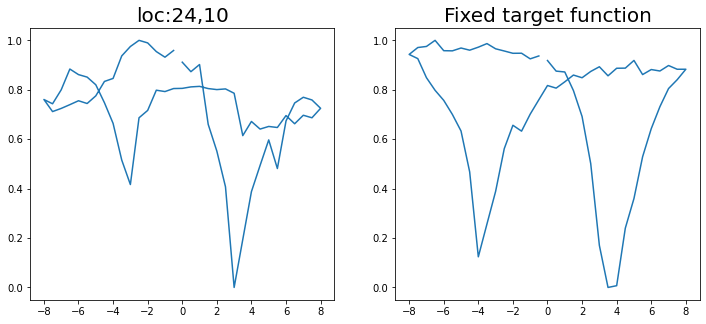

Epoch 1/200 ... Training loss: 2.6091
Epoch 10/200 ... Training loss: 2.4362
Epoch 20/200 ... Training loss: 2.1704
Epoch 30/200 ... Training loss: 1.9803
Epoch 40/200 ... Training loss: 1.9166
Epoch 50/200 ... Training loss: 1.7154
Epoch 60/200 ... Training loss: 1.5074
Epoch 70/200 ... Training loss: 1.4455
Epoch 80/200 ... Training loss: 1.2803
Epoch 90/200 ... Training loss: 1.2295
Epoch 100/200 ... Training loss: 1.1803
Epoch 110/200 ... Training loss: 1.1084
Epoch 120/200 ... Training loss: 1.0891
Epoch 130/200 ... Training loss: 1.0533
Epoch 140/200 ... Training loss: 0.9912
Epoch 150/200 ... Training loss: 0.9518
Epoch 160/200 ... Training loss: 0.9565
Epoch 170/200 ... Training loss: 0.9179
Epoch 180/200 ... Training loss: 0.8991
Epoch 190/200 ... Training loss: 0.9176
Epoch 200/200 ... Training loss: 0.7612
step:  123
Sample #133




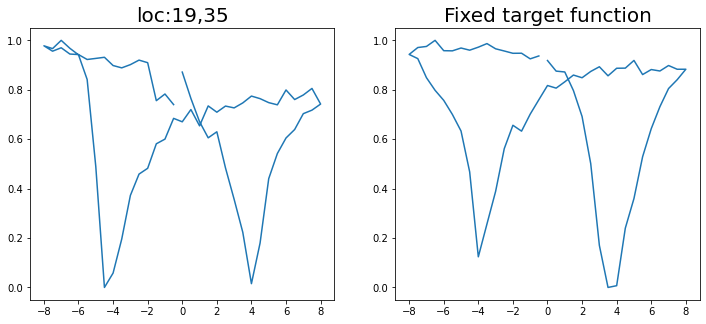

Epoch 1/200 ... Training loss: 2.6017
Epoch 10/200 ... Training loss: 2.3913
Epoch 20/200 ... Training loss: 2.0538
Epoch 30/200 ... Training loss: 1.8582
Epoch 40/200 ... Training loss: 1.7651
Epoch 50/200 ... Training loss: 1.5687
Epoch 60/200 ... Training loss: 1.4371
Epoch 70/200 ... Training loss: 1.2966
Epoch 80/200 ... Training loss: 1.4029
Epoch 90/200 ... Training loss: 1.2598
Epoch 100/200 ... Training loss: 1.1842
Epoch 110/200 ... Training loss: 1.1389
Epoch 120/200 ... Training loss: 1.0885
Epoch 130/200 ... Training loss: 0.9958
Epoch 140/200 ... Training loss: 0.9674
Epoch 150/200 ... Training loss: 0.934
Epoch 160/200 ... Training loss: 0.8602
Epoch 170/200 ... Training loss: 0.7933
Epoch 180/200 ... Training loss: 0.7801
Epoch 190/200 ... Training loss: 0.7099
Epoch 200/200 ... Training loss: 0.6645
step:  124
Sample #134




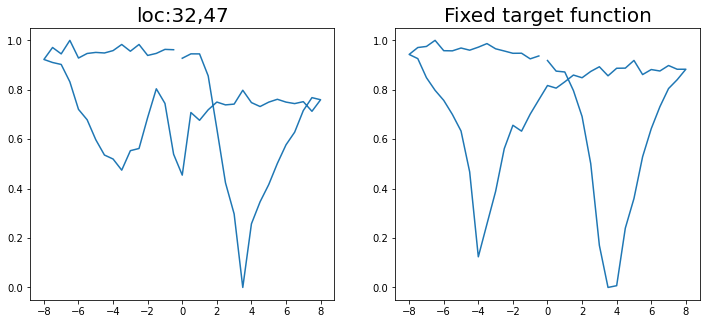

Epoch 1/200 ... Training loss: 2.5909
Epoch 10/200 ... Training loss: 2.4153
Epoch 20/200 ... Training loss: 2.1303
Epoch 30/200 ... Training loss: 1.9923
Epoch 40/200 ... Training loss: 1.8944
Epoch 50/200 ... Training loss: 1.6873
Epoch 60/200 ... Training loss: 1.499
Epoch 70/200 ... Training loss: 1.4218
Epoch 80/200 ... Training loss: 1.2943
Epoch 90/200 ... Training loss: 1.2786
Epoch 100/200 ... Training loss: 1.2068
Epoch 110/200 ... Training loss: 1.1484
Epoch 120/200 ... Training loss: 1.0674
Epoch 130/200 ... Training loss: 1.034
Epoch 140/200 ... Training loss: 0.992
Epoch 150/200 ... Training loss: 0.9396
Epoch 160/200 ... Training loss: 0.8978
Epoch 170/200 ... Training loss: 0.8784
Epoch 180/200 ... Training loss: 0.8303
Epoch 190/200 ... Training loss: 0.757
Epoch 200/200 ... Training loss: 0.7213
step:  125
Sample #135




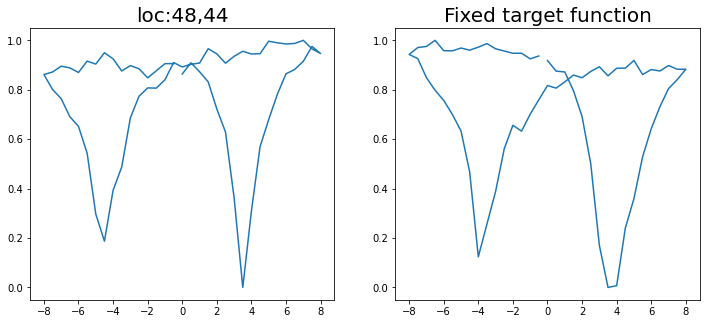

Epoch 1/200 ... Training loss: 2.5808
Epoch 10/200 ... Training loss: 2.4085
Epoch 20/200 ... Training loss: 2.1687
Epoch 30/200 ... Training loss: 2.0117
Epoch 40/200 ... Training loss: 1.919
Epoch 50/200 ... Training loss: 1.7471
Epoch 60/200 ... Training loss: 1.6211
Epoch 70/200 ... Training loss: 1.5258
Epoch 80/200 ... Training loss: 1.3499
Epoch 90/200 ... Training loss: 1.2617
Epoch 100/200 ... Training loss: 1.1792
Epoch 110/200 ... Training loss: 1.1881
Epoch 120/200 ... Training loss: 1.1099
Epoch 130/200 ... Training loss: 1.072
Epoch 140/200 ... Training loss: 1.0312
Epoch 150/200 ... Training loss: 1.0902
Epoch 160/200 ... Training loss: 1.0017
Epoch 170/200 ... Training loss: 0.9146
Epoch 180/200 ... Training loss: 0.873
Epoch 190/200 ... Training loss: 0.8784
Epoch 200/200 ... Training loss: 0.8006
step:  126
Sample #136




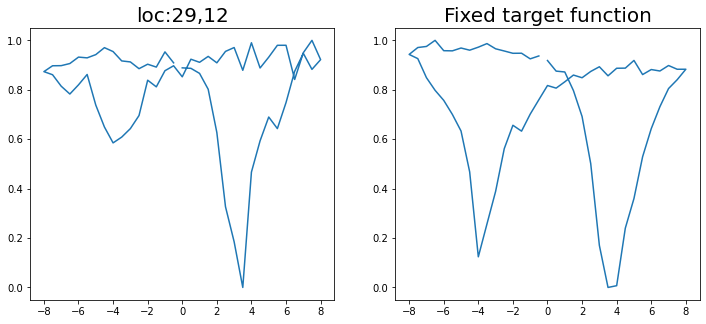

Epoch 1/200 ... Training loss: 2.5691
Epoch 10/200 ... Training loss: 2.2955
Epoch 20/200 ... Training loss: 2.2105
Epoch 30/200 ... Training loss: 1.8759
Epoch 40/200 ... Training loss: 1.7872
Epoch 50/200 ... Training loss: 1.6447
Epoch 60/200 ... Training loss: 1.5085
Epoch 70/200 ... Training loss: 1.3805
Epoch 80/200 ... Training loss: 1.3103
Epoch 90/200 ... Training loss: 1.2215
Epoch 100/200 ... Training loss: 1.1777
Epoch 110/200 ... Training loss: 1.1959
Epoch 120/200 ... Training loss: 1.0713
Epoch 130/200 ... Training loss: 1.0074
Epoch 140/200 ... Training loss: 0.9655
Epoch 150/200 ... Training loss: 0.9343
Epoch 160/200 ... Training loss: 0.8667
Epoch 170/200 ... Training loss: 0.8102
Epoch 180/200 ... Training loss: 0.7865
Epoch 190/200 ... Training loss: 0.7687
Epoch 200/200 ... Training loss: 0.6973
step:  127
Sample #137




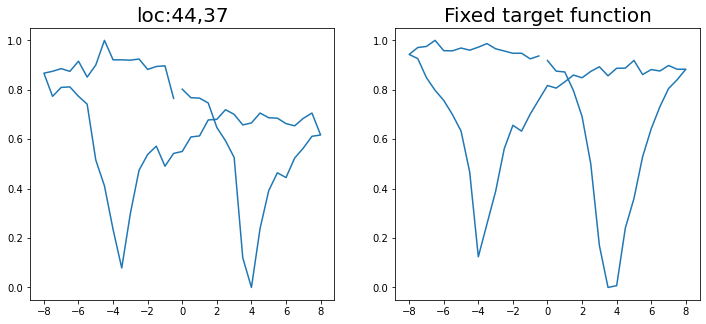

Epoch 1/200 ... Training loss: 2.5606
Epoch 10/200 ... Training loss: 2.2809
Epoch 20/200 ... Training loss: 2.1683
Epoch 30/200 ... Training loss: 1.8656
Epoch 40/200 ... Training loss: 1.7639
Epoch 50/200 ... Training loss: 1.544
Epoch 60/200 ... Training loss: 1.3664
Epoch 70/200 ... Training loss: 1.2767
Epoch 80/200 ... Training loss: 1.1838
Epoch 90/200 ... Training loss: 1.1611
Epoch 100/200 ... Training loss: 1.0907
Epoch 110/200 ... Training loss: 1.0286
Epoch 120/200 ... Training loss: 0.9542
Epoch 130/200 ... Training loss: 0.9172
Epoch 140/200 ... Training loss: 0.8596
Epoch 150/200 ... Training loss: 0.8202
Epoch 160/200 ... Training loss: 0.7872
Epoch 170/200 ... Training loss: 0.7308
Epoch 180/200 ... Training loss: 0.7194
Epoch 190/200 ... Training loss: 0.7068
Epoch 200/200 ... Training loss: 0.5949
step:  128
Sample #138




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


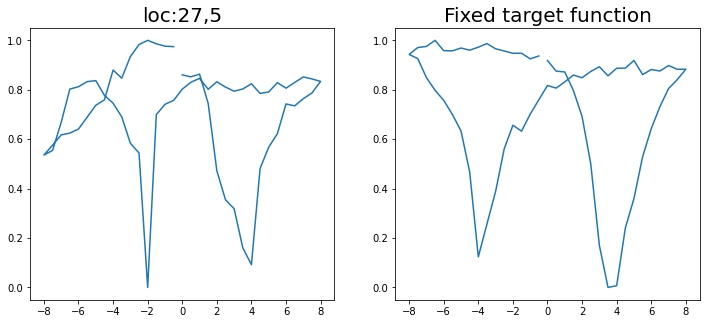

Epoch 1/200 ... Training loss: 2.6002
Epoch 10/200 ... Training loss: 2.3824
Epoch 20/200 ... Training loss: 2.1712
Epoch 30/200 ... Training loss: 1.8696
Epoch 40/200 ... Training loss: 1.7884
Epoch 50/200 ... Training loss: 1.6353
Epoch 60/200 ... Training loss: 1.5299
Epoch 70/200 ... Training loss: 1.4085
Epoch 80/200 ... Training loss: 1.3024
Epoch 90/200 ... Training loss: 1.2604
Epoch 100/200 ... Training loss: 1.1858
Epoch 110/200 ... Training loss: 1.1192
Epoch 120/200 ... Training loss: 1.0977
Epoch 130/200 ... Training loss: 1.0281
Epoch 140/200 ... Training loss: 0.9727
Epoch 150/200 ... Training loss: 0.9292
Epoch 160/200 ... Training loss: 0.8949
Epoch 170/200 ... Training loss: 0.8533
Epoch 180/200 ... Training loss: 0.8381
Epoch 190/200 ... Training loss: 0.7533
Epoch 200/200 ... Training loss: 0.7794
step:  129
Sample #139




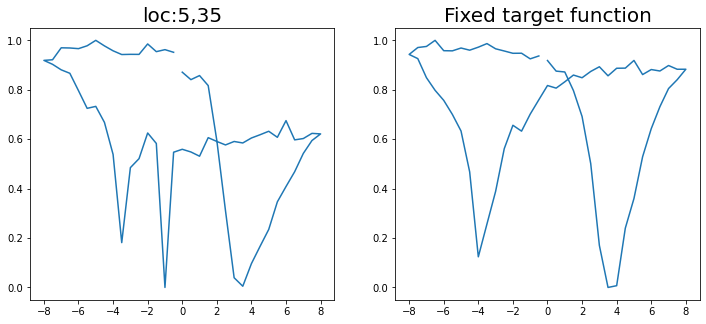

Epoch 1/200 ... Training loss: 2.5884
Epoch 10/200 ... Training loss: 2.4202
Epoch 20/200 ... Training loss: 2.125
Epoch 30/200 ... Training loss: 1.8571
Epoch 40/200 ... Training loss: 1.7442
Epoch 50/200 ... Training loss: 1.661
Epoch 60/200 ... Training loss: 1.5152
Epoch 70/200 ... Training loss: 1.3728
Epoch 80/200 ... Training loss: 1.2624
Epoch 90/200 ... Training loss: 1.1764
Epoch 100/200 ... Training loss: 1.0941
Epoch 110/200 ... Training loss: 1.0653
Epoch 120/200 ... Training loss: 1.0179
Epoch 130/200 ... Training loss: 1.0359
Epoch 140/200 ... Training loss: 0.9345
Epoch 150/200 ... Training loss: 0.8841
Epoch 160/200 ... Training loss: 0.8817
Epoch 170/200 ... Training loss: 0.7964
Epoch 180/200 ... Training loss: 0.7741
Epoch 190/200 ... Training loss: 0.7759
Epoch 200/200 ... Training loss: 0.6883
step:  130
Sample #140




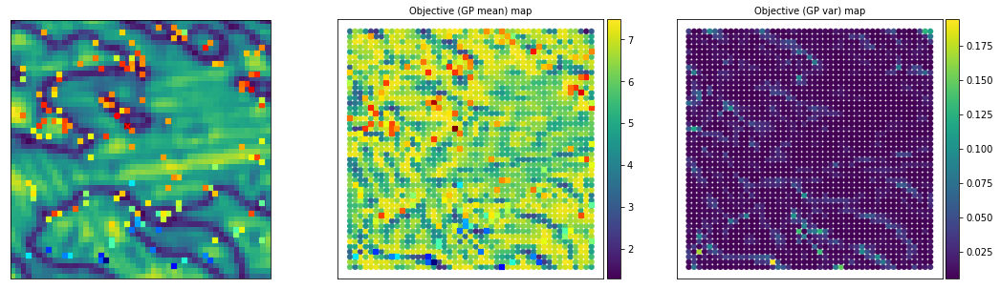

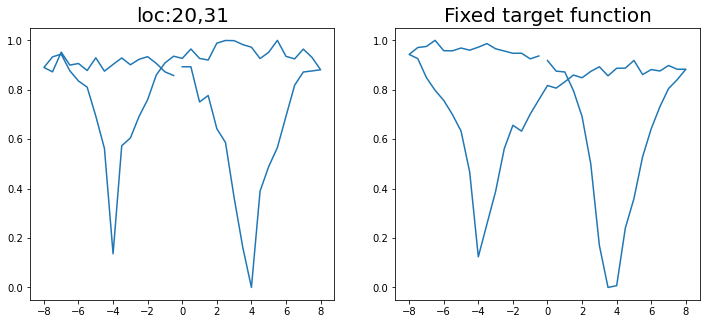

Epoch 1/200 ... Training loss: 2.5802
Epoch 10/200 ... Training loss: 2.1882
Epoch 20/200 ... Training loss: 1.9229
Epoch 30/200 ... Training loss: 1.8261
Epoch 40/200 ... Training loss: 1.6328
Epoch 50/200 ... Training loss: 1.5035
Epoch 60/200 ... Training loss: 1.3982
Epoch 70/200 ... Training loss: 1.3107
Epoch 80/200 ... Training loss: 1.2729
Epoch 90/200 ... Training loss: 1.1492
Epoch 100/200 ... Training loss: 1.2068
Epoch 110/200 ... Training loss: 1.0805
Epoch 120/200 ... Training loss: 0.9755
Epoch 130/200 ... Training loss: 0.9335
Epoch 140/200 ... Training loss: 0.8928
Epoch 150/200 ... Training loss: 0.826
Epoch 160/200 ... Training loss: 0.7897
Epoch 170/200 ... Training loss: 0.7317
Epoch 180/200 ... Training loss: 0.6861
Epoch 190/200 ... Training loss: 0.636
Epoch 200/200 ... Training loss: 0.9326
step:  131
Sample #141




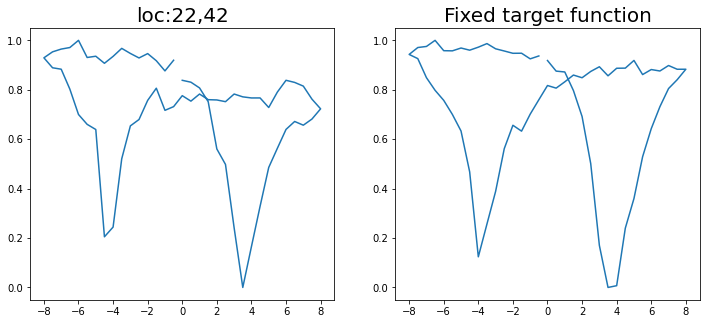

Epoch 1/200 ... Training loss: 2.5694
Epoch 10/200 ... Training loss: 2.4145
Epoch 20/200 ... Training loss: 2.2913
Epoch 30/200 ... Training loss: 2.1065
Epoch 40/200 ... Training loss: 1.963
Epoch 50/200 ... Training loss: 1.7827
Epoch 60/200 ... Training loss: 1.6909
Epoch 70/200 ... Training loss: 1.5376
Epoch 80/200 ... Training loss: 1.4079
Epoch 90/200 ... Training loss: 1.3746
Epoch 100/200 ... Training loss: 1.2584
Epoch 110/200 ... Training loss: 1.1675
Epoch 120/200 ... Training loss: 1.2444
Epoch 130/200 ... Training loss: 1.1164
Epoch 140/200 ... Training loss: 1.0454
Epoch 150/200 ... Training loss: 1.1094
Epoch 160/200 ... Training loss: 1.0956
Epoch 170/200 ... Training loss: 0.9721
Epoch 180/200 ... Training loss: 0.9101
Epoch 190/200 ... Training loss: 0.8731
Epoch 200/200 ... Training loss: 0.8253
step:  132
Sample #142




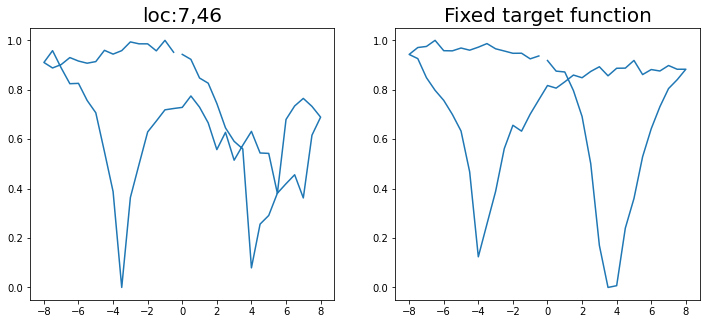

Epoch 1/200 ... Training loss: 2.5643
Epoch 10/200 ... Training loss: 2.3704
Epoch 20/200 ... Training loss: 2.2988
Epoch 30/200 ... Training loss: 2.1002
Epoch 40/200 ... Training loss: 1.9599
Epoch 50/200 ... Training loss: 1.8765
Epoch 60/200 ... Training loss: 1.7537
Epoch 70/200 ... Training loss: 1.5928
Epoch 80/200 ... Training loss: 1.5306
Epoch 90/200 ... Training loss: 1.3633
Epoch 100/200 ... Training loss: 1.3138
Epoch 110/200 ... Training loss: 1.2253
Epoch 120/200 ... Training loss: 1.1486
Epoch 130/200 ... Training loss: 1.095
Epoch 140/200 ... Training loss: 1.1414
Epoch 150/200 ... Training loss: 1.2183
Epoch 160/200 ... Training loss: 1.0698
Epoch 170/200 ... Training loss: 0.9791
Epoch 180/200 ... Training loss: 0.9311
Epoch 190/200 ... Training loss: 0.8925
Epoch 200/200 ... Training loss: 0.8814
step:  133
Sample #143




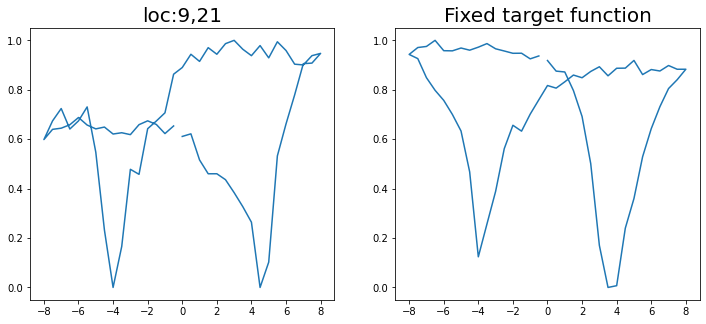

Epoch 1/200 ... Training loss: 2.5532
Epoch 10/200 ... Training loss: 2.3069
Epoch 20/200 ... Training loss: 1.9396
Epoch 30/200 ... Training loss: 1.885
Epoch 40/200 ... Training loss: 1.6637
Epoch 50/200 ... Training loss: 1.5214
Epoch 60/200 ... Training loss: 1.4239
Epoch 70/200 ... Training loss: 1.359
Epoch 80/200 ... Training loss: 1.4404
Epoch 90/200 ... Training loss: 1.2232
Epoch 100/200 ... Training loss: 1.1334
Epoch 110/200 ... Training loss: 1.0515
Epoch 120/200 ... Training loss: 1.043
Epoch 130/200 ... Training loss: 0.9439
Epoch 140/200 ... Training loss: 0.9087
Epoch 150/200 ... Training loss: 0.8345
Epoch 160/200 ... Training loss: 0.821
Epoch 170/200 ... Training loss: 0.7669
Epoch 180/200 ... Training loss: 0.7032
Epoch 190/200 ... Training loss: 0.6602
Epoch 200/200 ... Training loss: 0.6046
step:  134
Sample #144




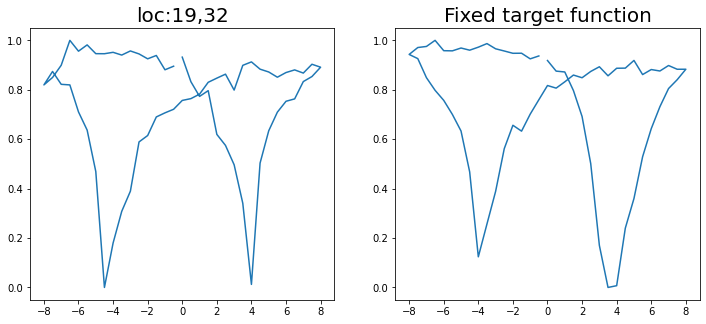

Epoch 1/200 ... Training loss: 2.5475
Epoch 10/200 ... Training loss: 2.4198
Epoch 20/200 ... Training loss: 2.265
Epoch 30/200 ... Training loss: 2.0366
Epoch 40/200 ... Training loss: 1.9201
Epoch 50/200 ... Training loss: 1.7544
Epoch 60/200 ... Training loss: 1.5825
Epoch 70/200 ... Training loss: 1.413
Epoch 80/200 ... Training loss: 1.3213
Epoch 90/200 ... Training loss: 1.235
Epoch 100/200 ... Training loss: 1.2004
Epoch 110/200 ... Training loss: 1.1335
Epoch 120/200 ... Training loss: 1.0991
Epoch 130/200 ... Training loss: 1.0797
Epoch 140/200 ... Training loss: 0.9992
Epoch 150/200 ... Training loss: 0.9725
Epoch 160/200 ... Training loss: 0.9733
Epoch 170/200 ... Training loss: 0.945
Epoch 180/200 ... Training loss: 0.8529
Epoch 190/200 ... Training loss: 0.7915
Epoch 200/200 ... Training loss: 0.8583
step:  135
Sample #145




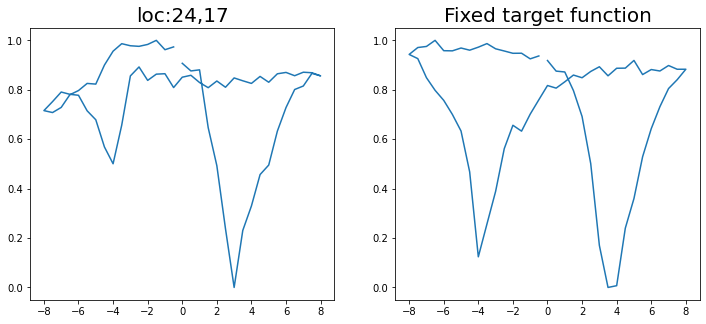

Epoch 1/200 ... Training loss: 2.548
Epoch 10/200 ... Training loss: 2.4186
Epoch 20/200 ... Training loss: 2.2735
Epoch 30/200 ... Training loss: 2.0839
Epoch 40/200 ... Training loss: 1.98
Epoch 50/200 ... Training loss: 1.8345
Epoch 60/200 ... Training loss: 1.6688
Epoch 70/200 ... Training loss: 1.5602
Epoch 80/200 ... Training loss: 1.4914
Epoch 90/200 ... Training loss: 1.4547
Epoch 100/200 ... Training loss: 1.4363
Epoch 110/200 ... Training loss: 1.3775
Epoch 120/200 ... Training loss: 1.3129
Epoch 130/200 ... Training loss: 1.3444
Epoch 140/200 ... Training loss: 1.2821
Epoch 150/200 ... Training loss: 1.2008
Epoch 160/200 ... Training loss: 1.159
Epoch 170/200 ... Training loss: 1.1218
Epoch 180/200 ... Training loss: 1.1004
Epoch 190/200 ... Training loss: 1.0646
Epoch 200/200 ... Training loss: 1.0192
step:  136
Sample #146




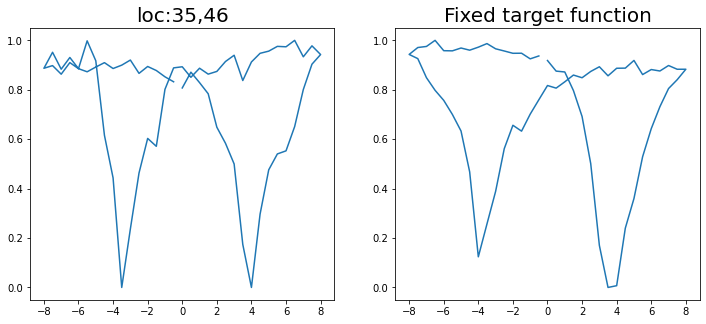

Epoch 1/200 ... Training loss: 2.5419
Epoch 10/200 ... Training loss: 2.4154
Epoch 20/200 ... Training loss: 2.2495
Epoch 30/200 ... Training loss: 2.1166
Epoch 40/200 ... Training loss: 2.0111
Epoch 50/200 ... Training loss: 1.9096
Epoch 60/200 ... Training loss: 1.7798
Epoch 70/200 ... Training loss: 1.6412
Epoch 80/200 ... Training loss: 1.5214
Epoch 90/200 ... Training loss: 1.4505
Epoch 100/200 ... Training loss: 1.3782
Epoch 110/200 ... Training loss: 1.3003
Epoch 120/200 ... Training loss: 1.2496
Epoch 130/200 ... Training loss: 1.1988
Epoch 140/200 ... Training loss: 1.1397
Epoch 150/200 ... Training loss: 1.3533
Epoch 160/200 ... Training loss: 1.2394
Epoch 170/200 ... Training loss: 1.1208
Epoch 180/200 ... Training loss: 1.0445
Epoch 190/200 ... Training loss: 1.037
Epoch 200/200 ... Training loss: 1.1447
step:  137
Sample #147




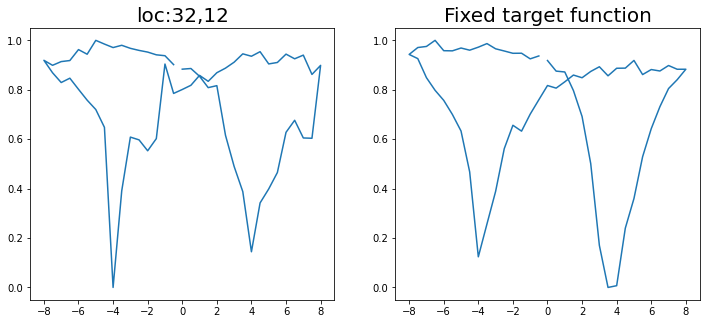

Epoch 1/200 ... Training loss: 2.5348
Epoch 10/200 ... Training loss: 2.3935
Epoch 20/200 ... Training loss: 2.2662
Epoch 30/200 ... Training loss: 2.0772
Epoch 40/200 ... Training loss: 1.9658
Epoch 50/200 ... Training loss: 1.8706
Epoch 60/200 ... Training loss: 1.7306
Epoch 70/200 ... Training loss: 1.5944
Epoch 80/200 ... Training loss: 1.4912
Epoch 90/200 ... Training loss: 1.4381
Epoch 100/200 ... Training loss: 1.3497
Epoch 110/200 ... Training loss: 1.3011
Epoch 120/200 ... Training loss: 1.2207
Epoch 130/200 ... Training loss: 1.1654
Epoch 140/200 ... Training loss: 1.1191
Epoch 150/200 ... Training loss: 1.0809
Epoch 160/200 ... Training loss: 1.0024
Epoch 170/200 ... Training loss: 0.9785
Epoch 180/200 ... Training loss: 1.0305
Epoch 190/200 ... Training loss: 0.9259
Epoch 200/200 ... Training loss: 0.8509
step:  138
Sample #148




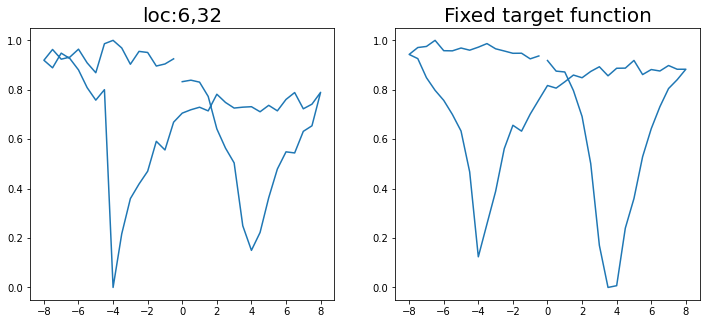

Epoch 1/200 ... Training loss: 2.5235
Epoch 10/200 ... Training loss: 2.3797
Epoch 20/200 ... Training loss: 2.2284
Epoch 30/200 ... Training loss: 2.1049
Epoch 40/200 ... Training loss: 1.9886
Epoch 50/200 ... Training loss: 1.903
Epoch 60/200 ... Training loss: 1.8201
Epoch 70/200 ... Training loss: 1.6791
Epoch 80/200 ... Training loss: 1.5057
Epoch 90/200 ... Training loss: 1.4808
Epoch 100/200 ... Training loss: 1.3249
Epoch 110/200 ... Training loss: 1.2631
Epoch 120/200 ... Training loss: 1.1902
Epoch 130/200 ... Training loss: 1.1409
Epoch 140/200 ... Training loss: 1.1149
Epoch 150/200 ... Training loss: 1.0663
Epoch 160/200 ... Training loss: 1.0428
Epoch 170/200 ... Training loss: 1.0814
Epoch 180/200 ... Training loss: 1.0217
Epoch 190/200 ... Training loss: 0.9375
Epoch 200/200 ... Training loss: 0.8897
step:  139
Sample #149




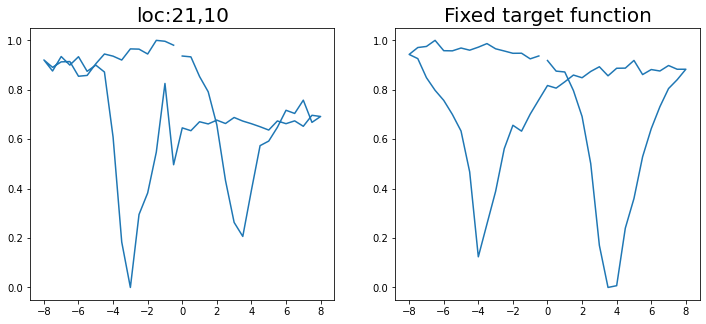

Epoch 1/200 ... Training loss: 2.527
Epoch 10/200 ... Training loss: 2.3221
Epoch 20/200 ... Training loss: 2.2604
Epoch 30/200 ... Training loss: 2.1205
Epoch 40/200 ... Training loss: 2.0163
Epoch 50/200 ... Training loss: 1.9166
Epoch 60/200 ... Training loss: 1.8204
Epoch 70/200 ... Training loss: 1.6731
Epoch 80/200 ... Training loss: 1.5271
Epoch 90/200 ... Training loss: 1.475
Epoch 100/200 ... Training loss: 1.4094
Epoch 110/200 ... Training loss: 1.2745
Epoch 120/200 ... Training loss: 1.3052
Epoch 130/200 ... Training loss: 1.2049
Epoch 140/200 ... Training loss: 1.1656
Epoch 150/200 ... Training loss: 1.0633
Epoch 160/200 ... Training loss: 1.0574
Epoch 170/200 ... Training loss: 0.9938
Epoch 180/200 ... Training loss: 0.9407
Epoch 190/200 ... Training loss: 0.8859
Epoch 200/200 ... Training loss: 0.9871
step:  140
Sample #150




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


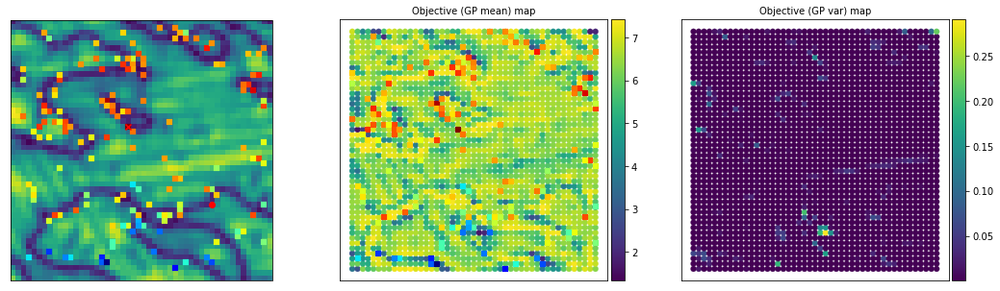

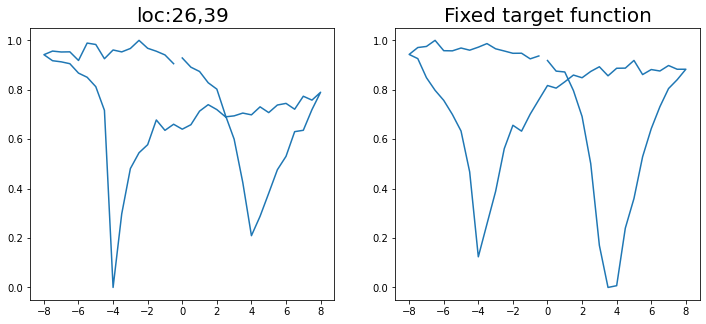

Epoch 1/200 ... Training loss: 2.5182
Epoch 10/200 ... Training loss: 2.3515
Epoch 20/200 ... Training loss: 2.2446
Epoch 30/200 ... Training loss: 1.8904
Epoch 40/200 ... Training loss: 1.8544
Epoch 50/200 ... Training loss: 1.6597
Epoch 60/200 ... Training loss: 1.5849
Epoch 70/200 ... Training loss: 1.4989
Epoch 80/200 ... Training loss: 1.3936
Epoch 90/200 ... Training loss: 1.2909
Epoch 100/200 ... Training loss: 1.2166
Epoch 110/200 ... Training loss: 1.1582
Epoch 120/200 ... Training loss: 1.1057
Epoch 130/200 ... Training loss: 1.0212
Epoch 140/200 ... Training loss: 0.9742
Epoch 150/200 ... Training loss: 0.9394
Epoch 160/200 ... Training loss: 0.8841
Epoch 170/200 ... Training loss: 0.8664
Epoch 180/200 ... Training loss: 0.7984
Epoch 190/200 ... Training loss: 0.7563
Epoch 200/200 ... Training loss: 0.739
step:  141
Sample #151




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


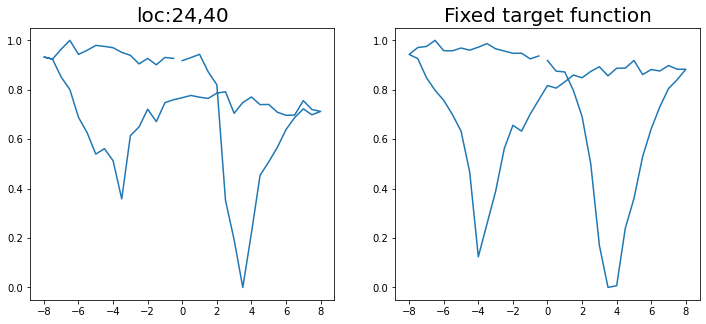

Epoch 1/200 ... Training loss: 2.5112
Epoch 10/200 ... Training loss: 2.3486
Epoch 20/200 ... Training loss: 2.0754
Epoch 30/200 ... Training loss: 1.8794
Epoch 40/200 ... Training loss: 1.6989
Epoch 50/200 ... Training loss: 1.5515
Epoch 60/200 ... Training loss: 1.4596
Epoch 70/200 ... Training loss: 1.3286
Epoch 80/200 ... Training loss: 1.3074
Epoch 90/200 ... Training loss: 1.1979
Epoch 100/200 ... Training loss: 1.1424
Epoch 110/200 ... Training loss: 1.1002
Epoch 120/200 ... Training loss: 1.0589
Epoch 130/200 ... Training loss: 1.0202
Epoch 140/200 ... Training loss: 0.9995
Epoch 150/200 ... Training loss: 0.9401
Epoch 160/200 ... Training loss: 0.8524
Epoch 170/200 ... Training loss: 0.8012
Epoch 180/200 ... Training loss: 0.8416
Epoch 190/200 ... Training loss: 0.7183
Epoch 200/200 ... Training loss: 0.6856
step:  142
Sample #152




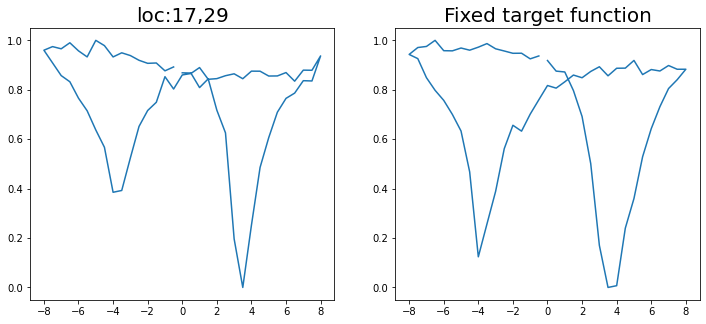

Epoch 1/200 ... Training loss: 2.5182
Epoch 10/200 ... Training loss: 2.3571
Epoch 20/200 ... Training loss: 1.9646
Epoch 30/200 ... Training loss: 1.875
Epoch 40/200 ... Training loss: 1.623
Epoch 50/200 ... Training loss: 1.4994
Epoch 60/200 ... Training loss: 1.3763
Epoch 70/200 ... Training loss: 1.3403
Epoch 80/200 ... Training loss: 1.2752
Epoch 90/200 ... Training loss: 1.2208
Epoch 100/200 ... Training loss: 1.0999
Epoch 110/200 ... Training loss: 1.0776
Epoch 120/200 ... Training loss: 0.9841
Epoch 130/200 ... Training loss: 1.0073
Epoch 140/200 ... Training loss: 0.9852
Epoch 150/200 ... Training loss: 0.9162
Epoch 160/200 ... Training loss: 0.8641
Epoch 170/200 ... Training loss: 0.7961
Epoch 180/200 ... Training loss: 0.8513
Epoch 190/200 ... Training loss: 0.715
Epoch 200/200 ... Training loss: 0.686
step:  143
Sample #153




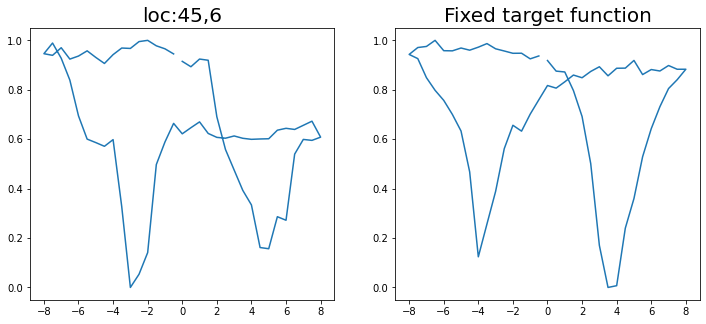

Epoch 1/200 ... Training loss: 2.5163
Epoch 10/200 ... Training loss: 2.4093
Epoch 20/200 ... Training loss: 2.2191
Epoch 30/200 ... Training loss: 2.0759
Epoch 40/200 ... Training loss: 1.9533
Epoch 50/200 ... Training loss: 1.8185
Epoch 60/200 ... Training loss: 1.6179
Epoch 70/200 ... Training loss: 1.4887
Epoch 80/200 ... Training loss: 1.4343
Epoch 90/200 ... Training loss: 1.3847
Epoch 100/200 ... Training loss: 1.4489
Epoch 110/200 ... Training loss: 1.3522
Epoch 120/200 ... Training loss: 1.2681
Epoch 130/200 ... Training loss: 1.2222
Epoch 140/200 ... Training loss: 1.1587
Epoch 150/200 ... Training loss: 1.1235
Epoch 160/200 ... Training loss: 1.111
Epoch 170/200 ... Training loss: 1.2521
Epoch 180/200 ... Training loss: 1.0725
Epoch 190/200 ... Training loss: 1.1327
Epoch 200/200 ... Training loss: 0.9945
step:  144
Sample #154




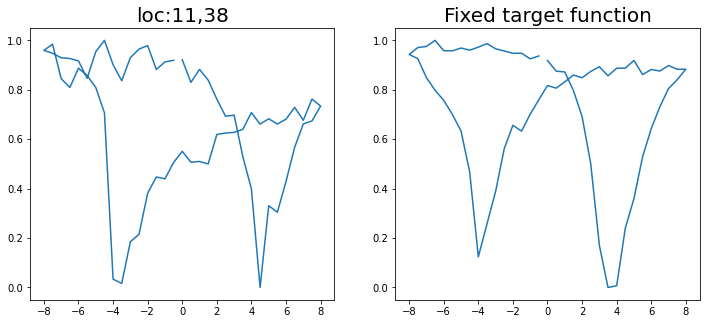

Epoch 1/200 ... Training loss: 2.508
Epoch 10/200 ... Training loss: 2.3362
Epoch 20/200 ... Training loss: 2.1905
Epoch 30/200 ... Training loss: 2.0291
Epoch 40/200 ... Training loss: 1.9272
Epoch 50/200 ... Training loss: 1.8036
Epoch 60/200 ... Training loss: 1.6389
Epoch 70/200 ... Training loss: 1.5143
Epoch 80/200 ... Training loss: 1.4474
Epoch 90/200 ... Training loss: 1.3961
Epoch 100/200 ... Training loss: 1.4337
Epoch 110/200 ... Training loss: 1.3652
Epoch 120/200 ... Training loss: 1.315
Epoch 130/200 ... Training loss: 1.2788
Epoch 140/200 ... Training loss: 1.2429
Epoch 150/200 ... Training loss: 1.1793
Epoch 160/200 ... Training loss: 1.2018
Epoch 170/200 ... Training loss: 1.1051
Epoch 180/200 ... Training loss: 1.0224
Epoch 190/200 ... Training loss: 0.9389
Epoch 200/200 ... Training loss: 0.8885
step:  145
Sample #155




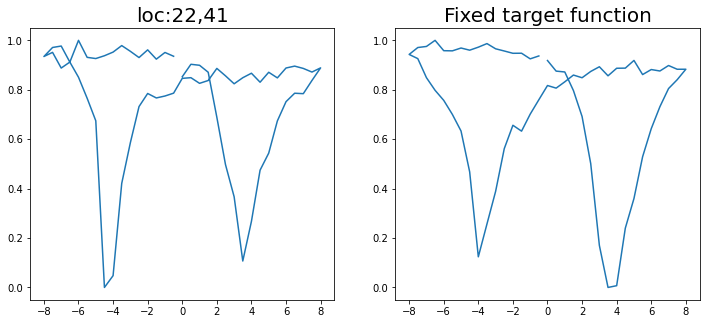

Epoch 1/200 ... Training loss: 2.5049
Epoch 10/200 ... Training loss: 2.1368
Epoch 20/200 ... Training loss: 1.9473
Epoch 30/200 ... Training loss: 1.6992
Epoch 40/200 ... Training loss: 1.5378
Epoch 50/200 ... Training loss: 1.3937
Epoch 60/200 ... Training loss: 1.3954
Epoch 70/200 ... Training loss: 1.2944
Epoch 80/200 ... Training loss: 1.1595
Epoch 90/200 ... Training loss: 1.2221
Epoch 100/200 ... Training loss: 1.083
Epoch 110/200 ... Training loss: 1.0102
Epoch 120/200 ... Training loss: 0.9611
Epoch 130/200 ... Training loss: 0.8815
Epoch 140/200 ... Training loss: 0.9118
Epoch 150/200 ... Training loss: 0.8158
Epoch 160/200 ... Training loss: 0.8034
Epoch 170/200 ... Training loss: 0.7173
Epoch 180/200 ... Training loss: 0.7812
Epoch 190/200 ... Training loss: 0.646
Epoch 200/200 ... Training loss: 0.5817
step:  146
Sample #156




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


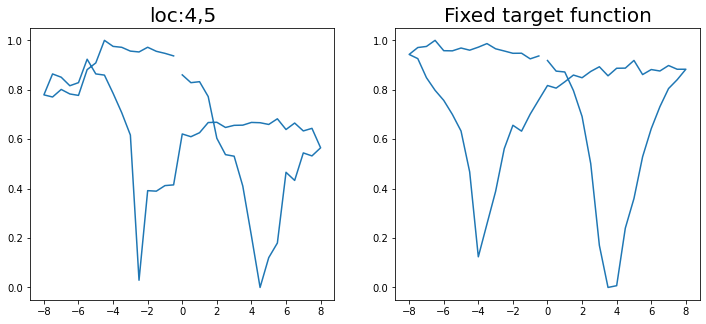

Epoch 1/200 ... Training loss: 2.5235
Epoch 10/200 ... Training loss: 2.1257
Epoch 20/200 ... Training loss: 1.9194
Epoch 30/200 ... Training loss: 1.7325
Epoch 40/200 ... Training loss: 1.6056
Epoch 50/200 ... Training loss: 1.4599
Epoch 60/200 ... Training loss: 1.3933
Epoch 70/200 ... Training loss: 1.2428
Epoch 80/200 ... Training loss: 1.1542
Epoch 90/200 ... Training loss: 1.2937
Epoch 100/200 ... Training loss: 1.1358
Epoch 110/200 ... Training loss: 1.038
Epoch 120/200 ... Training loss: 0.9914
Epoch 130/200 ... Training loss: 1.1377
Epoch 140/200 ... Training loss: 0.9856
Epoch 150/200 ... Training loss: 0.885
Epoch 160/200 ... Training loss: 0.7994
Epoch 170/200 ... Training loss: 0.79
Epoch 180/200 ... Training loss: 0.7385
Epoch 190/200 ... Training loss: 0.6605
Epoch 200/200 ... Training loss: 0.5877
step:  147
Sample #157




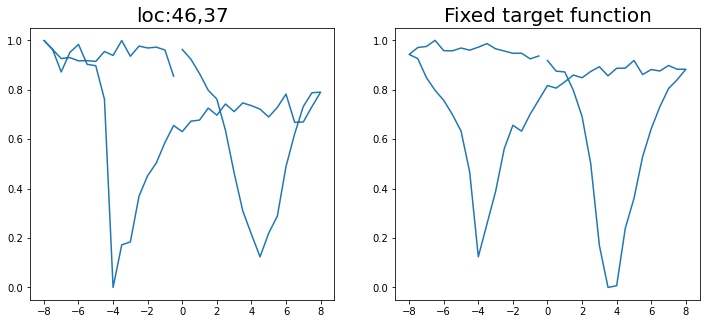

Epoch 1/200 ... Training loss: 2.5121
Epoch 10/200 ... Training loss: 2.393
Epoch 20/200 ... Training loss: 2.2476
Epoch 30/200 ... Training loss: 2.0666
Epoch 40/200 ... Training loss: 1.9854
Epoch 50/200 ... Training loss: 1.9052
Epoch 60/200 ... Training loss: 1.7558
Epoch 70/200 ... Training loss: 1.618
Epoch 80/200 ... Training loss: 1.4853
Epoch 90/200 ... Training loss: 1.3748
Epoch 100/200 ... Training loss: 1.3915
Epoch 110/200 ... Training loss: 1.2873
Epoch 120/200 ... Training loss: 1.1942
Epoch 130/200 ... Training loss: 1.1687
Epoch 140/200 ... Training loss: 1.1161
Epoch 150/200 ... Training loss: 1.0569
Epoch 160/200 ... Training loss: 1.1529
Epoch 170/200 ... Training loss: 1.0287
Epoch 180/200 ... Training loss: 0.9535
Epoch 190/200 ... Training loss: 0.8925
Epoch 200/200 ... Training loss: 1.0164
step:  148
Sample #158




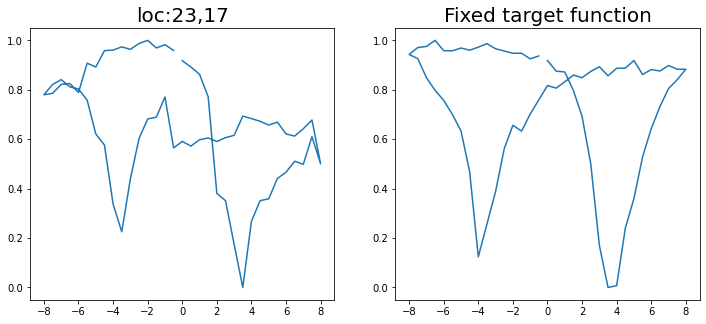

Epoch 1/200 ... Training loss: 2.5071
Epoch 10/200 ... Training loss: 2.3878
Epoch 20/200 ... Training loss: 2.2143
Epoch 30/200 ... Training loss: 2.08
Epoch 40/200 ... Training loss: 1.9833
Epoch 50/200 ... Training loss: 1.8975
Epoch 60/200 ... Training loss: 1.762
Epoch 70/200 ... Training loss: 1.5921
Epoch 80/200 ... Training loss: 1.5167
Epoch 90/200 ... Training loss: 1.4351
Epoch 100/200 ... Training loss: 1.3273
Epoch 110/200 ... Training loss: 1.2747
Epoch 120/200 ... Training loss: 1.2263
Epoch 130/200 ... Training loss: 1.129
Epoch 140/200 ... Training loss: 1.0936
Epoch 150/200 ... Training loss: 1.0426
Epoch 160/200 ... Training loss: 0.9999
Epoch 170/200 ... Training loss: 0.9801
Epoch 180/200 ... Training loss: 0.9171
Epoch 190/200 ... Training loss: 0.9087
Epoch 200/200 ... Training loss: 0.9091
step:  149
Sample #159




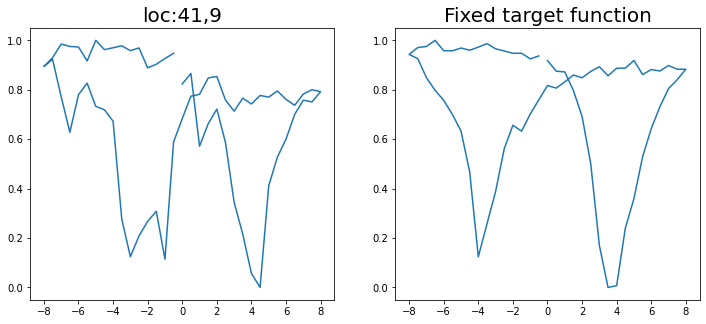

Epoch 1/200 ... Training loss: 2.497
Epoch 10/200 ... Training loss: 2.2354
Epoch 20/200 ... Training loss: 2.2284
Epoch 30/200 ... Training loss: 2.113
Epoch 40/200 ... Training loss: 1.9805
Epoch 50/200 ... Training loss: 1.8562
Epoch 60/200 ... Training loss: 1.713
Epoch 70/200 ... Training loss: 1.5699
Epoch 80/200 ... Training loss: 1.5278
Epoch 90/200 ... Training loss: 1.3755
Epoch 100/200 ... Training loss: 1.2837
Epoch 110/200 ... Training loss: 1.209
Epoch 120/200 ... Training loss: 1.1473
Epoch 130/200 ... Training loss: 1.0993
Epoch 140/200 ... Training loss: 1.089
Epoch 150/200 ... Training loss: 1.0282
Epoch 160/200 ... Training loss: 0.9692
Epoch 170/200 ... Training loss: 0.9148
Epoch 180/200 ... Training loss: 0.9436
Epoch 190/200 ... Training loss: 0.8452
Epoch 200/200 ... Training loss: 0.8053
step:  150
Sample #160




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


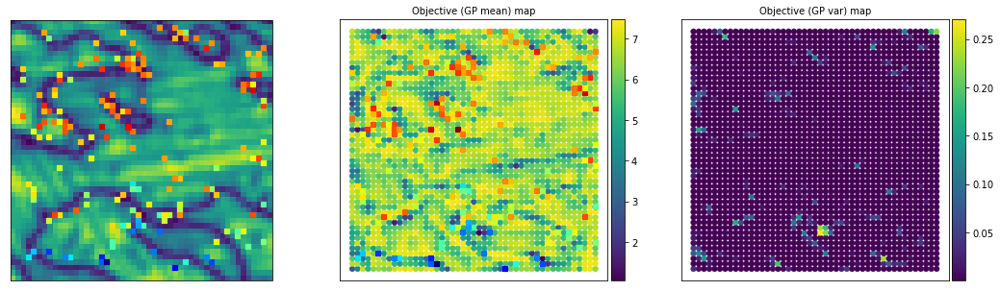

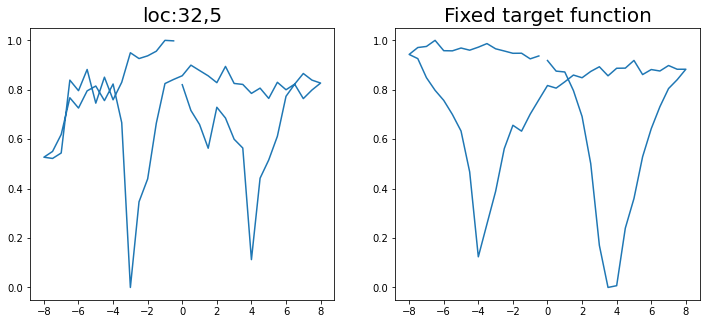

Epoch 1/200 ... Training loss: 2.5529
Epoch 10/200 ... Training loss: 2.3328
Epoch 20/200 ... Training loss: 1.9757
Epoch 30/200 ... Training loss: 1.841
Epoch 40/200 ... Training loss: 1.6106
Epoch 50/200 ... Training loss: 1.3964
Epoch 60/200 ... Training loss: 1.342
Epoch 70/200 ... Training loss: 1.2176
Epoch 80/200 ... Training loss: 1.275
Epoch 90/200 ... Training loss: 1.1342
Epoch 100/200 ... Training loss: 1.0768
Epoch 110/200 ... Training loss: 1.0124
Epoch 120/200 ... Training loss: 0.9968
Epoch 130/200 ... Training loss: 1.003
Epoch 140/200 ... Training loss: 0.9147
Epoch 150/200 ... Training loss: 0.8356
Epoch 160/200 ... Training loss: 0.9399
Epoch 170/200 ... Training loss: 0.7821
Epoch 180/200 ... Training loss: 0.716
Epoch 190/200 ... Training loss: 0.7099
Epoch 200/200 ... Training loss: 0.8183
step:  151
Sample #161




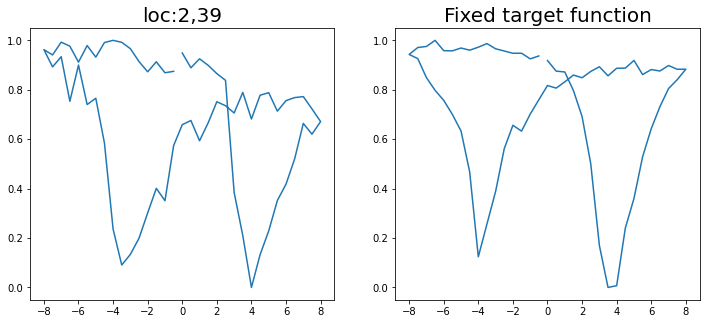

Epoch 1/200 ... Training loss: 2.5459
Epoch 10/200 ... Training loss: 2.1159
Epoch 20/200 ... Training loss: 1.9737
Epoch 30/200 ... Training loss: 1.7753
Epoch 40/200 ... Training loss: 1.5999
Epoch 50/200 ... Training loss: 1.4666
Epoch 60/200 ... Training loss: 1.3208
Epoch 70/200 ... Training loss: 1.2396
Epoch 80/200 ... Training loss: 1.2373
Epoch 90/200 ... Training loss: 1.1245
Epoch 100/200 ... Training loss: 1.0453
Epoch 110/200 ... Training loss: 1.0036
Epoch 120/200 ... Training loss: 0.9362
Epoch 130/200 ... Training loss: 0.9182
Epoch 140/200 ... Training loss: 0.9205
Epoch 150/200 ... Training loss: 0.8025
Epoch 160/200 ... Training loss: 0.7892
Epoch 170/200 ... Training loss: 0.7283
Epoch 180/200 ... Training loss: 0.7138
Epoch 190/200 ... Training loss: 0.6407
Epoch 200/200 ... Training loss: 0.6149
step:  152
Sample #162




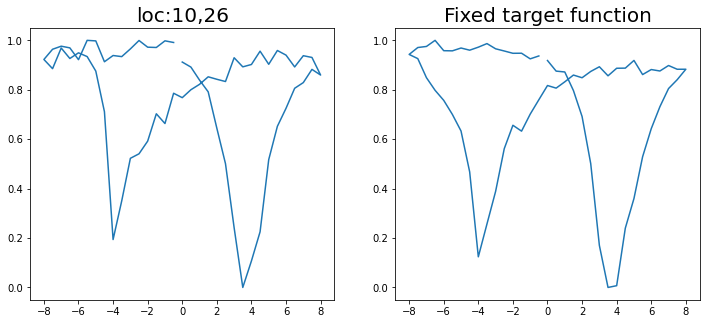

Epoch 1/200 ... Training loss: 2.5382
Epoch 10/200 ... Training loss: 2.3878
Epoch 20/200 ... Training loss: 2.235
Epoch 30/200 ... Training loss: 2.1045
Epoch 40/200 ... Training loss: 1.9986
Epoch 50/200 ... Training loss: 1.9103
Epoch 60/200 ... Training loss: 1.7992
Epoch 70/200 ... Training loss: 1.6483
Epoch 80/200 ... Training loss: 1.5187
Epoch 90/200 ... Training loss: 1.5606
Epoch 100/200 ... Training loss: 1.3286
Epoch 110/200 ... Training loss: 1.2595
Epoch 120/200 ... Training loss: 1.2126
Epoch 130/200 ... Training loss: 1.1513
Epoch 140/200 ... Training loss: 1.1626
Epoch 150/200 ... Training loss: 1.0695
Epoch 160/200 ... Training loss: 1.0068
Epoch 170/200 ... Training loss: 1.1535
Epoch 180/200 ... Training loss: 1.0367
Epoch 190/200 ... Training loss: 0.9727
Epoch 200/200 ... Training loss: 0.8993
step:  153
Sample #163




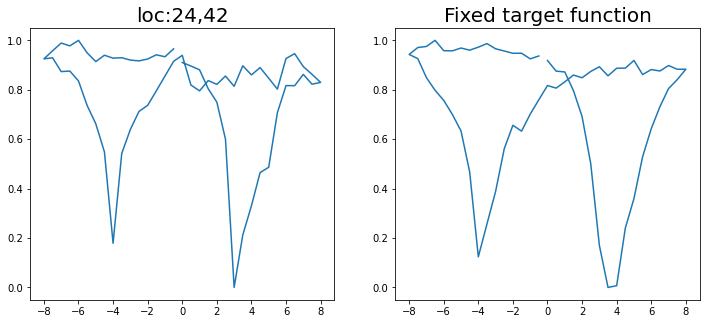

Epoch 1/200 ... Training loss: 2.5285
Epoch 10/200 ... Training loss: 2.318
Epoch 20/200 ... Training loss: 2.2861
Epoch 30/200 ... Training loss: 2.1126
Epoch 40/200 ... Training loss: 1.9895
Epoch 50/200 ... Training loss: 1.9171
Epoch 60/200 ... Training loss: 1.8131
Epoch 70/200 ... Training loss: 1.6615
Epoch 80/200 ... Training loss: 1.5221
Epoch 90/200 ... Training loss: 1.4121
Epoch 100/200 ... Training loss: 1.2816
Epoch 110/200 ... Training loss: 1.2179
Epoch 120/200 ... Training loss: 1.2316
Epoch 130/200 ... Training loss: 1.1636
Epoch 140/200 ... Training loss: 1.0957
Epoch 150/200 ... Training loss: 1.1316
Epoch 160/200 ... Training loss: 1.0849
Epoch 170/200 ... Training loss: 0.991
Epoch 180/200 ... Training loss: 0.9505
Epoch 190/200 ... Training loss: 0.949
Epoch 200/200 ... Training loss: 0.8882
step:  154
Sample #164




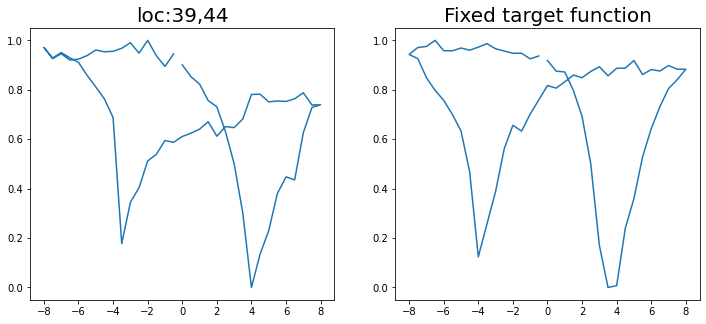

Epoch 1/200 ... Training loss: 2.5185
Epoch 10/200 ... Training loss: 2.3124
Epoch 20/200 ... Training loss: 2.2157
Epoch 30/200 ... Training loss: 2.1078
Epoch 40/200 ... Training loss: 1.9838
Epoch 50/200 ... Training loss: 1.8919
Epoch 60/200 ... Training loss: 1.7561
Epoch 70/200 ... Training loss: 1.5833
Epoch 80/200 ... Training loss: 1.4787
Epoch 90/200 ... Training loss: 1.3431
Epoch 100/200 ... Training loss: 1.2664
Epoch 110/200 ... Training loss: 1.1927
Epoch 120/200 ... Training loss: 1.1359
Epoch 130/200 ... Training loss: 1.1031
Epoch 140/200 ... Training loss: 1.0837
Epoch 150/200 ... Training loss: 1.0602
Epoch 160/200 ... Training loss: 0.9975
Epoch 170/200 ... Training loss: 0.965
Epoch 180/200 ... Training loss: 1.1175
Epoch 190/200 ... Training loss: 1.0044
Epoch 200/200 ... Training loss: 0.9119
step:  155
Sample #165




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


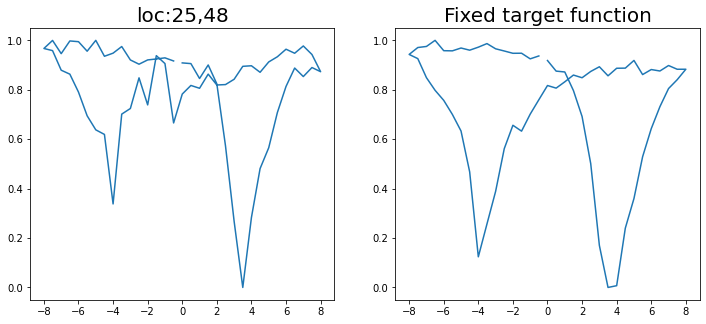

Epoch 1/200 ... Training loss: 2.5083
Epoch 10/200 ... Training loss: 2.314
Epoch 20/200 ... Training loss: 2.1477
Epoch 30/200 ... Training loss: 2.0226
Epoch 40/200 ... Training loss: 1.9347
Epoch 50/200 ... Training loss: 1.8347
Epoch 60/200 ... Training loss: 1.6935
Epoch 70/200 ... Training loss: 1.5376
Epoch 80/200 ... Training loss: 1.4284
Epoch 90/200 ... Training loss: 1.3098
Epoch 100/200 ... Training loss: 1.21
Epoch 110/200 ... Training loss: 1.3294
Epoch 120/200 ... Training loss: 1.146
Epoch 130/200 ... Training loss: 1.0891
Epoch 140/200 ... Training loss: 1.0564
Epoch 150/200 ... Training loss: 1.0205
Epoch 160/200 ... Training loss: 1.0369
Epoch 170/200 ... Training loss: 0.9178
Epoch 180/200 ... Training loss: 0.8875
Epoch 190/200 ... Training loss: 0.85
Epoch 200/200 ... Training loss: 0.8967
step:  156
Sample #166




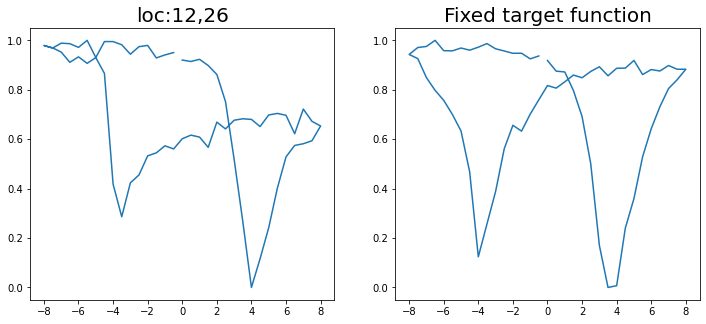

Epoch 1/200 ... Training loss: 2.4997
Epoch 10/200 ... Training loss: 2.3047
Epoch 20/200 ... Training loss: 2.097
Epoch 30/200 ... Training loss: 2.0129
Epoch 40/200 ... Training loss: 1.9198
Epoch 50/200 ... Training loss: 1.8159
Epoch 60/200 ... Training loss: 1.6761
Epoch 70/200 ... Training loss: 1.4719
Epoch 80/200 ... Training loss: 1.3569
Epoch 90/200 ... Training loss: 1.2857
Epoch 100/200 ... Training loss: 1.1908
Epoch 110/200 ... Training loss: 1.1514
Epoch 120/200 ... Training loss: 1.1469
Epoch 130/200 ... Training loss: 1.0394
Epoch 140/200 ... Training loss: 0.9962
Epoch 150/200 ... Training loss: 1.0728
Epoch 160/200 ... Training loss: 0.97
Epoch 170/200 ... Training loss: 0.9128
Epoch 180/200 ... Training loss: 0.859
Epoch 190/200 ... Training loss: 1.0283
Epoch 200/200 ... Training loss: 0.8602
step:  157
Sample #167




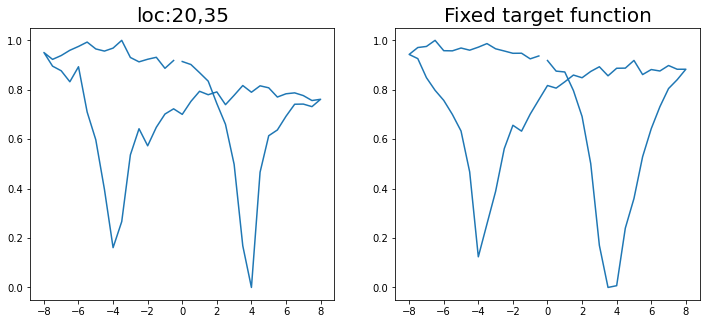

Epoch 1/200 ... Training loss: 2.5012
Epoch 10/200 ... Training loss: 2.388
Epoch 20/200 ... Training loss: 2.2446
Epoch 30/200 ... Training loss: 2.1144
Epoch 40/200 ... Training loss: 2.0497
Epoch 50/200 ... Training loss: 1.982
Epoch 60/200 ... Training loss: 1.9063
Epoch 70/200 ... Training loss: 1.8487
Epoch 80/200 ... Training loss: 1.7487
Epoch 90/200 ... Training loss: 1.5631
Epoch 100/200 ... Training loss: 1.4312
Epoch 110/200 ... Training loss: 1.3349
Epoch 120/200 ... Training loss: 1.2622
Epoch 130/200 ... Training loss: 1.2628
Epoch 140/200 ... Training loss: 1.1686
Epoch 150/200 ... Training loss: 1.1152
Epoch 160/200 ... Training loss: 1.0862
Epoch 170/200 ... Training loss: 1.0704
Epoch 180/200 ... Training loss: 1.0177
Epoch 190/200 ... Training loss: 0.9895
Epoch 200/200 ... Training loss: 0.9355
step:  158
Sample #168




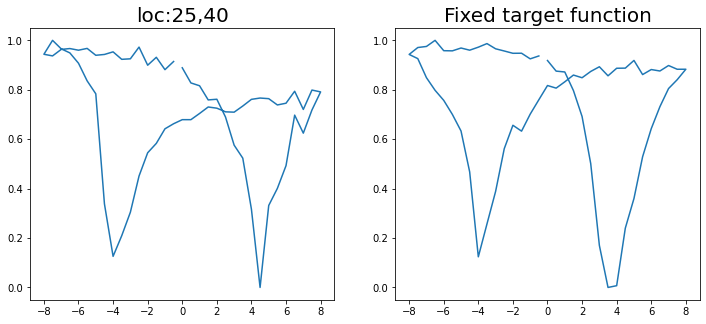

Epoch 1/200 ... Training loss: 2.4968
Epoch 10/200 ... Training loss: 2.2975
Epoch 20/200 ... Training loss: 2.1708
Epoch 30/200 ... Training loss: 2.0017
Epoch 40/200 ... Training loss: 1.8798
Epoch 50/200 ... Training loss: 1.7079
Epoch 60/200 ... Training loss: 1.5274
Epoch 70/200 ... Training loss: 1.4158
Epoch 80/200 ... Training loss: 1.2969
Epoch 90/200 ... Training loss: 1.2333
Epoch 100/200 ... Training loss: 1.178
Epoch 110/200 ... Training loss: 1.106
Epoch 120/200 ... Training loss: 1.1407
Epoch 130/200 ... Training loss: 1.0304
Epoch 140/200 ... Training loss: 0.9807
Epoch 150/200 ... Training loss: 0.967
Epoch 160/200 ... Training loss: 0.9724
Epoch 170/200 ... Training loss: 0.9609
Epoch 180/200 ... Training loss: 0.831
Epoch 190/200 ... Training loss: 1.059
Epoch 200/200 ... Training loss: 0.8219
step:  159
Sample #169




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


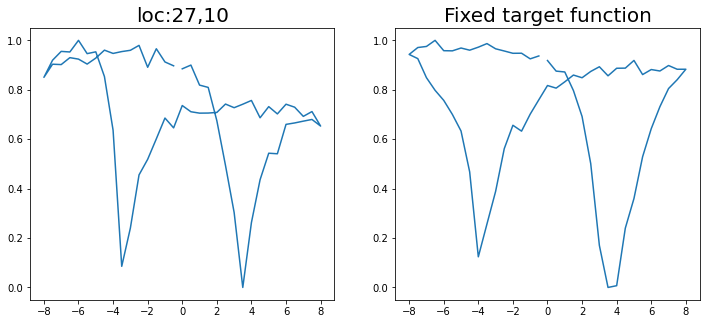

Epoch 1/200 ... Training loss: 2.487
Epoch 10/200 ... Training loss: 2.2967
Epoch 20/200 ... Training loss: 2.1732
Epoch 30/200 ... Training loss: 2.0483
Epoch 40/200 ... Training loss: 1.9489
Epoch 50/200 ... Training loss: 1.8718
Epoch 60/200 ... Training loss: 1.7723
Epoch 70/200 ... Training loss: 1.6531
Epoch 80/200 ... Training loss: 1.5487
Epoch 90/200 ... Training loss: 1.5053
Epoch 100/200 ... Training loss: 1.3497
Epoch 110/200 ... Training loss: 1.2336
Epoch 120/200 ... Training loss: 1.1985
Epoch 130/200 ... Training loss: 1.1472
Epoch 140/200 ... Training loss: 1.1164
Epoch 150/200 ... Training loss: 1.0507
Epoch 160/200 ... Training loss: 1.0542
Epoch 170/200 ... Training loss: 0.9843
Epoch 180/200 ... Training loss: 0.9267
Epoch 190/200 ... Training loss: 0.9072
Epoch 200/200 ... Training loss: 0.8841
step:  160
Sample #170




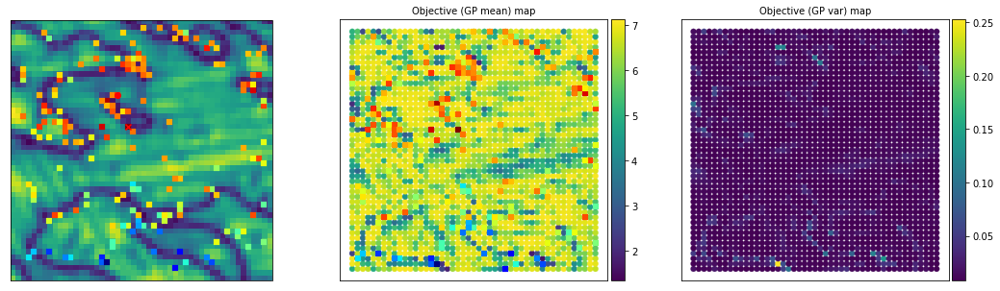

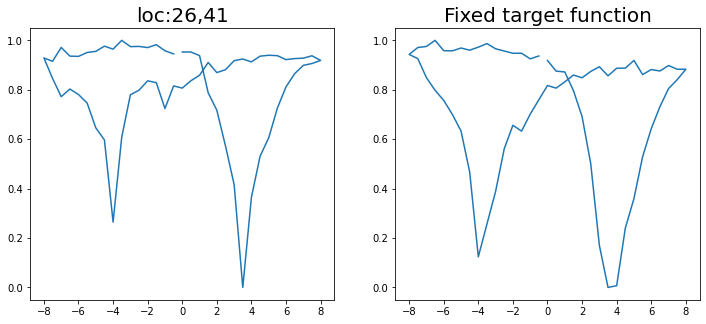

Epoch 1/200 ... Training loss: 2.493
Epoch 10/200 ... Training loss: 2.2914
Epoch 20/200 ... Training loss: 2.1971
Epoch 30/200 ... Training loss: 1.9971
Epoch 40/200 ... Training loss: 1.8628
Epoch 50/200 ... Training loss: 1.67
Epoch 60/200 ... Training loss: 1.5339
Epoch 70/200 ... Training loss: 1.4044
Epoch 80/200 ... Training loss: 1.3262
Epoch 90/200 ... Training loss: 1.2617
Epoch 100/200 ... Training loss: 1.2416
Epoch 110/200 ... Training loss: 1.1377
Epoch 120/200 ... Training loss: 1.0863
Epoch 130/200 ... Training loss: 1.2084
Epoch 140/200 ... Training loss: 1.0997
Epoch 150/200 ... Training loss: 1.0244
Epoch 160/200 ... Training loss: 0.9571
Epoch 170/200 ... Training loss: 0.9587
Epoch 180/200 ... Training loss: 0.9234
Epoch 190/200 ... Training loss: 0.8599
Epoch 200/200 ... Training loss: 0.8144
step:  161
Sample #171




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


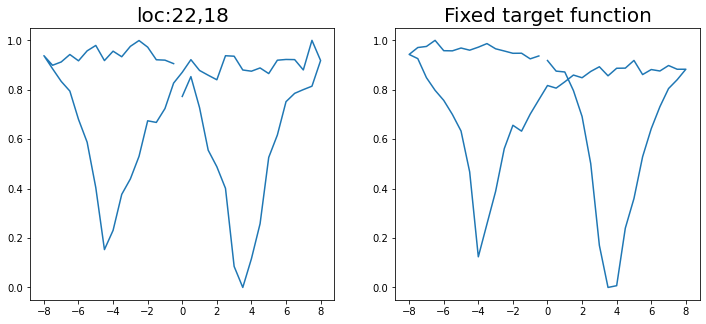

Epoch 1/200 ... Training loss: 2.4865
Epoch 10/200 ... Training loss: 2.3288
Epoch 20/200 ... Training loss: 2.196
Epoch 30/200 ... Training loss: 2.0531
Epoch 40/200 ... Training loss: 1.9311
Epoch 50/200 ... Training loss: 1.7902
Epoch 60/200 ... Training loss: 1.6206
Epoch 70/200 ... Training loss: 1.5035
Epoch 80/200 ... Training loss: 1.3355
Epoch 90/200 ... Training loss: 1.291
Epoch 100/200 ... Training loss: 1.204
Epoch 110/200 ... Training loss: 1.157
Epoch 120/200 ... Training loss: 1.1054
Epoch 130/200 ... Training loss: 1.0716
Epoch 140/200 ... Training loss: 1.1673
Epoch 150/200 ... Training loss: 1.0131
Epoch 160/200 ... Training loss: 0.9414
Epoch 170/200 ... Training loss: 0.9705
Epoch 180/200 ... Training loss: 0.8939
Epoch 190/200 ... Training loss: 0.9182
Epoch 200/200 ... Training loss: 0.8081
step:  162
Sample #172




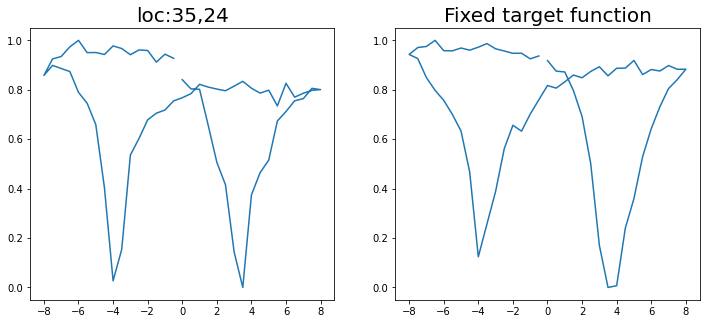

Epoch 1/200 ... Training loss: 2.4904
Epoch 10/200 ... Training loss: 2.238
Epoch 20/200 ... Training loss: 2.1657
Epoch 30/200 ... Training loss: 2.0217
Epoch 40/200 ... Training loss: 1.936
Epoch 50/200 ... Training loss: 1.8132
Epoch 60/200 ... Training loss: 1.653
Epoch 70/200 ... Training loss: 1.539
Epoch 80/200 ... Training loss: 1.3901
Epoch 90/200 ... Training loss: 1.3132
Epoch 100/200 ... Training loss: 1.2433
Epoch 110/200 ... Training loss: 1.1621
Epoch 120/200 ... Training loss: 1.2954
Epoch 130/200 ... Training loss: 1.1
Epoch 140/200 ... Training loss: 1.0389
Epoch 150/200 ... Training loss: 0.9902
Epoch 160/200 ... Training loss: 1.0199
Epoch 170/200 ... Training loss: 0.9704
Epoch 180/200 ... Training loss: 0.9325
Epoch 190/200 ... Training loss: 0.8744
Epoch 200/200 ... Training loss: 0.8215
step:  163
Sample #173




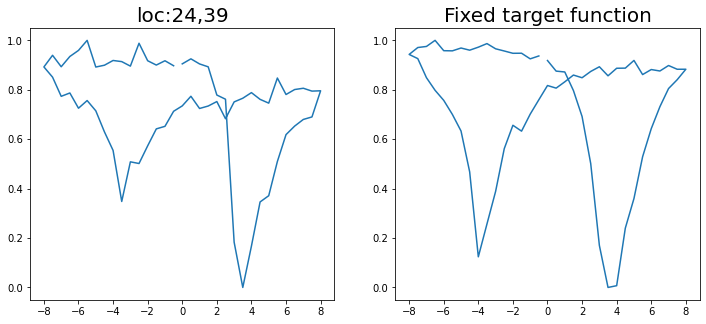

Epoch 1/200 ... Training loss: 2.4804
Epoch 10/200 ... Training loss: 2.2283
Epoch 20/200 ... Training loss: 2.2385
Epoch 30/200 ... Training loss: 2.0122
Epoch 40/200 ... Training loss: 1.9256
Epoch 50/200 ... Training loss: 1.7975
Epoch 60/200 ... Training loss: 1.6224
Epoch 70/200 ... Training loss: 1.4921
Epoch 80/200 ... Training loss: 1.3532
Epoch 90/200 ... Training loss: 1.2915
Epoch 100/200 ... Training loss: 1.1972
Epoch 110/200 ... Training loss: 1.1217
Epoch 120/200 ... Training loss: 1.1044
Epoch 130/200 ... Training loss: 1.0741
Epoch 140/200 ... Training loss: 1.0761
Epoch 150/200 ... Training loss: 0.9945
Epoch 160/200 ... Training loss: 0.9358
Epoch 170/200 ... Training loss: 0.9316
Epoch 180/200 ... Training loss: 0.8696
Epoch 190/200 ... Training loss: 0.8842
Epoch 200/200 ... Training loss: 0.8036
step:  164
Sample #174




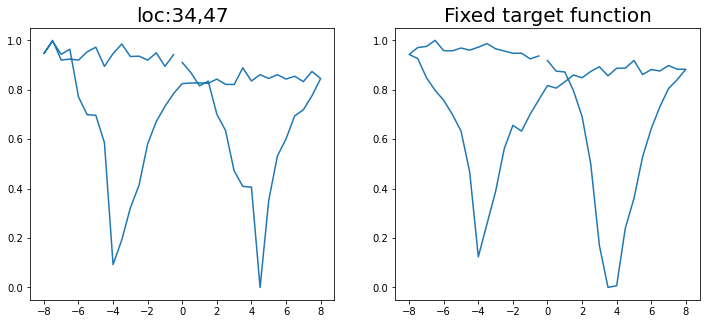

Epoch 1/200 ... Training loss: 2.4744
Epoch 10/200 ... Training loss: 2.3209
Epoch 20/200 ... Training loss: 2.1322
Epoch 30/200 ... Training loss: 2.0644
Epoch 40/200 ... Training loss: 1.943
Epoch 50/200 ... Training loss: 1.8419
Epoch 60/200 ... Training loss: 1.6979
Epoch 70/200 ... Training loss: 1.5538
Epoch 80/200 ... Training loss: 1.4335
Epoch 90/200 ... Training loss: 1.2912
Epoch 100/200 ... Training loss: 1.2774
Epoch 110/200 ... Training loss: 1.1933
Epoch 120/200 ... Training loss: 1.1598
Epoch 130/200 ... Training loss: 1.0906
Epoch 140/200 ... Training loss: 1.0485
Epoch 150/200 ... Training loss: 1.1147
Epoch 160/200 ... Training loss: 1.033
Epoch 170/200 ... Training loss: 0.9628
Epoch 180/200 ... Training loss: 0.9138
Epoch 190/200 ... Training loss: 0.8546
Epoch 200/200 ... Training loss: 0.9792
step:  165
Sample #175




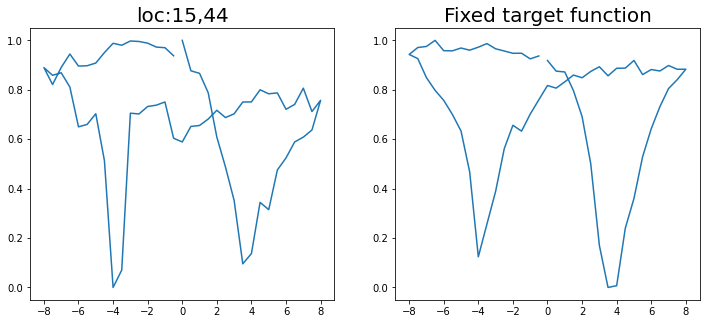

Epoch 1/200 ... Training loss: 2.4649
Epoch 10/200 ... Training loss: 2.1888
Epoch 20/200 ... Training loss: 2.1543
Epoch 30/200 ... Training loss: 2.0022
Epoch 40/200 ... Training loss: 1.8932
Epoch 50/200 ... Training loss: 1.7252
Epoch 60/200 ... Training loss: 1.5949
Epoch 70/200 ... Training loss: 1.4477
Epoch 80/200 ... Training loss: 1.3819
Epoch 90/200 ... Training loss: 1.2716
Epoch 100/200 ... Training loss: 1.2398
Epoch 110/200 ... Training loss: 1.1327
Epoch 120/200 ... Training loss: 1.0931
Epoch 130/200 ... Training loss: 1.3315
Epoch 140/200 ... Training loss: 1.0497
Epoch 150/200 ... Training loss: 0.9953
Epoch 160/200 ... Training loss: 0.9426
Epoch 170/200 ... Training loss: 0.9781
Epoch 180/200 ... Training loss: 0.9738
Epoch 190/200 ... Training loss: 0.8333
Epoch 200/200 ... Training loss: 0.7986
step:  166
Sample #176




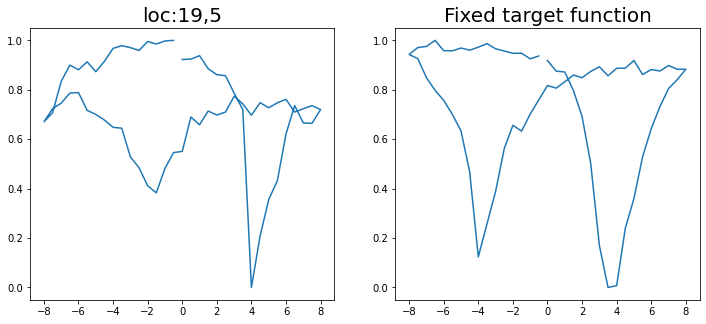

Epoch 1/200 ... Training loss: 2.4685
Epoch 10/200 ... Training loss: 2.2747
Epoch 20/200 ... Training loss: 2.1569
Epoch 30/200 ... Training loss: 2.0033
Epoch 40/200 ... Training loss: 1.9167
Epoch 50/200 ... Training loss: 1.8141
Epoch 60/200 ... Training loss: 1.6809
Epoch 70/200 ... Training loss: 1.5804
Epoch 80/200 ... Training loss: 1.4479
Epoch 90/200 ... Training loss: 1.446
Epoch 100/200 ... Training loss: 1.3001
Epoch 110/200 ... Training loss: 1.2237
Epoch 120/200 ... Training loss: 1.2433
Epoch 130/200 ... Training loss: 1.1312
Epoch 140/200 ... Training loss: 1.1081
Epoch 150/200 ... Training loss: 1.0595
Epoch 160/200 ... Training loss: 1.0183
Epoch 170/200 ... Training loss: 0.9745
Epoch 180/200 ... Training loss: 0.9584
Epoch 190/200 ... Training loss: 0.8858
Epoch 200/200 ... Training loss: 0.8527
step:  167
Sample #177




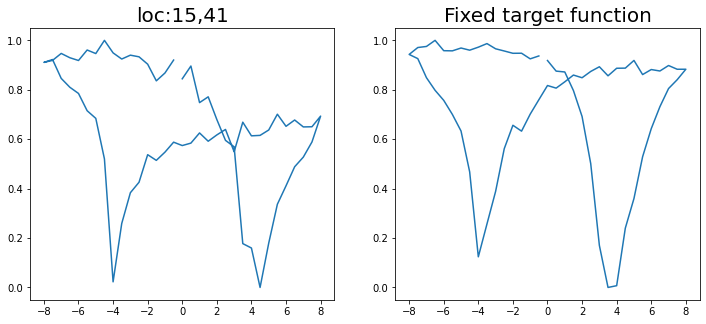

Epoch 1/200 ... Training loss: 2.459
Epoch 10/200 ... Training loss: 2.278
Epoch 20/200 ... Training loss: 2.161
Epoch 30/200 ... Training loss: 1.9943
Epoch 40/200 ... Training loss: 1.8792
Epoch 50/200 ... Training loss: 1.7286
Epoch 60/200 ... Training loss: 1.5757
Epoch 70/200 ... Training loss: 1.4662
Epoch 80/200 ... Training loss: 1.3696
Epoch 90/200 ... Training loss: 1.2825
Epoch 100/200 ... Training loss: 1.1966
Epoch 110/200 ... Training loss: 1.1743
Epoch 120/200 ... Training loss: 1.1115
Epoch 130/200 ... Training loss: 1.1074
Epoch 140/200 ... Training loss: 1.0517
Epoch 150/200 ... Training loss: 1.0874
Epoch 160/200 ... Training loss: 0.9692
Epoch 170/200 ... Training loss: 0.9809
Epoch 180/200 ... Training loss: 0.9094
Epoch 190/200 ... Training loss: 0.9392
Epoch 200/200 ... Training loss: 0.9407
step:  168
Sample #178




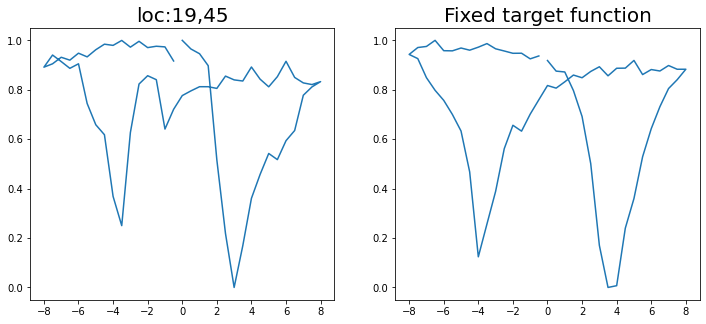

Epoch 1/200 ... Training loss: 2.4497
Epoch 10/200 ... Training loss: 2.2675
Epoch 20/200 ... Training loss: 2.1566
Epoch 30/200 ... Training loss: 2.012
Epoch 40/200 ... Training loss: 1.9008
Epoch 50/200 ... Training loss: 1.7744
Epoch 60/200 ... Training loss: 1.6406
Epoch 70/200 ... Training loss: 1.5136
Epoch 80/200 ... Training loss: 1.3831
Epoch 90/200 ... Training loss: 1.311
Epoch 100/200 ... Training loss: 1.245
Epoch 110/200 ... Training loss: 1.1729
Epoch 120/200 ... Training loss: 1.2635
Epoch 130/200 ... Training loss: 1.1227
Epoch 140/200 ... Training loss: 1.0556
Epoch 150/200 ... Training loss: 1.1696
Epoch 160/200 ... Training loss: 1.004
Epoch 170/200 ... Training loss: 1.0178
Epoch 180/200 ... Training loss: 0.9588
Epoch 190/200 ... Training loss: 0.9474
Epoch 200/200 ... Training loss: 0.916
step:  169
Sample #179




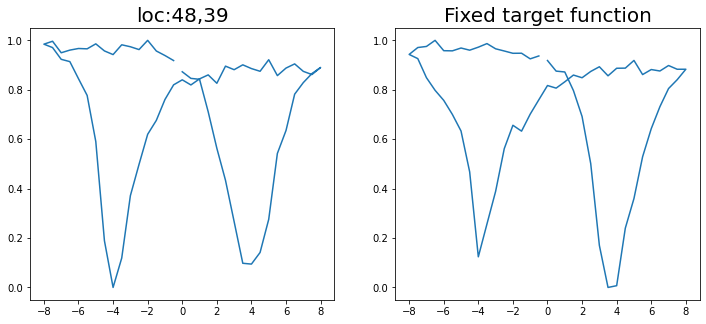

Epoch 1/200 ... Training loss: 2.4634
Epoch 10/200 ... Training loss: 2.3031
Epoch 20/200 ... Training loss: 2.1813
Epoch 30/200 ... Training loss: 2.0316
Epoch 40/200 ... Training loss: 1.9409
Epoch 50/200 ... Training loss: 1.8264
Epoch 60/200 ... Training loss: 1.6949
Epoch 70/200 ... Training loss: 1.5973
Epoch 80/200 ... Training loss: 1.5131
Epoch 90/200 ... Training loss: 1.4229
Epoch 100/200 ... Training loss: 1.3138
Epoch 110/200 ... Training loss: 1.2637
Epoch 120/200 ... Training loss: 1.2192
Epoch 130/200 ... Training loss: 1.1593
Epoch 140/200 ... Training loss: 1.0649
Epoch 150/200 ... Training loss: 1.1491
Epoch 160/200 ... Training loss: 1.047
Epoch 170/200 ... Training loss: 0.983
Epoch 180/200 ... Training loss: 0.9318
Epoch 190/200 ... Training loss: 1.0277
Epoch 200/200 ... Training loss: 0.884
step:  170
Sample #180




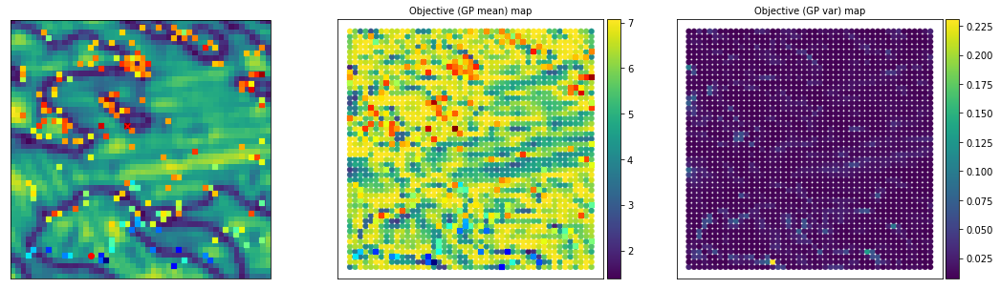

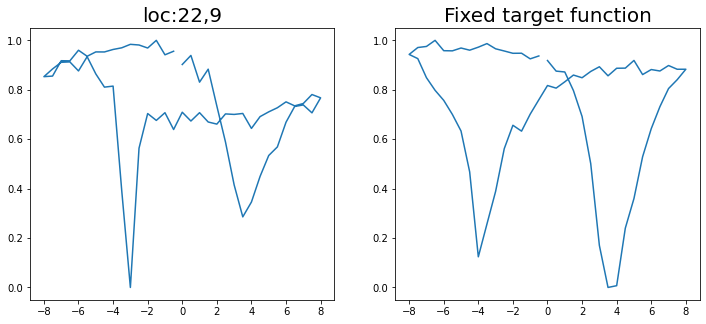

Epoch 1/200 ... Training loss: 2.4597
Epoch 10/200 ... Training loss: 2.2976
Epoch 20/200 ... Training loss: 2.1803
Epoch 30/200 ... Training loss: 2.0784
Epoch 40/200 ... Training loss: 1.9729
Epoch 50/200 ... Training loss: 1.8926
Epoch 60/200 ... Training loss: 1.7876
Epoch 70/200 ... Training loss: 1.6566
Epoch 80/200 ... Training loss: 1.4965
Epoch 90/200 ... Training loss: 1.4006
Epoch 100/200 ... Training loss: 1.2985
Epoch 110/200 ... Training loss: 1.2519
Epoch 120/200 ... Training loss: 1.1867
Epoch 130/200 ... Training loss: 1.1725
Epoch 140/200 ... Training loss: 1.1442
Epoch 150/200 ... Training loss: 1.0805
Epoch 160/200 ... Training loss: 1.3028
Epoch 170/200 ... Training loss: 1.0844
Epoch 180/200 ... Training loss: 0.9843
Epoch 190/200 ... Training loss: 0.9684
Epoch 200/200 ... Training loss: 1.0416
step:  171
Sample #181




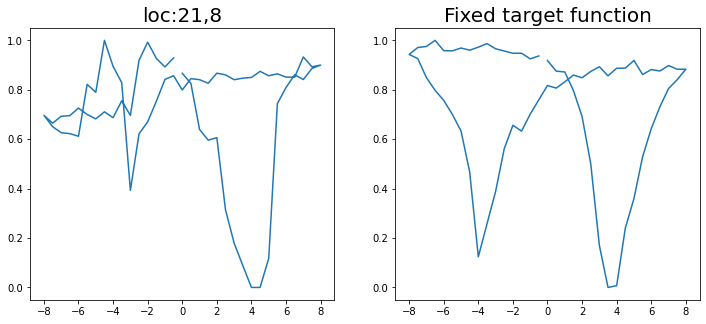

Epoch 1/200 ... Training loss: 2.4631
Epoch 10/200 ... Training loss: 2.1826
Epoch 20/200 ... Training loss: 2.1606
Epoch 30/200 ... Training loss: 1.9912
Epoch 40/200 ... Training loss: 1.8657
Epoch 50/200 ... Training loss: 1.7145
Epoch 60/200 ... Training loss: 1.5485
Epoch 70/200 ... Training loss: 1.4166
Epoch 80/200 ... Training loss: 1.3883
Epoch 90/200 ... Training loss: 1.2563
Epoch 100/200 ... Training loss: 1.308
Epoch 110/200 ... Training loss: 1.1592
Epoch 120/200 ... Training loss: 1.1134
Epoch 130/200 ... Training loss: 1.0681
Epoch 140/200 ... Training loss: 1.0313
Epoch 150/200 ... Training loss: 1.1291
Epoch 160/200 ... Training loss: 1.0676
Epoch 170/200 ... Training loss: 0.9543
Epoch 180/200 ... Training loss: 0.89
Epoch 190/200 ... Training loss: 0.9438
Epoch 200/200 ... Training loss: 0.865
step:  172
Sample #182




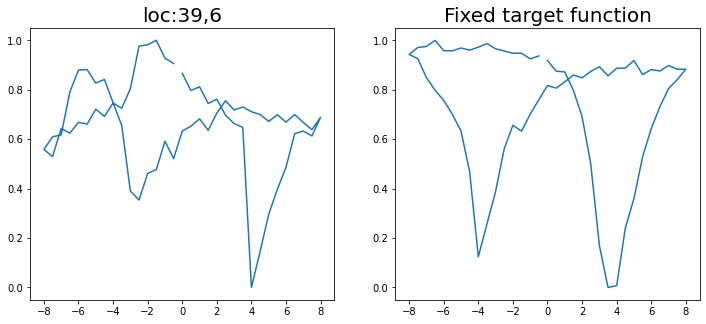

Epoch 1/200 ... Training loss: 2.4838
Epoch 10/200 ... Training loss: 2.3075
Epoch 20/200 ... Training loss: 2.1951
Epoch 30/200 ... Training loss: 2.0288
Epoch 40/200 ... Training loss: 1.9053
Epoch 50/200 ... Training loss: 1.7389
Epoch 60/200 ... Training loss: 1.6752
Epoch 70/200 ... Training loss: 1.4719
Epoch 80/200 ... Training loss: 1.3683
Epoch 90/200 ... Training loss: 1.386
Epoch 100/200 ... Training loss: 1.2796
Epoch 110/200 ... Training loss: 1.1985
Epoch 120/200 ... Training loss: 1.2829
Epoch 130/200 ... Training loss: 1.1849
Epoch 140/200 ... Training loss: 1.1422
Epoch 150/200 ... Training loss: 1.0478
Epoch 160/200 ... Training loss: 1.0186
Epoch 170/200 ... Training loss: 1.0098
Epoch 180/200 ... Training loss: 0.9515
Epoch 190/200 ... Training loss: 0.9007
Epoch 200/200 ... Training loss: 0.896
step:  173
Sample #183




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


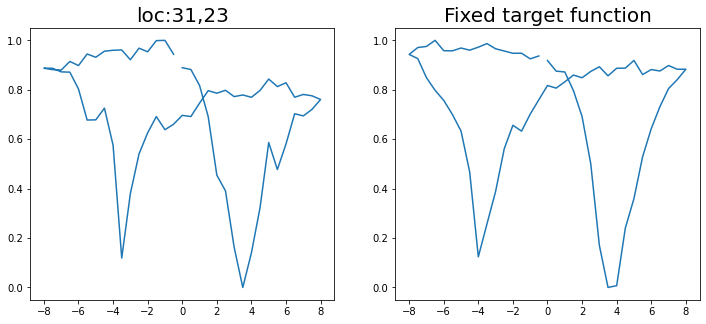

Epoch 1/200 ... Training loss: 2.4819
Epoch 10/200 ... Training loss: 2.3402
Epoch 20/200 ... Training loss: 2.2164
Epoch 30/200 ... Training loss: 2.1061
Epoch 40/200 ... Training loss: 2.0025
Epoch 50/200 ... Training loss: 1.9309
Epoch 60/200 ... Training loss: 1.8555
Epoch 70/200 ... Training loss: 1.7624
Epoch 80/200 ... Training loss: 1.6443
Epoch 90/200 ... Training loss: 1.5513
Epoch 100/200 ... Training loss: 1.428
Epoch 110/200 ... Training loss: 1.3565
Epoch 120/200 ... Training loss: 1.3437
Epoch 130/200 ... Training loss: 1.207
Epoch 140/200 ... Training loss: 1.1448
Epoch 150/200 ... Training loss: 1.1119
Epoch 160/200 ... Training loss: 1.0559
Epoch 170/200 ... Training loss: 1.1034
Epoch 180/200 ... Training loss: 1.0152
Epoch 190/200 ... Training loss: 0.966
Epoch 200/200 ... Training loss: 0.9158
step:  174
Sample #184




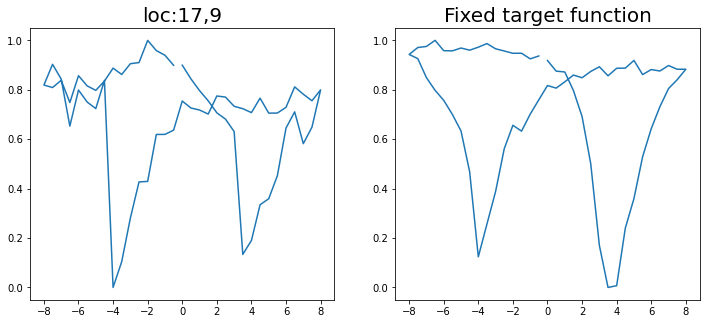

Epoch 1/200 ... Training loss: 2.4734
Epoch 10/200 ... Training loss: 2.321
Epoch 20/200 ... Training loss: 2.1934
Epoch 30/200 ... Training loss: 2.0501
Epoch 40/200 ... Training loss: 1.9665
Epoch 50/200 ... Training loss: 1.8781
Epoch 60/200 ... Training loss: 1.7449
Epoch 70/200 ... Training loss: 1.5665
Epoch 80/200 ... Training loss: 1.4496
Epoch 90/200 ... Training loss: 1.3066
Epoch 100/200 ... Training loss: 1.318
Epoch 110/200 ... Training loss: 1.1891
Epoch 120/200 ... Training loss: 1.2311
Epoch 130/200 ... Training loss: 1.1113
Epoch 140/200 ... Training loss: 1.042
Epoch 150/200 ... Training loss: 1.1207
Epoch 160/200 ... Training loss: 1.0143
Epoch 170/200 ... Training loss: 0.9977
Epoch 180/200 ... Training loss: 0.9398
Epoch 190/200 ... Training loss: 1.0574
Epoch 200/200 ... Training loss: 0.8746
step:  175
Sample #185




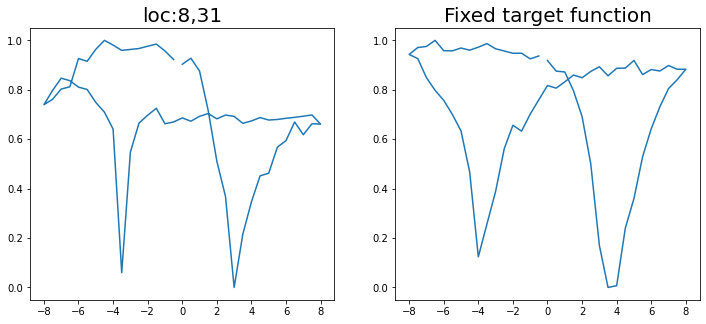

Epoch 1/200 ... Training loss: 2.4652
Epoch 10/200 ... Training loss: 2.3089
Epoch 20/200 ... Training loss: 2.1983
Epoch 30/200 ... Training loss: 2.0273
Epoch 40/200 ... Training loss: 1.9787
Epoch 50/200 ... Training loss: 1.8976
Epoch 60/200 ... Training loss: 1.7838
Epoch 70/200 ... Training loss: 1.6272
Epoch 80/200 ... Training loss: 1.559
Epoch 90/200 ... Training loss: 1.4242
Epoch 100/200 ... Training loss: 1.4656
Epoch 110/200 ... Training loss: 1.3359
Epoch 120/200 ... Training loss: 1.2475
Epoch 130/200 ... Training loss: 1.1881
Epoch 140/200 ... Training loss: 1.3183
Epoch 150/200 ... Training loss: 1.1227
Epoch 160/200 ... Training loss: 1.0728
Epoch 170/200 ... Training loss: 1.0198
Epoch 180/200 ... Training loss: 1.0248
Epoch 190/200 ... Training loss: 0.9655
Epoch 200/200 ... Training loss: 0.9192
step:  176
Sample #186




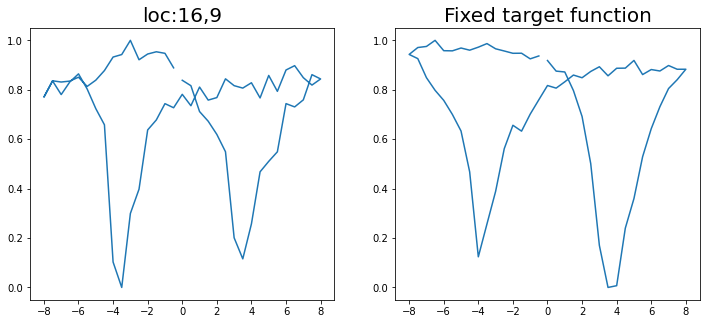

Epoch 1/200 ... Training loss: 2.4586
Epoch 10/200 ... Training loss: 2.3142
Epoch 20/200 ... Training loss: 2.1977
Epoch 30/200 ... Training loss: 2.0914
Epoch 40/200 ... Training loss: 1.9799
Epoch 50/200 ... Training loss: 1.8977
Epoch 60/200 ... Training loss: 1.7953
Epoch 70/200 ... Training loss: 1.6622
Epoch 80/200 ... Training loss: 1.5615
Epoch 90/200 ... Training loss: 1.4164
Epoch 100/200 ... Training loss: 1.3557
Epoch 110/200 ... Training loss: 1.3157
Epoch 120/200 ... Training loss: 1.2424
Epoch 130/200 ... Training loss: 1.274
Epoch 140/200 ... Training loss: 1.1724
Epoch 150/200 ... Training loss: 1.1169
Epoch 160/200 ... Training loss: 1.0687
Epoch 170/200 ... Training loss: 1.1748
Epoch 180/200 ... Training loss: 1.0405
Epoch 190/200 ... Training loss: 1.0118
Epoch 200/200 ... Training loss: 0.934
step:  177
Sample #187




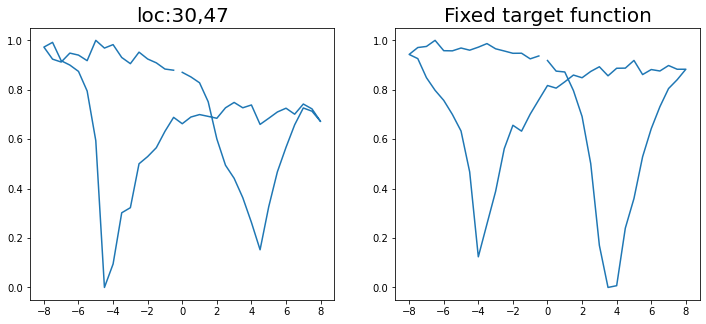

Epoch 1/200 ... Training loss: 2.4497
Epoch 10/200 ... Training loss: 2.3004
Epoch 20/200 ... Training loss: 2.1942
Epoch 30/200 ... Training loss: 2.0813
Epoch 40/200 ... Training loss: 1.9647
Epoch 50/200 ... Training loss: 1.8904
Epoch 60/200 ... Training loss: 1.7985
Epoch 70/200 ... Training loss: 1.689
Epoch 80/200 ... Training loss: 1.5594
Epoch 90/200 ... Training loss: 1.476
Epoch 100/200 ... Training loss: 1.3924
Epoch 110/200 ... Training loss: 1.3117
Epoch 120/200 ... Training loss: 1.273
Epoch 130/200 ... Training loss: 1.198
Epoch 140/200 ... Training loss: 1.2193
Epoch 150/200 ... Training loss: 1.1546
Epoch 160/200 ... Training loss: 1.075
Epoch 170/200 ... Training loss: 1.0594
Epoch 180/200 ... Training loss: 1.0148
Epoch 190/200 ... Training loss: 0.9745
Epoch 200/200 ... Training loss: 0.9846
step:  178
Sample #188




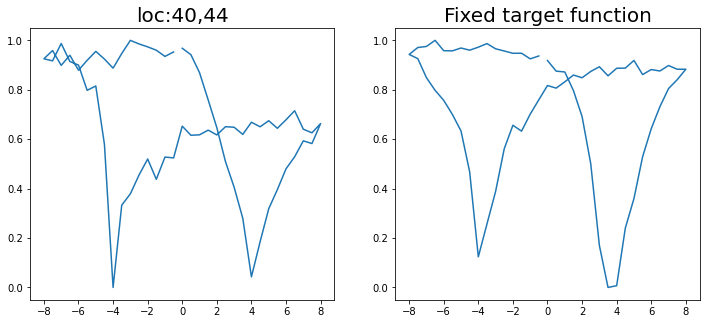

Epoch 1/200 ... Training loss: 2.4448
Epoch 10/200 ... Training loss: 2.2949
Epoch 20/200 ... Training loss: 2.1884
Epoch 30/200 ... Training loss: 2.1173
Epoch 40/200 ... Training loss: 2.0318
Epoch 50/200 ... Training loss: 1.9312
Epoch 60/200 ... Training loss: 1.8506
Epoch 70/200 ... Training loss: 1.734
Epoch 80/200 ... Training loss: 1.6102
Epoch 90/200 ... Training loss: 1.4819
Epoch 100/200 ... Training loss: 1.4104
Epoch 110/200 ... Training loss: 1.3916
Epoch 120/200 ... Training loss: 1.2448
Epoch 130/200 ... Training loss: 1.1921
Epoch 140/200 ... Training loss: 1.1519
Epoch 150/200 ... Training loss: 1.1371
Epoch 160/200 ... Training loss: 1.0913
Epoch 170/200 ... Training loss: 1.0601
Epoch 180/200 ... Training loss: 1.0067
Epoch 190/200 ... Training loss: 0.9409
Epoch 200/200 ... Training loss: 0.9719
step:  179
Sample #189




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


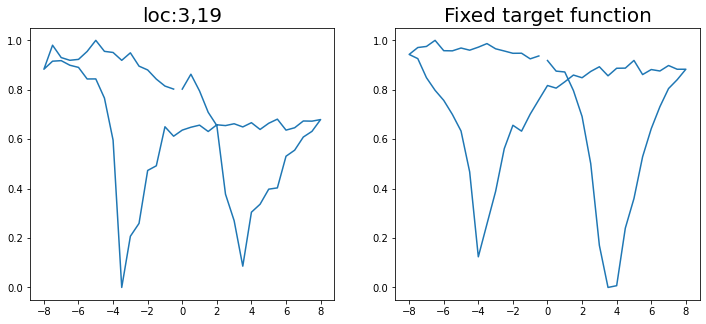

Epoch 1/200 ... Training loss: 2.4381
Epoch 10/200 ... Training loss: 2.3457
Epoch 20/200 ... Training loss: 2.1938
Epoch 30/200 ... Training loss: 2.1111
Epoch 40/200 ... Training loss: 2.011
Epoch 50/200 ... Training loss: 1.9156
Epoch 60/200 ... Training loss: 1.8157
Epoch 70/200 ... Training loss: 1.6905
Epoch 80/200 ... Training loss: 1.5585
Epoch 90/200 ... Training loss: 1.4518
Epoch 100/200 ... Training loss: 1.3719
Epoch 110/200 ... Training loss: 1.3107
Epoch 120/200 ... Training loss: 1.2741
Epoch 130/200 ... Training loss: 1.1999
Epoch 140/200 ... Training loss: 1.2081
Epoch 150/200 ... Training loss: 1.1318
Epoch 160/200 ... Training loss: 1.0597
Epoch 170/200 ... Training loss: 1.0321
Epoch 180/200 ... Training loss: 1.0214
Epoch 190/200 ... Training loss: 1.0484
Epoch 200/200 ... Training loss: 0.9533
step:  180
Sample #190




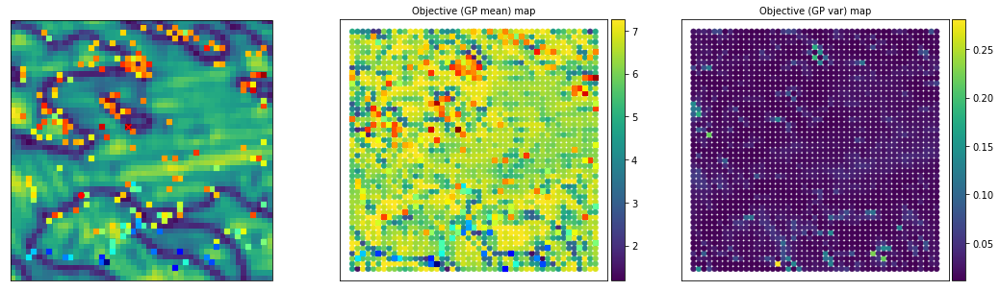

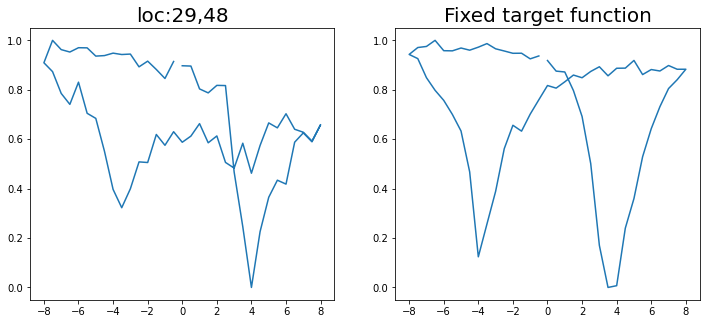

Epoch 1/200 ... Training loss: 2.4293
Epoch 10/200 ... Training loss: 2.3327
Epoch 20/200 ... Training loss: 2.1989
Epoch 30/200 ... Training loss: 2.1016
Epoch 40/200 ... Training loss: 2.0232
Epoch 50/200 ... Training loss: 1.9396
Epoch 60/200 ... Training loss: 1.8623
Epoch 70/200 ... Training loss: 1.7513
Epoch 80/200 ... Training loss: 1.6158
Epoch 90/200 ... Training loss: 1.532
Epoch 100/200 ... Training loss: 1.5257
Epoch 110/200 ... Training loss: 1.4459
Epoch 120/200 ... Training loss: 1.4072
Epoch 130/200 ... Training loss: 1.3438
Epoch 140/200 ... Training loss: 1.2846
Epoch 150/200 ... Training loss: 1.2419
Epoch 160/200 ... Training loss: 1.1735
Epoch 170/200 ... Training loss: 1.1024
Epoch 180/200 ... Training loss: 1.074
Epoch 190/200 ... Training loss: 1.1316
Epoch 200/200 ... Training loss: 1.0296
step:  181
Sample #191




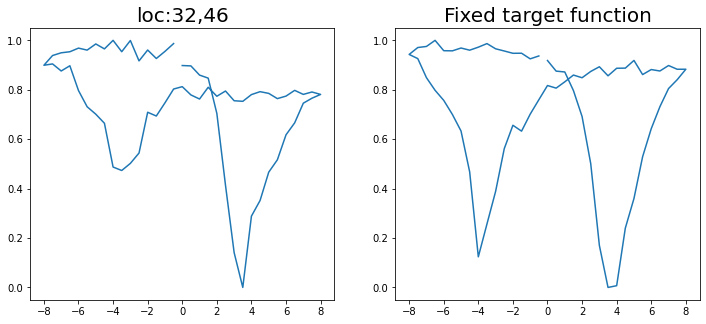

Epoch 1/200 ... Training loss: 2.4295
Epoch 10/200 ... Training loss: 2.3081
Epoch 20/200 ... Training loss: 2.2074
Epoch 30/200 ... Training loss: 2.1065
Epoch 40/200 ... Training loss: 2.0277
Epoch 50/200 ... Training loss: 1.9397
Epoch 60/200 ... Training loss: 1.8597
Epoch 70/200 ... Training loss: 1.7558
Epoch 80/200 ... Training loss: 1.6347
Epoch 90/200 ... Training loss: 1.5064
Epoch 100/200 ... Training loss: 1.4352
Epoch 110/200 ... Training loss: 1.3411
Epoch 120/200 ... Training loss: 1.2709
Epoch 130/200 ... Training loss: 1.3299
Epoch 140/200 ... Training loss: 1.2141
Epoch 150/200 ... Training loss: 1.1355
Epoch 160/200 ... Training loss: 1.1878
Epoch 170/200 ... Training loss: 1.1027
Epoch 180/200 ... Training loss: 1.0392
Epoch 190/200 ... Training loss: 0.9854
Epoch 200/200 ... Training loss: 0.948
step:  182
Sample #192




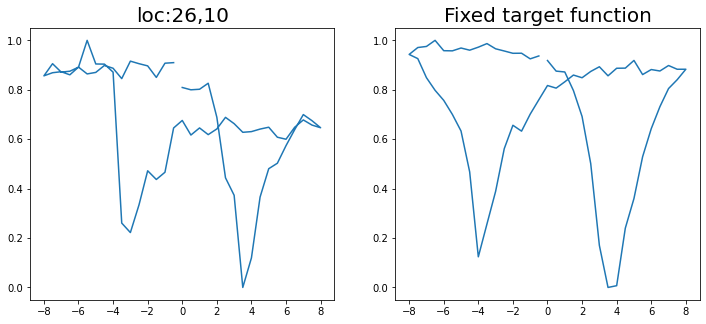

Epoch 1/200 ... Training loss: 2.4249
Epoch 10/200 ... Training loss: 2.2529
Epoch 20/200 ... Training loss: 2.1498
Epoch 30/200 ... Training loss: 2.0376
Epoch 40/200 ... Training loss: 1.9015
Epoch 50/200 ... Training loss: 1.7741
Epoch 60/200 ... Training loss: 1.6299
Epoch 70/200 ... Training loss: 1.5704
Epoch 80/200 ... Training loss: 1.445
Epoch 90/200 ... Training loss: 1.4452
Epoch 100/200 ... Training loss: 1.3893
Epoch 110/200 ... Training loss: 1.5711
Epoch 120/200 ... Training loss: 1.4188
Epoch 130/200 ... Training loss: 1.2906
Epoch 140/200 ... Training loss: 1.2047
Epoch 150/200 ... Training loss: 1.258
Epoch 160/200 ... Training loss: 1.1316
Epoch 170/200 ... Training loss: 1.0653
Epoch 180/200 ... Training loss: 1.0428
Epoch 190/200 ... Training loss: 1.0915
Epoch 200/200 ... Training loss: 0.9856
step:  183
Sample #193




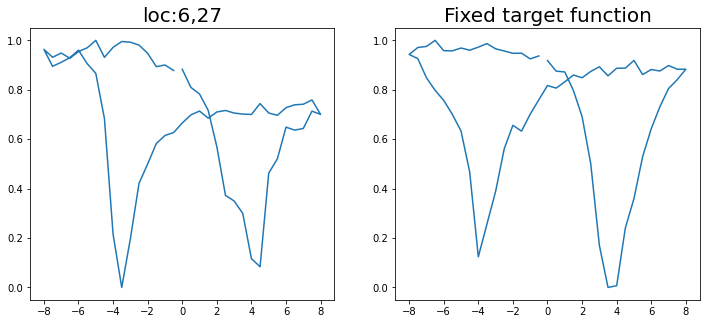

Epoch 1/200 ... Training loss: 2.4209
Epoch 10/200 ... Training loss: 2.2858
Epoch 20/200 ... Training loss: 2.1777
Epoch 30/200 ... Training loss: 2.0573
Epoch 40/200 ... Training loss: 1.9385
Epoch 50/200 ... Training loss: 1.8304
Epoch 60/200 ... Training loss: 1.7048
Epoch 70/200 ... Training loss: 1.5293
Epoch 80/200 ... Training loss: 1.4554
Epoch 90/200 ... Training loss: 1.3425
Epoch 100/200 ... Training loss: 1.3444
Epoch 110/200 ... Training loss: 1.2034
Epoch 120/200 ... Training loss: 1.2772
Epoch 130/200 ... Training loss: 1.157
Epoch 140/200 ... Training loss: 1.0908
Epoch 150/200 ... Training loss: 1.0988
Epoch 160/200 ... Training loss: 1.0103
Epoch 170/200 ... Training loss: 1.0364
Epoch 180/200 ... Training loss: 0.9475
Epoch 190/200 ... Training loss: 1.0436
Epoch 200/200 ... Training loss: 0.8753
step:  184
Sample #194




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


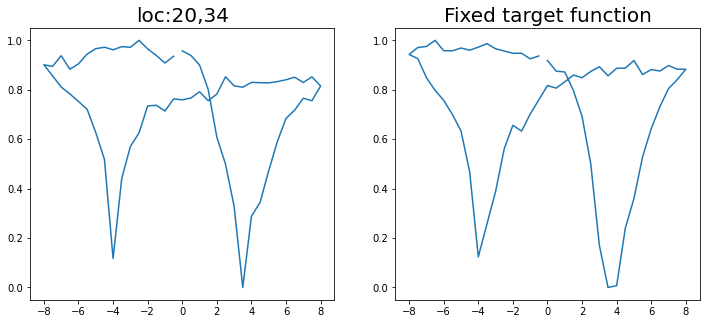

Epoch 1/200 ... Training loss: 2.4238
Epoch 10/200 ... Training loss: 2.2709
Epoch 20/200 ... Training loss: 2.1555
Epoch 30/200 ... Training loss: 2.0333
Epoch 40/200 ... Training loss: 1.9389
Epoch 50/200 ... Training loss: 1.8355
Epoch 60/200 ... Training loss: 1.698
Epoch 70/200 ... Training loss: 1.5842
Epoch 80/200 ... Training loss: 1.483
Epoch 90/200 ... Training loss: 1.3979
Epoch 100/200 ... Training loss: 1.2987
Epoch 110/200 ... Training loss: 1.2109
Epoch 120/200 ... Training loss: 1.2223
Epoch 130/200 ... Training loss: 1.1301
Epoch 140/200 ... Training loss: 1.1057
Epoch 150/200 ... Training loss: 1.0694
Epoch 160/200 ... Training loss: 0.9926
Epoch 170/200 ... Training loss: 1.0564
Epoch 180/200 ... Training loss: 0.9909
Epoch 190/200 ... Training loss: 0.8946
Epoch 200/200 ... Training loss: 0.8483
step:  185
Sample #195




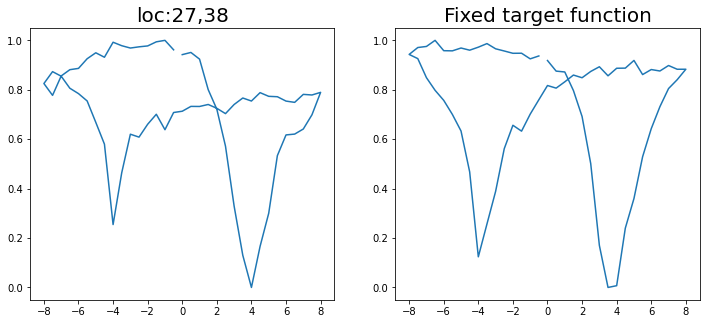

Epoch 1/200 ... Training loss: 2.4176
Epoch 10/200 ... Training loss: 2.2805
Epoch 20/200 ... Training loss: 2.1607
Epoch 30/200 ... Training loss: 2.0403
Epoch 40/200 ... Training loss: 1.9217
Epoch 50/200 ... Training loss: 1.8048
Epoch 60/200 ... Training loss: 1.6515
Epoch 70/200 ... Training loss: 1.5642
Epoch 80/200 ... Training loss: 1.4344
Epoch 90/200 ... Training loss: 1.3257
Epoch 100/200 ... Training loss: 1.2517
Epoch 110/200 ... Training loss: 1.2746
Epoch 120/200 ... Training loss: 1.177
Epoch 130/200 ... Training loss: 1.1178
Epoch 140/200 ... Training loss: 1.0912
Epoch 150/200 ... Training loss: 1.0697
Epoch 160/200 ... Training loss: 1.3547
Epoch 170/200 ... Training loss: 1.0209
Epoch 180/200 ... Training loss: 0.9484
Epoch 190/200 ... Training loss: 0.9636
Epoch 200/200 ... Training loss: 0.8647
step:  186
Sample #196




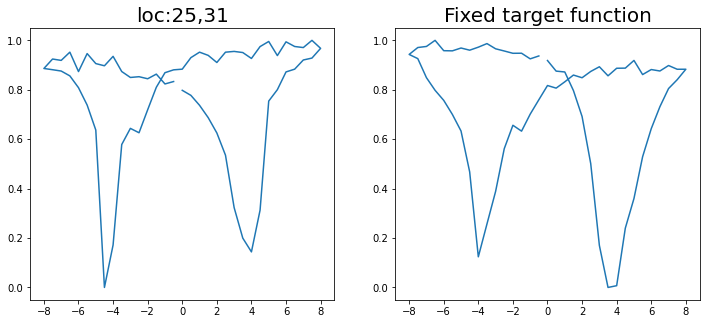

Epoch 1/200 ... Training loss: 2.418
Epoch 10/200 ... Training loss: 2.2818
Epoch 20/200 ... Training loss: 2.1659
Epoch 30/200 ... Training loss: 2.0531
Epoch 40/200 ... Training loss: 1.9434
Epoch 50/200 ... Training loss: 1.8402
Epoch 60/200 ... Training loss: 1.6876
Epoch 70/200 ... Training loss: 1.557
Epoch 80/200 ... Training loss: 1.5319
Epoch 90/200 ... Training loss: 1.4114
Epoch 100/200 ... Training loss: 1.4589
Epoch 110/200 ... Training loss: 1.3117
Epoch 120/200 ... Training loss: 1.2613
Epoch 130/200 ... Training loss: 1.1909
Epoch 140/200 ... Training loss: 1.1784
Epoch 150/200 ... Training loss: 1.1205
Epoch 160/200 ... Training loss: 1.1543
Epoch 170/200 ... Training loss: 1.0429
Epoch 180/200 ... Training loss: 1.083
Epoch 190/200 ... Training loss: 0.9874
Epoch 200/200 ... Training loss: 1.0232
step:  187
Sample #197




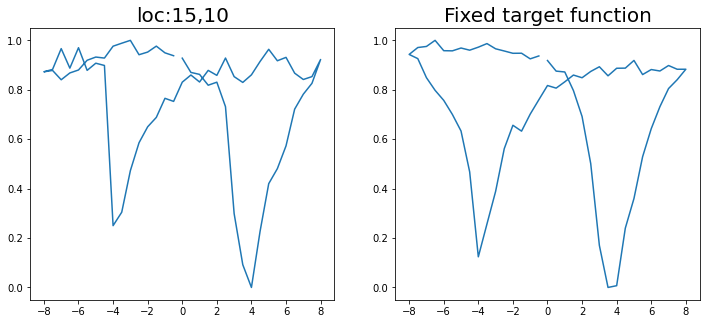

Epoch 1/200 ... Training loss: 2.4114
Epoch 10/200 ... Training loss: 2.2608
Epoch 20/200 ... Training loss: 2.1677
Epoch 30/200 ... Training loss: 2.0304
Epoch 40/200 ... Training loss: 1.9135
Epoch 50/200 ... Training loss: 1.8058
Epoch 60/200 ... Training loss: 1.6689
Epoch 70/200 ... Training loss: 1.618
Epoch 80/200 ... Training loss: 1.4381
Epoch 90/200 ... Training loss: 1.3676
Epoch 100/200 ... Training loss: 1.268
Epoch 110/200 ... Training loss: 1.3008
Epoch 120/200 ... Training loss: 1.2629
Epoch 130/200 ... Training loss: 1.1708
Epoch 140/200 ... Training loss: 1.1128
Epoch 150/200 ... Training loss: 1.1847
Epoch 160/200 ... Training loss: 1.0676
Epoch 170/200 ... Training loss: 0.9939
Epoch 180/200 ... Training loss: 0.9619
Epoch 190/200 ... Training loss: 0.9393
Epoch 200/200 ... Training loss: 0.8891
step:  188
Sample #198




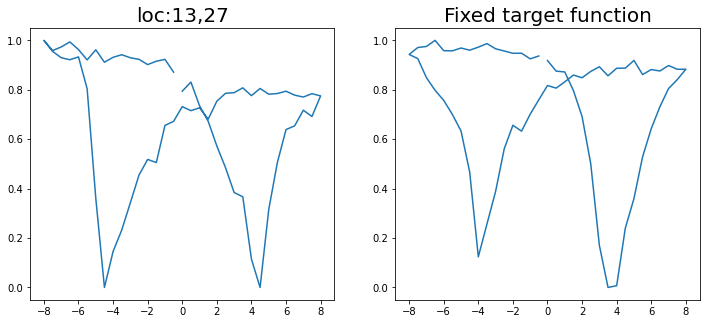

Epoch 1/200 ... Training loss: 2.4101
Epoch 10/200 ... Training loss: 2.2713
Epoch 20/200 ... Training loss: 2.1654
Epoch 30/200 ... Training loss: 2.0532
Epoch 40/200 ... Training loss: 1.9428
Epoch 50/200 ... Training loss: 1.8682
Epoch 60/200 ... Training loss: 1.7642
Epoch 70/200 ... Training loss: 1.6453
Epoch 80/200 ... Training loss: 1.5593
Epoch 90/200 ... Training loss: 1.4883
Epoch 100/200 ... Training loss: 1.3608
Epoch 110/200 ... Training loss: 1.3754
Epoch 120/200 ... Training loss: 1.2811
Epoch 130/200 ... Training loss: 1.2267
Epoch 140/200 ... Training loss: 1.2138
Epoch 150/200 ... Training loss: 1.161
Epoch 160/200 ... Training loss: 1.169
Epoch 170/200 ... Training loss: 1.1077
Epoch 180/200 ... Training loss: 1.0792
Epoch 190/200 ... Training loss: 1.0693
Epoch 200/200 ... Training loss: 0.9884
step:  189
Sample #199




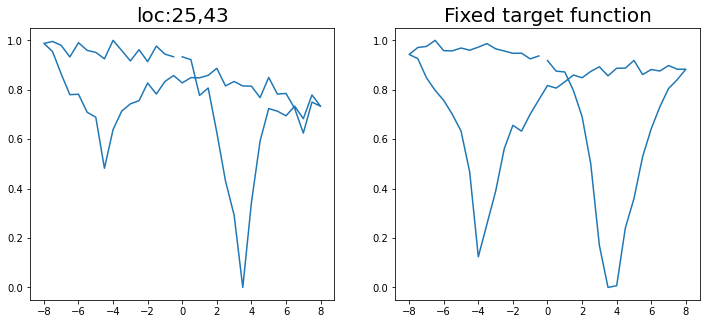

Epoch 1/200 ... Training loss: 2.4074
Epoch 10/200 ... Training loss: 2.2669
Epoch 20/200 ... Training loss: 2.1646
Epoch 30/200 ... Training loss: 2.0448
Epoch 40/200 ... Training loss: 1.9117
Epoch 50/200 ... Training loss: 1.7849
Epoch 60/200 ... Training loss: 1.643
Epoch 70/200 ... Training loss: 1.5889
Epoch 80/200 ... Training loss: 1.4607
Epoch 90/200 ... Training loss: 1.3518
Epoch 100/200 ... Training loss: 1.2913
Epoch 110/200 ... Training loss: 1.2069
Epoch 120/200 ... Training loss: 1.1551
Epoch 130/200 ... Training loss: 1.0944
Epoch 140/200 ... Training loss: 1.0883
Epoch 150/200 ... Training loss: 1.0915
Epoch 160/200 ... Training loss: 1.002
Epoch 170/200 ... Training loss: 1.1621
Epoch 180/200 ... Training loss: 0.9593
Epoch 190/200 ... Training loss: 0.8926
Epoch 200/200 ... Training loss: 1.6907
step:  190
Sample #200




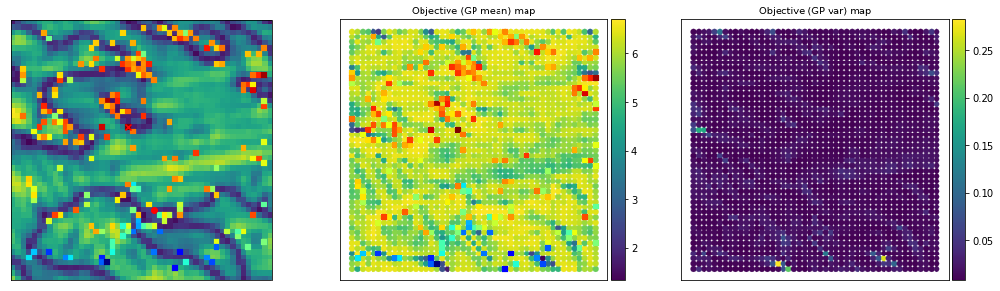

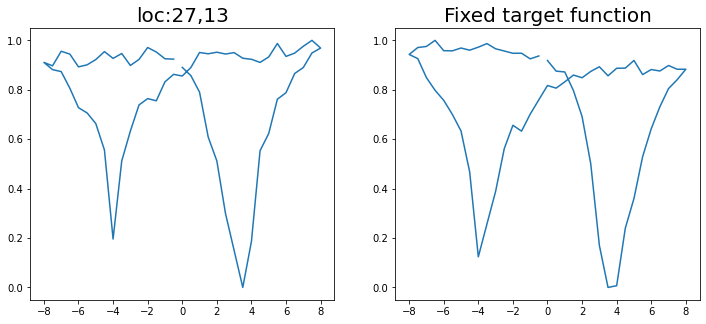

Epoch 1/200 ... Training loss: 2.4069
Epoch 10/200 ... Training loss: 2.2676
Epoch 20/200 ... Training loss: 2.1548
Epoch 30/200 ... Training loss: 2.0438
Epoch 40/200 ... Training loss: 1.9252
Epoch 50/200 ... Training loss: 1.8011
Epoch 60/200 ... Training loss: 1.6597
Epoch 70/200 ... Training loss: 1.5189
Epoch 80/200 ... Training loss: 1.4381
Epoch 90/200 ... Training loss: 1.3664
Epoch 100/200 ... Training loss: 1.2896
Epoch 110/200 ... Training loss: 1.2403
Epoch 120/200 ... Training loss: 1.1578
Epoch 130/200 ... Training loss: 1.194
Epoch 140/200 ... Training loss: 1.0847
Epoch 150/200 ... Training loss: 1.0451
Epoch 160/200 ... Training loss: 1.0298
Epoch 170/200 ... Training loss: 0.9577
Epoch 180/200 ... Training loss: 1.0037
Epoch 190/200 ... Training loss: 0.9197
Epoch 200/200 ... Training loss: 0.9802
step:  191
Sample #201




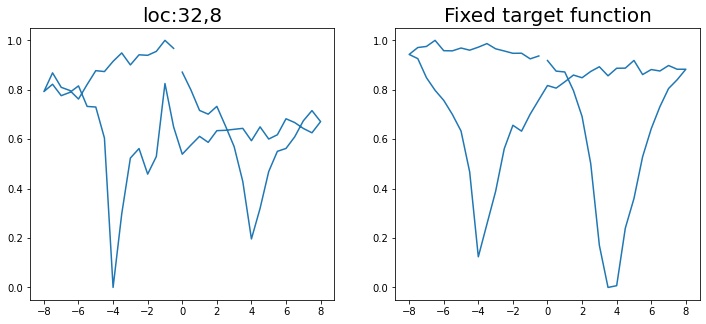

Epoch 1/200 ... Training loss: 2.4064
Epoch 10/200 ... Training loss: 2.2489
Epoch 20/200 ... Training loss: 2.1557
Epoch 30/200 ... Training loss: 2.0557
Epoch 40/200 ... Training loss: 1.9486
Epoch 50/200 ... Training loss: 1.843
Epoch 60/200 ... Training loss: 1.715
Epoch 70/200 ... Training loss: 1.5988
Epoch 80/200 ... Training loss: 1.5543
Epoch 90/200 ... Training loss: 1.4564
Epoch 100/200 ... Training loss: 1.3832
Epoch 110/200 ... Training loss: 1.4243
Epoch 120/200 ... Training loss: 1.3085
Epoch 130/200 ... Training loss: 1.2319
Epoch 140/200 ... Training loss: 1.199
Epoch 150/200 ... Training loss: 1.1693
Epoch 160/200 ... Training loss: 1.123
Epoch 170/200 ... Training loss: 1.1303
Epoch 180/200 ... Training loss: 1.0248
Epoch 190/200 ... Training loss: 0.9599
Epoch 200/200 ... Training loss: 0.9096
step:  192
Sample #202




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


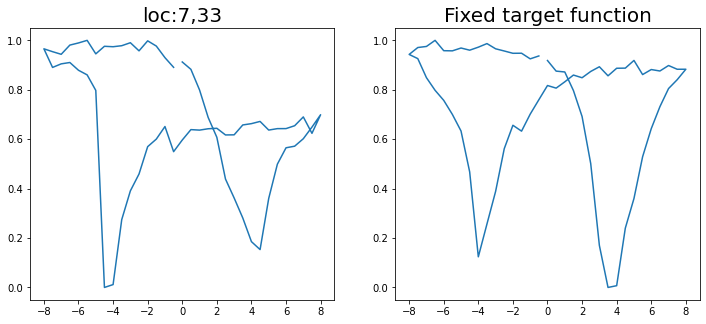

Epoch 1/200 ... Training loss: 2.3986
Epoch 10/200 ... Training loss: 2.2655
Epoch 20/200 ... Training loss: 2.1548
Epoch 30/200 ... Training loss: 2.0735
Epoch 40/200 ... Training loss: 1.9979
Epoch 50/200 ... Training loss: 1.9138
Epoch 60/200 ... Training loss: 1.8277
Epoch 70/200 ... Training loss: 1.7359
Epoch 80/200 ... Training loss: 1.6216
Epoch 90/200 ... Training loss: 1.5162
Epoch 100/200 ... Training loss: 1.5309
Epoch 110/200 ... Training loss: 1.4356
Epoch 120/200 ... Training loss: 1.3576
Epoch 130/200 ... Training loss: 1.4662
Epoch 140/200 ... Training loss: 1.3793
Epoch 150/200 ... Training loss: 1.3605
Epoch 160/200 ... Training loss: 1.3855
Epoch 170/200 ... Training loss: 1.2848
Epoch 180/200 ... Training loss: 1.2573
Epoch 190/200 ... Training loss: 1.2629
Epoch 200/200 ... Training loss: 1.1799
step:  193
Sample #203




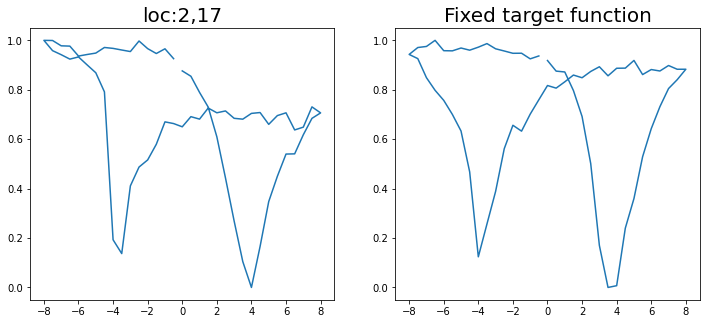

Epoch 1/200 ... Training loss: 2.3967
Epoch 10/200 ... Training loss: 2.2612
Epoch 20/200 ... Training loss: 2.1454
Epoch 30/200 ... Training loss: 2.0671
Epoch 40/200 ... Training loss: 1.9222
Epoch 50/200 ... Training loss: 1.7874
Epoch 60/200 ... Training loss: 1.6493
Epoch 70/200 ... Training loss: 1.5891
Epoch 80/200 ... Training loss: 1.4838
Epoch 90/200 ... Training loss: 1.3721
Epoch 100/200 ... Training loss: 1.2917
Epoch 110/200 ... Training loss: 1.2631
Epoch 120/200 ... Training loss: 1.1945
Epoch 130/200 ... Training loss: 1.3477
Epoch 140/200 ... Training loss: 1.1403
Epoch 150/200 ... Training loss: 1.0788
Epoch 160/200 ... Training loss: 1.0181
Epoch 170/200 ... Training loss: 1.0196
Epoch 180/200 ... Training loss: 0.9626
Epoch 190/200 ... Training loss: 0.9746
Epoch 200/200 ... Training loss: 0.9218
step:  194
Sample #204




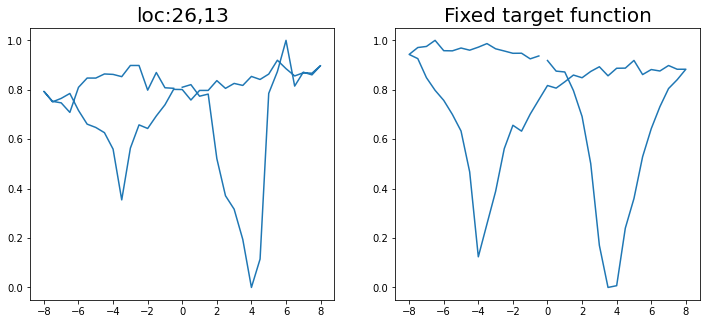

Epoch 1/200 ... Training loss: 2.3915
Epoch 10/200 ... Training loss: 2.2595
Epoch 20/200 ... Training loss: 2.148
Epoch 30/200 ... Training loss: 1.9764
Epoch 40/200 ... Training loss: 1.8465
Epoch 50/200 ... Training loss: 1.6879
Epoch 60/200 ... Training loss: 1.5347
Epoch 70/200 ... Training loss: 1.5082
Epoch 80/200 ... Training loss: 1.4039
Epoch 90/200 ... Training loss: 1.3178
Epoch 100/200 ... Training loss: 1.2858
Epoch 110/200 ... Training loss: 1.2086
Epoch 120/200 ... Training loss: 1.2048
Epoch 130/200 ... Training loss: 1.1994
Epoch 140/200 ... Training loss: 1.1167
Epoch 150/200 ... Training loss: 1.0894
Epoch 160/200 ... Training loss: 1.0102
Epoch 170/200 ... Training loss: 1.0012
Epoch 180/200 ... Training loss: 0.9722
Epoch 190/200 ... Training loss: 0.9108
Epoch 200/200 ... Training loss: 0.9014
step:  195
Sample #205




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


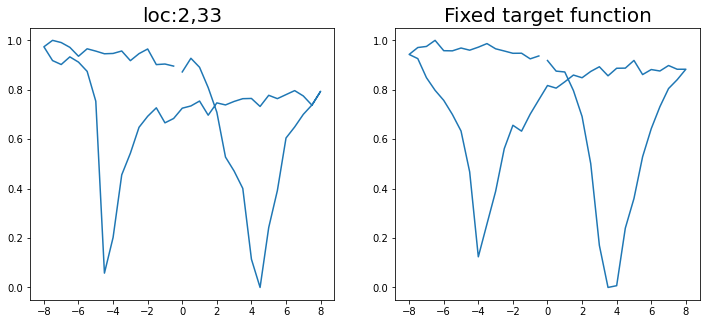

Epoch 1/200 ... Training loss: 2.3913
Epoch 10/200 ... Training loss: 2.2655
Epoch 20/200 ... Training loss: 2.1759
Epoch 30/200 ... Training loss: 2.1001
Epoch 40/200 ... Training loss: 2.0339
Epoch 50/200 ... Training loss: 1.9635
Epoch 60/200 ... Training loss: 1.8793
Epoch 70/200 ... Training loss: 1.7932
Epoch 80/200 ... Training loss: 1.7079
Epoch 90/200 ... Training loss: 1.6069
Epoch 100/200 ... Training loss: 1.5113
Epoch 110/200 ... Training loss: 1.463
Epoch 120/200 ... Training loss: 1.4424
Epoch 130/200 ... Training loss: 1.3634
Epoch 140/200 ... Training loss: 1.3225
Epoch 150/200 ... Training loss: 1.5137
Epoch 160/200 ... Training loss: 1.2712
Epoch 170/200 ... Training loss: 1.183
Epoch 180/200 ... Training loss: 1.1498
Epoch 190/200 ... Training loss: 1.3106
Epoch 200/200 ... Training loss: 1.1012
step:  196
Sample #206




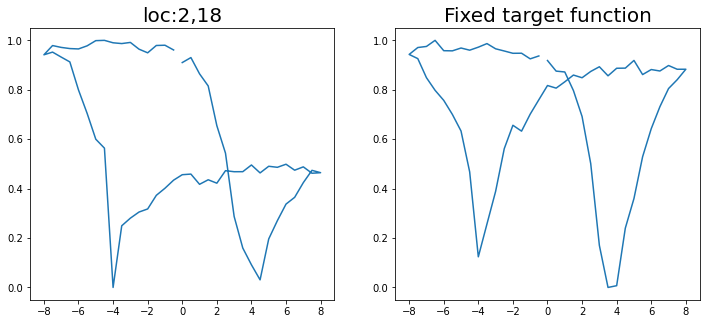

Epoch 1/200 ... Training loss: 2.3907
Epoch 10/200 ... Training loss: 2.2621
Epoch 20/200 ... Training loss: 2.1541
Epoch 30/200 ... Training loss: 2.0766
Epoch 40/200 ... Training loss: 1.9161
Epoch 50/200 ... Training loss: 1.8126
Epoch 60/200 ... Training loss: 1.6729
Epoch 70/200 ... Training loss: 1.5463
Epoch 80/200 ... Training loss: 1.4904
Epoch 90/200 ... Training loss: 1.438
Epoch 100/200 ... Training loss: 1.4475
Epoch 110/200 ... Training loss: 1.2791
Epoch 120/200 ... Training loss: 1.2262
Epoch 130/200 ... Training loss: 1.1713
Epoch 140/200 ... Training loss: 1.1387
Epoch 150/200 ... Training loss: 1.0791
Epoch 160/200 ... Training loss: 1.047
Epoch 170/200 ... Training loss: 1.0157
Epoch 180/200 ... Training loss: 1.0079
Epoch 190/200 ... Training loss: 0.9072
Epoch 200/200 ... Training loss: 0.8921
step:  197
Sample #207




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


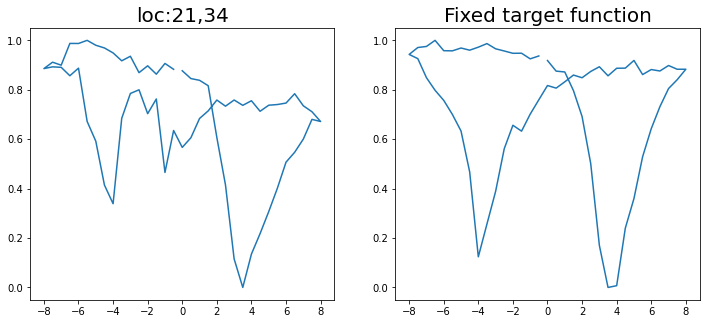

Epoch 1/200 ... Training loss: 2.3829
Epoch 10/200 ... Training loss: 2.2453
Epoch 20/200 ... Training loss: 2.1262
Epoch 30/200 ... Training loss: 1.9105
Epoch 40/200 ... Training loss: 1.8088
Epoch 50/200 ... Training loss: 1.6386
Epoch 60/200 ... Training loss: 1.4554
Epoch 70/200 ... Training loss: 1.3692
Epoch 80/200 ... Training loss: 1.4557
Epoch 90/200 ... Training loss: 1.2422
Epoch 100/200 ... Training loss: 1.169
Epoch 110/200 ... Training loss: 1.0973
Epoch 120/200 ... Training loss: 1.0832
Epoch 130/200 ... Training loss: 1.042
Epoch 140/200 ... Training loss: 0.9403
Epoch 150/200 ... Training loss: 0.9239
Epoch 160/200 ... Training loss: 0.8414
Epoch 170/200 ... Training loss: 0.8041
Epoch 180/200 ... Training loss: 0.8032
Epoch 190/200 ... Training loss: 0.7315
Epoch 200/200 ... Training loss: 0.6899
step:  198
Sample #208




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


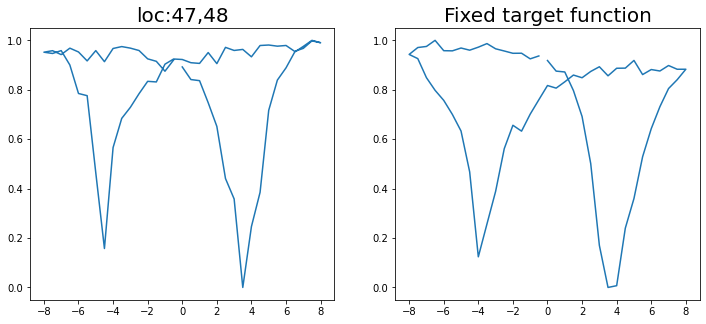

Epoch 1/200 ... Training loss: 2.3778
Epoch 10/200 ... Training loss: 2.2398
Epoch 20/200 ... Training loss: 2.1457
Epoch 30/200 ... Training loss: 2.0611
Epoch 40/200 ... Training loss: 1.968
Epoch 50/200 ... Training loss: 1.8738
Epoch 60/200 ... Training loss: 1.7643
Epoch 70/200 ... Training loss: 1.6494
Epoch 80/200 ... Training loss: 1.6113
Epoch 90/200 ... Training loss: 1.5183
Epoch 100/200 ... Training loss: 1.4367
Epoch 110/200 ... Training loss: 1.3536
Epoch 120/200 ... Training loss: 1.4393
Epoch 130/200 ... Training loss: 1.2939
Epoch 140/200 ... Training loss: 1.2284
Epoch 150/200 ... Training loss: 1.2193
Epoch 160/200 ... Training loss: 1.1724
Epoch 170/200 ... Training loss: 1.0826
Epoch 180/200 ... Training loss: 1.148
Epoch 190/200 ... Training loss: 1.0922
Epoch 200/200 ... Training loss: 1.0184
step:  199
Sample #209




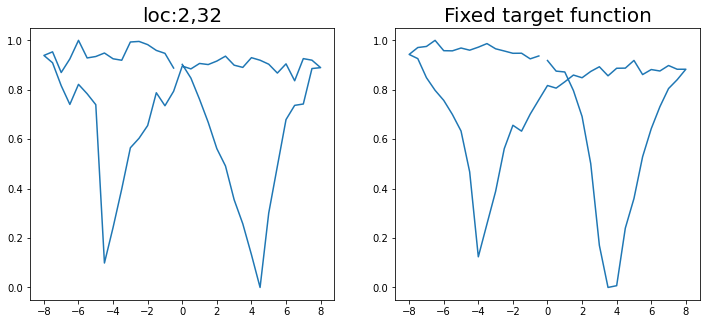

Epoch 1/200 ... Training loss: 2.3757
Epoch 10/200 ... Training loss: 2.2364
Epoch 20/200 ... Training loss: 2.1481
Epoch 30/200 ... Training loss: 2.1018
Epoch 40/200 ... Training loss: 1.9377
Epoch 50/200 ... Training loss: 1.8553
Epoch 60/200 ... Training loss: 1.7427
Epoch 70/200 ... Training loss: 1.6219
Epoch 80/200 ... Training loss: 1.4947
Epoch 90/200 ... Training loss: 1.5131
Epoch 100/200 ... Training loss: 1.4162
Epoch 110/200 ... Training loss: 1.2994
Epoch 120/200 ... Training loss: 1.2761
Epoch 130/200 ... Training loss: 1.3163
Epoch 140/200 ... Training loss: 1.158
Epoch 150/200 ... Training loss: 1.1018
Epoch 160/200 ... Training loss: 1.1603
Epoch 170/200 ... Training loss: 1.1363
Epoch 180/200 ... Training loss: 1.0189
Epoch 190/200 ... Training loss: 0.9738
Epoch 200/200 ... Training loss: 1.1388
step:  200
Sample #210




/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


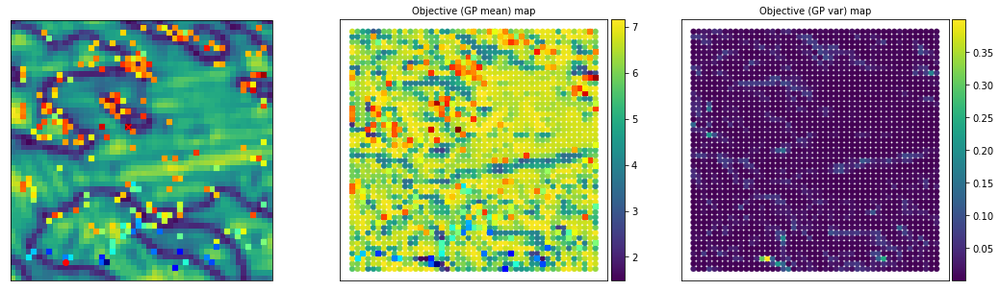

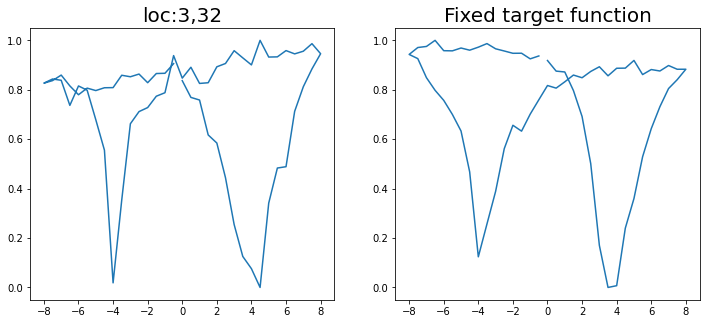

Epoch 1/200 ... Training loss: 2.371
Epoch 10/200 ... Training loss: 2.2354
Epoch 20/200 ... Training loss: 2.1418
Epoch 30/200 ... Training loss: 1.9813
Epoch 40/200 ... Training loss: 1.8692
Epoch 50/200 ... Training loss: 1.7517
Epoch 60/200 ... Training loss: 1.6209
Epoch 70/200 ... Training loss: 1.5259
Epoch 80/200 ... Training loss: 1.3952
Epoch 90/200 ... Training loss: 1.3007
Epoch 100/200 ... Training loss: 1.3363
Epoch 110/200 ... Training loss: 1.2305
Epoch 120/200 ... Training loss: 1.1676
Epoch 130/200 ... Training loss: 1.1267
Epoch 140/200 ... Training loss: 1.3334
Epoch 150/200 ... Training loss: 1.149
Epoch 160/200 ... Training loss: 1.0402
Epoch 170/200 ... Training loss: 1.1357
Epoch 180/200 ... Training loss: 1.007
Epoch 190/200 ... Training loss: 0.9042
Epoch 200/200 ... Training loss: 1.1452


#####----Max. sampling reached, model stopped----#####


/usr/local/lib/python3.8/dist-packages/gpytorch/distributions/multivariate_normal.py:319: NumericalWarning: Negative variance values detected. This is likely due to numerical instabilities. Rounding negative variances up to 1e-06.
  warnings.warn(


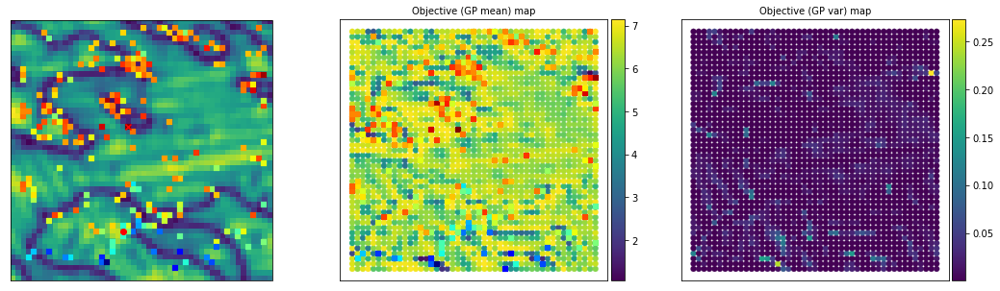

/usr/local/lib/python3.8/dist-packages/numpy/lib/npyio.py:528: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  arr = np.asanyarray(arr)


In [18]:
## Gp model fit
# Calling function to fit and optimizize Hyperparameter of Gaussian Process (using Adam optimizer)
# Input args- Torch arrays of normalized training data, parameter X and objective eval Y
# Output args- Gaussian process model lists
switch_obj_index = 0 # This is the index parameter to switch from 0 to 1 when the user satisfy with updating target
#Set up the surrogat emodel
gp_surro = play_varTBO.optimize_dKLgp(train_X_norm, train_Y[:, 0])

for i in range(1, N + 1):
    print("step: ", i)
    print("Sample #" + str(m + 1)+ "\n\n")
    # Calculate posterior for analysis for intermidiate iterations
    y_pred_means, y_pred_vars = play_varTBO.cal_posterior(gp_surro, test_X_norm)
        
    #Plot every tenth iteration after running the evaluation
    if ((i == 1) or ((i % 10) == 0)):
        #This will estimate the surrogate
        X_eval, X_GP, _, _ = play_varTBO.estimate(train_indices, train_Y, indices, y_pred_means)
        #print(X_eval, X_GP)
        fig = plot_results(train_indices, train_Y, indices, y_pred_means, y_pred_vars, X_eval, X_GP, img, i)
        #put the savefig within the plot function
        #fig.savefig('acquisition_results_step=' + str(i) +'.png', dpi = 300, bbox_inches = 'tight', pad_inches = 1.0)
    #calculate acquisition function
    acq_cand, acq_val, EI_val = play_varTBO.acqmanEI(y_pred_means, y_pred_vars, train_Y, idx)
    val = acq_val
    ind = np.random.choice(acq_cand) # When multiple points have same acq values
    idx = np.hstack((idx, ind))
    #print(new_points_measured, idx)

    ## Find next point which maximizes the learning through exploration-exploitation
    if (i == 1):
        val_ini = val
      # Check for convergence
    if ((val) < 0):  # Stop for negligible expected improvement
        print("Model converged due to sufficient learning over search space ")
        break
    else:
        nextX = np.zeros((1, test_X.shape[1]))
        nextX_norm = np.zeros((1, test_X_norm.shape[1]))
        next_indices = np.zeros((1,2))
        nextX[0,:] = test_X[ind, :]
        nextX_norm [0, :] = test_X_norm[ind, :]
        next_indices[0, :] = indices[ind, :]
        idx_x = int(next_indices[0, 0])
        idx_y = int(next_indices[0, 1])

        next_loc = np.asarray([idx_x, idx_y])
        new_points_measured = idx
        
        #polarization loop area
        IV, points_measured = return_new_measurement(targets, new_points_measured)

        new_iv = IV[points_measured,:]

        #new_spec_x = torch.from_numpy(vdc_vec)
        #new_spec_y = torch.from_numpy(new_iv)[-1]

        new_spec_x = vdc_vec
        new_spec_y = new_iv[-1]

      
        new_spec_y = (new_spec_y - new_spec_y.min())/(new_spec_y.max() - new_spec_y.min())
        
        #clear_output(wait=True) Comment out as I need to check the run in colab
        
        eval_spec_y[idx_x, idx_y, :] = new_spec_y
        # Evaluate true function for new data, augment data
        train_X, train_X_norm, train_indices, train_Y, var_params, switch_obj_index, m =\
        play_varTBO.augment_newdata_KL(nextX, nextX_norm, next_indices, train_X, train_X_norm, train_indices, train_Y,
                                        new_spec_x, new_spec_y, eval_spec_y, img, var_params, switch_obj_index, m)


        #print(next_indices)
        # Gp model fit
        # Updating GP with augmented training data
        gp_surro = play_varTBO.optimize_dKLgp(train_X_norm, train_Y[:, 0])

    ## Final posterior prediction after all the sampling done

if (i == N):
    print("\n\n#####----Max. sampling reached, model stopped----#####")

#Optimal GP learning
gp_opt = gp_surro
# Posterior calculation with converged GP model
y_pred_means, y_pred_vars = play_varTBO.cal_posterior(gp_opt, test_X_norm)

# Plotting functions to check final iteration
X_opt, X_opt_GP, ind_opt, ind_opt_GP = play_varTBO.estimate(train_indices, train_Y, indices, y_pred_means)
plot_results(train_indices, train_Y, indices, y_pred_means, y_pred_vars, X_opt, X_opt_GP, img, i)

explored_data = [train_indices, train_indices, train_Y]
final_GP_estim = [y_pred_means, y_pred_vars]
user_votes = var_params[1]
optim_results = [X_opt, X_opt_GP, ind_opt, ind_opt_GP, user_votes, explored_data, y_pred_means, y_pred_vars]

#Save few data
np.save("optim_resultsd2_dklBOpatch", optim_results)

# Generate spectral ground truth image -- compute objective, given target at all the grid points

In [19]:
spec_ground = np.zeros((indices.shape[0],1))
spec_ground.shape

(2209, 1)

In [20]:
for i in range(0, indices.shape[0]):
  idx_x = int(indices[i, 0])
  idx_y = int(indices[i, 1])
  new_spec_y = targets[i, :]
  new_spec_y = (new_spec_y - new_spec_y.min())/(new_spec_y.max() - new_spec_y.min())
  #print(idx_x, idx_y, spec_y)
  spec_ground[i, 0] = play_varTBO.func_automated_obj(idx_x, idx_y, new_spec_x, new_spec_y, target_func)

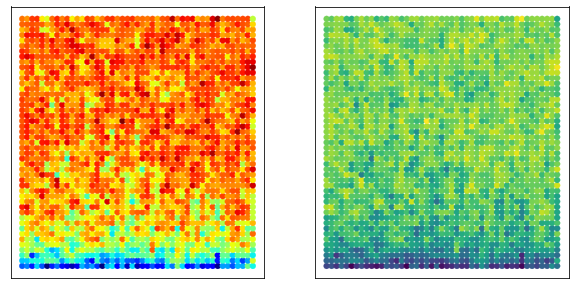

In [21]:
  fig,ax=plt.subplots(ncols=2,figsize=(10,5))
  a = ax[0].scatter(indices[:,1], indices[:,0], c=spec_ground, cmap='jet', linewidth=0.2)
  #cax = divider.append_axes('right', size='5%', pad=0.05)
  #fig.colorbar(a, cax=cax, orientation='vertical')
  #ax[0].set_title('Objective (GP mean) map', fontsize=10)
  ax[0].axes.xaxis.set_visible(False)
  ax[0].axes.yaxis.set_visible(False)

  a = ax[1].scatter(indices[:,1], indices[:,0], c=spec_ground, cmap='viridis', linewidth=0.2)
  #cax = divider.append_axes('right', size='5%', pad=0.05)
  #fig.colorbar(a, cax=cax, orientation='vertical')
  #ax[1].set_title('Objective (GP mean) map', fontsize=10)
  ax[1].axes.xaxis.set_visible(False)
  ax[1].axes.yaxis.set_visible(False)

Error map between ground truth and GP prediction of SSIM

0.16837300130074645


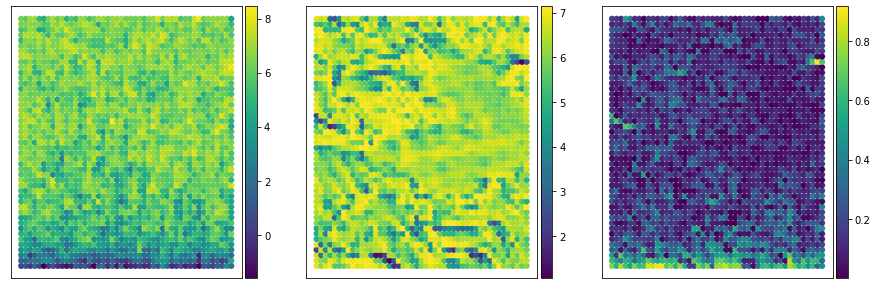

In [22]:
spec_ground_norm = (spec_ground -np.min(spec_ground))/(np.max(spec_ground)-np.min(spec_ground))
y_pred_means_norm = (y_pred_means-np.min(y_pred_means))/(np.max(y_pred_means)-np.min(y_pred_means))
error = np.absolute(spec_ground_norm-y_pred_means_norm)
mae = np.mean(error)
print(mae)
fig,ax=plt.subplots(ncols=3,figsize=(15,5))
a = ax[0].scatter(indices[:,1], indices[:,0], c=spec_ground, cmap='viridis', linewidth=0.2)
divider = make_axes_locatable(ax[0])
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(a, cax=cax, orientation='vertical')
#ax[0].set_title('Objective (GP mean) map', fontsize=10)
ax[0].axes.xaxis.set_visible(False)
ax[0].axes.yaxis.set_visible(False)

a = ax[1].scatter(indices[:,1], indices[:,0], c=y_pred_means, cmap='viridis', linewidth=0.2)
divider = make_axes_locatable(ax[1])
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(a, cax=cax, orientation='vertical')
#ax[1].set_title('Objective (GP mean) map', fontsize=10)
ax[1].axes.xaxis.set_visible(False)
ax[1].axes.yaxis.set_visible(False)

a = ax[2].scatter(indices[:,1], indices[:,0], c=error, cmap='viridis', linewidth=0.2)
divider = make_axes_locatable(ax[2])
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(a, cax=cax, orientation='vertical')
#ax[1].set_title('Objective (GP mean) map', fontsize=10)
ax[2].axes.xaxis.set_visible(False)
ax[2].axes.yaxis.set_visible(False)

0.05026344730418169


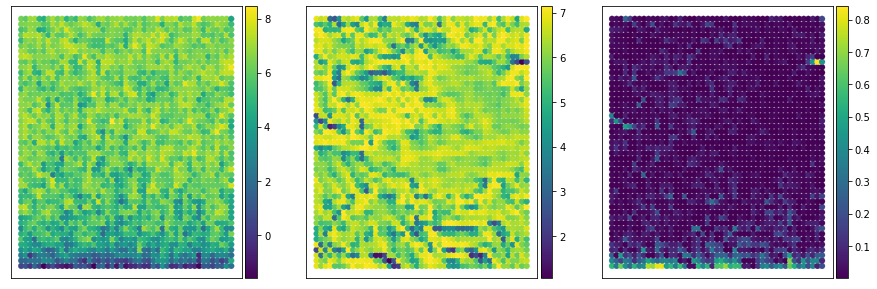

In [23]:
spec_ground_norm = (spec_ground -np.min(spec_ground))/(np.max(spec_ground)-np.min(spec_ground))
y_pred_means_norm = (y_pred_means-np.min(y_pred_means))/(np.max(y_pred_means)-np.min(y_pred_means))
error = (spec_ground_norm-y_pred_means_norm)**2
mse = np.mean(error)
print(mse)
fig,ax=plt.subplots(ncols=3,figsize=(15,5))
a = ax[0].scatter(indices[:,1], indices[:,0], c=spec_ground, cmap='viridis', linewidth=0.2)
divider = make_axes_locatable(ax[0])
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(a, cax=cax, orientation='vertical')
#ax[0].set_title('Objective (GP mean) map', fontsize=10)
ax[0].axes.xaxis.set_visible(False)
ax[0].axes.yaxis.set_visible(False)

a = ax[1].scatter(indices[:,1], indices[:,0], c=y_pred_means, cmap='viridis', linewidth=0.2)
divider = make_axes_locatable(ax[1])
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(a, cax=cax, orientation='vertical')
#ax[1].set_title('Objective (GP mean) map', fontsize=10)
ax[1].axes.xaxis.set_visible(False)
ax[1].axes.yaxis.set_visible(False)

a = ax[2].scatter(indices[:,1], indices[:,0], c=error, cmap='viridis', linewidth=0.2)
divider = make_axes_locatable(ax[2])
cax = divider.append_axes('right', size='5%', pad=0.05)
fig.colorbar(a, cax=cax, orientation='vertical')
#ax[1].set_title('Objective (GP mean) map', fontsize=10)
ax[2].axes.xaxis.set_visible(False)
ax[2].axes.yaxis.set_visible(False)